In [ ]:
import torch
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import os

In [ ]:
TEST_SPLIT = 0.1
# VAL_SPLIT = 0.2
BATCH_SIZE = 16
NUM_BLOCKS=7
HIDDEN_CHANNELS = 120
LEARNING_RATE = 0.001
# attention = 'soft_attention'
attention = 'NO_ATTENTION_3rd'
data_augmentation = True

In [ ]:
# Mount Google Drive
from google.colab import drive
import os

drive.mount('/content/gdrive')
# Define base folder path
base_path = '/content/gdrive/MyDrive/yoga_proj'
!ls /content/gdrive/MyDrive/yoga_proj
# base_path = '../'

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
120_h_d_LR_0.01_FEB_4_NEW_STSAE_GCN
Adaptive_avg_pooling_BLOCKSIZE_7__RC_attention_january_31_stsaegcn
Adaptive_avg_pooling_RC_attention_january_31_stsaegcn
CROSS_FOLD_1D_CNN_LSTM_2025-02-09_HC256_LR0.001
CROSS_FOLD_STSAE_GCN_2025-02-08_B7_HC120_LR0.001_soft_attention
CROSS_FOLD_STSAE_GCN_2025-02-09_B7_HC120_LR0.001_NO_ATTENTION
CROSS_FOLD_STSAE_GCN_2025-02-09_B7_HC120_LR0.001_soft_attention
CROSS_FOLD_STSAE_GCN_2025-02-22_B7_HC120_LR0.001_NO_ATTENTION_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-23_B7_HC120_LR0.001_soft_attention_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_2nd_DA_True
CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True
data
DATA_BN_CROSS_FOLD_1D_CNN_LSTM_2025-02-09_HC256_LR0.001
DATA_BN_CROSS_FOLD_1D_CNN_LSTM_2025-02-20_HC256_LR0.001
dec16_Cross_fold
Dropout_RC_attention_january_31_stsaegcn
FEB_4_NEW

In [ ]:
import os
from datetime import datetime

# Gets label
csv_path = os.path.join(base_path,'data/3DYoga90_corrected.csv')

# SAVE_PATH = os.path.join(base_path, 'STSAE_GCN')
today = datetime.today().strftime('%Y-%m-%d')
SAVE_PATH = os.path.join(
    base_path,
    f'CROSS_FOLD_STSAE_GCN_{today}_B{NUM_BLOCKS}_HC{HIDDEN_CHANNELS}_LR{LEARNING_RATE}_{attention}_DA_{data_augmentation}'
)
os.makedirs(SAVE_PATH, exist_ok=True)
FOLD_CHECKPOINT_PATH = os.path.join(SAVE_PATH, 'FOLD_CHECKPOINT')
os.makedirs(FOLD_CHECKPOINT_PATH, exist_ok=True)
print(SAVE_PATH)

pose_list = ['downward-dog','standing-forward-bend','half-way-lift',
             'mountain','chair','cobra','cockerel','extended-triangle',
             'extended-side-angle','corpse','staff','wind-relieving','fish'
            ]
NUM_CLASSES = len(pose_list)

dataset_dir = os.path.join(base_path, 'official_dataset')
assert os.path.isdir(dataset_dir), f"Directory '{dataset_dir}' does not exist."


/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True


In [ ]:
print(torch.__version__)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

2.5.1+cu124


In [ ]:
meta_info_path = os.path.join(base_path, 'data')
pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')

What does each file tell?

1.) pose-index.csv -> Shows Heirarchical organization (THEN NOTHING MORE)

2.) 3DYoga90.csv -> Total Main Info(i.e. along with RGB stream){
    SequneceID: Parquet_FILE_NAME,
    URL,
    Frame Start and Frame Stop,
    Pose Name, Training Test Split
} `Difference between train and test? where to get the validation set from? How to do data augmentation?

3.) Parquet Files -> {
    Frame Number {
        33 Landmarks
    },
    row-id: FrameNumber-TYPE-Landmark_index,
    Coordinates: {x, y, z}
}

`PLEASE NOTE: The landmark coordinates are all normalized`

# Getting the data ready

In [ ]:
subset_of_poses = pose_list

In [ ]:
# Keep only relevant columns
def read_meta_data():
    meta_info_path = os.path.join(base_path, 'data')
    pose_index = pd.read_csv(f'{meta_info_path}/pose-index.csv')
    sequence_index = pd.read_csv(f'{meta_info_path}/3DYoga90_corrected.csv')
    parquet_index = sequence_index[['sequence_id', 'l3_pose', 'split']]
    return parquet_index

In [ ]:
import torch
import torch.nn.functional as F
import numpy as np

def AddGaussianNoise(data, mean=0., std=0.01):
    noise = torch.randn_like(data) * std + mean
    return data + noise

def RandomRotate(data, max_angle=30):
    angle = torch.rand(1) * 2 * max_angle - max_angle  # Range: [-max_angle, max_angle] in degrees
    angle_rad = torch.deg2rad(angle)
    cos_theta = torch.cos(angle_rad)
    sin_theta = torch.sin(angle_rad)

    rotation_matrix = torch.tensor([
        [cos_theta, 0, sin_theta],
        [0, 1, 0],
        [-sin_theta, 0, cos_theta]
    ]).squeeze()

    # print(data.shape)
    # print(rotation_matrix.shape)
    # data = torch.matmul(rotation_matrix, data)
    data = torch.einsum('ij, jkl -> ikl', rotation_matrix, data)
    return data

def RandomScale(data, scale_range=(0.9, 1.1)):
    scale =  scale_range[0] + torch.rand(1) * (scale_range[1] - scale_range[0]) # 0.9 + 0.2 * percentage
    return data * scale

def RandomTranslate(data, max_translate=0.1):
    translate = torch.rand(3) * 2 * max_translate - max_translate  # Range: [-max_translate, max_translate]
    return data + translate.unsqueeze(1).unsqueeze(2)

def TimeReverse(data, p=0.5):
    if torch.rand(1) < p:
        return torch.flip(data, [1])
    else:
        return data

In [ ]:
import torch
from torch.utils.data import Dataset
import pandas as pd
import numpy as np

class Yoga3DDataset(Dataset):
    def __init__(self, parquet_index, root_dir =  dataset_dir,subset_of_poses= subset_of_poses, sub_sampling_length = 20, transform=None, max_frames=None):
        self.parquet_index = parquet_index
        self.parquet_index = self.parquet_index[self.parquet_index['l3_pose'].isin(subset_of_poses)]
        self.root_dir = root_dir
        self.transform = transform
        self.max_frames = max_frames
        self.sub_sampling_length = sub_sampling_length
        self.pose_to_label = {pose: i for i, pose in enumerate(subset_of_poses)}
        self.use_augmentation = False

        self.cache = dict()
        self.idx_to_seq = dict()

    def __len__(self):
        return len(self.parquet_index)

    def __getitem__(self, idx):
        if idx in self.cache:
            data, label = self.cache[idx]
        else:
            fname, pose_name, _ = self.parquet_index.iloc[idx]
            label = self.pose_to_label[pose_name]
            path = os.path.join(self.root_dir, f'{fname}.parquet')

            df = pd.read_parquet(path)
            df = df.drop(columns=['frame', 'row_id', 'type','landmark_index'])

            data = self.to_tensor(df)
            data = self.sub_sample(data)
            data = data.permute(1,0,2)
            self.cache[idx] = (data, label)
            self.idx_to_seq[idx] = fname

        if self.transform and self.use_augmentation:
            data = self.transform(data.clone())

        return data, label # C, T , V

    def sub_sample(self, data):
        # data(Number_of_frames, 3, 33)
        total_frames = data.shape[0]
        indices = torch.linspace(0, total_frames -1 , self.sub_sampling_length, dtype= int)
        return data[indices]

    def to_tensor(self, df):
        # Reshape the data to (num_frames, num_landmarks, 3)  ## WHAT WHAT? this doesn't make sense remove this line you are doing (number of frames, 3 , 33)
        num_frames = len(df) // 33  # Assuming 33 landmarks per frame
        data = df.values.reshape(num_frames, 33, 3)
        return torch.FloatTensor(data).permute(0, 2, 1)

In [ ]:
class Compose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, data):
        for transform in self.transforms:
            data = transform(data)
        return data

In [ ]:
class RandomApply:
    def __init__(self, transform, p=0.5):
        self.transform = transform
        self.p = p

    def __call__(self, data):
        if torch.rand(1) < self.p:
            return self.transform(data)
        else:
            return data

In [41]:
import numpy as np
JOINT_COUNT = 33


def edge2mat(link, num_node):
    A = np.zeros((num_node, num_node))
    for i, j in link:
        A[j, i] = 1
    return A


def normalize_digraph(A, dim=0):
    # A is a 2D square array
    Dl = np.sum(A, dim)
    h, w = A.shape
    Dn = np.zeros((w, w))

    for i in range(w):
        if Dl[i] > 0:
            Dn[i, i] = Dl[i] ** (-1)

    AD = np.dot(A, Dn)
    return AD


class Graph:
    """The Graph to model the skeletons.

    Args:
        layout (str): must be one of the following candidates: 'mediapipe'. Default: 'mediapipe'.
        mode (str): must be one of the following candidates: 'stgcn_spatial', 'spatial'. Default: 'spatial'.
        max_hop (int): the maximal distance between two connected nodes.
            Default: 1
    """

    def __init__(
        self,
        layout="mediapipe",
        mode="spatial",
        max_hop=1,
        nx_node=1,
        num_filter=3,
        init_std=0.02,
        init_off=0.04,
    ):

        self.max_hop = max_hop
        self.layout = layout
        self.mode = mode
        self.num_filter = num_filter
        self.init_std = init_std
        self.init_off = init_off
        self.nx_node = nx_node

        assert (
            nx_node == 1 or mode == "random"
        ), "nx_node can be > 1 only if mode is 'random'"
        assert layout in ["mediapipe"]

        self.get_layout(layout)
        #  self.hop_dis = get_hop_distance(self.num_node, self.inward, max_hop)

        assert hasattr(self, mode), f"Do Not Exist This Mode: {mode}"
        self.A = getattr(self, mode)()

    def __str__(self):
        return self.A

    def get_layout(self, layout):
        if layout == "mediapipe":
            self.num_node = 33
            self.inward = [
                # Torso
                (12, 11),
                (24, 12),
                (24, 23),
                (23, 11),  # shoulders to hips
                # Right arm
                (14, 12),
                (16, 14),
                (18, 16),
                (20, 18),
                (20, 22),  # shoulder to fingertip
                # Left arm
                (13, 11),
                (15, 13),
                (17, 15),
                (19, 17),
                (21, 19),  # shoulder to fingertip
                # Right leg
                (26, 24),
                (28, 26),
                (30, 28),
                (32, 30),  # hip to foot
                # Left leg
                (25, 23),
                (27, 25),
                (29, 27),
                (31, 29),  # hip to foot
                # Face
                (1, 0),
                (2, 1),
                (3, 2),
                (7, 3),  # right eye
                (4, 0),
                (5, 4),
                (6, 5),
                (8, 6),  # left eye
                (10, 9),  # mouth
                # Add connections to nose (0) from shoulders
                # (0, 11), (0, 12)  # do we include this connection dear friend?
            ]
            self.center = 11  # Left shoulder as the center
        else:
            raise ValueError(f"Do Not Exist This Layout: {layout}")
        self.self_link = [(i, i) for i in range(self.num_node)]
        self.outward = [(j, i) for (i, j) in self.inward]
        self.neighbor = self.inward + self.outward

    def spatial(self):
        Iden = edge2mat(self.self_link, self.num_node)
        In = normalize_digraph(edge2mat(self.inward, self.num_node))
        Out = normalize_digraph(edge2mat(self.outward, self.num_node))
        A = np.stack((Iden, In, Out))
        return A

import torch
import torch.nn as nn
import torch.nn.functional as F


class AGCN(nn.Module):
    def __init__(
        self, in_channels, out_channels, adaptive="init", conv_pos="pre", with_res=False
    ):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.graph = Graph()
        A = torch.tensor(self.graph.A, dtype=torch.float32, requires_grad=False)
        self.num_subsets = A.size(0)
        # print("NUM_SUBSET:", self.num_subsets)
        self.adaptive = adaptive
        self.conv_pos = conv_pos
        self.with_res = with_res

        self.A = nn.Parameter(A.clone())

        if self.conv_pos == "pre":
            self.conv = nn.Conv2d(in_channels, out_channels * self.num_subsets, 1)
        elif self.conv_pos == "post":
            self.conv = nn.Conv2d(self.num_subsets * in_channels, out_channels, 1)

        if self.with_res:
            if in_channels != out_channels:
                self.residual = nn.Sequential(
                    nn.Conv2d(in_channels, out_channels, 1),
                    nn.BatchNorm2d(out_channels),
                )
            else:
                self.residual = lambda x: x

        self.batch_norm = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        n, c, t, v = x.shape
        res = self.residual(x) if self.with_res else 0

        A = self.A

        if self.conv_pos == "pre":
            x = self.conv(x)
            x = x.view(n, self.num_subsets, -1, t, v)
            x = torch.einsum("nkctv,kvw->nctw", (x, A)).contiguous()
        elif self.conv_pos == "post":
            x = torch.einsum("nctv,kvw->nkctw", (x, A)).contiguous()
            x = x.view(n, -1, t, v)
            x = self.conv(x)

        return F.relu(self.batch_norm(x) + res)


def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        if hasattr(m, "weight"):
            nn.init.kaiming_normal_(m.weight, mode="fan_out")
        if (
            hasattr(m, "bias")
            and m.bias is not None
            and isinstance(m.bias, torch.Tensor)
        ):
            nn.init.constant_(m.bias, 0)
    elif classname.find("BatchNorm") != -1:
        if hasattr(m, "weight") and m.weight is not None:
            m.weight.data.normal_(1.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            m.bias.data.fill_(0)

class TemporalConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, dilation=1):
        super(TemporalConv, self).__init__()
        pad = (kernel_size + (kernel_size - 1) * (dilation - 1) - 1) // 2
        self.conv = nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size=(kernel_size, 1),
            padding=(pad, 0),
            stride=(stride, 1),
            dilation=(dilation, 1),
        )

        self.bn = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        return x


class MTCN(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size=3,
        stride=1,
        dilations=[1, 2, 3, 4],
        residual=True,
        residual_kernel_size=1,
    ):

        super().__init__()
        assert (
            out_channels % (len(dilations) + 2) == 0
        ), "# out channels should be multiples of # branches"

        # Multiple branches of temporal convolution
        self.num_branches = len(dilations) + 2
        branch_channels = out_channels // self.num_branches
        if type(kernel_size) == list:
            assert len(kernel_size) == len(dilations)
        else:
            kernel_size = [kernel_size] * len(dilations)
        # Temporal Convolution branches
        self.branches = nn.ModuleList(
            [
                nn.Sequential(
                    nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                    nn.BatchNorm2d(branch_channels),
                    nn.ReLU(inplace=True),
                    TemporalConv(
                        branch_channels,
                        branch_channels,
                        kernel_size=ks,
                        stride=stride,
                        dilation=dilation,
                    ),
                )
                for ks, dilation in zip(kernel_size, dilations)
            ]
        )

        # Additional Max & 1x1 branch
        self.branches.append(
            nn.Sequential(
                nn.Conv2d(in_channels, branch_channels, kernel_size=1, padding=0),
                nn.BatchNorm2d(branch_channels),
                nn.ReLU(inplace=True),
                nn.MaxPool2d(kernel_size=(3, 1), stride=(stride, 1), padding=(1, 0)),
                nn.BatchNorm2d(branch_channels),
            )
        )

        self.branches.append(
            nn.Sequential(
                nn.Conv2d(
                    in_channels,
                    branch_channels,
                    kernel_size=1,
                    padding=0,
                    stride=(stride, 1),
                ),
                nn.BatchNorm2d(branch_channels),
            )
        )

        # Residual connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels,
                out_channels,
                kernel_size=residual_kernel_size,
                stride=stride,
            )

        # initialize
        self.apply(weights_init)

    def forward(self, x):
        # Input dim: (N,C,T,V)
        res = self.residual(x)
        branch_outs = []
        for tempconv in self.branches:
            out = tempconv(x)
            branch_outs.append(out)

        out = torch.cat(branch_outs, dim=1)
        out += res
        return out

class SAM(nn.Module):
    def __init__(self, in_channels, joint_count=JOINT_COUNT):
        super(SAM, self).__init__()

        # Conv1D over joints (V), capturing spatial dependencies
        ks = (
            joint_count if joint_count % 2 else joint_count - 1
        )  # Ensure odd kernel size
        padding = (ks - 1) // 2
        self.gs = nn.Conv1d(in_channels, 1, kernel_size=ks, padding=padding)

        # Pool over time (T) only, preserve joints (V)
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (1, None)
        )  # Collapses T, keeps V unchanged

        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        N, C, T, V = x.shape
        # Pool along time (T) dimension only
        t = self.avg_pool(x)  # (N, C, 1, V)

        t = t.squeeze(2)
        t = self.gs(t)  # (N, 1, V)
        Ms = self.sigmoid(t)
        Ms = Ms.unsqueeze(2)
        return (x + x * Ms), Ms


class TAM(nn.Module):
    def __init__(self, in_channels, temporal_size=9):
        super(TAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(
            (None, 1)
        )  # Keep temporal dim, pool joints
        padding = (temporal_size) // 2
        self.gt = nn.Conv1d(in_channels, 1, kernel_size=temporal_size, padding=padding)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Pool over joints (V) while keeping temporal dimension
        t = self.avg_pool(x).squeeze(-1)  # (N, C, T)

        t = self.gt(t)  # (N, 1, T)

        Mt = self.sigmoid(t).unsqueeze(-1)  # (N, 1, T, 1)

        return x * Mt + x, Mt


class CAM(nn.Module):
    def __init__(self, in_channels, reduction=2):
        super(CAM, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        # Combine the operations into a single sequential block
        self.fc = nn.Sequential(
            nn.Linear(in_channels, in_channels // reduction),
            nn.ReLU(),  # δ applied to entire W1 term
            nn.Linear(in_channels // reduction, in_channels),
            nn.Sigmoid(),
        )

    def forward(self, x):
        n, c, _, _ = x.shape
        t = self.avg_pool(x).view(n, c)
        Mc = self.fc(t).view(n, c, 1, 1)
        return x * Mc + x, Mc

import torch
import torch.nn as nn
import torch.nn.functional as F


class STSAE_GCN_Block(nn.Module):
    def __init__(self, in_channels, out_channels, residual=True, stride=1):
        super(STSAE_GCN_Block, self).__init__()

        # Graph Convolution
        self.agcn = AGCN(in_channels, out_channels)

        # # Attention Modules
        self.sam = SAM(out_channels)  # Spatial Attention
        self.tam = TAM(out_channels)  # Temporal Attention
        self.cam = CAM(out_channels)  # Channel Attention

        # Multi-Scale Temporal Convolution Network
        self.mtcn = MTCN(out_channels, out_channels)

        # Residual Connection
        if not residual:
            self.residual = lambda x: 0
        elif (in_channels == out_channels) and (stride == 1):
            self.residual = lambda x: x
        else:
            self.residual = TemporalConv(
                in_channels, out_channels, kernel_size=1, stride=stride
            )

        # Activation
        self.relu = nn.ReLU()

        # Store Attention Maps
        self.Ms = None  # Spatial Attention Map
        self.Mt = None  # Temporal Attention Map
        self.Mc = None  # Channel Attention Map

    def forward(self, x):
        res = self.residual(x)

        # Apply Graph Convolution
        x = self.agcn(x)

        # Apply Attention Modules and Store Attention Maps
        x, self.Ms = self.sam(x)  # Spatial Attention
        x, self.Mt = self.tam(x)  # Temporal Attention
        x, self.Mc = self.cam(x)  # Channel Attention

        # Apply Multi-Scale Temporal Convolution
        x = self.mtcn(x) + res

        return self.relu(x)

    def get_attention(self):
        """
        Returns the stored attention maps.
        """
        return {"Ms": self.Ms, "Mt": self.Mt, "Mc": self.Mc}


class STSAE_GCN(nn.Module):
    def __init__(
        self, in_channels, hidden_channels, num_classes, num_frames, num_blocks=9
    ):
        super(STSAE_GCN, self).__init__()
        self.num_blocks = num_blocks
        num_nodes = 33
        self.batch_norm = nn.BatchNorm1d(in_channels * num_nodes)
        self.blocks = nn.ModuleList(
            [
                STSAE_GCN_Block(
                    in_channels if i == 0 else hidden_channels,
                    hidden_channels,
                    residual=False if i == 0 else True,
                )
                for i in range(num_blocks)
            ]
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))  # Global Average Pooling
        self.fc = nn.Linear(
            hidden_channels, num_classes
        )  # Only hidden_channels remain after pooling

    def forward(self, x):
        # x shape: (batch_size, in_channels, num_frames, num_nodes)

        # print("SHAPE X:", x.shape)
        N, C, T, V = x.size()
        x = x.permute(0, 3, 1, 2).contiguous()
        x = x.view(N, V * C, T)
        x = self.batch_norm(x)
        x = x.view(N, V, C, T).permute(0, 2, 3, 1)

        for block in self.blocks:
            x = block(x)
            # print("X SHAPE:", x.shape)

        # Apply Global Average Pooling
        x = (
            self.avg_pool(x).squeeze(-1).squeeze(-1)
        )  # Reduce to (batch_size, hidden_channels)

        # Fully connected layer
        x = self.fc(x)
        return x

    def count_parameters(self):
        total_params = 0
        for name, parameter in self.named_parameters():
            if parameter.requires_grad:
                params = parameter.numel()
                print(f"{name}: {params}")
                total_params += params
        print(f"Total Trainable Params: {total_params}")


In [47]:
# Create dummy data
batch_size = 32
in_channels = 3
num_frames = 20
num_nodes = 33
num_classes = 13

# Create random input data
x = torch.randn(batch_size, in_channels, num_frames, num_nodes)
# Create random target labels
y = torch.randint(0, num_classes, (batch_size,))

# Initialize model and loss
model = STSAE_GCN(in_channels,hidden_channels=120, num_frames=num_frames, num_classes=num_classes)
criterion = nn.CrossEntropyLoss()

# Forward pass
outputs = model(x)
loss = criterion(outputs, y)

print(f"Input shape: {x.shape}")
print(f"Output shape: {outputs.shape}")
print(f"Target shape: {y.shape}")
print(f"Loss value: {loss.item()}")

Input shape: torch.Size([32, 3, 20, 33])
Output shape: torch.Size([32, 13])
Target shape: torch.Size([32])
Loss value: 7.636871337890625


In [ ]:
import os
import torch
def save_checkpoint(model, optimizer, epoch, history, save_path = SAVE_PATH, best_path=None):
    if best_path is not None:
        # chk_path = os.path.join(save_path, f'best_model.pth')
        chk_path = best_path
        print(f"Saving checkpoint to {chk_path}")
    else:
        chk_path = os.path.join(save_path, f'checkpath_model.pth')
        print(f"Saving checkpoint to {chk_path}")

    # Combine model, optimizer, and history into one dictionary
    checkpoint = {
        'epoch': epoch + 1,  # Save the next epoch number for resuming
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'history': history  # Save history along with the model and optimizer
    }

    # Save everything in a single file using torch.save
    torch.save(checkpoint, chk_path)
    print(f"Checkpoint saved at epoch {epoch + 1}")

In [ ]:
def load_checkpoint(model, optimizer, checkpoint_path):
    """
    Load model and training state from a checkpoint
    """
    print(f"Loading checkpoint from {checkpoint_path}")
    checkpoint = torch.load(checkpoint_path, weights_only = False)

    # Load model and optimizer states
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])

    # Get the epoch number to resume from
    start_epoch = checkpoint['epoch']

    # Load training history with new metrics
    history = checkpoint.get('history', {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    })

    return model, optimizer, start_epoch, history


In [ ]:
class EarlyStopping:
    """Early stopping to prevent overfitting"""
    def __init__(self, patience=7, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        # on default = 7 successive val_loss increase stop
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.counter = 0

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
import os
import matplotlib.pyplot as plt

def plot_per_class_metric(precision, recall, f1, epoch=0, pose_list=None, master_save_path="SAVE_PATH"):
    """
    Plots and saves per-class metrics (Precision, Recall, F1-score) for the given epoch.

    Args:
        precision (list): Per-class precision values.
        recall (list): Per-class recall values.
        f1 (list): Per-class F1-score values.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        master_save_path (str): Directory to save the plot.
    """
    if pose_list is None:
        pose_list = [str(i) for i in range(len(precision))]  # Default to numeric labels

    save_dir = os.path.join(master_save_path, 'per_class_metric')
    os.makedirs(save_dir, exist_ok=True)

    save_file_path = os.path.join(save_dir, f'per_class_metric_epoch_{epoch}.png')

    # Adjust x-axis positions for grouped bars
    x = range(len(pose_list))

    plt.bar([i - 0.2 for i in x], precision, width=0.2, label='Precision', align='center')
    plt.bar(x, recall, width=0.2, label='Recall', align='center')
    plt.bar([i + 0.2 for i in x], f1, width=0.2, label='F1-Score', align='center')

    plt.xlabel('Class')
    plt.ylabel('Score')
    plt.title(f'Per-Class Metrics - Epoch {epoch}')
    plt.xticks(x, pose_list, rotation=45, ha='right')  # Use pose_list for x-axis labels
    plt.legend()
    plt.tight_layout()  # Adjust layout to fit rotated labels
    plt.savefig(save_file_path)
    plt.show()

def per_class_metric(true, pred, epoch, pose_list=pose_list, average=None):
    """
    Computes and logs per-class metrics (Precision, Recall, F1-score).

    Args:
        true (list): Ground-truth labels.
        pred (list): Predicted labels.
        epoch (int): Current epoch number.
        pose_list (list): List of class names (strings) corresponding to class indices.
        average (str or None): Averaging method for sklearn metrics (None for per-class).
    """
    per_class_precision = precision_score(true, pred, average=average, zero_division=0)
    per_class_recall = recall_score(true, pred, average=average, zero_division=0)
    per_class_f1 = f1_score(true, pred, average=average, zero_division=0)

    print(f"Per-Class Metrics for Epoch {epoch}:")
    for i, (prec, rec, f1) in enumerate(zip(per_class_precision, per_class_recall, per_class_f1)):
        class_name = pose_list[i] if pose_list else f"Class {i}"
        print(f"{class_name}: Precision={prec:.2f}, Recall={rec:.2f}, F1-Score={f1:.2f}")

    plot_per_class_metric(per_class_precision, per_class_recall, per_class_f1, epoch, pose_list)


In [ ]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model(model, train_loader, val_loader, criterion, optimizer, dataset,fold, num_epochs=50, patience=18, log_interval=10, checkpoint_path=None, unfreeze_epoch=5, num_layers_unfreeze=3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=4)

    # Initialize early stopping
    early_stopping = EarlyStopping(patience=patience, min_delta=1e-4)

    start_epoch = 0
    best_val_loss = float('inf')

    # Initialize history for loss, accuracy, precision, recall, and F1
    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_precision': [], 'train_recall': [], 'train_f1': [],
        'val_precision': [], 'val_recall': [], 'val_f1': [],
        'learning_rates': []
    }

    # Check for checkpoint and load if available
    if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(model, optimizer, checkpoint_path)
        print(f"Resuming training from epoch {start_epoch}")
        torch.cuda.empty_cache()

    for epoch in range(start_epoch, num_epochs):
        dataset.use_augmentation = True #############
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            # Log batch-level updates
            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='macro')
        train_recall = recall_score(train_true, train_pred, average='macro')
        train_f1 = f1_score(train_true, train_pred, average='macro')

        per_class_metric(train_true, train_pred, epoch)

        dataset.use_augmentation = False
        # Validation phase
        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        val_true, val_pred = [], []

        val_loader_tqdm = tqdm(enumerate(val_loader), total=len(val_loader), desc="Validation")
        with torch.no_grad():
            for batch_idx, (inputs, labels) in val_loader_tqdm:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)  # Pass sequence lengths to model forward function
                loss = criterion(outputs, labels)

                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

                # Collect true and predicted labels for precision/recall
                val_true.extend(labels.cpu().numpy())
                val_pred.extend(predicted.cpu().numpy())

                # Log batch-level updates for validation
                if batch_idx % log_interval == 0:
                    val_loader_tqdm.set_postfix({
                        'loss': val_loss / (BATCH_SIZE * (batch_idx + 1)),
                        'accuracy': 100.0 * val_correct / val_total
                    })

        # Calculate validation metrics
        val_loss /= len(val_loader.dataset)
        val_acc = 100.0 * val_correct / val_total
        val_precision = precision_score(val_true, val_pred, average='macro')
        val_recall = recall_score(val_true, val_pred, average='macro')
        val_f1 = f1_score(val_true, val_pred, average='macro')
        # Per-class metrics for validation
        per_class_metric(val_true, val_pred, epoch)
        # Update history
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)

        # Print metrics at the end of the epoch
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')
        print(f'Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}% | Val Precision: {val_precision:.2f} | Val Recall: {val_recall:.2f} | Val F1: {val_f1:.2f}')

        # Save the best model checkpoint
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_path = os.path.join(SAVE_PATH, f'best_model_fold_{fold}.pth')
            if best_model_path is not None:
                print(best_model_path)
            save_checkpoint(model, optimizer, epoch, history, SAVE_PATH, best_model_path)
            print(f"New best model saved! Validation Loss: {best_val_loss:.4f}")

        # Adjust learning rate based on validation loss
        scheduler.step(val_loss)

        # Check for early stopping
        # early_stopping(val_loss)
        # if early_stopping.early_stop:
        #     print("Early stopping triggered")
        #     break

    return model, history

In [ ]:
# import matplotlib.pyplot as plt
# from sklearn.metrics import confusion_matrix
# import seaborn as sns
# import torch
# import numpy as np
# import os
# from tqdm import tqdm

# def evaluate_model(model, test_loader, criterion, class_names,spath=SAVE_PATH, fsave='confusion_matrix.png'):
#     """
#     Evaluate model on test set

#     Args:
#         model: PyTorch model
#         test_loader: DataLoader for test data
#         criterion: Loss function
#         class_names: List of class names
#         save_path: Directory to save the plot
#         fsave: Filename for confusion matrix plot
#     """
#     csave = os.path.join(spath, fsave)
#     device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#     model = model.to(device)
#     model.eval()

#     test_loss = 0.0
#     test_correct = 0
#     test_total = 0
#     all_predictions = []
#     all_labels = []

#     # Create progress bar
#     test_loader_tqdm = tqdm(test_loader, desc="Testing")

#     with torch.no_grad():
#         for inputs, labels in test_loader_tqdm:
#             inputs = inputs.to(device)
#             labels = labels.to(device)
#             # Forward pass
#             outputs = model(inputs)
#             loss = criterion(outputs, labels)
#             test_loss += loss.item() * inputs.size(0)

#             # Get predictions
#             _, predicted = torch.max(outputs, 1)
#             # Calculate accuracy
#             test_correct += (predicted == labels).sum().item()
#             test_total += labels.size(0)

#             # Store predictions and labels for confusion matrix
#             all_predictions.extend(predicted.cpu().numpy())
#             all_labels.extend(labels.cpu().numpy())

#     # Calculate metrics
#     test_loss = test_loss / len(test_loader.dataset)
#     accuracy = 100 * test_correct / test_total

#     # Create confusion matrix
#     cm = confusion_matrix(all_labels, all_predictions)

#     # Plot confusion matrix
#     plt.figure(figsize=(10, 8))
#     sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
#                 xticklabels=class_names, yticklabels=class_names)
#     plt.title('Confusion Matrix')
#     plt.xlabel('Predicted')
#     plt.ylabel('True')

#     # Save the plot
#     plt.savefig(csave)
#     plt.show()
#     plt.close()

#     print(f'Test Loss: {test_loss:.4f}')
#     print(f'Test Accuracy: {accuracy:.2f}%')

#     return test_loss, accuracy

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix.png', fold=None):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    # ffsave = f'{fsave}_fold_{fold}'
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Calculate metrics with macro averaging
    precision = precision_score(all_labels, all_predictions, average='macro')
    recall = recall_score(all_labels, all_predictions, average='macro')
    f1 = f1_score(all_labels, all_predictions, average='macro')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text
    cm = confusion_matrix(all_labels, all_predictions)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Macro): {precision:.4f}\n'
                    f'Recall (Macro): {recall:.4f}\n'
                    f'F1 Score (Macro): {f1:.4f}')

    # Add metrics text to the figure
    plt.gcf().text(0, 0.01, metrics_text, fontsize=12, ha='left', va='bottom')

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics
    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Macro): {precision:.4f}')
    print(f'Recall (Macro): {recall:.4f}')
    print(f'F1 Score (Macro): {f1:.4f}')

    # return test_loss, accuracy, precision, recall, f1
    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Macro-averaged precision
    'recall': recall,        # Macro-averaged recall
    'f1': f1                 # Macro-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm

def evaluate_model_normalized(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_normalized.png', fold=None):
    """
    Evaluate model on test set with normalized confusion matrix

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        spath: Directory to save the plot
        fsave: Filename for confusion matrix plot

    Returns:
        test_loss: Average test loss
        accuracy: Test accuracy
        precision: Macro precision score
        recall: Macro recall score
        f1: Macro F1 score
    """
    ffsave = f'fold_{fold}_{fsave}'
    # csave = os.path.join(spath, fsave)
    csave = os.path.join(spath, ffsave)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []

    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for inputs, labels in test_loader_tqdm:
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Calculate metrics with macro averaging
    precision = precision_score(all_labels, all_predictions, average='macro')
    recall = recall_score(all_labels, all_predictions, average='macro')
    f1 = f1_score(all_labels, all_predictions, average='macro')

    plt.figure(figsize=(12, 10))  # Increased figure size
    plt.subplot(111, position=[0.1, 0.2, 0.8, 0.7])  # Adjust main plot position to leave room for text

    # Calculate confusion matrix and normalize it
    cm = confusion_matrix(all_labels, all_predictions)
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    # Replace NaN values (from division by zero) with 0
    cm_normalized = np.nan_to_num(cm_normalized)

    # plt.figure(figsize=(10, 8))
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)
    plt.title('Normalized Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Prepare metrics text
    metrics_text = (f'Test Loss: {test_loss:.4f}\n'
                    f'Test Accuracy: {accuracy:.2f}%\n'
                    f'Precision (Macro): {precision:.4f}\n'
                    f'Recall (Macro): {recall:.4f}\n'
                    f'F1 Score (Macro): {f1:.4f}')

    # Add metrics text to the figure
    plt.gcf().text(0, 0, metrics_text, fontsize=12, ha='left', va='bottom')
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)  # Leave space at bottom for metrics

    # Save with tight layout to include all elements
    plt.savefig(csave, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')
    print(f'Precision (Macro): {precision:.4f}')
    print(f'Recall (Macro): {recall:.4f}')
    print(f'F1 Score (Macro): {f1:.4f}')

    metrics = {
    'loss': test_loss,       # Test loss value
    'accuracy': accuracy,    # Test accuracy percentage
    'precision': precision,  # Macro-averaged precision
    'recall': recall,        # Macro-averaged recall
    'f1': f1                 # Macro-averaged F1 score
    }

    # return test_loss, accuracy, precision, recall, f1
    return metrics

In [ ]:
from torch.utils.data import random_split, DataLoader

def train_val_test_split(dataset, test_split = TEST_SPLIT):
    total_size = len(dataset)
    test_size = int(test_split * total_size)
    train_size = total_size - test_size

    train_dataset, test_dataset = random_split(
        dataset,
        [train_size, test_size],
        generator=torch.Generator().manual_seed(42)  # For reproducibility
    )

    return train_dataset, test_dataset

def create_data_loaders(train_dataset, test_dataset, batch_size = BATCH_SIZE):
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory= True
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )

    return train_loader, test_loader

In [ ]:

def plot_training_curves(history, fold):
    fsave=f'training_curves_fold_{fold}.png'
    tsave = os.path.join(SAVE_PATH, fsave)
    # plt.style.use('seaborn')
    fig, axs = plt.subplots(2, 3, figsize=(18, 10))

    # Loss curves
    axs[0, 0].plot(history['train_loss'], label='Train Loss', marker='o')
    axs[0, 0].plot(history['val_loss'], label='Validation Loss', marker='o')
    axs[0, 0].set_title('Loss')
    axs[0, 0].legend()

    # Accuracy curves
    axs[0, 1].plot(history['train_acc'], label='Train Accuracy', marker='o')
    axs[0, 1].plot(history['val_acc'], label='Validation Accuracy', marker='o')
    axs[0, 1].set_title('Accuracy')
    axs[0, 1].legend()

    # Learning rate
    axs[0, 2].plot(history['learning_rates'], label='Learning Rate', marker='o')
    axs[0, 2].set_title('Learning Rate')
    axs[0, 2].set_yscale('log')
    axs[0, 2].legend()

    # Precision
    axs[1, 0].plot(history['train_precision'], label='Train Precision', marker='o')
    axs[1, 0].plot(history['val_precision'], label='Validation Precision', marker='o')
    axs[1, 0].set_title('Precision')
    axs[1, 0].legend()

    # Recall
    axs[1, 1].plot(history['train_recall'], label='Train Recall', marker='o')
    axs[1, 1].plot(history['val_recall'], label='Validation Recall', marker='o')
    axs[1, 1].set_title('Recall')
    axs[1, 1].legend()

    # F1 Score
    axs[1, 2].plot(history['train_f1'], label='Train F1', marker='o')
    axs[1, 2].plot(history['val_f1'], label='Validation F1', marker='o')
    axs[1, 2].set_title('F1 Score')
    axs[1, 2].legend()

    for ax in axs.flat:
        ax.set_xlabel('Epoch')
        ax.grid(True)

    plt.tight_layout()
    plt.savefig(tsave)
    plt.show()
    plt.close()


In [ ]:
import numpy as np
import torch
from collections import Counter
from sklearn.utils.class_weight import compute_class_weight

def get_class_weights(pose_list, num_classes, strategy='balanced'):
    """
    Calculate class weights with proper class index alignment.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy ('balanced', 'inverse', 'effective_samples', 'sqrt_inverse')

    Returns:
        torch.Tensor: Class weights tensor aligned with class indices
    """
    # Count samples per class
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    # Initialize weights array with zeros for all possible classes
    weights = np.zeros(num_classes)

    if strategy == 'balanced':
        # Use sklearn's balanced weighting
        unique_classes = sorted(class_counts.keys())
        sklearn_weights = compute_class_weight(
            class_weight='balanced',
            classes=np.array(unique_classes),
            y=pose_list
        )
        # Map weights to correct indices
        for idx, class_label in enumerate(unique_classes):
            weights[class_label] = sklearn_weights[idx]

    elif strategy == 'inverse':
        # Inverse of sample frequency
        for class_label, count in class_counts.items():
            weights[class_label] = total_samples / (num_classes * count)

    elif strategy == 'effective_samples':
        # Effective number of samples weighting
        beta = 0.9999
        for class_label, count in class_counts.items():
            weights[class_label] = (1 - beta) / (1 - beta ** count)

    elif strategy == 'sqrt_inverse':
        # Square root of inverse frequency
        for class_label, count in class_counts.items():
            weights[class_label] = np.sqrt(total_samples / (num_classes * count))

    else:
        raise ValueError(f"Unknown weighting strategy: {strategy}")

    # Convert to tensor and normalize
    weights = torch.FloatTensor(weights)
    weights = weights / weights.sum() * len(weights)

    return weights

def create_weighted_criterion(pose_list, num_classes, strategy='balanced'):
    """
    Create a weighted CrossEntropyLoss criterion.

    Args:
        pose_list: List of labels/poses in the dataset
        num_classes: Total number of classes
        strategy: Weighting strategy for calculating class weights

    Returns:
        nn.CrossEntropyLoss: Weighted loss criterion
    """
    weights = get_class_weights(pose_list, num_classes, strategy)
    print("Class weights aligned with indices:", weights)
    if torch.cuda.is_available():
        weights = weights.cuda()
    return nn.CrossEntropyLoss(weight=weights)

def analyze_class_distribution(pose_list):
    """
    Analyze and print class distribution information.

    Args:
        pose_list: List of labels/poses in the dataset
    """
    class_counts = Counter(pose_list)
    total_samples = len(pose_list)

    print("\nClass Distribution Analysis:")
    print("-" * 50)
    for class_idx, count in sorted(class_counts.items()):
        percentage = (count / total_samples) * 100
        print(f"Class {class_idx}: {count} samples ({percentage:.2f}%)")

    # Calculate imbalance metrics
    max_count = max(class_counts.values())
    min_count = min(class_counts.values())
    imbalance_ratio = max_count / min_count

    print("\nImbalance Statistics:")
    print(f"Imbalance Ratio (max/min): {imbalance_ratio:.2f}")
    print(f"Maximum class size: {max_count}")
    print(f"Minimum class size: {min_count}")
    print(f"Average class size: {total_samples/len(class_counts):.2f}")

In [ ]:
from torch.utils.data import Subset

def create_data_loaders(train_idx, val_idx, dataset, batch_size=BATCH_SIZE):
    # Create subsets for this fold
    train_subset = Subset(dataset, train_idx)
    val_subset = Subset(dataset, val_idx)

    # Create data loaders
    train_loader = DataLoader(
        train_subset,
        batch_size=batch_size,
        shuffle=True,
        pin_memory=True
    )
    val_loader = DataLoader(
        val_subset,
        batch_size=batch_size,
        shuffle=False,
        pin_memory=True
    )

    return train_loader, val_loader


In [ ]:
def compute_average_history(histories):
    """
    Compute the average history across multiple folds.

    Args:
        histories (list of dict): List of history dictionaries from all folds. Each dictionary contains
                                  metrics like 'train_loss', 'val_loss', 'train_accuracy', etc., as lists.

    Returns:
        dict: Averaged history containing the same keys as the input histories.
    """
    avg_history = {}
    num_folds = len(histories)

    for key in histories[0]:  # Iterate over metric names
        # Initialize a list for each metric
        avg_history[key] = [0.0] * len(histories[0][key])  # Assume all folds have same length histories

        # Sum across all folds
        for fold_history in histories:
            for i, value in enumerate(fold_history[key]):
                avg_history[key][i] += value

        # Divide by the number of folds to compute the average
        avg_history[key] = [val / num_folds for val in avg_history[key]]

    return avg_history

In [ ]:
import os
import pickle
from sklearn.model_selection import StratifiedKFold

def save_folds(meta_info_path, skf, folds):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    with open(folds_path, "wb") as f:
        pickle.dump(folds, f)

    with open(skf_path, "wb") as f:
        pickle.dump(skf, f)

def load_folds(meta_info_path):
    folds_path = os.path.join(meta_info_path, "folds_new.pkl")
    skf_path = os.path.join(meta_info_path, "skf_new.pkl")

    if os.path.exists(folds_path) and os.path.exists(skf_path):
        with open(folds_path, "rb") as f:
            folds = pickle.load(f)
        with open(skf_path, "rb") as f:
            skf = pickle.load(f)
        return skf, folds
    return None, None

In [ ]:
import torch
import os
import json
import pickle

def get_weighted_loss_criterion(train_dataset, train_indices=None, meta_info_path=None, fold=None):
    """
    Get or compute weighted loss criterion, with caching support.

    Args:
        train_dataset: The training dataset
        train_indices: Optional indices for cross-validation fold
        meta_info_path: Path to save/load cached criteria
        fold: Current fold number (required if using caching)

    Returns:
        torch.nn.CrossEntropyLoss with computed weights
    """
    if meta_info_path and fold is not None:
        criterion_cache_path = os.path.join(meta_info_path, f'new_criterion_fold_{fold}.pkl')

        # Try to load cached criterion
        if os.path.exists(criterion_cache_path):
            try:
                with open(criterion_cache_path, 'rb') as f:
                    cached_data = pickle.load(f)

                # Verify the cached criterion matches current data
                if verify_criterion_cache(cached_data, train_indices):
                    print(f"Loading cached criterion for fold {fold}")
                    return cached_data['criterion']
                else:
                    print(f"Cached criterion for fold {fold} is invalid, recomputing...")
            except Exception as e:
                print(f"Error loading cached criterion: {e}, recomputing...")

    # Compute criterion if no cache exists or verification failed
    if train_indices is not None:
        labels = [train_dataset[i][1] for i in train_indices]
    else:
        labels = [train_dataset[i][1] for i in range(len(train_dataset))]

    analyze_class_distribution(labels)
    criterion = create_weighted_criterion(
        labels,
        num_classes=NUM_CLASSES,
        strategy='effective_samples'
    )

    # Cache the computed criterion if path is provided
    if meta_info_path and fold is not None:
        os.makedirs(meta_info_path, exist_ok=True)
        cache_data = {
            'criterion': criterion,
            'train_indices': train_indices,
            'fold': fold
        }
        with open(criterion_cache_path, 'wb') as f:
            pickle.dump(cache_data, f)
        print(f"Cached criterion for fold {fold}")

    return criterion

def verify_criterion_cache(cached_data, current_train_indices):
    """
    Verify that cached criterion matches current training indices.

    Args:
        cached_data: Dictionary containing cached criterion and metadata
        current_train_indices: Current training indices to verify against

    Returns:
        bool: True if cache is valid, False otherwise
    """
    cached_indices = cached_data['train_indices']
    if cached_indices is None and current_train_indices is None:
        return True
    if cached_indices is None or current_train_indices is None:
        return False
    return len(cached_indices) == len(current_train_indices) and all(
        a == b for a, b in zip(sorted(cached_indices), sorted(current_train_indices))
    )

In [ ]:
import os
import torch
from torch.optim import lr_scheduler
from sklearn.metrics import precision_score, recall_score, f1_score
from tqdm import tqdm

def train_model_final(model, train_loader, criterion, optimizer, dataset, fold, num_epochs, log_interval=10, writer=None, save_path=None):
    """
    Train the final model on the full dataset without a validation set.
    Logs training metrics to TensorBoard and saves the model.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    print("Using device:", device)

    # Initialize scheduler (optional, based on training loss since no validation)
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=4)

    # Initialize history for training metrics only
    history = {
        'train_loss': [],
        'train_acc': [],
        'train_precision': [],
        'train_recall': [],
        'train_f1': [],
        'learning_rates': []
    }

    for epoch in range(num_epochs):
        dataset.use_augmentation = True  # Enable augmentation
        print(f'\nEpoch {epoch + 1}/{num_epochs}')

        current_lr = optimizer.param_groups[0]['lr']
        history['learning_rates'].append(current_lr)
        print(f"Current Learning Rate: {current_lr}")

        # Training phase
        model.train()
        train_loss, train_correct, train_total = 0.0, 0, 0
        train_true, train_pred = [], []

        train_loader_tqdm = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")
        for batch_idx, (inputs, labels) in train_loader_tqdm:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)

            # Collect true and predicted labels for precision/recall
            train_true.extend(labels.cpu().numpy())
            train_pred.extend(predicted.cpu().numpy())

            if batch_idx % log_interval == 0:
                train_loader_tqdm.set_postfix({
                    'loss': train_loss / (BATCH_SIZE * (batch_idx + 1)),
                    'accuracy': 100.0 * train_correct / train_total
                })

        # Calculate training metrics
        train_loss /= len(train_loader.dataset)
        train_acc = 100.0 * train_correct / train_total
        train_precision = precision_score(train_true, train_pred, average='macro')
        train_recall = recall_score(train_true, train_pred, average='macro')
        train_f1 = f1_score(train_true, train_pred, average='macro')

        # Store metrics in history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['train_precision'].append(train_precision)
        history['train_recall'].append(train_recall)
        history['train_f1'].append(train_f1)

        # Log metrics to TensorBoard if writer is provided
        if writer:
            writer.add_scalar(f'Final/train_loss', train_loss, epoch)
            writer.add_scalar(f'Final/train_acc', train_acc, epoch)
            writer.add_scalar(f'Final/train_precision', train_precision, epoch)
            writer.add_scalar(f'Final/train_recall', train_recall, epoch)
            writer.add_scalar(f'Final/train_f1', train_f1, epoch)
            writer.add_scalar(f'Final/learning_rate', current_lr, epoch)

        # Print metrics
        print(f'\nEpoch {epoch + 1}/{num_epochs} Summary:')
        print(f'Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}% | Train Precision: {train_precision:.2f} | Train Recall: {train_recall:.2f} | Train F1: {train_f1:.2f}')

        # Adjust learning rate based on training loss (since no validation)
        scheduler.step(train_loss)

    # Save the final model
    if save_path:
        model_save_path = os.path.join(save_path, f'final_model_fold_{fold}.pth')
        torch.save(model.state_dict(), model_save_path)
        print(f"Final model saved at {model_save_path}")

    return model, history

In [ ]:
import matplotlib.pyplot as plt
import os

def plot_test_metrics(avg_test_loss, avg_test_acc, avg_test_precision, avg_test_recall, avg_test_f1, save_path=SAVE_PATH, filename='test_metrics_average.png'):
    """
    Plot average test metrics as text and save to a PNG file.

    Args:
        avg_test_loss (float): Average test loss across folds
        avg_test_acc (float): Average test accuracy across folds (percentage)
        avg_test_precision (float): Average macro precision across folds
        avg_test_recall (float): Average macro recall across folds
        avg_test_f1 (float): Average macro F1 score across folds
        save_path (str): Directory to save the plot
        filename (str): Filename for the plot (default: 'test_metrics_average.png')
    """
    # Create figure without axes
    fig, ax = plt.subplots(figsize=(8, 4))  # Adjust size as needed
    ax.axis('off')  # Hide axes

    # Define the text to display
    metrics_text = (
        f'Average Test Metrics Across Folds:\n\n'
        f'Test Loss: {avg_test_loss:.4f}\n'
        f'Test Accuracy: {avg_test_acc:.2f}%\n'
        f'Precision (Macro): {avg_test_precision:.4f}\n'
        f'Recall (Macro): {avg_test_recall:.4f}\n'
        f'F1 Score (Macro): {avg_test_f1:.4f}'
    )

    # Place text in the center of the figure
    ax.text(0.5, 0.5, metrics_text, ha='center', va='center', fontsize=12, fontfamily='monospace')

    # Construct the full save path
    save_file = os.path.join(save_path, filename)

    # Ensure the directory exists
    os.makedirs(save_path, exist_ok=True)

    # Save the plot
    plt.savefig(save_file, bbox_inches='tight', dpi=300)
    print(f"Saved test metrics plot to {save_file}")
    plt.show()
    # Close the figure to free memory
    plt.close(fig)

In [ ]:
from sklearn.model_selection import StratifiedKFold, train_test_split
from torch.utils.data import DataLoader, Subset
from torch.utils.tensorboard import SummaryWriter
import torch
import os
import numpy as np

def main(in_channels=3, hidden_channels=HIDDEN_CHANNELS, num_classes=NUM_CLASSES, num_frames=20, LR=LEARNING_RATE, Epochs=50):
    """
    Main function implementing the new action plan with 5-fold CV on the entire dataset,
    per-fold validation splits, and a final model trained on all data.
    """
    # Create TensorBoard log directory
    tensorboard_dir = os.path.join(SAVE_PATH, 'tensorboard_logs')
    os.makedirs(tensorboard_dir, exist_ok=True)
    writer = SummaryWriter(log_dir=tensorboard_dir)

    # Define augmentation configurations
    transforms = Compose([
        RandomApply(AddGaussianNoise, p=0.5),
        RandomApply(RandomRotate, p=0.5),
        RandomApply(RandomScale, p=0.5),
        RandomApply(RandomTranslate, p=0.5),
    ])

    # Load the entire dataset without initial train-test split
    dataset = prepare_dataset(transforms)
    labels = get_all_the_labels(dataset)

    skf, folds = load_folds(meta_info_path)
    if folds is None:
        k_folds = 5
        skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
        folds = list(skf.split(np.arange(len(dataset)), labels))
        save_folds(meta_info_path, skf, folds)


    all_metrics = []  # Store training history for each fold
    all_test_metrics = []  # Store test metrics for each fold

    print('Starting cross-validation...')

    # Ensure checkpoint directory exists
    os.makedirs(FOLD_CHECKPOINT_PATH, exist_ok=True)

    for fold, (train_idx, test_idx) in enumerate(folds):
        checkpoint_path = os.path.join(FOLD_CHECKPOINT_PATH, f'fold_{fold}_checkpoint_new.pth')
        if os.path.exists(checkpoint_path):
            print(f"Loading checkpoint for fold {fold + 1}")
            checkpoint = torch.load(checkpoint_path)
            history = checkpoint['history']
            test_metrics = checkpoint['test_metrics']
            all_metrics.append(history)
            all_test_metrics.append(test_metrics)
            continue

        print(f"Fold {fold + 1}/{len(folds)}")

        # Further split train_idx into actual_train_idx and val_idx (90-10 split)
        train_labels = [labels[i] for i in train_idx]
        actual_train_idx, val_idx = train_test_split(
            train_idx,
            test_size=0.1,
            stratify=train_labels,
            random_state=42
        )

        # Create data loaders for actual training, validation, and test sets
        train_sub_dataset = Subset(dataset, actual_train_idx)
        val_sub_dataset = Subset(dataset, val_idx)
        test_sub_dataset = Subset(dataset, test_idx)

        train_loader = DataLoader(train_sub_dataset, batch_size=BATCH_SIZE, shuffle=True)
        val_loader = DataLoader(val_sub_dataset, batch_size=BATCH_SIZE, shuffle=False)
        test_loader = DataLoader(test_sub_dataset, batch_size=BATCH_SIZE, shuffle=False)

        # Define loss criterion based on actual training indices
        criterion = get_weighted_loss_criterion(
            dataset,
            actual_train_idx,
            meta_info_path=meta_info_path,
            fold=fold
        ).to(device)

        model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames).to(device)
        optimizer = torch.optim.Adam(model.parameters(), lr=LR, weight_decay=0.01)

        # Train the model
        model, history = train_model(
            model,
            train_loader,
            val_loader,
            criterion,
            optimizer,
            dataset,
            fold=fold,
            num_epochs=Epochs,
            patience=10,
            log_interval=1,
            checkpoint_path=None
        )

        # Log training and validation metrics to TensorBoard
        for epoch in range(len(history['train_loss'])):
            writer.add_scalar(f'Fold_{fold}/train_loss', history['train_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_loss', history['val_loss'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_acc', history['train_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_acc', history['val_acc'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_precision', history['train_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_recall', history['train_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/train_f1', history['train_f1'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_precision', history['val_precision'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_recall', history['val_recall'][epoch], epoch)
            writer.add_scalar(f'Fold_{fold}/val_f1', history['val_f1'][epoch], epoch)

        plot_training_curves(history, fold)
        all_metrics.append(history)

        # Evaluate on the fold's test set
        test_metrics = evaluate_model(model, test_loader, criterion, pose_list, fold=fold)
        evaluate_model_normalized(model, test_loader, criterion, pose_list, fold=fold)

        all_test_metrics.append(test_metrics)

        # Log test metrics to TensorBoard
        writer.add_scalar(f'Fold_{fold}/test_loss', test_metrics['loss'], 0)
        writer.add_scalar(f'Fold_{fold}/test_acc', test_metrics['accuracy'], 0)
        writer.add_scalar(f'Fold_{fold}/test_precision', test_metrics['precision'], 0)
        writer.add_scalar(f'Fold_{fold}/test_recall', test_metrics['recall'], 0)
        writer.add_scalar(f'Fold_{fold}/test_f1', test_metrics['f1'], 0)

        # # Save checkpoint
        checkpoint = {
            # 'model': model,
            # 'optimizer': optimizer,
            'history': history,
            'test_metrics': test_metrics,
            'fold': fold
        }
        torch.save(checkpoint, checkpoint_path)
        print(f"Saved checkpoint for fold {fold + 1}")

    # Compute and log average metrics across folds
    avg_history = compute_average_history(all_metrics)
    for epoch in range(len(avg_history['train_loss'])):
        writer.add_scalar('Average/train_loss', avg_history['train_loss'][epoch], epoch)
        writer.add_scalar('Average/val_loss', avg_history['val_loss'][epoch], epoch)
        writer.add_scalar('Average/train_acc', avg_history['train_acc'][epoch], epoch)
        writer.add_scalar('Average/val_acc', avg_history['val_acc'][epoch], epoch)
        writer.add_scalar('Average/train_precision', avg_history['train_precision'][epoch], epoch)
        writer.add_scalar('Average/train_recall', avg_history['train_recall'][epoch], epoch)
        writer.add_scalar('Average/train_f1', avg_history['train_f1'][epoch], epoch)
        writer.add_scalar('Average/val_precision', avg_history['val_precision'][epoch], epoch)
        writer.add_scalar('Average/val_recall', avg_history['val_recall'][epoch], epoch)
        writer.add_scalar('Average/val_f1', avg_history['val_f1'][epoch], epoch)

    plot_training_curves(avg_history, 'average')

    # Compute average test metrics
    avg_test_loss = np.mean([m['loss'] for m in all_test_metrics])
    avg_test_acc = np.mean([m['accuracy'] for m in all_test_metrics])
    avg_test_precision = np.mean([m['precision'] for m in all_test_metrics])
    avg_test_recall = np.mean([m['recall'] for m in all_test_metrics])
    avg_test_f1 = np.mean([m['f1'] for m in all_test_metrics])

    # Log to TensorBoard
    writer.add_scalar('Average/test_loss', avg_test_loss, 0)
    writer.add_scalar('Average/test_acc', avg_test_acc, 0)
    writer.add_scalar('Average/test_precision', avg_test_precision, 0)
    writer.add_scalar('Average/test_recall', avg_test_recall, 0)
    writer.add_scalar('Average/test_f1', avg_test_f1, 0)
    plot_test_metrics(
      avg_test_loss,
      avg_test_acc,
      avg_test_precision,
      avg_test_recall,
      avg_test_f1,
      save_path=SAVE_PATH,
      filename='test_metrics_average.png'
    )
    # Add other average test metrics as needed

    # Train final model on the entire dataset
    final_train_loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
    final_criterion = get_weighted_loss_criterion(
        dataset,
        np.arange(len(dataset)),
        meta_info_path=meta_info_path,
        fold='final'
    ).to(device)

    final_model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames).to(device)
    final_optimizer = torch.optim.Adam(final_model.parameters(), lr=LR, weight_decay=0.01)

    # Use average number of epochs from cross-validation
    avg_epochs = int(np.mean([len(history['train_loss']) for history in all_metrics]))

    # Train the final model
    final_model, final_history = train_model_final(
        final_model,
        final_train_loader,
        final_criterion,
        final_optimizer,
        dataset,
        fold='final',
        num_epochs=avg_epochs,
        log_interval=1,
        writer=writer,  # Pass the TensorBoard writer
        save_path=SAVE_PATH
    )

    # Close TensorBoard writer
    writer.close()
def get_all_the_labels(dataset):
    return [label for _, label in dataset]

def prepare_dataset(transforms=None):
    if transforms is None:
      print("NO DATA AUGMENTATION BEING USED")
    dataset = Yoga3DDataset(read_meta_data(), transform= transforms)
    return dataset

In [ ]:
# from sklearn.model_selection import StratifiedKFold

# def main(in_channels=3, hidden_channels=HIDDEN_CHANNELS, num_classes=NUM_CLASSES, num_frames=20, LR=LEARNING_RATE, Epochs=50):
#     transforms = Compose([
#         RandomApply(AddGaussianNoise, p=0.5),
#         RandomApply(RandomRotate, p=0.5),
#         RandomApply(RandomScale, p=0.5),
#         RandomApply(RandomTranslate, p=0.5),
#     ])

#     dataset, train_dataset, test_dataset = prepare_dataset(transforms)

#     # Load precomputed folds if available
#     skf, folds = load_folds(meta_info_path)

#     if folds is None:
#         k_folds = 5
#         skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)
#         folds = list(skf.split(np.arange(len(train_dataset)), get_all_the_labels(train_dataset)))
#         save_folds(meta_info_path, skf, folds)

#     best_model = None
#     best_val_loss = float('inf')
#     best_fold = 0
#     all_metrics = []

#     print('Starting cross-validation...')
#     # print(f"Number of folds: {len(folds)}"
#     # modelmm = CNNLSTM(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS)
#     for fold, (train_idx, val_idx) in enumerate(folds):
#         print(f"Fold {fold + 1}/{len(folds)}")
#         train_loader, val_loader = create_data_loaders(train_idx, val_idx, train_dataset)

#         # criterion = get_weighted_loss_criterion(dataset)  # CrossEntropyLoss
#         # criterion = get_weighted_loss_criterion(train_dataset, train_idx)
#         # In your main function, modify the criterion creation:
#         criterion = get_weighted_loss_criterion(
#             train_dataset,
#             train_idx,
#             meta_info_path=meta_info_path,
#             fold=fold
#         )
#         model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames, num_blocks=NUM_BLOCKS)
#         optimizer = torch.optim.Adam(model.parameters(), lr=LR)

#         model, history = train_model(
#             model,
#             train_loader,
#             val_loader,
#             criterion,
#             optimizer,
#             dataset,
#             fold=fold,
#             num_epochs=Epochs,
#             patience=10,
#             log_interval=1,
#             checkpoint_path=None
#         )
#         print(model.count_parameters())
#         plot_training_curves(history, fold)
#         all_metrics.append(history)

#         if history['val_loss'][-1] < best_val_loss:
#             best_val_loss = history['val_loss'][-1]
#             best_model = model
#             best_fold = fold

#     avg_history = compute_average_history(all_metrics)
#     plot_training_curves(avg_history, 'average')

#     test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
#     evaluate_model(best_model, test_loader, criterion, pose_list)
#     evaluate_model_normalized(best_model, test_loader, criterion, pose_list)

#     model_save_path = os.path.join(SAVE_PATH, f'my_model_{best_fold}.pth')
#     torch.save(best_model.state_dict(), model_save_path)


# # def get_weighted_loss_criterion(train_dataset, train_indices=None):
# #     """
# #     Calculate class weights based on the training data only.

# #     Args:
# #         train_dataset: The training dataset
# #         train_indices: Optional indices for cross-validation fold

# #     Returns:
# #         torch.nn.CrossEntropyLoss with computed weights
# #     """
# #     # If we're doing cross-validation, use only the fold's training data
# #     if train_indices is not None:
# #         labels = [train_dataset[i][1] for i in train_indices]
# #     else:
# #         labels = [train_dataset[i][1] for i in range(len(train_dataset))]

# #     analyze_class_distribution(labels)

# #     # Create weighted loss criterion
# #     criterion = create_weighted_criterion(
# #         labels,
# #         num_classes=NUM_CLASSES,
# #         strategy='effective_samples'
# #     )

# #     return criterion
# def prepare_dataset(transforms=None):
#     if transforms is None:
#       print("NO DATA AUGMENTATION BEING USED")
#     dataset = Yoga3DDataset(read_meta_data(), transform= transforms) #removed transforms for now
#     train_dataset, test_dataset = train_val_test_split(dataset)
#     # train_loader, test_loader = create_data_loaders(train_dataset, test_dataset)
#     return dataset,train_dataset,test_dataset

# def get_all_the_labels(dataset):
#     return [label for _, label in dataset]

In [ ]:
# from sklearn.model_selection import StratifiedKFold

# def main(in_channels = 3, hidden_channels= HIDDEN_CHANNELS, num_classes= NUM_CLASSES, num_frames= 20, LR = LEARNING_RATE, Epochs =50):
#     transforms = Compose([
#         RandomApply(AddGaussianNoise, p=0.5),
#         RandomApply(RandomRotate, p=0.5),
#         RandomApply(RandomScale, p=0.5),
#         RandomApply(RandomTranslate, p=0.5),
#         # TimeReverse(p=0.5)
#         # Normalize,
#     ])

#     dataset, train_dataset, test_dataset = prepare_dataset(transforms)

#     # checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
#     k_folds = 5
#     skf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

#     folds = list(skf.split(np.arange(len(train_dataset)), get_all_the_labels(train_dataset)))

#     best_model = None
#     best_val_loss = float('inf')
#     best_fold = 0
#     all_metrics = []
#     loss_weights = None
#     print('starting')
#     for fold, (train_idx, val_idx) in enumerate(folds):
#         print(f"Fold {fold + 1}/{k_folds}")
#         train_loader, val_loader = create_data_loaders(train_idx, val_idx, train_dataset)

#         criterion = get_weighted_loss_criterion(dataset) # Cross Entropy Loss
#         model = STSAE_GCN(in_channels, hidden_channels, num_classes, num_frames)
#         optimizer = torch.optim.Adam(model.parameters(), lr=LR)

#         model, history = train_model(
#             model,
#             train_loader,
#             val_loader,
#             criterion,
#             optimizer,
#             dataset,
#             fold= fold,
#             num_epochs= Epochs,
#             patience=20,
#             log_interval=1,
#             checkpoint_path=None
#         )
#         plot_training_curves(history, fold)
#         all_metrics.append(history)

#         print(history['val_loss'][-1])
#         print(type(history['val_loss'][-1]))
#         if history['val_loss'][-1] < best_val_loss:
#             best_val_loss = history['val_loss'][-1]
#             best_model = model
#             best_fold = fold

#     avg_history = compute_average_history(all_metrics)
#     plot_training_curves(avg_history, 'average')  # Plot the average history

#     test_loader = DataLoader(test_dataset, batch_size= BATCH_SIZE, shuffle= False)
#     evaluate_model(best_model, test_loader, criterion, pose_list)

#     model_save_path = os.path.join(SAVE_PATH, f'my_model_{best_fold}.pth')
#     torch.save(best_model.state_dict(), model_save_path)

# def get_weighted_loss_criterion(dataset):
#     all_labels = [dataset[i][1] for i in range(len(dataset))]
#     analyze_class_distribution(all_labels)

#     # Create weighted loss criterion
#     criterion = create_weighted_criterion(
#         all_labels,
#         num_classes= NUM_CLASSES,
#         strategy='effective_samples'
#     )

#     return criterion

# def prepare_dataset(transforms):
#     dataset = Yoga3DDataset(read_meta_data(), transform=transforms)
#     train_dataset, test_dataset = train_val_test_split(dataset)
#     # train_loader, test_loader = create_data_loaders(train_dataset, test_dataset)
#     return dataset,train_dataset,test_dataset

# def get_all_the_labels(dataset):
#     return [label for _, label in dataset]

Starting cross-validation...
Fold 1/5
Loading cached criterion for fold 0
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:05<00:00, 14.67it/s, loss=1.65, accuracy=50.2]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.75, Recall=0.57, F1-Score=0.65
standing-forward-bend: Precision=0.70, Recall=0.44, F1-Score=0.54
half-way-lift: Precision=0.71, Recall=0.81, F1-Score=0.76
mountain: Precision=0.56, Recall=0.60, F1-Score=0.58
chair: Precision=0.47, Recall=0.38, F1-Score=0.42
cobra: Precision=0.38, Recall=0.52, F1-Score=0.43
cockerel: Precision=0.48, Recall=0.41, F1-Score=0.44
extended-triangle: Precision=0.33, Recall=0.35, F1-Score=0.34
extended-side-angle: Precision=0.30, Recall=0.33, F1-Score=0.31
corpse: Precision=0.24, Recall=0.34, F1-Score=0.28
staff: Precision=0.52, Recall=0.57, F1-Score=0.55
wind-relieving: Precision=0.45, Recall=0.54, F1-Score=0.49
fish: Precision=0.26, Recall=0.31, F1-Score=0.29


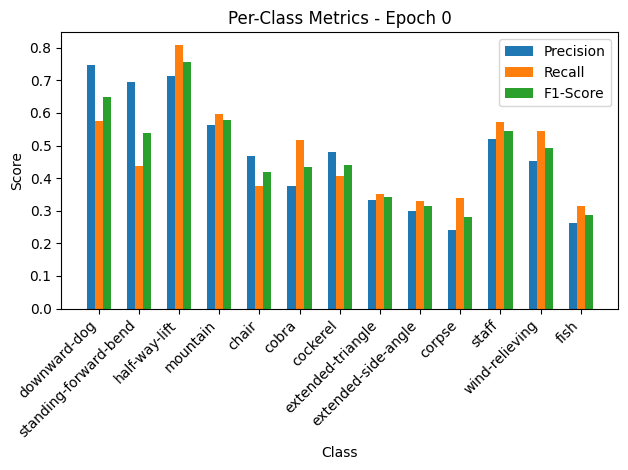

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.64it/s, loss=2.24, accuracy=20.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.00, Recall=0.00, F1-Score=0.00
standing-forward-bend: Precision=0.00, Recall=0.00, F1-Score=0.00
half-way-lift: Precision=0.00, Recall=0.00, F1-Score=0.00
mountain: Precision=0.00, Recall=0.00, F1-Score=0.00
chair: Precision=0.12, Recall=0.91, F1-Score=0.21
cobra: Precision=1.00, Recall=0.10, F1-Score=0.18
cockerel: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.14, Recall=0.62, F1-Score=0.23
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.00, Recall=0.00, F1-Score=0.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.44, Recall=0.88, F1-Score=0.58


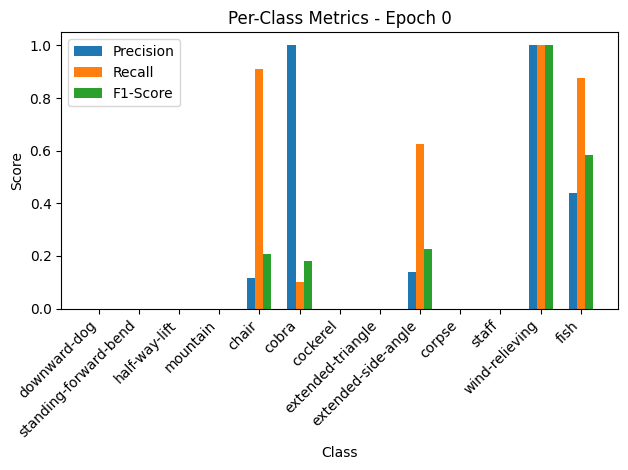


Epoch 1/50 Summary:
Train Loss: 1.6527 | Train Acc: 50.15% | Train Precision: 0.47 | Train Recall: 0.47 | Train F1: 0.47
Val Loss: 2.4570 | Val Acc: 20.55% | Val Precision: 0.21 | Val Recall: 0.27 | Val F1: 0.17
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 2.4570

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.61it/s, loss=0.929, accuracy=69.3]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.89, Recall=0.76, F1-Score=0.82
standing-forward-bend: Precision=0.80, Recall=0.65, F1-Score=0.72
half-way-lift: Precision=0.76, Recall=0.86, F1-Score=0.81
mountain: Precision=0.68, Recall=0.66, F1-Score=0.67
chair: Precision=0.55, Recall=0.57, F1-Score=0.56
cobra: Precision=0.74, Recall=0.78, F1-Score=0.76
cockerel: Precision=0.75, Recall=0.73, F1-Score=0.74
extended-triangle: Precision=0.55, Recall=0.66, F1-Score=0.60
extended-side-angle: Precision=0.55, Recall=0.56, F1-Score=0.56
corpse: Precision=0.49, Recall=0.43, F1-Score=0.46
staff: Precision=0.73, Recall=0.87, F1-Score=0.79
wind-relieving: Precision=0.66, Recall=0.76, F1-Score=0.71
fish: Precision=0.51, Recall=0.51, F1-Score=0.51


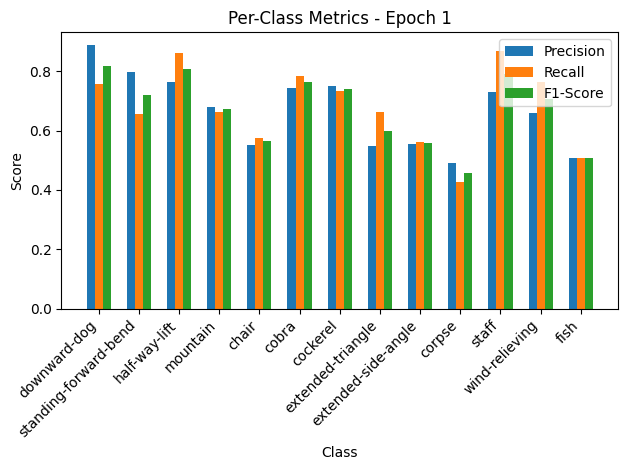

Validation: 100%|██████████| 10/10 [00:00<00:00, 51.48it/s, loss=1.75, accuracy=33.6]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.00, Recall=0.00, F1-Score=0.00
standing-forward-bend: Precision=0.00, Recall=0.00, F1-Score=0.00
half-way-lift: Precision=0.00, Recall=0.00, F1-Score=0.00
mountain: Precision=0.55, Recall=0.92, F1-Score=0.69
chair: Precision=0.24, Recall=0.91, F1-Score=0.38
cobra: Precision=0.00, Recall=0.00, F1-Score=0.00
cockerel: Precision=0.56, Recall=0.90, F1-Score=0.69
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.14, Recall=0.88, F1-Score=0.25
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=0.14, F1-Score=0.25
fish: Precision=0.43, Recall=0.38, F1-Score=0.40


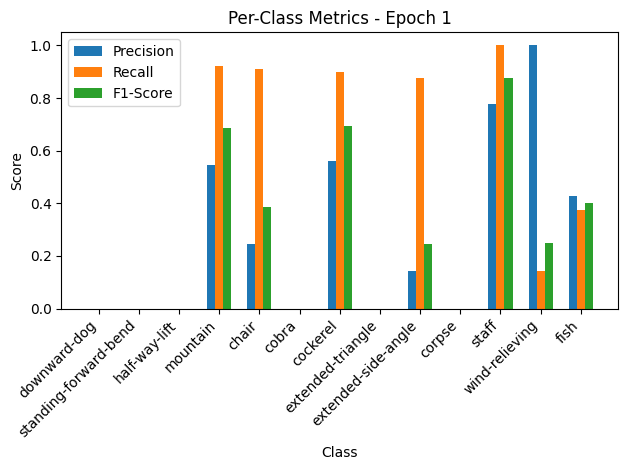


Epoch 2/50 Summary:
Train Loss: 0.9319 | Train Acc: 69.34% | Train Precision: 0.67 | Train Recall: 0.68 | Train F1: 0.67
Val Loss: 1.9128 | Val Acc: 33.56% | Val Precision: 0.28 | Val Recall: 0.39 | Val F1: 0.27
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 1.9128

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:05<00:00, 14.38it/s, loss=0.729, accuracy=77.1]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.89, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=0.83, Recall=0.77, F1-Score=0.80
half-way-lift: Precision=0.82, Recall=0.85, F1-Score=0.84
mountain: Precision=0.78, Recall=0.82, F1-Score=0.80
chair: Precision=0.80, Recall=0.73, F1-Score=0.77
cobra: Precision=0.86, Recall=0.88, F1-Score=0.87
cockerel: Precision=0.81, Recall=0.84, F1-Score=0.82
extended-triangle: Precision=0.62, Recall=0.64, F1-Score=0.63
extended-side-angle: Precision=0.51, Recall=0.53, F1-Score=0.52
corpse: Precision=0.54, Recall=0.49, F1-Score=0.51
staff: Precision=0.84, Recall=0.94, F1-Score=0.89
wind-relieving: Precision=0.80, Recall=0.78, F1-Score=0.79
fish: Precision=0.57, Recall=0.64, F1-Score=0.61


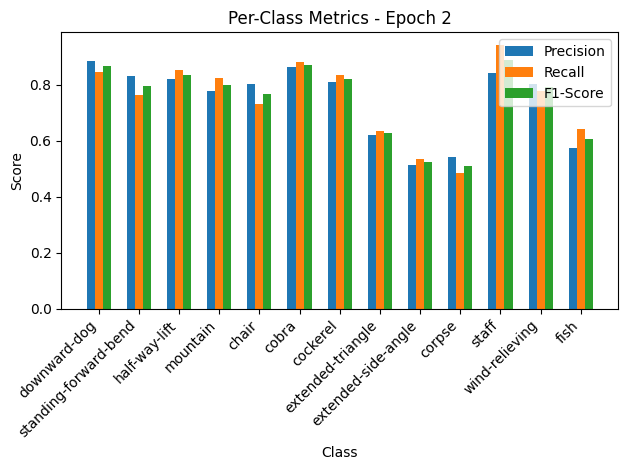

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.77it/s, loss=0.834, accuracy=71.9]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=1.00, Recall=0.65, F1-Score=0.79
standing-forward-bend: Precision=1.00, Recall=0.39, F1-Score=0.56
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.79, Recall=0.85, F1-Score=0.81
chair: Precision=0.36, Recall=0.91, F1-Score=0.51
cobra: Precision=1.00, Recall=0.50, F1-Score=0.67
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.83, Recall=0.56, F1-Score=0.67
extended-side-angle: Precision=0.54, Recall=0.88, F1-Score=0.67
corpse: Precision=0.67, Recall=0.50, F1-Score=0.57
staff: Precision=0.75, Recall=0.86, F1-Score=0.80
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.83, Recall=0.62, F1-Score=0.71


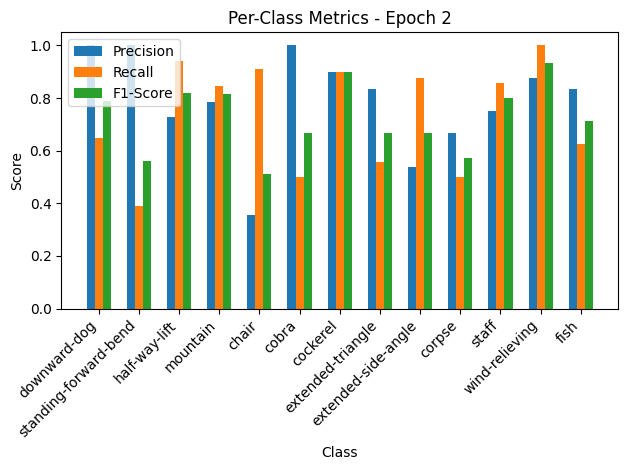


Epoch 3/50 Summary:
Train Loss: 0.7314 | Train Acc: 77.06% | Train Precision: 0.75 | Train Recall: 0.75 | Train F1: 0.75
Val Loss: 0.9138 | Val Acc: 71.92% | Val Precision: 0.79 | Val Recall: 0.73 | Val F1: 0.72
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.9138

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.88it/s, loss=0.625, accuracy=80]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.89, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=0.89, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.85, Recall=0.89, F1-Score=0.87
mountain: Precision=0.83, Recall=0.82, F1-Score=0.82
chair: Precision=0.77, Recall=0.81, F1-Score=0.79
cobra: Precision=0.87, Recall=0.82, F1-Score=0.84
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.68, Recall=0.70, F1-Score=0.69
extended-side-angle: Precision=0.66, Recall=0.68, F1-Score=0.67
corpse: Precision=0.53, Recall=0.50, F1-Score=0.52
staff: Precision=0.83, Recall=0.93, F1-Score=0.88
wind-relieving: Precision=0.82, Recall=0.88, F1-Score=0.85
fish: Precision=0.57, Recall=0.58, F1-Score=0.58


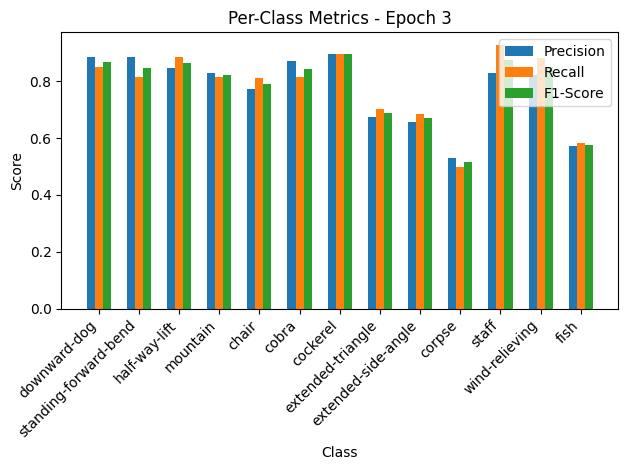

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.91it/s, loss=1.01, accuracy=63]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 3:
downward-dog: Precision=1.00, Recall=0.60, F1-Score=0.75
standing-forward-bend: Precision=1.00, Recall=0.50, F1-Score=0.67
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.67, Recall=0.92, F1-Score=0.77
chair: Precision=0.33, Recall=0.91, F1-Score=0.49
cobra: Precision=0.59, Recall=1.00, F1-Score=0.74
cockerel: Precision=1.00, Recall=0.30, F1-Score=0.46
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.40, Recall=0.75, F1-Score=0.52
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.80, Recall=0.57, F1-Score=0.67
wind-relieving: Precision=0.00, Recall=0.00, F1-Score=0.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


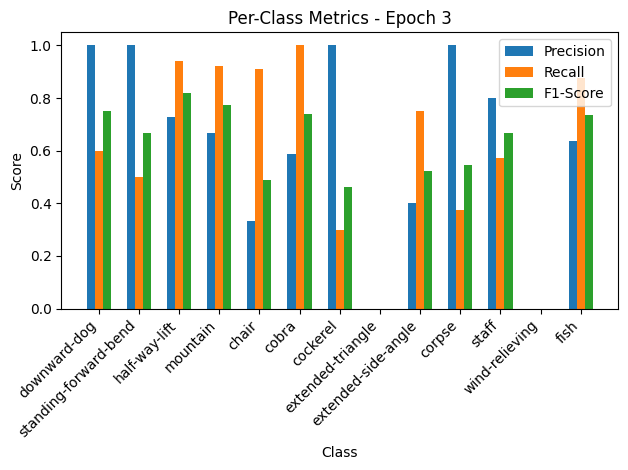


Epoch 4/50 Summary:
Train Loss: 0.6274 | Train Acc: 80.05% | Train Precision: 0.78 | Train Recall: 0.78 | Train F1: 0.78
Val Loss: 1.1079 | Val Acc: 63.01% | Val Precision: 0.63 | Val Recall: 0.60 | Val F1: 0.55

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 13.25it/s, loss=0.571, accuracy=80.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.87, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.82, Recall=0.87, F1-Score=0.85
mountain: Precision=0.80, Recall=0.87, F1-Score=0.84
chair: Precision=0.82, Recall=0.74, F1-Score=0.78
cobra: Precision=0.90, Recall=0.88, F1-Score=0.89
cockerel: Precision=0.81, Recall=0.87, F1-Score=0.84
extended-triangle: Precision=0.72, Recall=0.70, F1-Score=0.71
extended-side-angle: Precision=0.60, Recall=0.62, F1-Score=0.61
corpse: Precision=0.56, Recall=0.53, F1-Score=0.55
staff: Precision=0.82, Recall=0.90, F1-Score=0.86
wind-relieving: Precision=0.89, Recall=0.87, F1-Score=0.88
fish: Precision=0.63, Recall=0.69, F1-Score=0.66


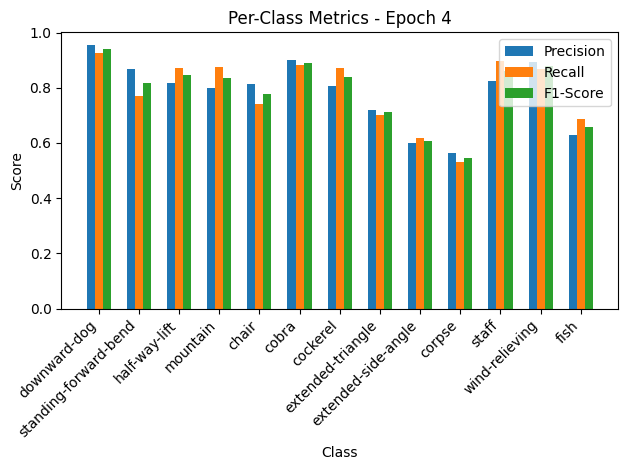

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.69it/s, loss=0.678, accuracy=74.7]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.73, Recall=0.95, F1-Score=0.83
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.76, Recall=1.00, F1-Score=0.87
chair: Precision=1.00, Recall=0.55, F1-Score=0.71
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.20, F1-Score=0.33
extended-triangle: Precision=0.64, Recall=1.00, F1-Score=0.78
extended-side-angle: Precision=1.00, Recall=0.25, F1-Score=0.40
corpse: Precision=0.44, Recall=0.88, F1-Score=0.58
staff: Precision=0.50, Recall=1.00, F1-Score=0.67
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


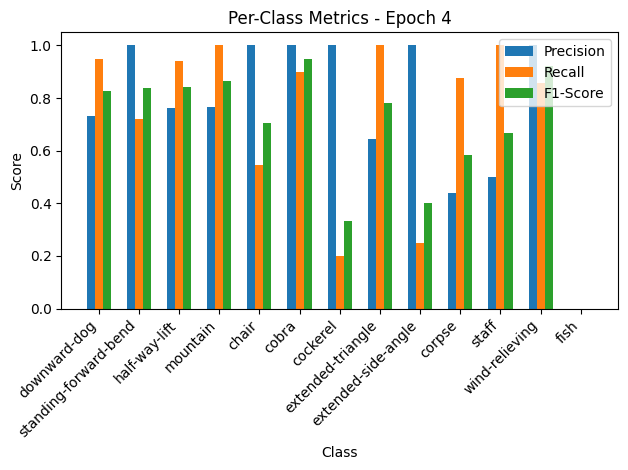


Epoch 5/50 Summary:
Train Loss: 0.5727 | Train Acc: 80.73% | Train Precision: 0.78 | Train Recall: 0.79 | Train F1: 0.78
Val Loss: 0.7427 | Val Acc: 74.66% | Val Precision: 0.76 | Val Recall: 0.71 | Val F1: 0.67
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.7427

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:05<00:00, 13.88it/s, loss=0.55, accuracy=81.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.88
mountain: Precision=0.79, Recall=0.81, F1-Score=0.80
chair: Precision=0.78, Recall=0.84, F1-Score=0.81
cobra: Precision=0.94, Recall=0.91, F1-Score=0.93
cockerel: Precision=0.83, Recall=0.84, F1-Score=0.83
extended-triangle: Precision=0.70, Recall=0.74, F1-Score=0.72
extended-side-angle: Precision=0.73, Recall=0.62, F1-Score=0.67
corpse: Precision=0.54, Recall=0.66, F1-Score=0.60
staff: Precision=0.86, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.59, Recall=0.51, F1-Score=0.54


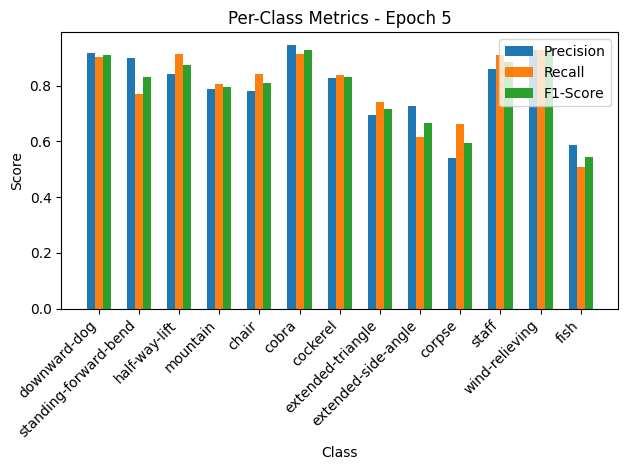

Validation: 100%|██████████| 10/10 [00:00<00:00, 45.12it/s, loss=0.626, accuracy=76.7]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=1.00, Recall=0.55, F1-Score=0.71
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=0.70, F1-Score=0.82
cockerel: Precision=0.62, Recall=1.00, F1-Score=0.77
extended-triangle: Precision=1.00, Recall=0.44, F1-Score=0.62
extended-side-angle: Precision=0.41, Recall=0.88, F1-Score=0.56
corpse: Precision=0.60, Recall=0.75, F1-Score=0.67
staff: Precision=0.75, Recall=0.86, F1-Score=0.80
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.75, Recall=0.38, F1-Score=0.50


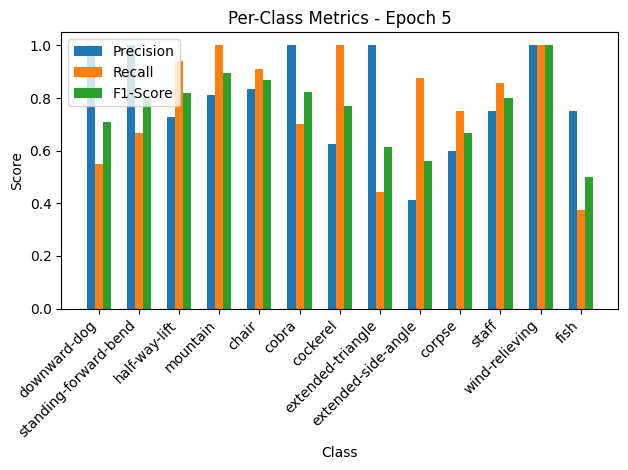


Epoch 6/50 Summary:
Train Loss: 0.5521 | Train Acc: 81.42% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.6860 | Val Acc: 76.71% | Val Precision: 0.81 | Val Recall: 0.77 | Val F1: 0.76
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.6860

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.00it/s, loss=0.563, accuracy=81.3]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=0.88, Recall=0.79, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.89, F1-Score=0.86
mountain: Precision=0.86, Recall=0.84, F1-Score=0.85
chair: Precision=0.85, Recall=0.87, F1-Score=0.86
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.85, Recall=0.85, F1-Score=0.85
extended-triangle: Precision=0.71, Recall=0.70, F1-Score=0.71
extended-side-angle: Precision=0.63, Recall=0.68, F1-Score=0.66
corpse: Precision=0.58, Recall=0.56, F1-Score=0.57
staff: Precision=0.80, Recall=0.88, F1-Score=0.84
wind-relieving: Precision=0.86, Recall=0.84, F1-Score=0.85
fish: Precision=0.52, Recall=0.51, F1-Score=0.52


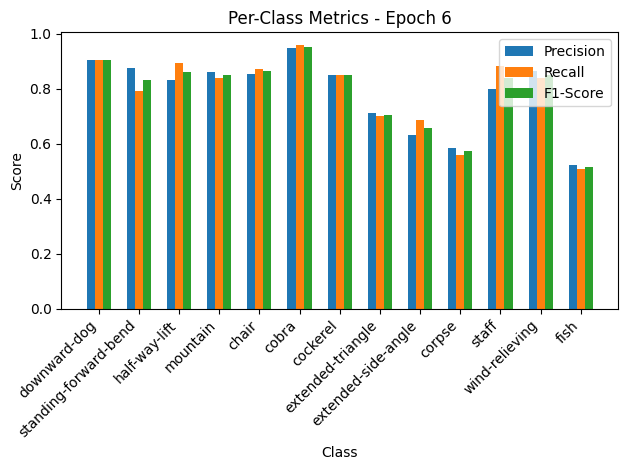

Validation: 100%|██████████| 10/10 [00:00<00:00, 45.78it/s, loss=0.578, accuracy=81.5]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.85, Recall=0.85, F1-Score=0.85
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.71, Recall=0.91, F1-Score=0.80
cobra: Precision=0.71, Recall=1.00, F1-Score=0.83
cockerel: Precision=1.00, Recall=0.70, F1-Score=0.82
extended-triangle: Precision=0.75, Recall=1.00, F1-Score=0.86
extended-side-angle: Precision=1.00, Recall=0.38, F1-Score=0.55
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.54, Recall=0.88, F1-Score=0.67


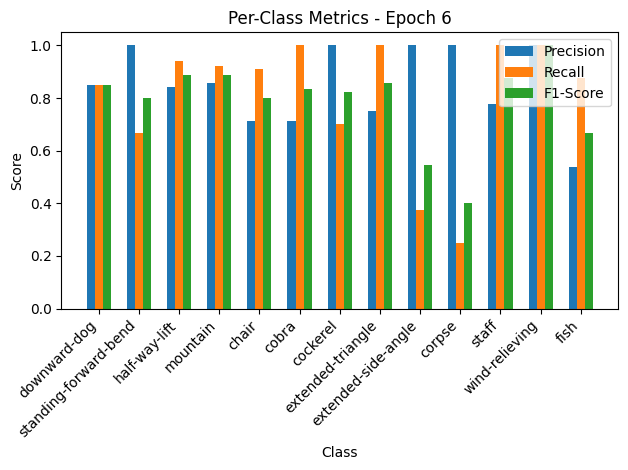


Epoch 7/50 Summary:
Train Loss: 0.5651 | Train Acc: 81.35% | Train Precision: 0.79 | Train Recall: 0.79 | Train F1: 0.79
Val Loss: 0.6332 | Val Acc: 81.51% | Val Precision: 0.85 | Val Recall: 0.81 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.6332

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:05<00:00, 14.05it/s, loss=0.51, accuracy=83.5]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.93, Recall=0.86, F1-Score=0.89
standing-forward-bend: Precision=0.92, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.85, Recall=0.93, F1-Score=0.89
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.94, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.88, Recall=0.83, F1-Score=0.85
extended-triangle: Precision=0.73, Recall=0.81, F1-Score=0.77
extended-side-angle: Precision=0.76, Recall=0.71, F1-Score=0.74
corpse: Precision=0.59, Recall=0.54, F1-Score=0.56
staff: Precision=0.84, Recall=0.90, F1-Score=0.87
wind-relieving: Precision=0.94, Recall=0.96, F1-Score=0.95
fish: Precision=0.57, Recall=0.58, F1-Score=0.57


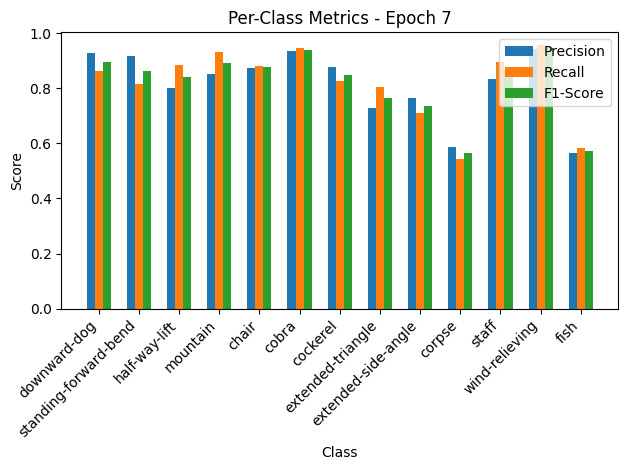

Validation: 100%|██████████| 10/10 [00:00<00:00, 44.85it/s, loss=0.459, accuracy=84.2]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=1.00, Recall=0.60, F1-Score=0.75
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.75, Recall=1.00, F1-Score=0.86
extended-side-angle: Precision=0.57, Recall=0.50, F1-Score=0.53
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=0.70, Recall=1.00, F1-Score=0.82
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


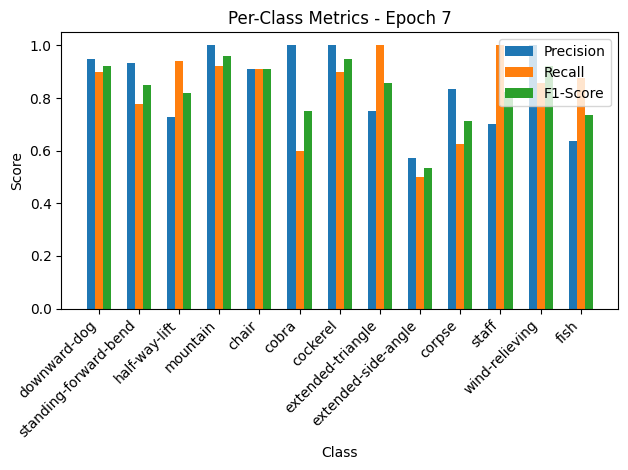


Epoch 8/50 Summary:
Train Loss: 0.5111 | Train Acc: 83.49% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5025 | Val Acc: 84.25% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 8
New best model saved! Validation Loss: 0.5025

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.63it/s, loss=0.536, accuracy=82.3]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.95, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.83, Recall=0.77, F1-Score=0.79
half-way-lift: Precision=0.81, Recall=0.88, F1-Score=0.84
mountain: Precision=0.84, Recall=0.87, F1-Score=0.85
chair: Precision=0.86, Recall=0.79, F1-Score=0.82
cobra: Precision=0.90, Recall=0.96, F1-Score=0.93
cockerel: Precision=0.87, Recall=0.85, F1-Score=0.86
extended-triangle: Precision=0.72, Recall=0.68, F1-Score=0.70
extended-side-angle: Precision=0.69, Recall=0.81, F1-Score=0.75
corpse: Precision=0.62, Recall=0.62, F1-Score=0.62
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.88, Recall=0.90, F1-Score=0.89
fish: Precision=0.63, Recall=0.64, F1-Score=0.64


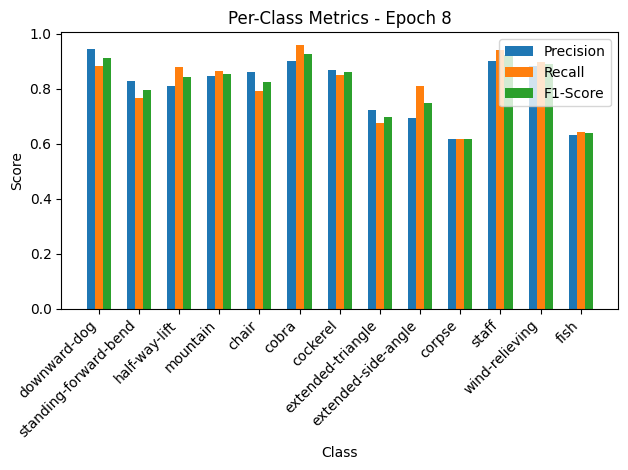

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.01it/s, loss=0.521, accuracy=82.9]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.72, Recall=1.00, F1-Score=0.84
chair: Precision=1.00, Recall=0.55, F1-Score=0.71
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.67, Recall=0.50, F1-Score=0.57
staff: Precision=0.86, Recall=0.86, F1-Score=0.86
wind-relieving: Precision=1.00, Recall=0.29, F1-Score=0.44
fish: Precision=0.47, Recall=0.88, F1-Score=0.61


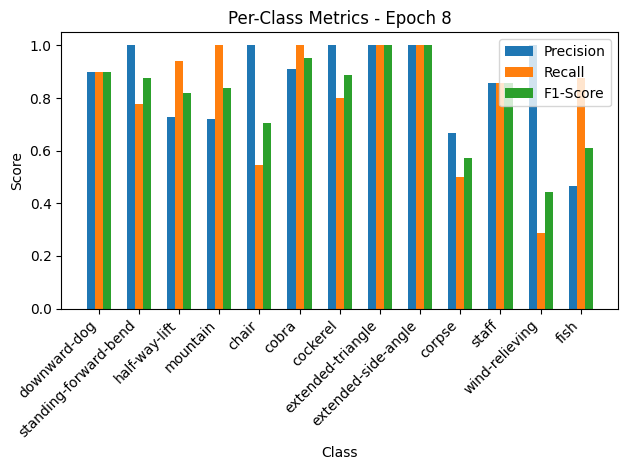


Epoch 9/50 Summary:
Train Loss: 0.5376 | Train Acc: 82.34% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.5708 | Val Acc: 82.88% | Val Precision: 0.87 | Val Recall: 0.81 | Val F1: 0.80

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:05<00:00, 13.88it/s, loss=0.52, accuracy=83.5]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.92, Recall=0.76, F1-Score=0.83
half-way-lift: Precision=0.80, Recall=0.93, F1-Score=0.86
mountain: Precision=0.86, Recall=0.86, F1-Score=0.86
chair: Precision=0.84, Recall=0.86, F1-Score=0.85
cobra: Precision=0.88, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.74, Recall=0.74, F1-Score=0.74
extended-side-angle: Precision=0.76, Recall=0.78, F1-Score=0.77
corpse: Precision=0.66, Recall=0.56, F1-Score=0.60
staff: Precision=0.88, Recall=0.96, F1-Score=0.92
wind-relieving: Precision=0.91, Recall=0.88, F1-Score=0.90
fish: Precision=0.61, Recall=0.69, F1-Score=0.64


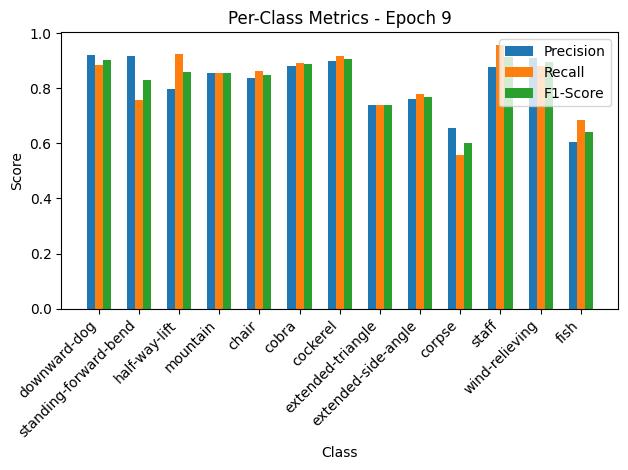

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.56it/s, loss=0.935, accuracy=68.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.94, Recall=0.75, F1-Score=0.83
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.42, Recall=0.91, F1-Score=0.57
cobra: Precision=0.33, Recall=0.10, F1-Score=0.15
cockerel: Precision=0.67, Recall=1.00, F1-Score=0.80
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.25, F1-Score=0.40
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.71, Recall=0.71, F1-Score=0.71
wind-relieving: Precision=0.37, Recall=1.00, F1-Score=0.54
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


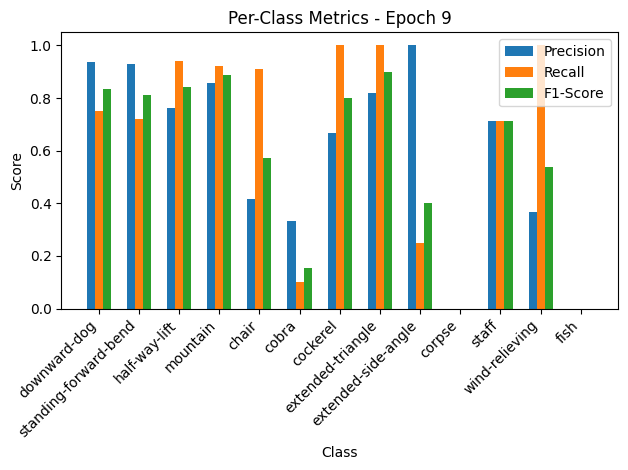


Epoch 10/50 Summary:
Train Loss: 0.5217 | Train Acc: 83.49% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 1.0249 | Val Acc: 68.49% | Val Precision: 0.60 | Val Recall: 0.64 | Val F1: 0.57

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 11.77it/s, loss=0.491, accuracy=84.1]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=0.90, F1-Score=0.85
mountain: Precision=0.89, Recall=0.91, F1-Score=0.90
chair: Precision=0.86, Recall=0.88, F1-Score=0.87
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.91, Recall=0.81, F1-Score=0.86
extended-triangle: Precision=0.73, Recall=0.73, F1-Score=0.73
extended-side-angle: Precision=0.74, Recall=0.77, F1-Score=0.75
corpse: Precision=0.65, Recall=0.59, F1-Score=0.62
staff: Precision=0.86, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.90, Recall=0.96, F1-Score=0.93
fish: Precision=0.59, Recall=0.61, F1-Score=0.60


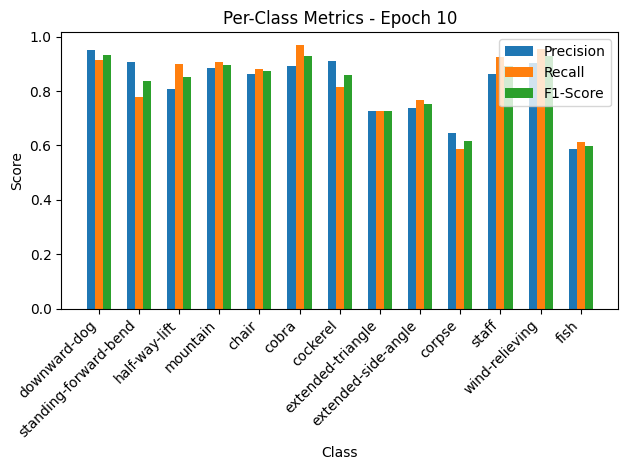

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.82it/s, loss=0.449, accuracy=84.9]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.94, Recall=0.85, F1-Score=0.89
standing-forward-bend: Precision=1.00, Recall=0.56, F1-Score=0.71
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.67, Recall=0.92, F1-Score=0.77
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.71, Recall=0.62, F1-Score=0.67
staff: Precision=1.00, Recall=0.71, F1-Score=0.83
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.67, Recall=0.75, F1-Score=0.71


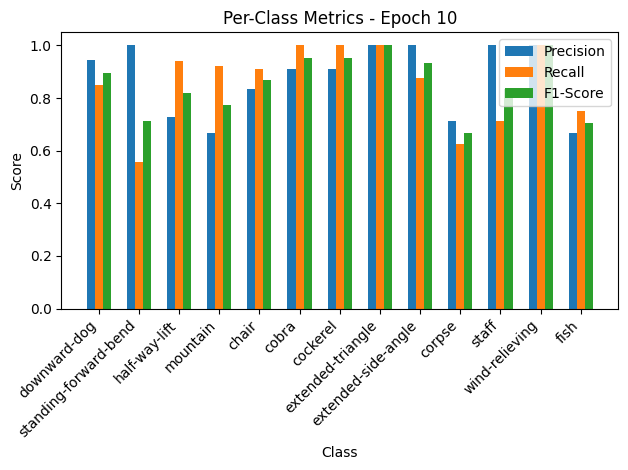


Epoch 11/50 Summary:
Train Loss: 0.4926 | Train Acc: 84.10% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.4916 | Val Acc: 84.93% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.86
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.4916

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.44it/s, loss=0.476, accuracy=85.6]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.89, Recall=0.85, F1-Score=0.87
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.87, Recall=0.93, F1-Score=0.90
extended-triangle: Precision=0.81, Recall=0.86, F1-Score=0.84
extended-side-angle: Precision=0.82, Recall=0.79, F1-Score=0.81
corpse: Precision=0.66, Recall=0.59, F1-Score=0.62
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.61, Recall=0.64, F1-Score=0.62


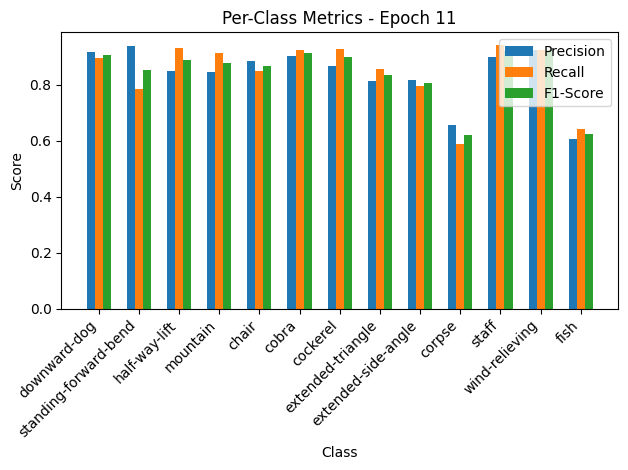

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.87it/s, loss=0.486, accuracy=82.9]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.67, Recall=0.94, F1-Score=0.78
mountain: Precision=0.68, Recall=1.00, F1-Score=0.81
chair: Precision=1.00, Recall=0.64, F1-Score=0.78
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.86, Recall=0.67, F1-Score=0.75
extended-side-angle: Precision=0.70, Recall=0.88, F1-Score=0.78
corpse: Precision=0.80, Recall=0.50, F1-Score=0.62
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


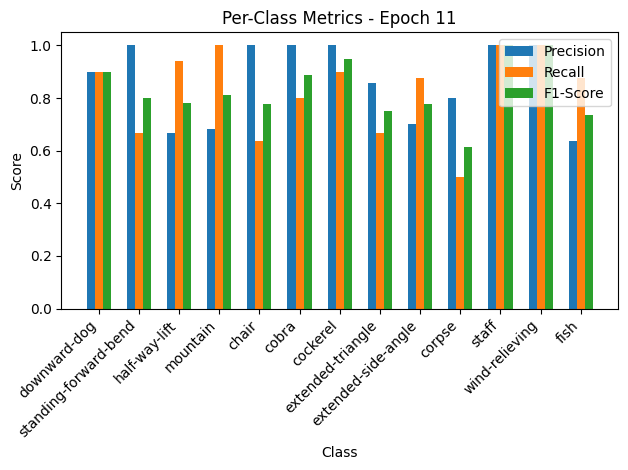


Epoch 12/50 Summary:
Train Loss: 0.4779 | Train Acc: 85.63% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84
Val Loss: 0.5328 | Val Acc: 82.88% | Val Precision: 0.86 | Val Recall: 0.83 | Val F1: 0.83

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.13it/s, loss=0.466, accuracy=85.4]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.79, F1-Score=0.85
half-way-lift: Precision=0.85, Recall=0.90, F1-Score=0.87
mountain: Precision=0.86, Recall=0.90, F1-Score=0.88
chair: Precision=0.88, Recall=0.84, F1-Score=0.86
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.83, Recall=0.93, F1-Score=0.88
extended-triangle: Precision=0.80, Recall=0.82, F1-Score=0.81
extended-side-angle: Precision=0.78, Recall=0.85, F1-Score=0.81
corpse: Precision=0.65, Recall=0.60, F1-Score=0.63
staff: Precision=0.90, Recall=0.91, F1-Score=0.91
wind-relieving: Precision=0.91, Recall=0.90, F1-Score=0.90
fish: Precision=0.64, Recall=0.70, F1-Score=0.67


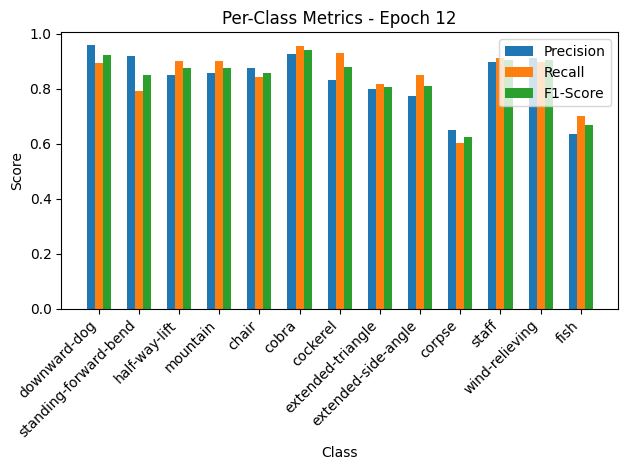

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.72it/s, loss=0.619, accuracy=78.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.89, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=1.00, Recall=0.44, F1-Score=0.62
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.54, Recall=1.00, F1-Score=0.70
chair: Precision=1.00, Recall=0.36, F1-Score=0.53
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.59, Recall=1.00, F1-Score=0.74
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.80, Recall=0.50, F1-Score=0.62
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=0.43, F1-Score=0.60
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


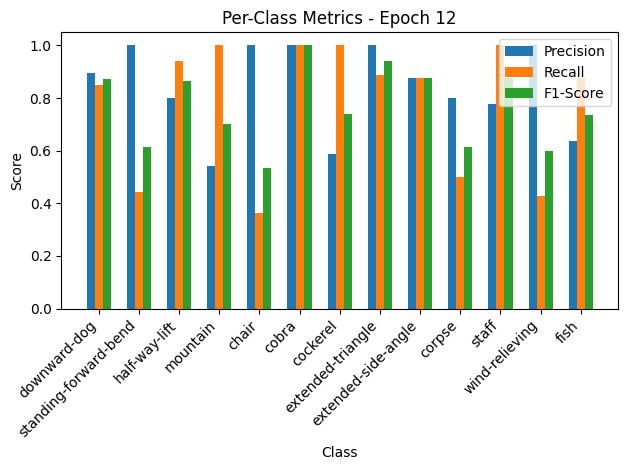


Epoch 13/50 Summary:
Train Loss: 0.4677 | Train Acc: 85.40% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84
Val Loss: 0.6778 | Val Acc: 78.08% | Val Precision: 0.84 | Val Recall: 0.78 | Val F1: 0.77

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.91it/s, loss=0.524, accuracy=83.3]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.90, Recall=0.88, F1-Score=0.89
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.85, Recall=0.91, F1-Score=0.88
mountain: Precision=0.85, Recall=0.92, F1-Score=0.88
chair: Precision=0.86, Recall=0.86, F1-Score=0.86
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.87, Recall=0.92, F1-Score=0.89
extended-triangle: Precision=0.72, Recall=0.69, F1-Score=0.70
extended-side-angle: Precision=0.69, Recall=0.70, F1-Score=0.69
corpse: Precision=0.67, Recall=0.50, F1-Score=0.57
staff: Precision=0.89, Recall=0.91, F1-Score=0.90
wind-relieving: Precision=0.85, Recall=0.97, F1-Score=0.90
fish: Precision=0.60, Recall=0.67, F1-Score=0.63


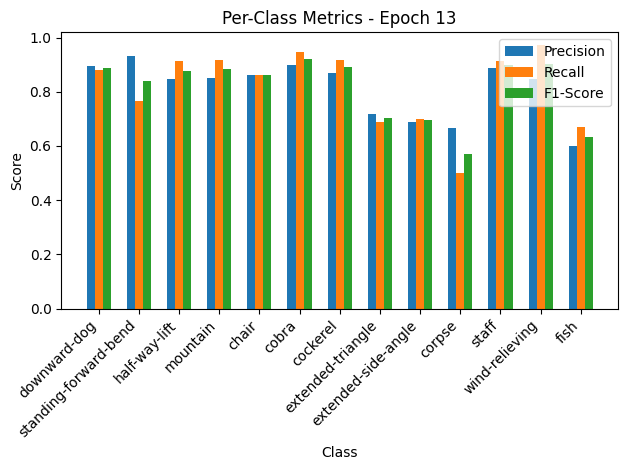

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.90it/s, loss=0.468, accuracy=81.5]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.85, Recall=0.85, F1-Score=0.85
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.75, Recall=0.92, F1-Score=0.83
chair: Precision=0.73, Recall=0.73, F1-Score=0.73
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.75, Recall=0.33, F1-Score=0.46
extended-side-angle: Precision=0.54, Recall=0.88, F1-Score=0.67
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.57, Recall=1.00, F1-Score=0.73


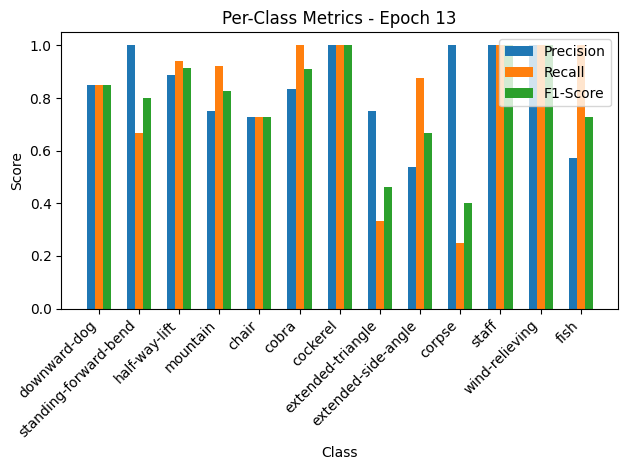


Epoch 14/50 Summary:
Train Loss: 0.5253 | Train Acc: 83.33% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.5127 | Val Acc: 81.51% | Val Precision: 0.84 | Val Recall: 0.81 | Val F1: 0.79

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.96it/s, loss=0.538, accuracy=82.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.91, Recall=0.82, F1-Score=0.86
standing-forward-bend: Precision=0.86, Recall=0.75, F1-Score=0.80
half-way-lift: Precision=0.82, Recall=0.86, F1-Score=0.84
mountain: Precision=0.78, Recall=0.88, F1-Score=0.83
chair: Precision=0.88, Recall=0.81, F1-Score=0.85
cobra: Precision=0.88, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.80, Recall=0.81, F1-Score=0.81
extended-triangle: Precision=0.72, Recall=0.81, F1-Score=0.76
extended-side-angle: Precision=0.78, Recall=0.73, F1-Score=0.75
corpse: Precision=0.69, Recall=0.66, F1-Score=0.68
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.65, Recall=0.70, F1-Score=0.68


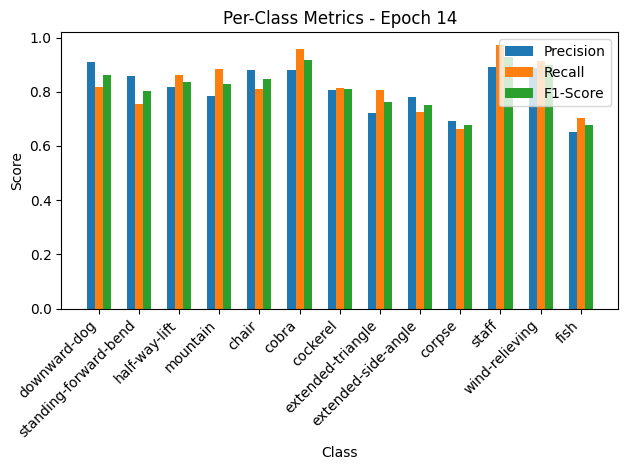

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.01it/s, loss=0.431, accuracy=86.3]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=1.00, Recall=0.90, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.70, Recall=0.94, F1-Score=0.80
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.62, F1-Score=0.77
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.70, Recall=1.00, F1-Score=0.82
wind-relieving: Precision=1.00, Recall=0.71, F1-Score=0.83
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


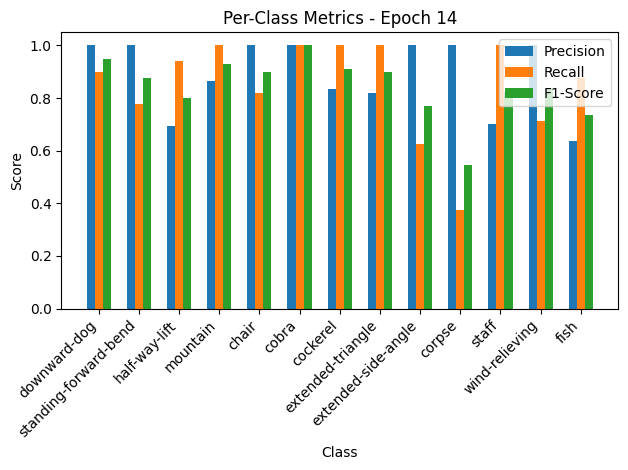


Epoch 15/50 Summary:
Train Loss: 0.5397 | Train Acc: 82.26% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.4723 | Val Acc: 86.30% | Val Precision: 0.89 | Val Recall: 0.85 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 15
New best model saved! Validation Loss: 0.4723

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.82it/s, loss=0.492, accuracy=84.9]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.93, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.75, F1-Score=0.83
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.84, Recall=0.90, F1-Score=0.87
chair: Precision=0.86, Recall=0.85, F1-Score=0.86
cobra: Precision=0.90, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.87, Recall=0.92, F1-Score=0.89
extended-triangle: Precision=0.75, Recall=0.74, F1-Score=0.75
extended-side-angle: Precision=0.73, Recall=0.73, F1-Score=0.73
corpse: Precision=0.68, Recall=0.57, F1-Score=0.62
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.67, Recall=0.73, F1-Score=0.70


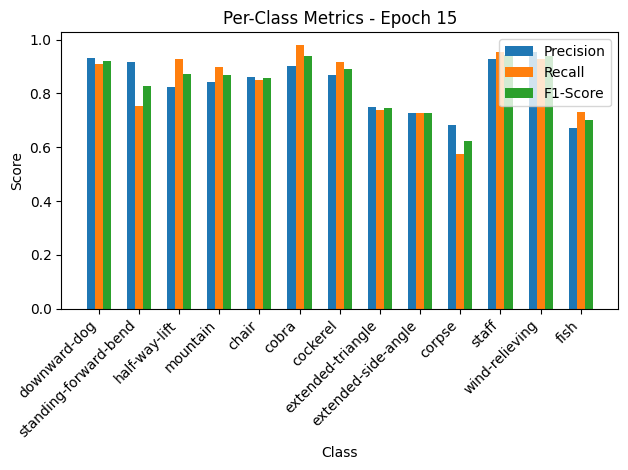

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.20it/s, loss=0.531, accuracy=82.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.44, Recall=0.88, F1-Score=0.58
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


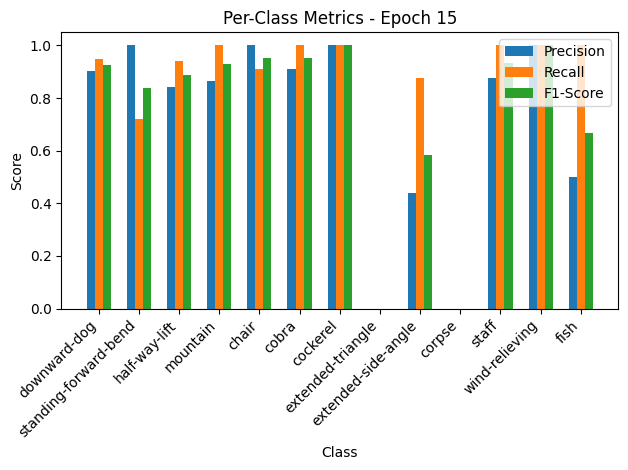


Epoch 16/50 Summary:
Train Loss: 0.4935 | Train Acc: 84.86% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.83
Val Loss: 0.5814 | Val Acc: 82.19% | Val Precision: 0.72 | Val Recall: 0.80 | Val F1: 0.74

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.39it/s, loss=0.493, accuracy=83.9]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.86, Recall=0.78, F1-Score=0.82
half-way-lift: Precision=0.82, Recall=0.85, F1-Score=0.83
mountain: Precision=0.87, Recall=0.92, F1-Score=0.90
chair: Precision=0.94, Recall=0.91, F1-Score=0.92
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.87, Recall=0.92, F1-Score=0.89
extended-triangle: Precision=0.67, Recall=0.68, F1-Score=0.67
extended-side-angle: Precision=0.68, Recall=0.74, F1-Score=0.71
corpse: Precision=0.61, Recall=0.60, F1-Score=0.61
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.64, Recall=0.64, F1-Score=0.64


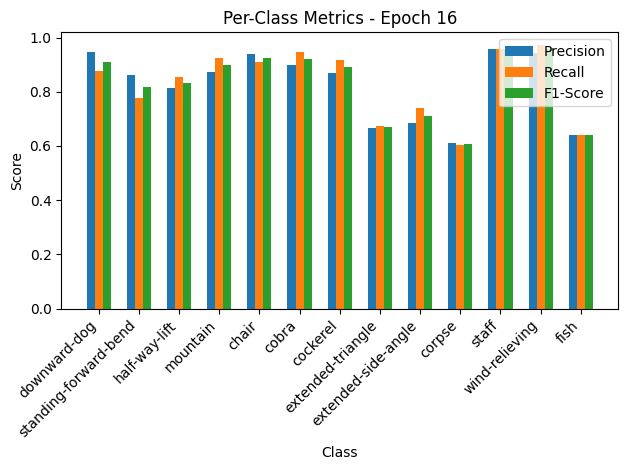

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.17it/s, loss=0.419, accuracy=84.2]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=0.82, Recall=0.78, F1-Score=0.80
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.85, Recall=0.85, F1-Score=0.85
chair: Precision=0.89, Recall=0.73, F1-Score=0.80
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.64, Recall=1.00, F1-Score=0.78
extended-side-angle: Precision=1.00, Recall=0.25, F1-Score=0.40
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


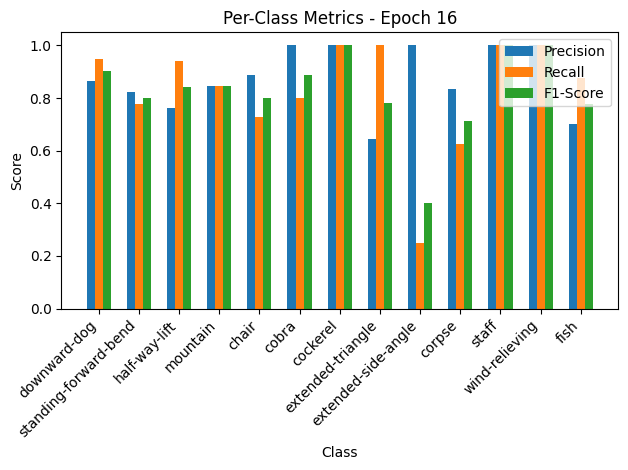


Epoch 17/50 Summary:
Train Loss: 0.4943 | Train Acc: 83.94% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.4595 | Val Acc: 84.25% | Val Precision: 0.87 | Val Recall: 0.83 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 17
New best model saved! Validation Loss: 0.4595

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.57it/s, loss=0.524, accuracy=84.6]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.85, Recall=0.93, F1-Score=0.89
chair: Precision=0.89, Recall=0.84, F1-Score=0.87
cobra: Precision=0.91, Recall=0.89, F1-Score=0.90
cockerel: Precision=0.84, Recall=0.83, F1-Score=0.83
extended-triangle: Precision=0.82, Recall=0.69, F1-Score=0.75
extended-side-angle: Precision=0.69, Recall=0.82, F1-Score=0.75
corpse: Precision=0.64, Recall=0.71, F1-Score=0.67
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.86, Recall=0.97, F1-Score=0.91
fish: Precision=0.68, Recall=0.58, F1-Score=0.63


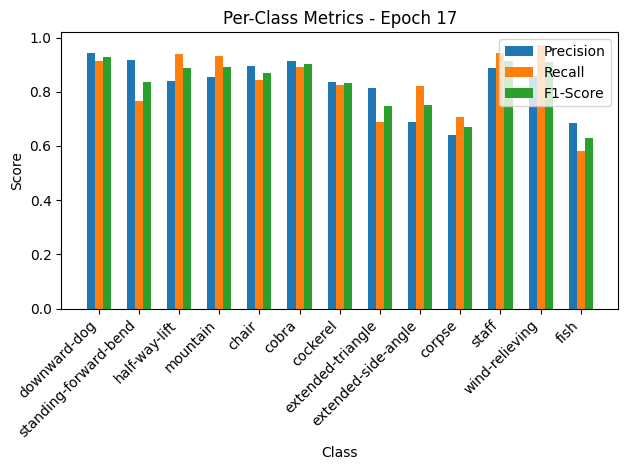

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.13it/s, loss=0.401, accuracy=86.3]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.69, Recall=1.00, F1-Score=0.82
extended-side-angle: Precision=1.00, Recall=0.38, F1-Score=0.55
corpse: Precision=0.57, Recall=1.00, F1-Score=0.73
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.25, F1-Score=0.40


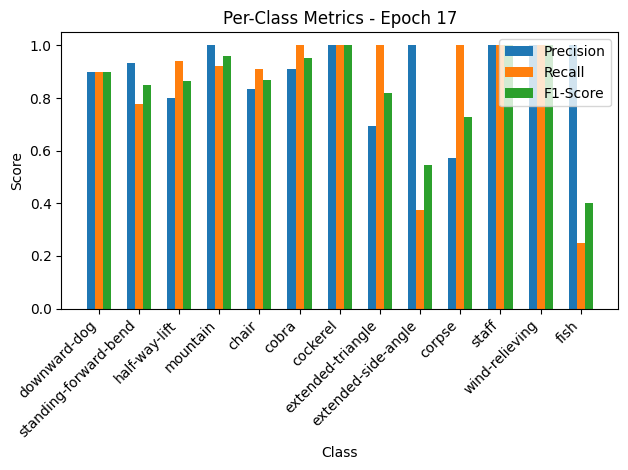


Epoch 18/50 Summary:
Train Loss: 0.5259 | Train Acc: 84.56% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.4393 | Val Acc: 86.30% | Val Precision: 0.90 | Val Recall: 0.85 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.4393

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.59it/s, loss=0.471, accuracy=85.8]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.75, F1-Score=0.83
half-way-lift: Precision=0.84, Recall=0.89, F1-Score=0.86
mountain: Precision=0.84, Recall=0.91, F1-Score=0.87
chair: Precision=0.83, Recall=0.86, F1-Score=0.84
cobra: Precision=0.87, Recall=0.99, F1-Score=0.92
cockerel: Precision=0.87, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.82, Recall=0.88, F1-Score=0.85
extended-side-angle: Precision=0.82, Recall=0.81, F1-Score=0.81
corpse: Precision=0.73, Recall=0.76, F1-Score=0.75
staff: Precision=0.90, Recall=0.93, F1-Score=0.91
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.74, Recall=0.69, F1-Score=0.71


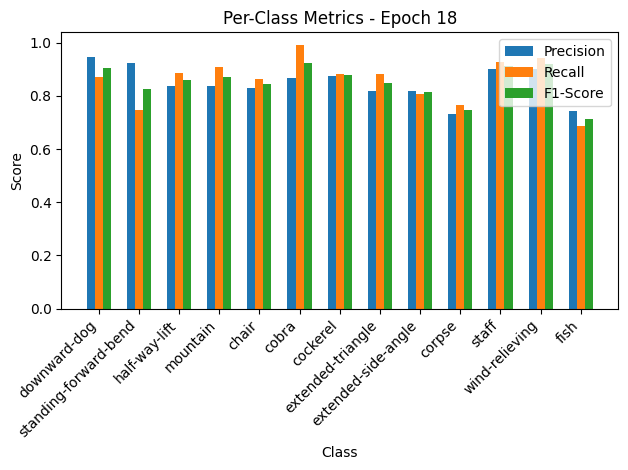

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.43it/s, loss=0.476, accuracy=82.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.44, F1-Score=0.62
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.63, Recall=0.92, F1-Score=0.75
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.70, F1-Score=0.82
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.70, Recall=1.00, F1-Score=0.82
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


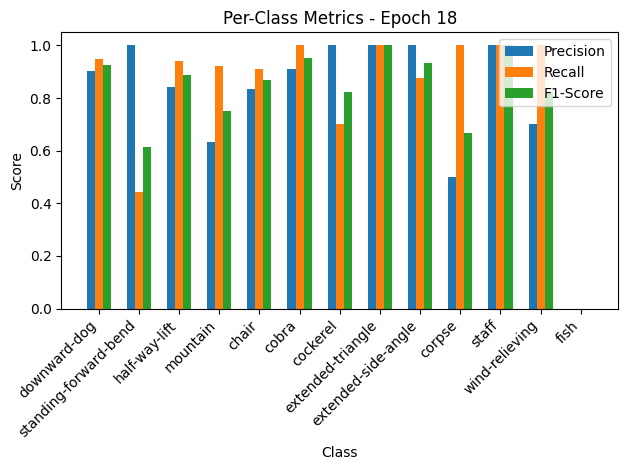


Epoch 19/50 Summary:
Train Loss: 0.4720 | Train Acc: 85.78% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.5222 | Val Acc: 82.19% | Val Precision: 0.79 | Val Recall: 0.83 | Val F1: 0.79

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.60it/s, loss=0.496, accuracy=85.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.94, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.96, Recall=0.79, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.89, Recall=0.90, F1-Score=0.90
cobra: Precision=0.90, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.86, Recall=0.87, F1-Score=0.87
extended-triangle: Precision=0.75, Recall=0.86, F1-Score=0.80
extended-side-angle: Precision=0.82, Recall=0.77, F1-Score=0.79
corpse: Precision=0.66, Recall=0.65, F1-Score=0.65
staff: Precision=0.89, Recall=0.93, F1-Score=0.91
wind-relieving: Precision=0.91, Recall=0.99, F1-Score=0.94
fish: Precision=0.65, Recall=0.63, F1-Score=0.64


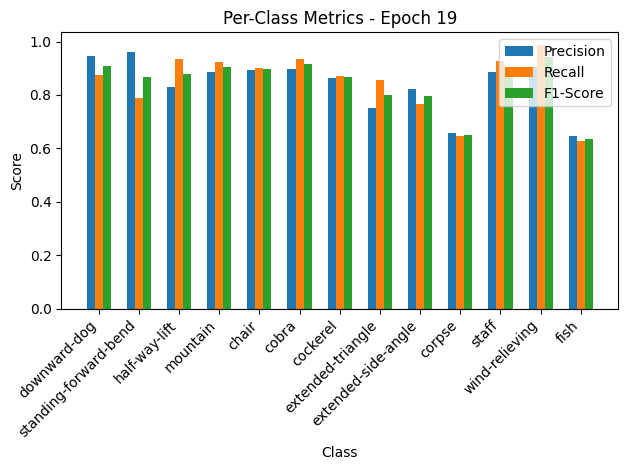

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.56it/s, loss=0.524, accuracy=87.7]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.88, Recall=0.88, F1-Score=0.88
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.62, F1-Score=0.77
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=0.54, Recall=1.00, F1-Score=0.70
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.80, Recall=0.50, F1-Score=0.62


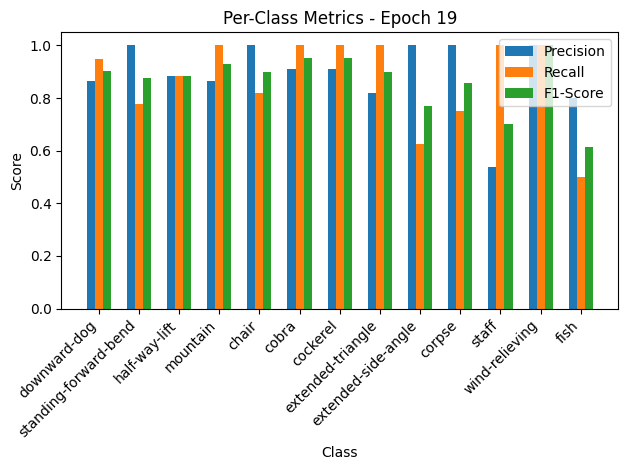


Epoch 20/50 Summary:
Train Loss: 0.4976 | Train Acc: 85.86% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84
Val Loss: 0.5745 | Val Acc: 87.67% | Val Precision: 0.89 | Val Recall: 0.87 | Val F1: 0.86

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.15it/s, loss=0.466, accuracy=86.8]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.90, Recall=0.75, F1-Score=0.82
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.91, Recall=0.90, F1-Score=0.91
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.83, Recall=0.95, F1-Score=0.89
extended-triangle: Precision=0.81, Recall=0.81, F1-Score=0.81
extended-side-angle: Precision=0.82, Recall=0.79, F1-Score=0.81
corpse: Precision=0.71, Recall=0.74, F1-Score=0.72
staff: Precision=0.93, Recall=0.93, F1-Score=0.93
wind-relieving: Precision=0.92, Recall=0.97, F1-Score=0.94
fish: Precision=0.74, Recall=0.63, F1-Score=0.68


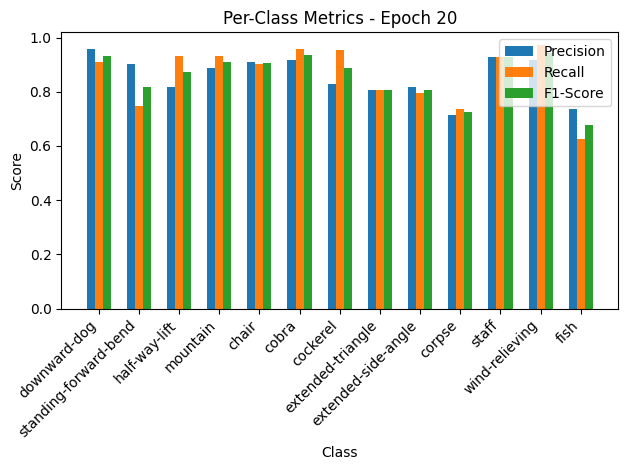

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.16it/s, loss=0.471, accuracy=87]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.83, Recall=1.00, F1-Score=0.91
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.77, Recall=0.91, F1-Score=0.83
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.54, Recall=0.88, F1-Score=0.67


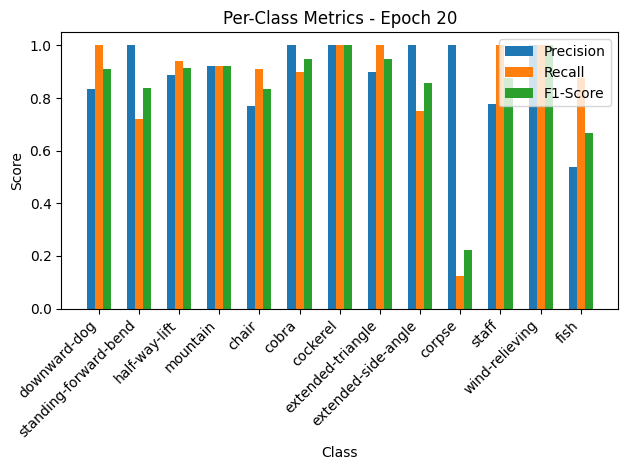


Epoch 21/50 Summary:
Train Loss: 0.4671 | Train Acc: 86.77% | Train Precision: 0.86 | Train Recall: 0.86 | Train F1: 0.86
Val Loss: 0.5165 | Val Acc: 86.99% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.84

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:06<00:00, 12.53it/s, loss=0.49, accuracy=86.6]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.88
mountain: Precision=0.85, Recall=0.90, F1-Score=0.87
chair: Precision=0.88, Recall=0.89, F1-Score=0.89
cobra: Precision=0.90, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.93, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.80, Recall=0.86, F1-Score=0.82
extended-side-angle: Precision=0.83, Recall=0.75, F1-Score=0.79
corpse: Precision=0.64, Recall=0.74, F1-Score=0.68
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.94, Recall=0.93, F1-Score=0.93
fish: Precision=0.70, Recall=0.60, F1-Score=0.65


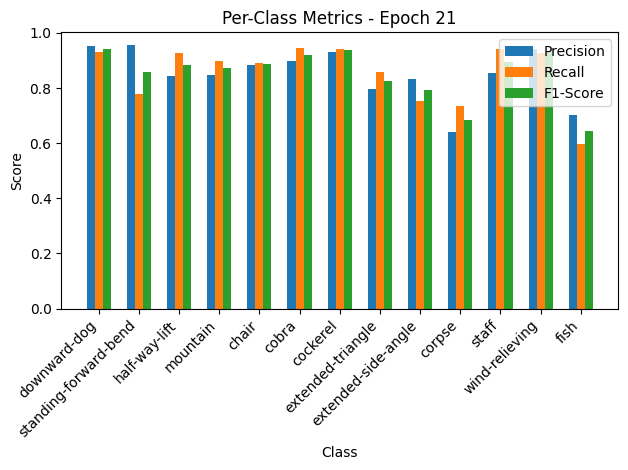

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.51it/s, loss=0.439, accuracy=87]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.64, Recall=0.88, F1-Score=0.74
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


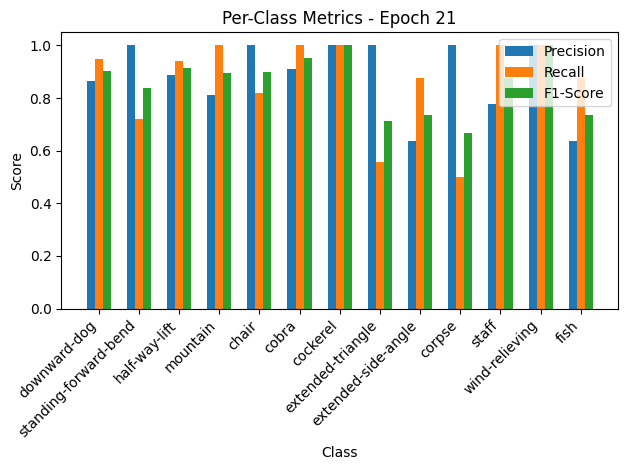


Epoch 22/50 Summary:
Train Loss: 0.4916 | Train Acc: 86.62% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85
Val Loss: 0.4814 | Val Acc: 86.99% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.86

Epoch 23/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.03it/s, loss=0.447, accuracy=88.2]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.96, Recall=0.76, F1-Score=0.85
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.87, Recall=0.92, F1-Score=0.89
chair: Precision=0.92, Recall=0.93, F1-Score=0.93
cobra: Precision=0.88, Recall=0.97, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.82, Recall=0.83, F1-Score=0.83
extended-side-angle: Precision=0.85, Recall=0.85, F1-Score=0.85
corpse: Precision=0.75, Recall=0.75, F1-Score=0.75
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.73, Recall=0.72, F1-Score=0.72


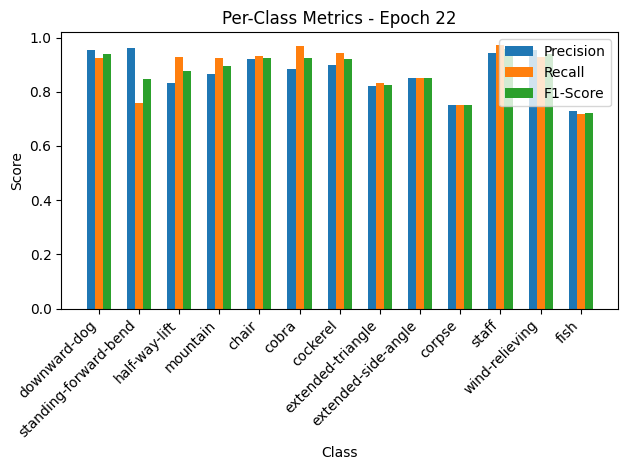

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.60it/s, loss=0.356, accuracy=87.7]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.86, Recall=0.90, F1-Score=0.88
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.82, Recall=0.82, F1-Score=0.82
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.62, Recall=0.91, F1-Score=0.74
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.73, Recall=1.00, F1-Score=0.84
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.50, F1-Score=0.67


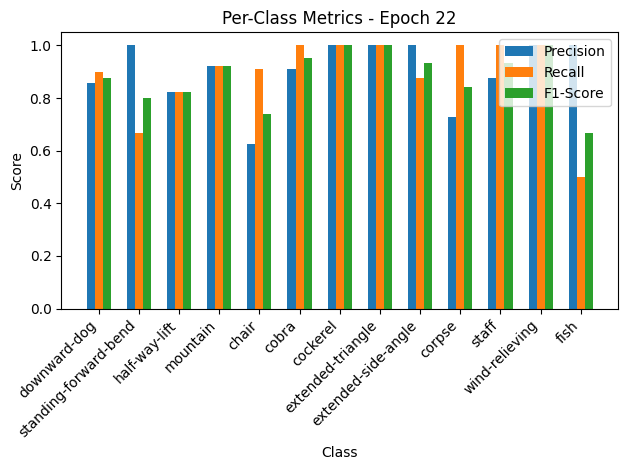


Epoch 23/50 Summary:
Train Loss: 0.4486 | Train Acc: 88.23% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.3901 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.3901

Epoch 24/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.36it/s, loss=0.43, accuracy=88.2]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.94, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.89
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.90, Recall=0.86, F1-Score=0.88
cobra: Precision=0.92, Recall=0.91, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.85, Recall=0.81, F1-Score=0.83
extended-side-angle: Precision=0.82, Recall=0.90, F1-Score=0.86
corpse: Precision=0.74, Recall=0.78, F1-Score=0.76
staff: Precision=0.90, Recall=0.94, F1-Score=0.92
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.79, Recall=0.67, F1-Score=0.73


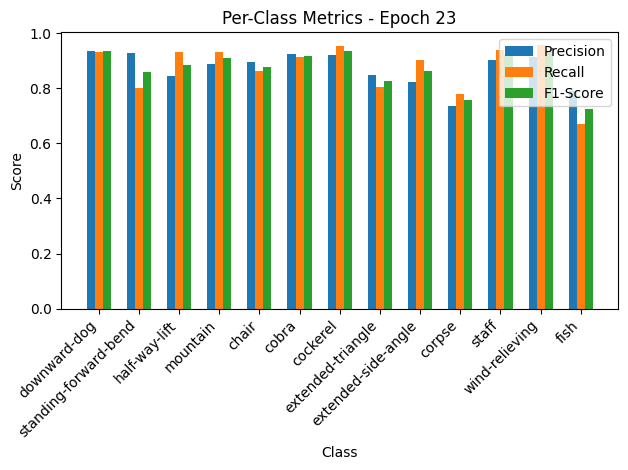

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.06it/s, loss=0.382, accuracy=89]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.67, Recall=1.00, F1-Score=0.80


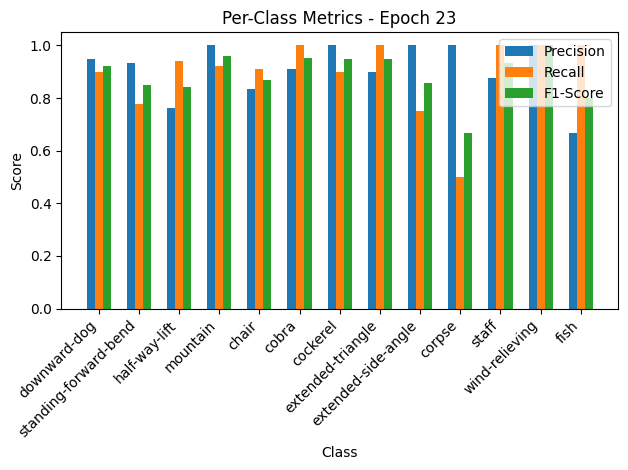


Epoch 24/50 Summary:
Train Loss: 0.4315 | Train Acc: 88.23% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.4189 | Val Acc: 89.04% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.89

Epoch 25/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.15it/s, loss=0.468, accuracy=87.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.90, F1-Score=0.85
mountain: Precision=0.89, Recall=0.92, F1-Score=0.90
chair: Precision=0.82, Recall=0.92, F1-Score=0.87
cobra: Precision=0.90, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.82, Recall=0.84, F1-Score=0.83
extended-side-angle: Precision=0.86, Recall=0.78, F1-Score=0.82
corpse: Precision=0.71, Recall=0.79, F1-Score=0.75
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.78, Recall=0.67, F1-Score=0.72


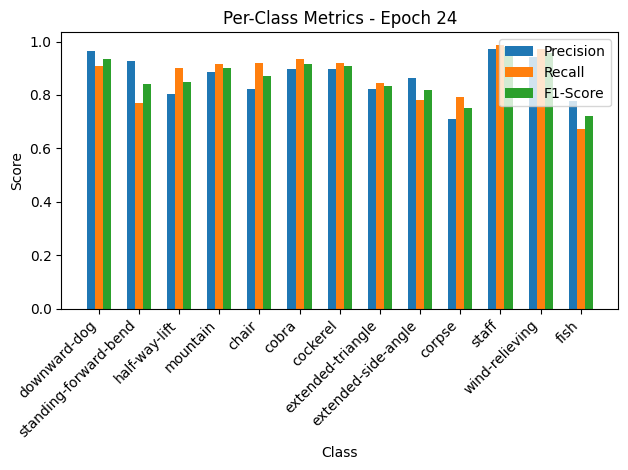

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.08it/s, loss=0.392, accuracy=88.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=0.88, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


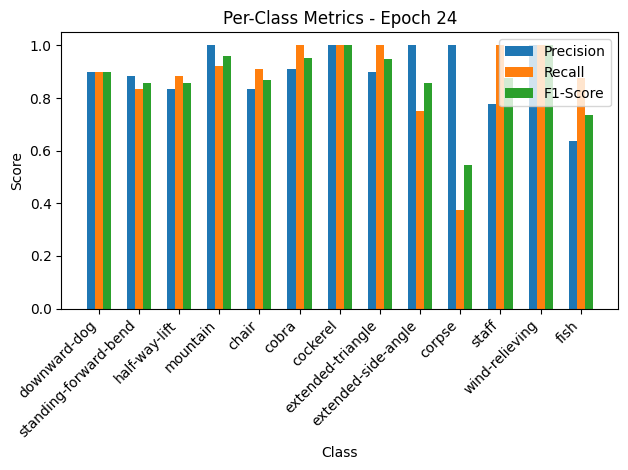


Epoch 25/50 Summary:
Train Loss: 0.4691 | Train Acc: 87.31% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.4296 | Val Acc: 88.36% | Val Precision: 0.90 | Val Recall: 0.88 | Val F1: 0.87

Epoch 26/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.53it/s, loss=0.458, accuracy=88]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.90, F1-Score=0.87
mountain: Precision=0.90, Recall=0.94, F1-Score=0.92
chair: Precision=0.92, Recall=0.90, F1-Score=0.91
cobra: Precision=0.93, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.90, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.84, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.83, Recall=0.86, F1-Score=0.85
corpse: Precision=0.75, Recall=0.74, F1-Score=0.74
staff: Precision=0.91, Recall=0.99, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.96, F1-Score=0.94
fish: Precision=0.77, Recall=0.75, F1-Score=0.76


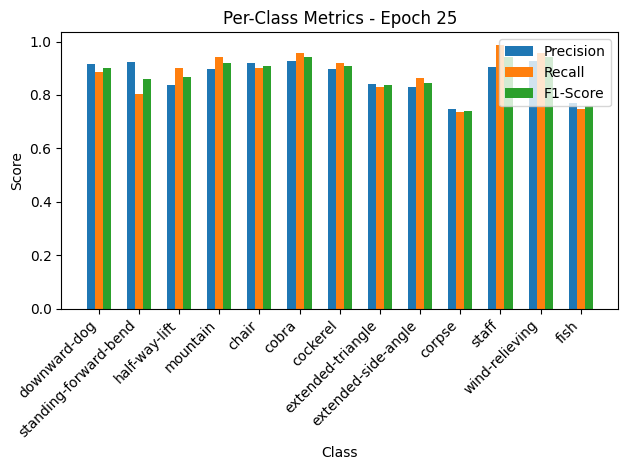

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.32it/s, loss=0.362, accuracy=88.4]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.85, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.67, Recall=0.94, F1-Score=0.78
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.62, F1-Score=0.77


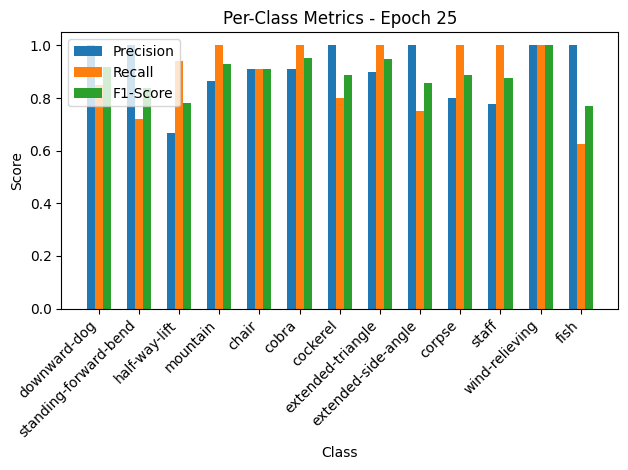


Epoch 26/50 Summary:
Train Loss: 0.4598 | Train Acc: 88.00% | Train Precision: 0.87 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.3972 | Val Acc: 88.36% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.89

Epoch 27/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.32it/s, loss=0.439, accuracy=88.6]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.94, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.90, Recall=0.90, F1-Score=0.90
cobra: Precision=0.89, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.99, F1-Score=0.94
extended-triangle: Precision=0.82, Recall=0.83, F1-Score=0.83
extended-side-angle: Precision=0.85, Recall=0.86, F1-Score=0.86
corpse: Precision=0.80, Recall=0.76, F1-Score=0.78
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.97, Recall=0.88, F1-Score=0.92
fish: Precision=0.76, Recall=0.81, F1-Score=0.78


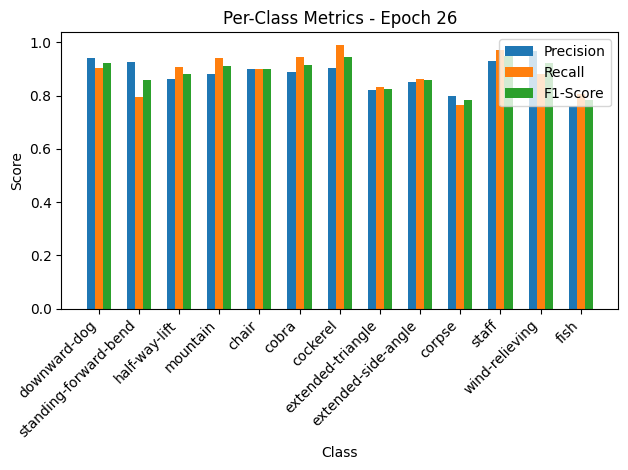

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.06it/s, loss=0.306, accuracy=91.1]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.75, F1-Score=0.86


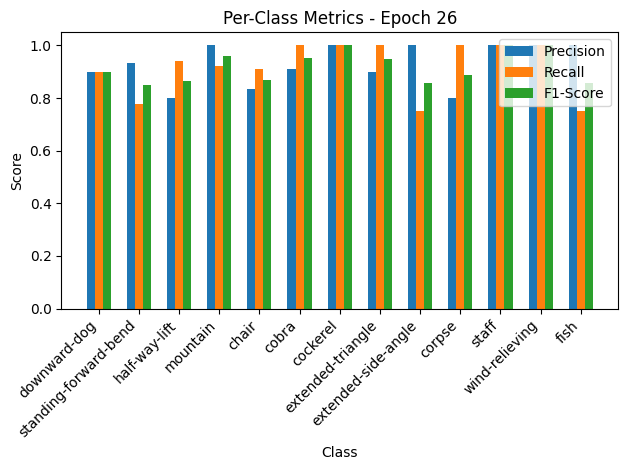


Epoch 27/50 Summary:
Train Loss: 0.4407 | Train Acc: 88.61% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3348 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 27
New best model saved! Validation Loss: 0.3348

Epoch 28/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.37it/s, loss=0.414, accuracy=89.8]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.94, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.96, F1-Score=0.89
mountain: Precision=0.93, Recall=0.94, F1-Score=0.93
chair: Precision=0.94, Recall=0.90, F1-Score=0.92
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.92, F1-Score=0.90
extended-triangle: Precision=0.89, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.86, Recall=0.88, F1-Score=0.87
corpse: Precision=0.79, Recall=0.81, F1-Score=0.80
staff: Precision=0.90, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.78, F1-Score=0.79


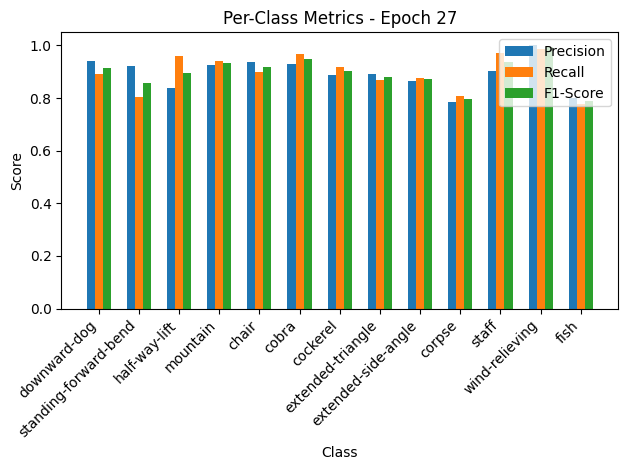

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.24it/s, loss=0.349, accuracy=90.4]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.88, Recall=0.88, F1-Score=0.88
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.58, Recall=0.88, F1-Score=0.70


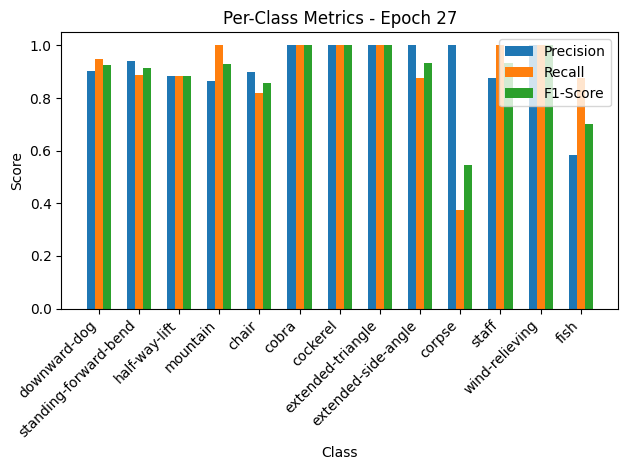


Epoch 28/50 Summary:
Train Loss: 0.4155 | Train Acc: 89.76% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3820 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.89

Epoch 29/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.42, accuracy=88.8]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.85, Recall=0.93, F1-Score=0.89
mountain: Precision=0.88, Recall=0.96, F1-Score=0.92
chair: Precision=0.91, Recall=0.87, F1-Score=0.89
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.95, F1-Score=0.93
extended-triangle: Precision=0.88, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.84, Recall=0.88, F1-Score=0.86
corpse: Precision=0.78, Recall=0.74, F1-Score=0.76
staff: Precision=0.97, Recall=0.94, F1-Score=0.96
wind-relieving: Precision=0.93, Recall=0.99, F1-Score=0.96
fish: Precision=0.75, Recall=0.76, F1-Score=0.76


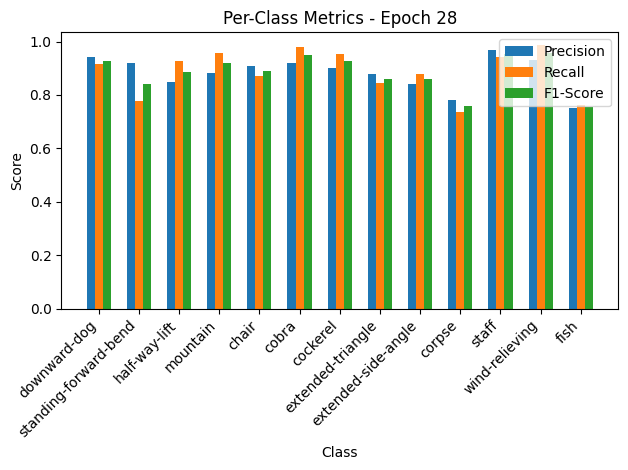

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.05it/s, loss=0.289, accuracy=90.4]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.86, Recall=0.90, F1-Score=0.88
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.75, F1-Score=0.86


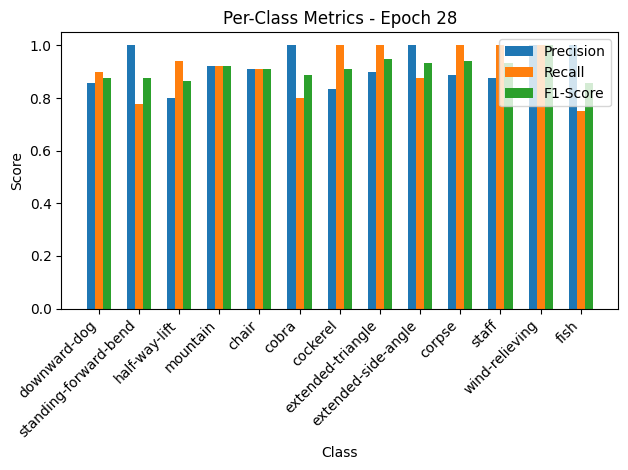


Epoch 29/50 Summary:
Train Loss: 0.4212 | Train Acc: 88.84% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88
Val Loss: 0.3168 | Val Acc: 90.41% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 29
New best model saved! Validation Loss: 0.3168

Epoch 30/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 11.31it/s, loss=0.41, accuracy=89.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.94, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.96, Recall=0.77, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.89, Recall=0.95, F1-Score=0.92
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.91, Recall=0.93, F1-Score=0.92
extended-triangle: Precision=0.88, Recall=0.87, F1-Score=0.88
extended-side-angle: Precision=0.88, Recall=0.89, F1-Score=0.88
corpse: Precision=0.75, Recall=0.66, F1-Score=0.70
staff: Precision=0.92, Recall=0.97, F1-Score=0.94
wind-relieving: Precision=0.98, Recall=0.96, F1-Score=0.97
fish: Precision=0.69, Recall=0.81, F1-Score=0.74


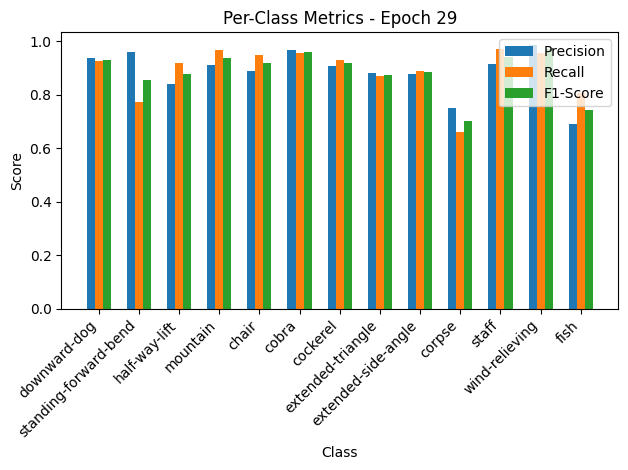

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.17it/s, loss=0.325, accuracy=88.4]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.89, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.57, Recall=1.00, F1-Score=0.73


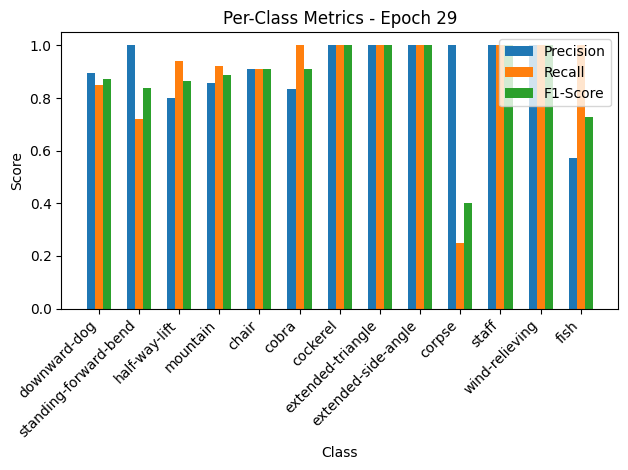


Epoch 30/50 Summary:
Train Loss: 0.4115 | Train Acc: 89.30% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3559 | Val Acc: 88.36% | Val Precision: 0.91 | Val Recall: 0.89 | Val F1: 0.88

Epoch 31/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.45it/s, loss=0.424, accuracy=89.6]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.90, Recall=0.90, F1-Score=0.90
cobra: Precision=0.91, Recall=0.94, F1-Score=0.92
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.84, Recall=0.87, F1-Score=0.85
extended-side-angle: Precision=0.79, Recall=0.85, F1-Score=0.82
corpse: Precision=0.81, Recall=0.75, F1-Score=0.78
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.76, Recall=0.81, F1-Score=0.78


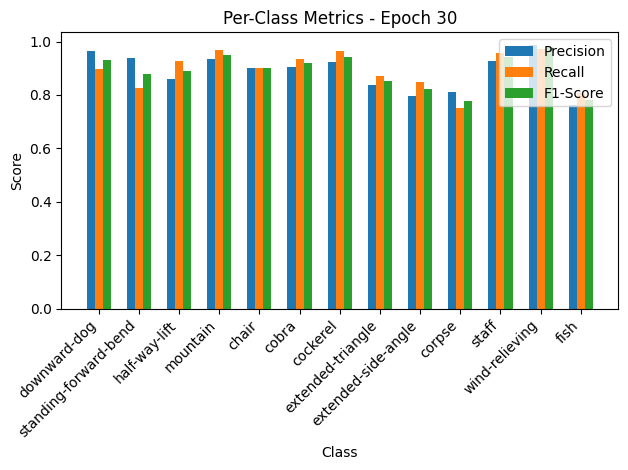

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.94it/s, loss=0.317, accuracy=91.1]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=1.00, Recall=0.62, F1-Score=0.77
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


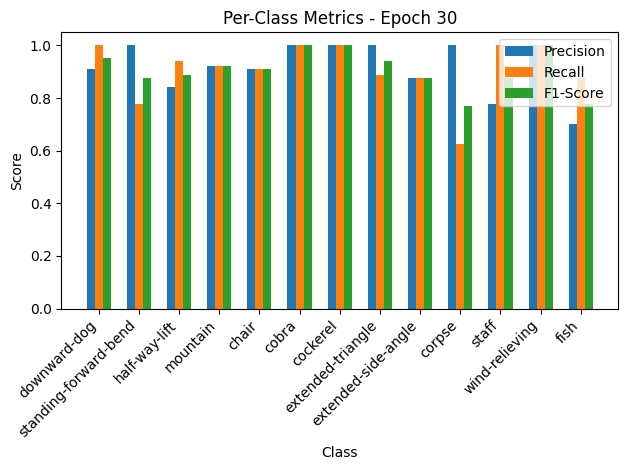


Epoch 31/50 Summary:
Train Loss: 0.4253 | Train Acc: 89.60% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89
Val Loss: 0.3469 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 32/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.53it/s, loss=0.388, accuracy=90.7]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.95, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.94, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.88, Recall=0.91, F1-Score=0.90
mountain: Precision=0.90, Recall=0.95, F1-Score=0.92
chair: Precision=0.90, Recall=0.90, F1-Score=0.90
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.90, Recall=0.98, F1-Score=0.94
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.89, Recall=0.93, F1-Score=0.91
corpse: Precision=0.79, Recall=0.79, F1-Score=0.79
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.79, Recall=0.81, F1-Score=0.80


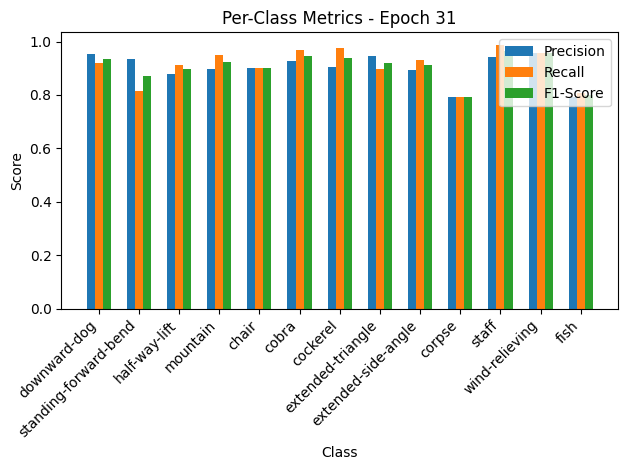

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.41it/s, loss=0.378, accuracy=89.7]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


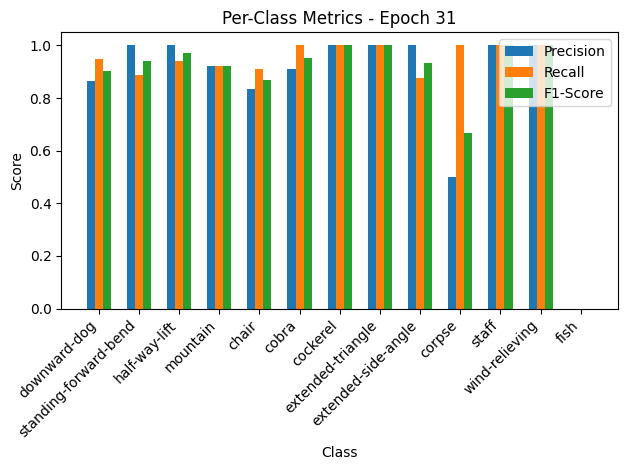


Epoch 32/50 Summary:
Train Loss: 0.3894 | Train Acc: 90.67% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.90
Val Loss: 0.4144 | Val Acc: 89.73% | Val Precision: 0.85 | Val Recall: 0.88 | Val F1: 0.86

Epoch 33/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.98it/s, loss=0.429, accuracy=88.8]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.89, Recall=0.93, F1-Score=0.91
chair: Precision=0.92, Recall=0.87, F1-Score=0.89
cobra: Precision=0.92, Recall=0.96, F1-Score=0.94
cockerel: Precision=0.89, Recall=0.99, F1-Score=0.93
extended-triangle: Precision=0.83, Recall=0.82, F1-Score=0.82
extended-side-angle: Precision=0.84, Recall=0.85, F1-Score=0.84
corpse: Precision=0.72, Recall=0.78, F1-Score=0.75
staff: Precision=0.98, Recall=0.94, F1-Score=0.96
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.77, Recall=0.70, F1-Score=0.73


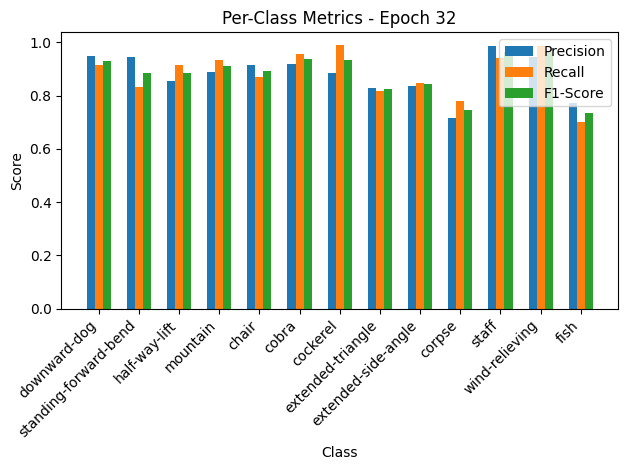

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.72it/s, loss=0.331, accuracy=90.4]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.94, Recall=0.85, F1-Score=0.89
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


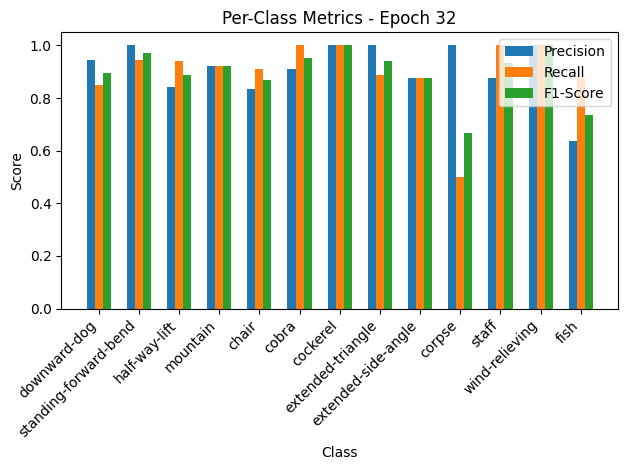


Epoch 33/50 Summary:
Train Loss: 0.4301 | Train Acc: 88.84% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88
Val Loss: 0.3629 | Val Acc: 90.41% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90

Epoch 34/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.99it/s, loss=0.417, accuracy=89.8]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.91, Recall=0.83, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.88
mountain: Precision=0.90, Recall=0.93, F1-Score=0.91
chair: Precision=0.90, Recall=0.91, F1-Score=0.91
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.90, Recall=0.86, F1-Score=0.88
extended-side-angle: Precision=0.86, Recall=0.88, F1-Score=0.87
corpse: Precision=0.81, Recall=0.76, F1-Score=0.79
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.78, Recall=0.81, F1-Score=0.79


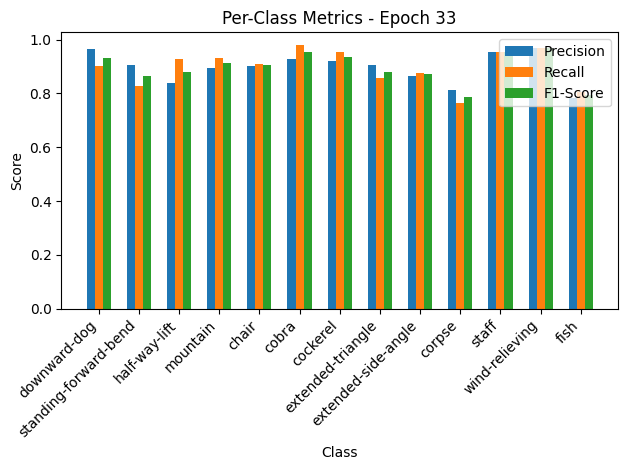

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.63it/s, loss=0.359, accuracy=89]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.80, F1-Score=0.89
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.70, Recall=0.94, F1-Score=0.80
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.58, Recall=0.88, F1-Score=0.70


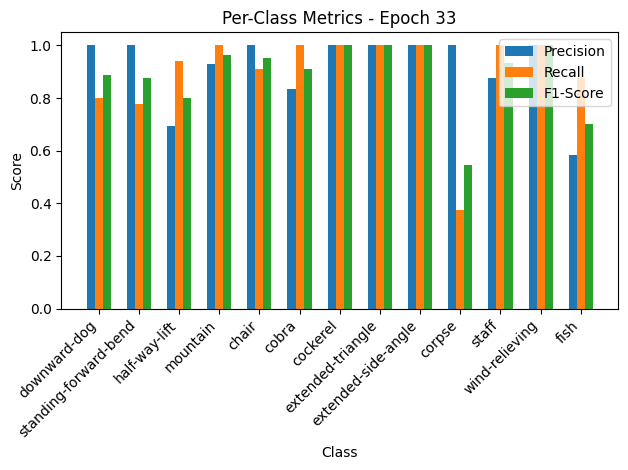


Epoch 34/50 Summary:
Train Loss: 0.4180 | Train Acc: 89.83% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.3937 | Val Acc: 89.04% | Val Precision: 0.92 | Val Recall: 0.90 | Val F1: 0.89

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.61it/s, loss=0.314, accuracy=92.4]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.90, Recall=0.84, F1-Score=0.87
extended-side-angle: Precision=0.85, Recall=0.92, F1-Score=0.88
corpse: Precision=0.87, Recall=0.79, F1-Score=0.83
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.81, Recall=0.88, F1-Score=0.84


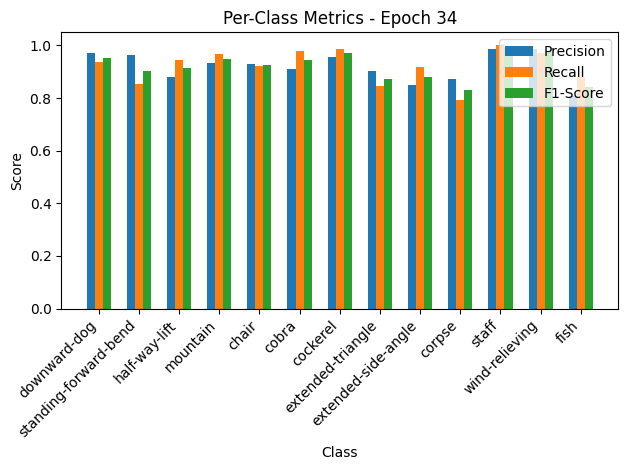

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.11it/s, loss=0.208, accuracy=93.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.75, F1-Score=0.86


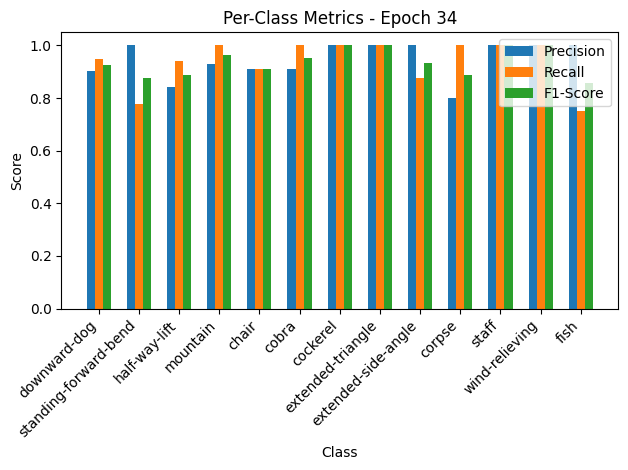


Epoch 35/50 Summary:
Train Loss: 0.3154 | Train Acc: 92.35% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2283 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 35
New best model saved! Validation Loss: 0.2283

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.27it/s, loss=0.26, accuracy=94.3]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.97, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.95, F1-Score=0.94
corpse: Precision=0.85, Recall=0.88, F1-Score=0.86
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.82, F1-Score=0.85


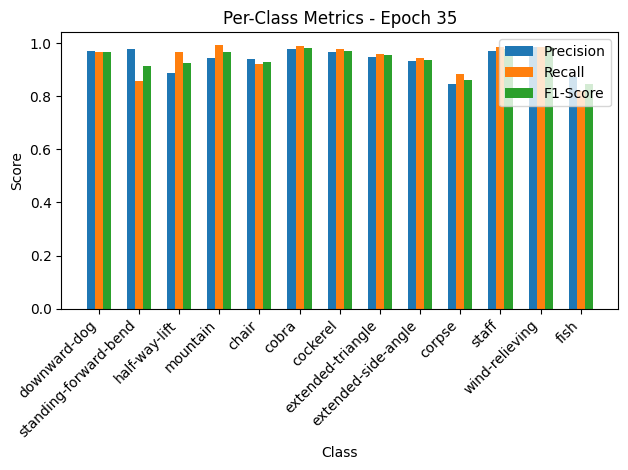

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.19it/s, loss=0.206, accuracy=92.5]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


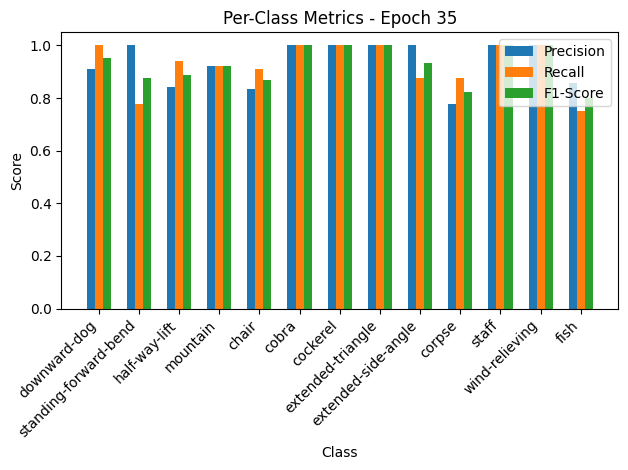


Epoch 36/50 Summary:
Train Loss: 0.2603 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2262 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 36
New best model saved! Validation Loss: 0.2262

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.17it/s, loss=0.244, accuracy=94.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.97, Recall=0.95, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.88, Recall=0.93, F1-Score=0.91
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.91, F1-Score=0.90


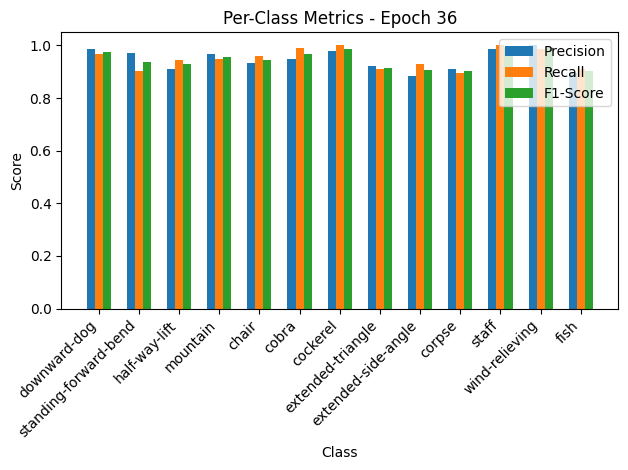

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.38it/s, loss=0.213, accuracy=91.8]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


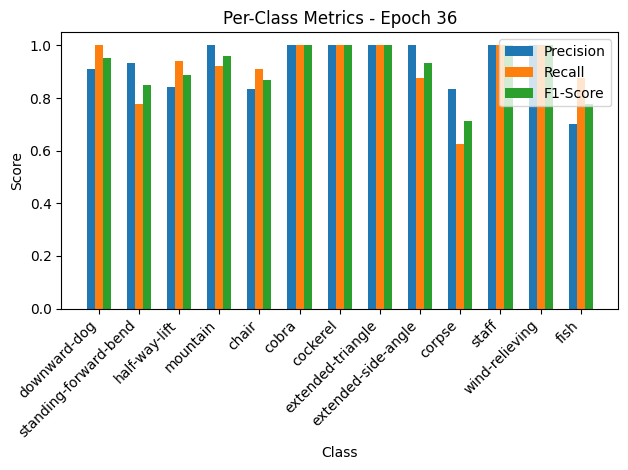


Epoch 37/50 Summary:
Train Loss: 0.2452 | Train Acc: 94.88% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2336 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 38/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.41it/s, loss=0.241, accuracy=95]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.92, F1-Score=0.93
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.97, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.86, Recall=0.90, F1-Score=0.88
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.82, F1-Score=0.85


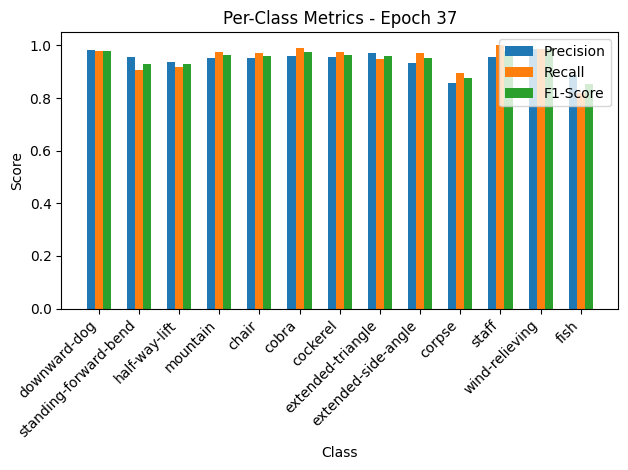

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.55it/s, loss=0.279, accuracy=91.1]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.80, Recall=0.50, F1-Score=0.62
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


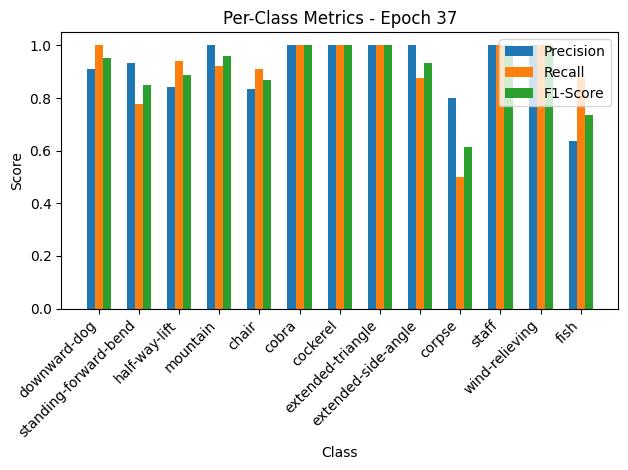


Epoch 38/50 Summary:
Train Loss: 0.2419 | Train Acc: 94.95% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.3055 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 39/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.54it/s, loss=0.232, accuracy=95.4]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.91, Recall=0.99, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.90, Recall=0.97, F1-Score=0.93
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.88, F1-Score=0.87


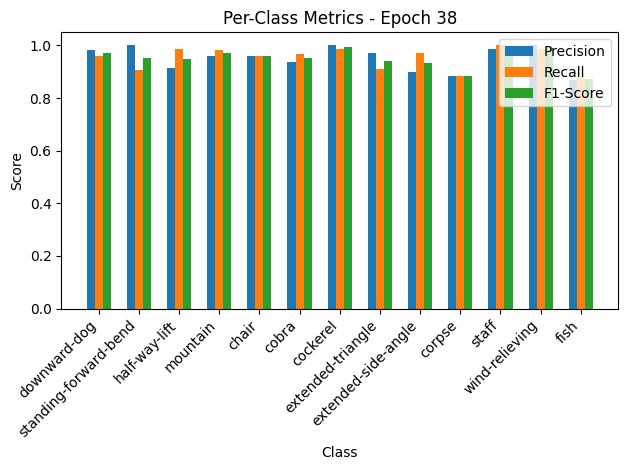

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.14it/s, loss=0.197, accuracy=93.8]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


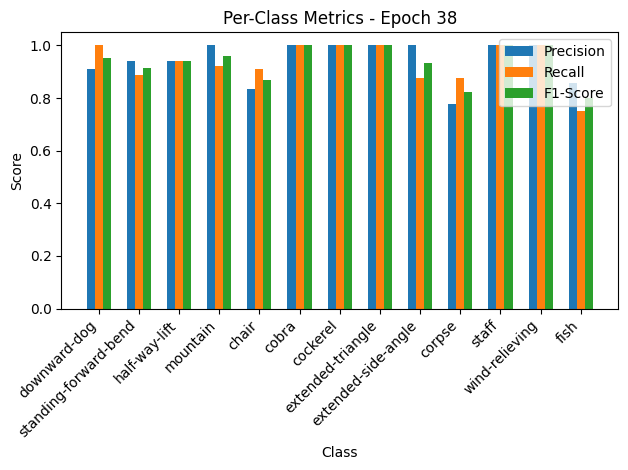


Epoch 39/50 Summary:
Train Loss: 0.2329 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2164 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 39
New best model saved! Validation Loss: 0.2164

Epoch 40/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.10it/s, loss=0.225, accuracy=95.4]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.99, F1-Score=0.95
corpse: Precision=0.86, Recall=0.93, F1-Score=0.89
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.87, F1-Score=0.89


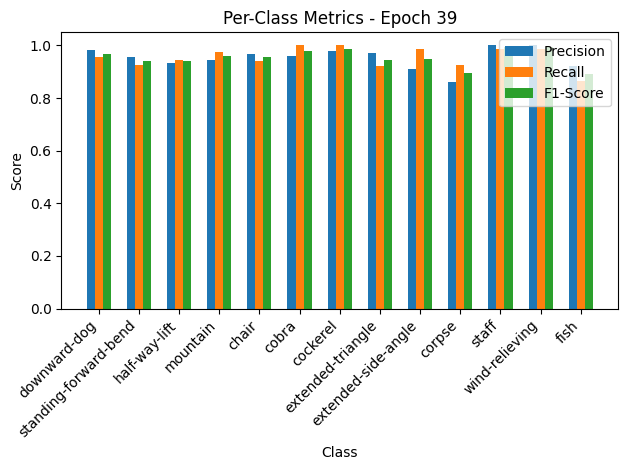

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.32it/s, loss=0.199, accuracy=93.2]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


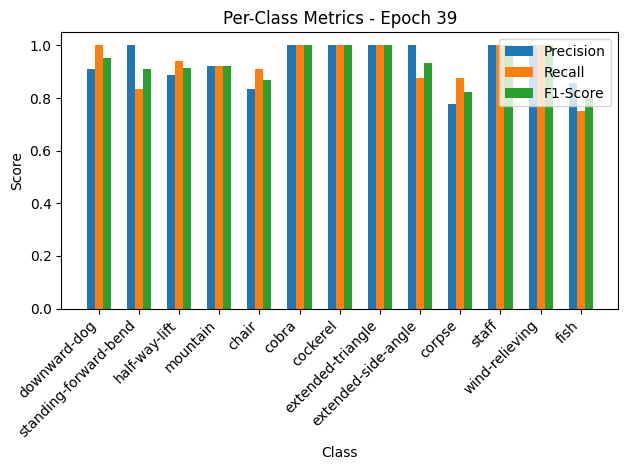


Epoch 40/50 Summary:
Train Loss: 0.2255 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2186 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 41/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.11it/s, loss=0.226, accuracy=95.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.98, F1-Score=0.95
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


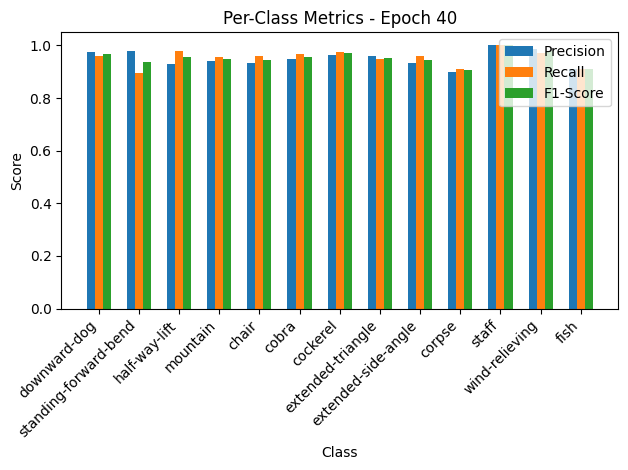

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.15it/s, loss=0.235, accuracy=92.5]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


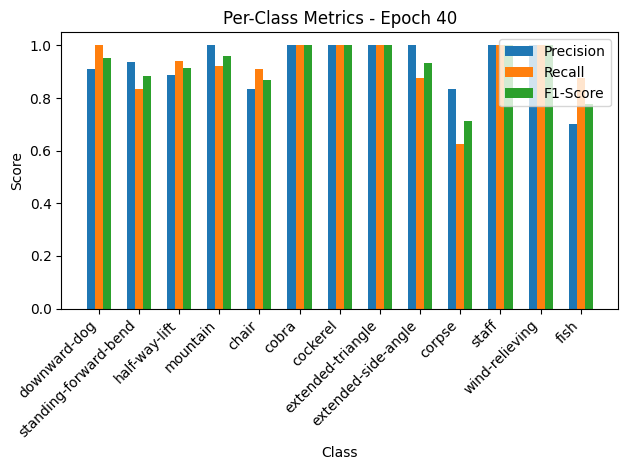


Epoch 41/50 Summary:
Train Loss: 0.2265 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2576 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 42/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.02it/s, loss=0.236, accuracy=94.4]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.91, F1-Score=0.91
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.92, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.91, Recall=0.87, F1-Score=0.89
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.87, Recall=0.91, F1-Score=0.89


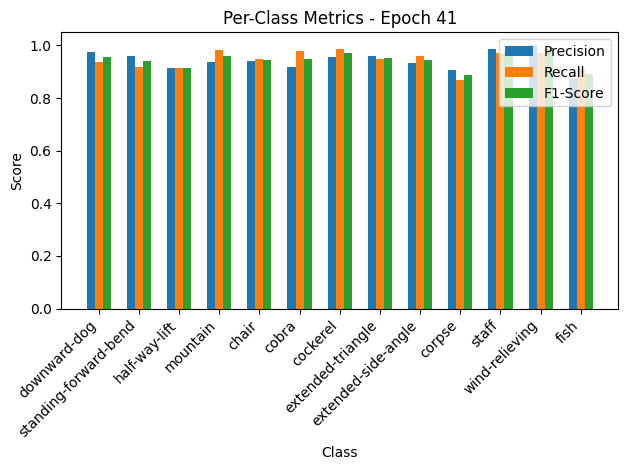

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.53it/s, loss=0.198, accuracy=93.8]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


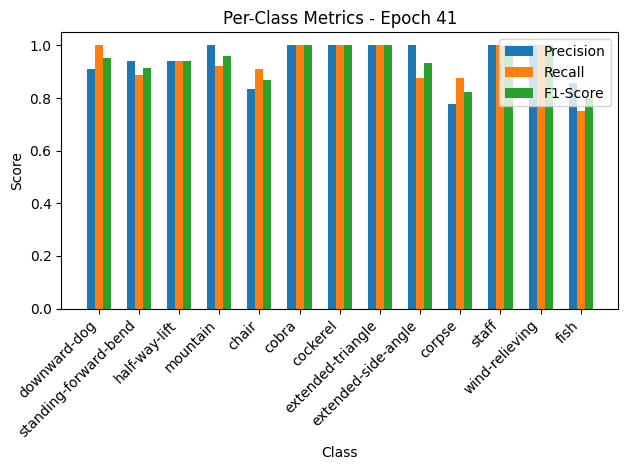


Epoch 42/50 Summary:
Train Loss: 0.2368 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.2170 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 43/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.52it/s, loss=0.231, accuracy=95.4]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.96, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.99, F1-Score=0.95
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.88, Recall=0.85, F1-Score=0.86


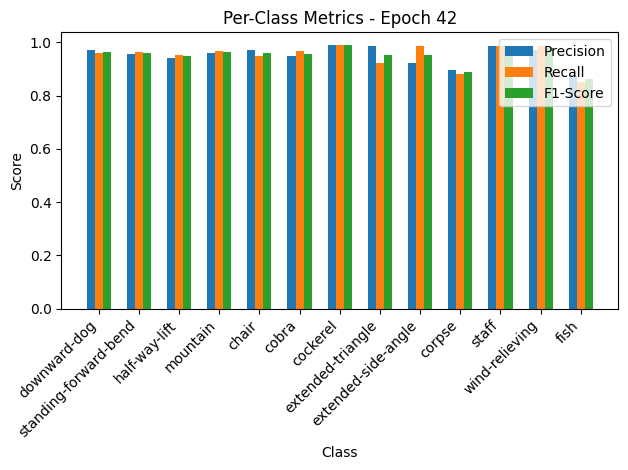

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.47it/s, loss=0.208, accuracy=93.8]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


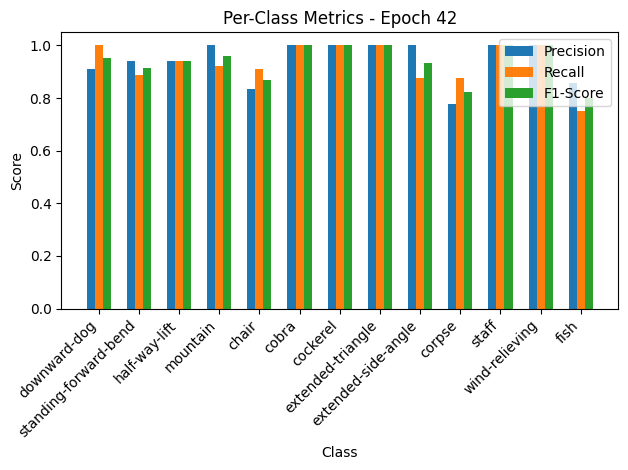


Epoch 43/50 Summary:
Train Loss: 0.2313 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2282 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 44/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.10it/s, loss=0.22, accuracy=95.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.93, Recall=0.99, F1-Score=0.96
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.88, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


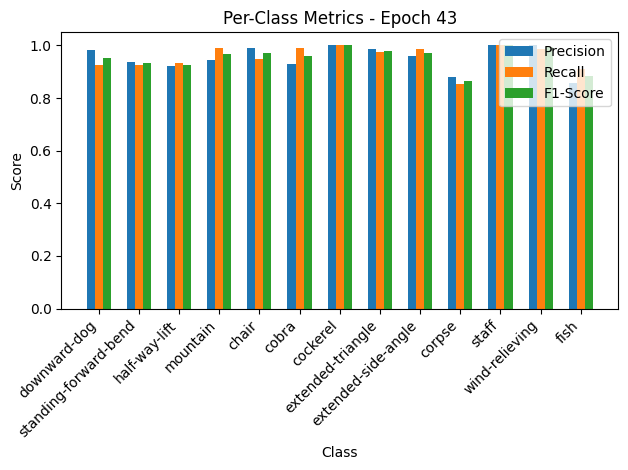

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.83it/s, loss=0.211, accuracy=93.8]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


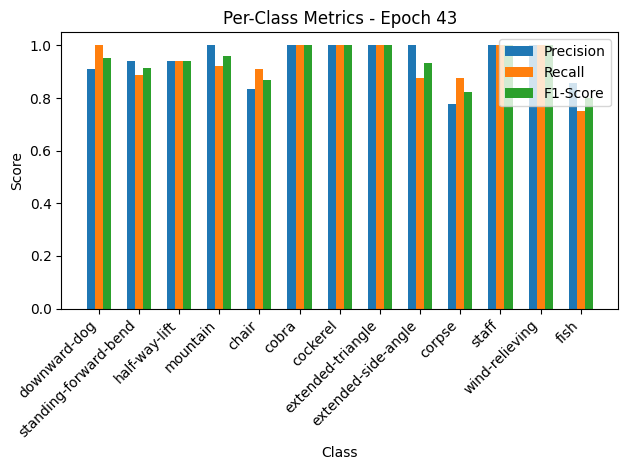


Epoch 44/50 Summary:
Train Loss: 0.2203 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.2310 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 45/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.41it/s, loss=0.225, accuracy=95.3]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.93, F1-Score=0.94
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.93, Recall=0.96, F1-Score=0.95
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.87, Recall=0.91, F1-Score=0.89
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.87, F1-Score=0.89


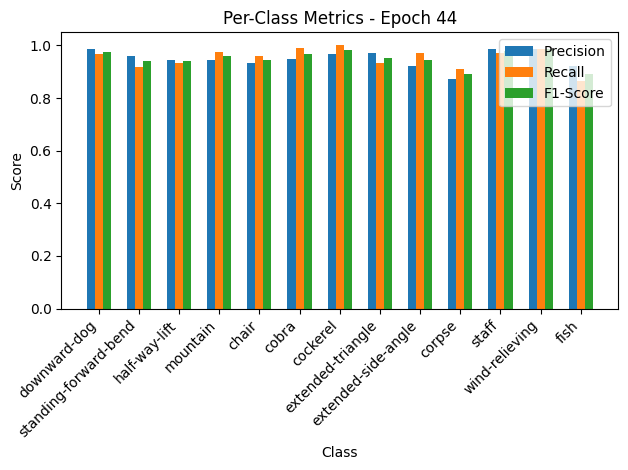

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.67it/s, loss=0.214, accuracy=93.8]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


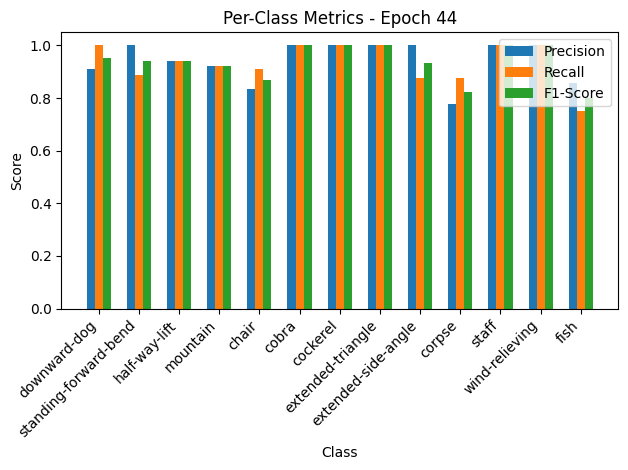


Epoch 45/50 Summary:
Train Loss: 0.2253 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2340 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 46/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.91it/s, loss=0.2, accuracy=95.9]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.91, Recall=0.94, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.91, F1-Score=0.92


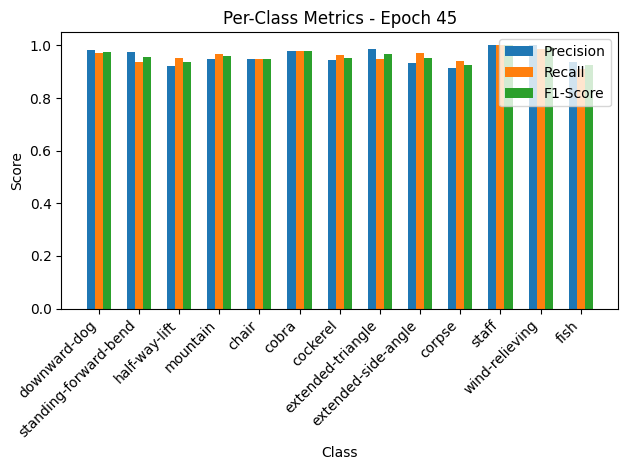

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.49it/s, loss=0.193, accuracy=94.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


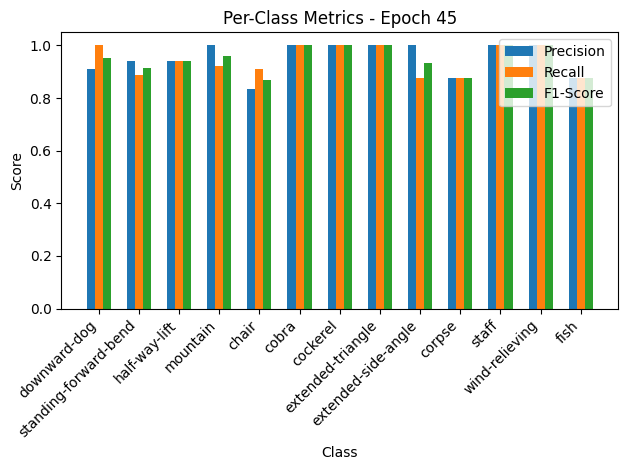


Epoch 46/50 Summary:
Train Loss: 0.2009 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2118 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_0.pth
Checkpoint saved at epoch 46
New best model saved! Validation Loss: 0.2118

Epoch 47/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00, 10.01it/s, loss=0.191, accuracy=95.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.96, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


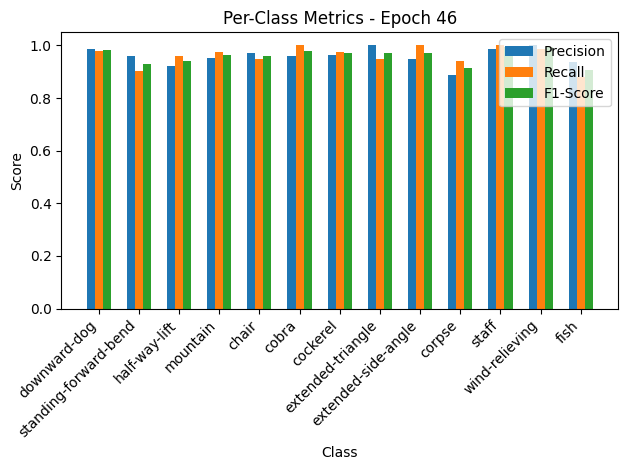

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.57it/s, loss=0.201, accuracy=94.5]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


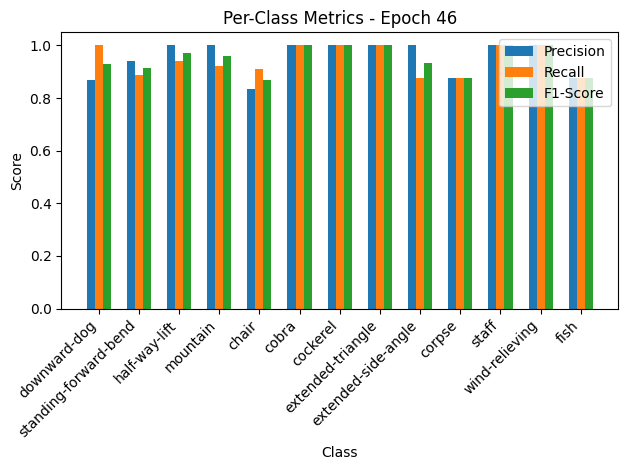


Epoch 47/50 Summary:
Train Loss: 0.1921 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2204 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 48/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.68it/s, loss=0.194, accuracy=95.9]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.91, Recall=0.90, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


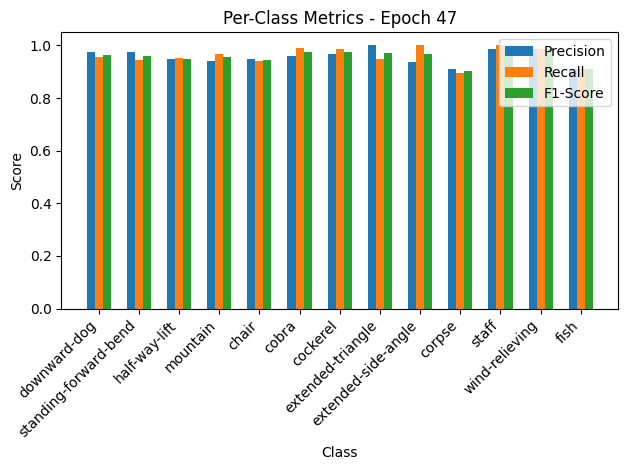

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.93it/s, loss=0.201, accuracy=94.5]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


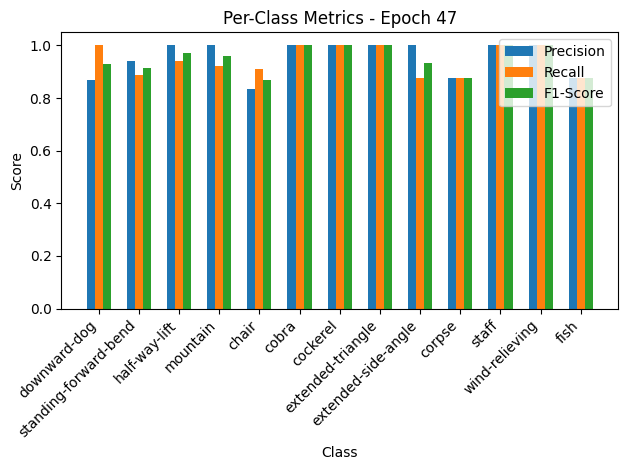


Epoch 48/50 Summary:
Train Loss: 0.1946 | Train Acc: 95.87% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2199 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 49/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.33it/s, loss=0.216, accuracy=95.1]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.96, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.92, Recall=0.88, F1-Score=0.90
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.91, F1-Score=0.90


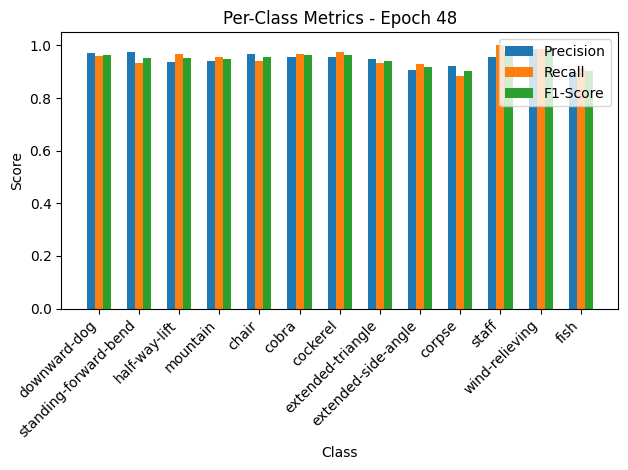

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.26it/s, loss=0.197, accuracy=94.5]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


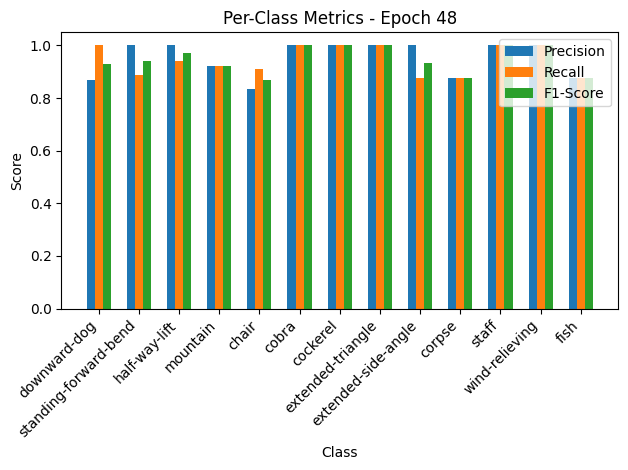


Epoch 49/50 Summary:
Train Loss: 0.2163 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2157 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:07<00:00, 10.55it/s, loss=0.189, accuracy=96.5]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.93, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.90, F1-Score=0.91


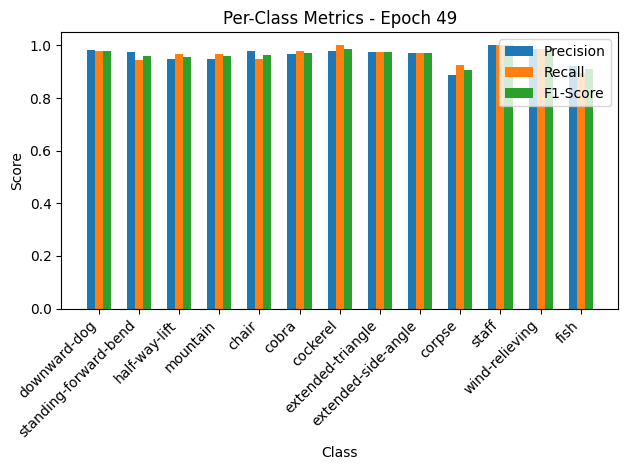

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.24it/s, loss=0.2, accuracy=93.8]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.75, F1-Score=0.80


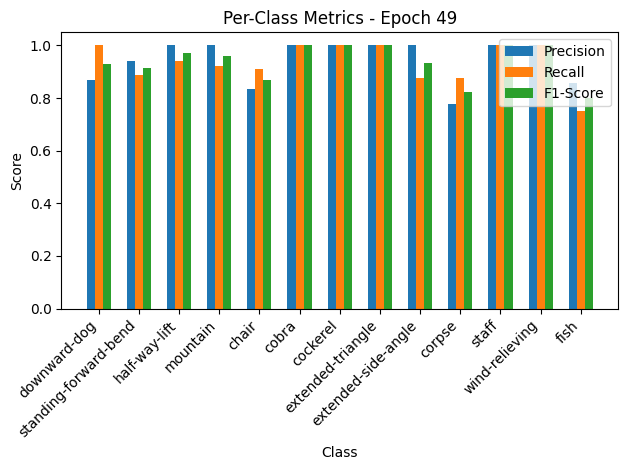


Epoch 50/50 Summary:
Train Loss: 0.1898 | Train Acc: 96.48% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.2192 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94


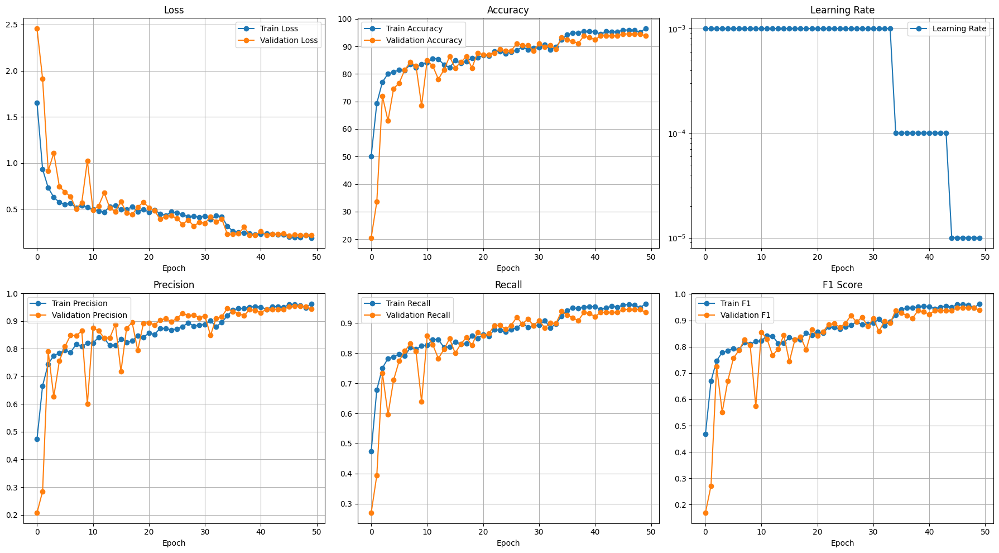

Testing: 100%|██████████| 23/23 [00:00<00:00, 39.30it/s]


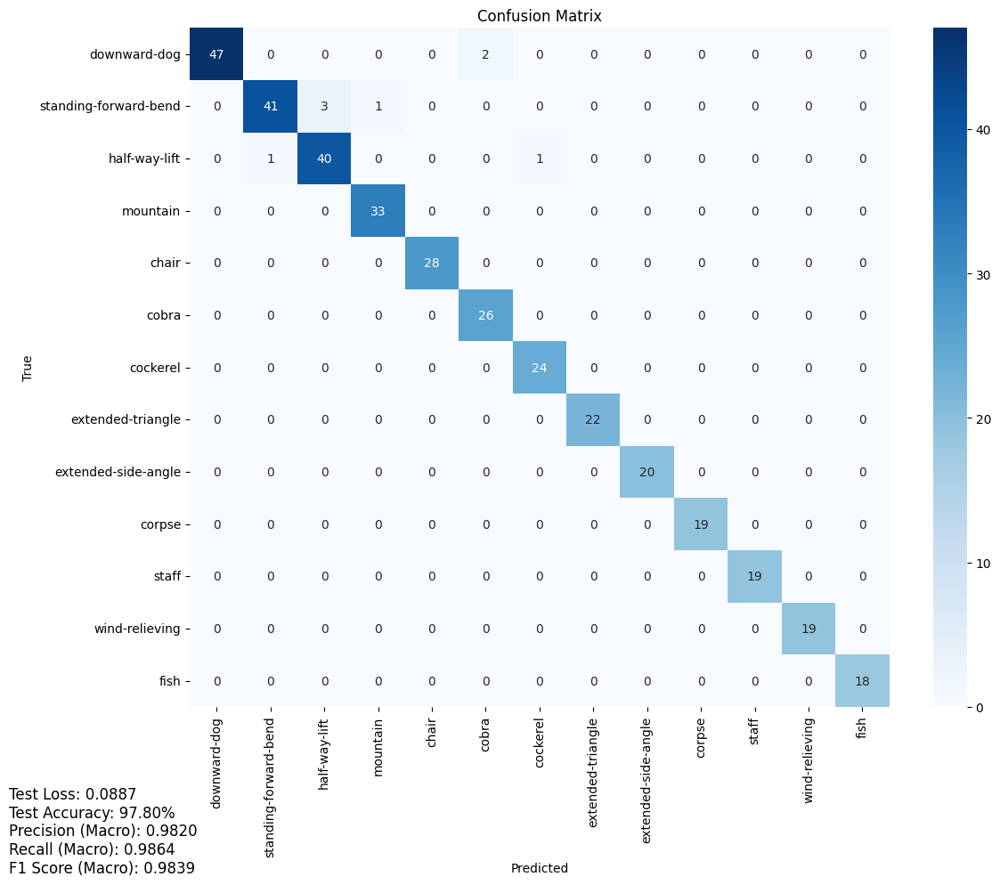

Test Loss: 0.0887
Test Accuracy: 97.80%
Precision (Macro): 0.9820
Recall (Macro): 0.9864
F1 Score (Macro): 0.9839


Testing: 100%|██████████| 23/23 [00:00<00:00, 46.11it/s]


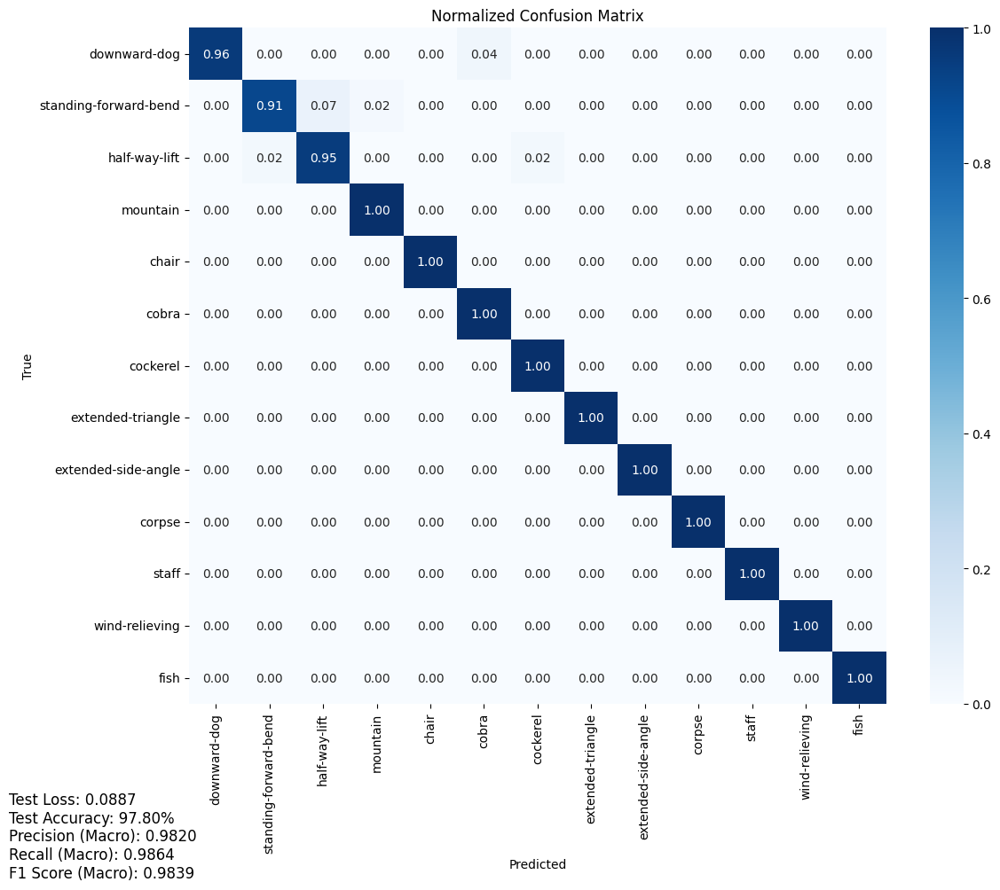

Test Loss: 0.0887
Test Accuracy: 97.80%
Precision (Macro): 0.9820
Recall (Macro): 0.9864
F1 Score (Macro): 0.9839
Saved checkpoint for fold 1
Fold 2/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 176 samples (13.46%)
Class 1: 162 samples (12.39%)
Class 2: 150 samples (11.47%)
Class 3: 119 samples (9.10%)
Class 4: 101 samples (7.72%)
Class 5: 94 samples (7.19%)
Class 6: 86 samples (6.57%)
Class 7: 77 samples (5.89%)
Class 8: 72 samples (5.50%)
Class 9: 68 samples (5.20%)
Class 10: 68 samples (5.20%)
Class 11: 68 samples (5.20%)
Class 12: 67 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 176
Minimum class size: 67
Average class size: 100.62
Class weights aligned with indices: tensor([0.5116, 0.5554, 0.5995, 0.7545, 0.8881, 0.9539, 1.0422, 1.1635, 1.2440,
        1.3169, 1.3169, 1.3169, 1.3365])
Cached criterion for fold 1
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.77it/s, loss=1.63, accuracy=52.6]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.67, Recall=0.57, F1-Score=0.61
standing-forward-bend: Precision=0.66, Recall=0.51, F1-Score=0.58
half-way-lift: Precision=0.76, Recall=0.85, F1-Score=0.80
mountain: Precision=0.58, Recall=0.63, F1-Score=0.60
chair: Precision=0.48, Recall=0.45, F1-Score=0.46
cobra: Precision=0.58, Recall=0.51, F1-Score=0.54
cockerel: Precision=0.57, Recall=0.53, F1-Score=0.55
extended-triangle: Precision=0.41, Recall=0.39, F1-Score=0.40
extended-side-angle: Precision=0.25, Recall=0.22, F1-Score=0.24
corpse: Precision=0.27, Recall=0.29, F1-Score=0.28
staff: Precision=0.57, Recall=0.60, F1-Score=0.59
wind-relieving: Precision=0.35, Recall=0.51, F1-Score=0.42
fish: Precision=0.23, Recall=0.31, F1-Score=0.26


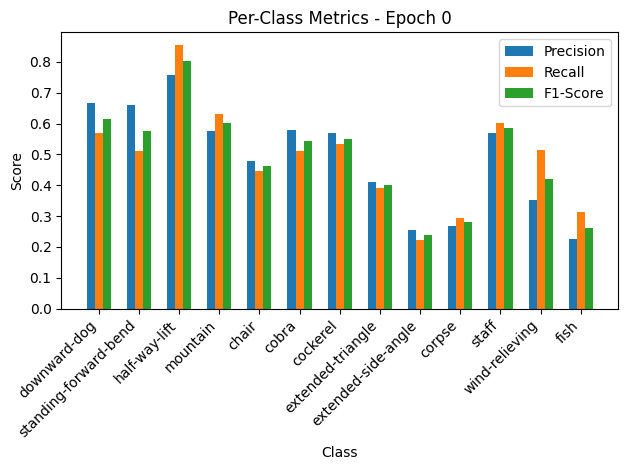

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.16it/s, loss=1.29, accuracy=41.1]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=1.00, Recall=0.15, F1-Score=0.26
standing-forward-bend: Precision=0.00, Recall=0.00, F1-Score=0.00
half-way-lift: Precision=0.61, Recall=1.00, F1-Score=0.76
mountain: Precision=0.34, Recall=1.00, F1-Score=0.51
chair: Precision=0.00, Recall=0.00, F1-Score=0.00
cobra: Precision=0.00, Recall=0.00, F1-Score=0.00
cockerel: Precision=1.00, Recall=0.30, F1-Score=0.46
extended-triangle: Precision=0.38, Recall=0.89, F1-Score=0.53
extended-side-angle: Precision=0.00, Recall=0.00, F1-Score=0.00
corpse: Precision=0.10, Recall=0.12, F1-Score=0.11
staff: Precision=1.00, Recall=0.75, F1-Score=0.86
wind-relieving: Precision=1.00, Recall=0.29, F1-Score=0.44
fish: Precision=0.21, Recall=1.00, F1-Score=0.35


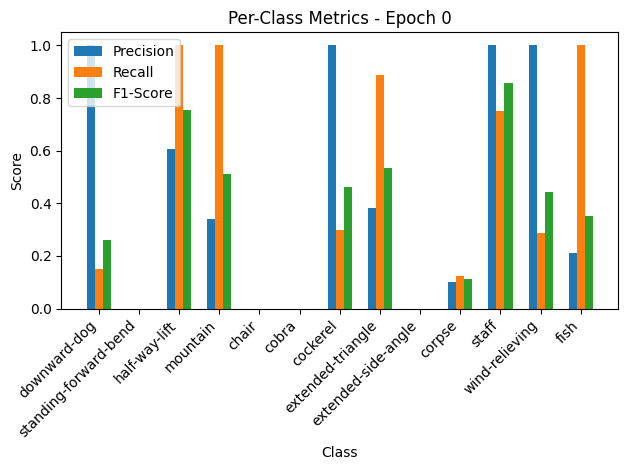


Epoch 1/50 Summary:
Train Loss: 1.6329 | Train Acc: 52.60% | Train Precision: 0.49 | Train Recall: 0.49 | Train F1: 0.49
Val Loss: 1.4155 | Val Acc: 41.10% | Val Precision: 0.43 | Val Recall: 0.42 | Val F1: 0.33
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.4155

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.40it/s, loss=0.882, accuracy=72.9]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.83, Recall=0.80, F1-Score=0.81
standing-forward-bend: Precision=0.81, Recall=0.69, F1-Score=0.74
half-way-lift: Precision=0.79, Recall=0.86, F1-Score=0.82
mountain: Precision=0.75, Recall=0.80, F1-Score=0.78
chair: Precision=0.69, Recall=0.71, F1-Score=0.70
cobra: Precision=0.75, Recall=0.81, F1-Score=0.78
cockerel: Precision=0.81, Recall=0.87, F1-Score=0.84
extended-triangle: Precision=0.71, Recall=0.71, F1-Score=0.71
extended-side-angle: Precision=0.57, Recall=0.49, F1-Score=0.53
corpse: Precision=0.39, Recall=0.35, F1-Score=0.37
staff: Precision=0.71, Recall=0.78, F1-Score=0.74
wind-relieving: Precision=0.86, Recall=0.82, F1-Score=0.84
fish: Precision=0.45, Recall=0.49, F1-Score=0.47


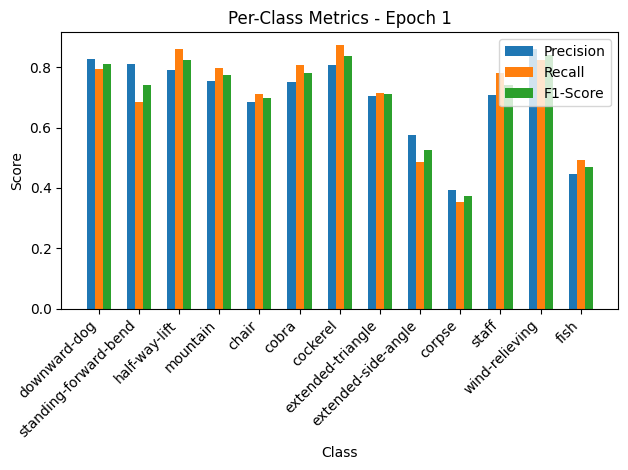

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.43it/s, loss=0.704, accuracy=78.1]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.83, Recall=0.95, F1-Score=0.88
standing-forward-bend: Precision=0.75, Recall=0.83, F1-Score=0.79
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=1.00, Recall=0.40, F1-Score=0.57
cockerel: Precision=0.67, Recall=1.00, F1-Score=0.80
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.60, Recall=0.75, F1-Score=0.67
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=0.78, Recall=0.88, F1-Score=0.82
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.64, Recall=1.00, F1-Score=0.78


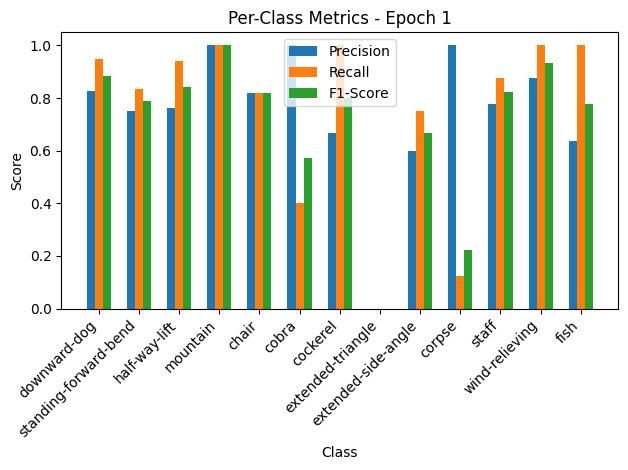


Epoch 2/50 Summary:
Train Loss: 0.8845 | Train Acc: 72.94% | Train Precision: 0.70 | Train Recall: 0.71 | Train F1: 0.70
Val Loss: 0.7718 | Val Acc: 78.08% | Val Precision: 0.75 | Val Recall: 0.75 | Val F1: 0.70
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.7718

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.92it/s, loss=0.723, accuracy=76.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.91, Recall=0.82, F1-Score=0.87
standing-forward-bend: Precision=0.84, Recall=0.75, F1-Score=0.79
half-way-lift: Precision=0.82, Recall=0.89, F1-Score=0.85
mountain: Precision=0.82, Recall=0.87, F1-Score=0.85
chair: Precision=0.80, Recall=0.84, F1-Score=0.82
cobra: Precision=0.83, Recall=0.88, F1-Score=0.86
cockerel: Precision=0.84, Recall=0.84, F1-Score=0.84
extended-triangle: Precision=0.67, Recall=0.61, F1-Score=0.64
extended-side-angle: Precision=0.56, Recall=0.60, F1-Score=0.58
corpse: Precision=0.39, Recall=0.37, F1-Score=0.38
staff: Precision=0.78, Recall=0.84, F1-Score=0.81
wind-relieving: Precision=0.75, Recall=0.79, F1-Score=0.77
fish: Precision=0.41, Recall=0.42, F1-Score=0.41


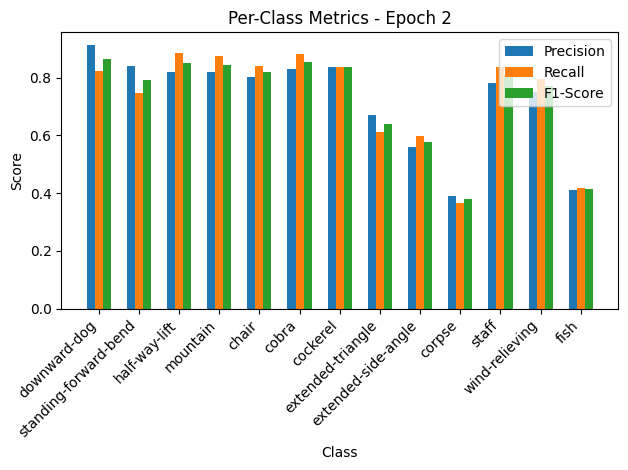

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.83it/s, loss=0.544, accuracy=82.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=1.00, Recall=0.70, F1-Score=0.82
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.40, Recall=1.00, F1-Score=0.57
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=0.88, Recall=0.88, F1-Score=0.88
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


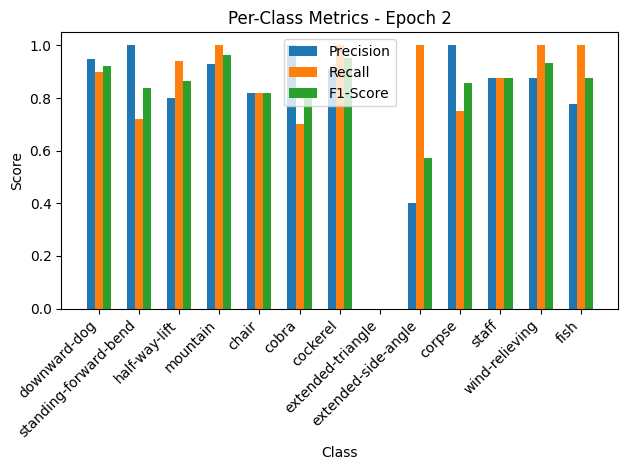


Epoch 3/50 Summary:
Train Loss: 0.7256 | Train Acc: 76.22% | Train Precision: 0.72 | Train Recall: 0.73 | Train F1: 0.73
Val Loss: 0.5963 | Val Acc: 82.88% | Val Precision: 0.79 | Val Recall: 0.82 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.5963

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.05it/s, loss=0.59, accuracy=80.3]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.91, Recall=0.85, F1-Score=0.88
standing-forward-bend: Precision=0.87, Recall=0.76, F1-Score=0.81
half-way-lift: Precision=0.82, Recall=0.90, F1-Score=0.86
mountain: Precision=0.84, Recall=0.83, F1-Score=0.84
chair: Precision=0.81, Recall=0.83, F1-Score=0.82
cobra: Precision=0.88, Recall=0.90, F1-Score=0.89
cockerel: Precision=0.84, Recall=0.88, F1-Score=0.86
extended-triangle: Precision=0.74, Recall=0.75, F1-Score=0.75
extended-side-angle: Precision=0.66, Recall=0.71, F1-Score=0.68
corpse: Precision=0.53, Recall=0.46, F1-Score=0.49
staff: Precision=0.82, Recall=0.93, F1-Score=0.87
wind-relieving: Precision=0.88, Recall=0.85, F1-Score=0.87
fish: Precision=0.53, Recall=0.57, F1-Score=0.55


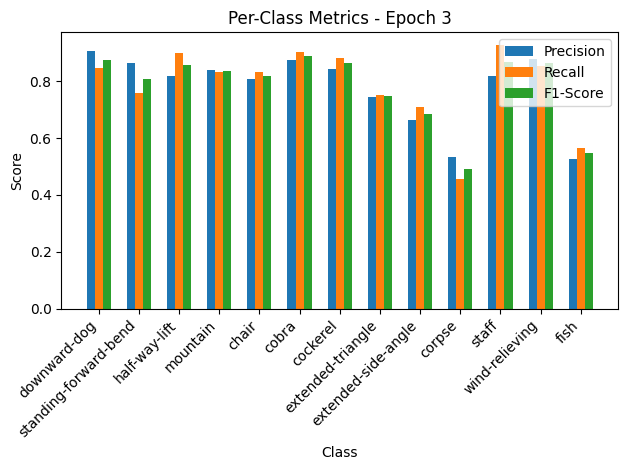

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.90it/s, loss=0.52, accuracy=81.5]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.87, Recall=0.65, F1-Score=0.74
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.92, Recall=0.85, F1-Score=0.88
chair: Precision=0.65, Recall=1.00, F1-Score=0.79
cobra: Precision=0.59, Recall=1.00, F1-Score=0.74
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=0.60, Recall=0.75, F1-Score=0.67
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.55, Recall=0.86, F1-Score=0.67


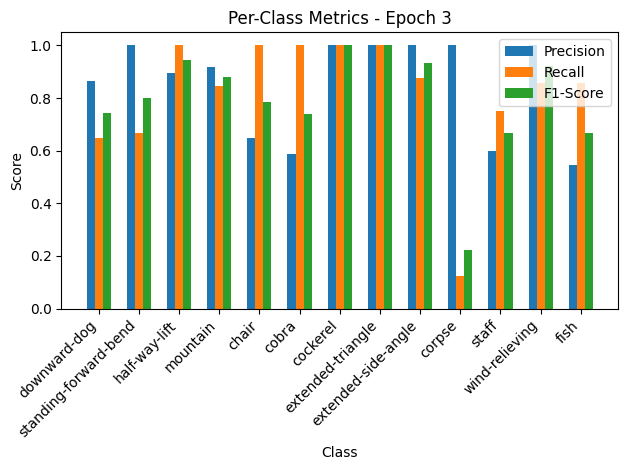


Epoch 4/50 Summary:
Train Loss: 0.5914 | Train Acc: 80.28% | Train Precision: 0.78 | Train Recall: 0.79 | Train F1: 0.78
Val Loss: 0.5697 | Val Acc: 81.51% | Val Precision: 0.85 | Val Recall: 0.82 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.5697

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.47it/s, loss=0.602, accuracy=80.2]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.89, Recall=0.84, F1-Score=0.87
standing-forward-bend: Precision=0.84, Recall=0.75, F1-Score=0.79
half-way-lift: Precision=0.79, Recall=0.90, F1-Score=0.84
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.85, Recall=0.86, F1-Score=0.86
cobra: Precision=0.90, Recall=0.89, F1-Score=0.90
cockerel: Precision=0.83, Recall=0.84, F1-Score=0.83
extended-triangle: Precision=0.71, Recall=0.66, F1-Score=0.68
extended-side-angle: Precision=0.69, Recall=0.72, F1-Score=0.71
corpse: Precision=0.54, Recall=0.56, F1-Score=0.55
staff: Precision=0.86, Recall=0.88, F1-Score=0.87
wind-relieving: Precision=0.86, Recall=0.90, F1-Score=0.88
fish: Precision=0.54, Recall=0.54, F1-Score=0.54


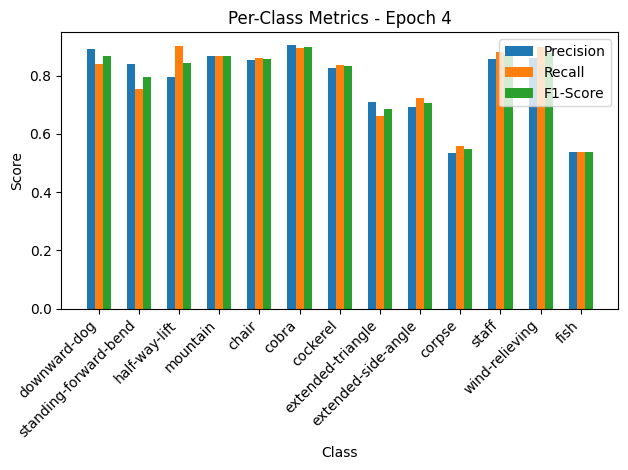

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.32it/s, loss=0.505, accuracy=84.2]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=1.00, Recall=0.65, F1-Score=0.79
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.89, Recall=0.80, F1-Score=0.84
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.42, Recall=1.00, F1-Score=0.59
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.58, Recall=1.00, F1-Score=0.74


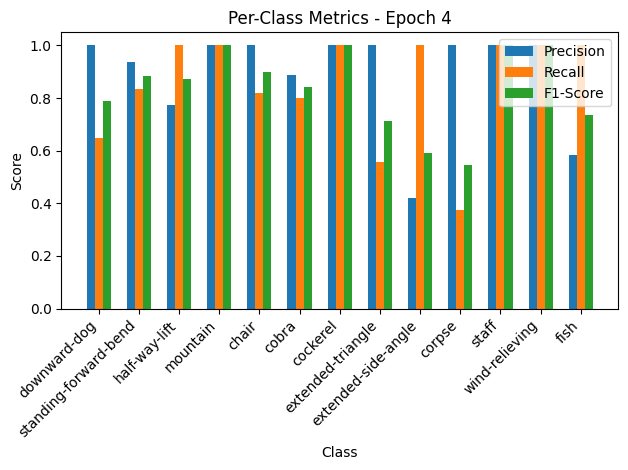


Epoch 5/50 Summary:
Train Loss: 0.6037 | Train Acc: 80.20% | Train Precision: 0.78 | Train Recall: 0.79 | Train F1: 0.78
Val Loss: 0.5534 | Val Acc: 84.25% | Val Precision: 0.89 | Val Recall: 0.85 | Val F1: 0.84
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.5534

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.86it/s, loss=0.595, accuracy=80.8]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.90, Recall=0.84, F1-Score=0.87
standing-forward-bend: Precision=0.91, Recall=0.73, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.82, Recall=0.90, F1-Score=0.86
chair: Precision=0.84, Recall=0.80, F1-Score=0.82
cobra: Precision=0.86, Recall=0.91, F1-Score=0.89
cockerel: Precision=0.81, Recall=0.85, F1-Score=0.83
extended-triangle: Precision=0.72, Recall=0.81, F1-Score=0.76
extended-side-angle: Precision=0.67, Recall=0.65, F1-Score=0.66
corpse: Precision=0.60, Recall=0.49, F1-Score=0.54
staff: Precision=0.85, Recall=0.91, F1-Score=0.88
wind-relieving: Precision=0.90, Recall=0.90, F1-Score=0.90
fish: Precision=0.58, Recall=0.67, F1-Score=0.62


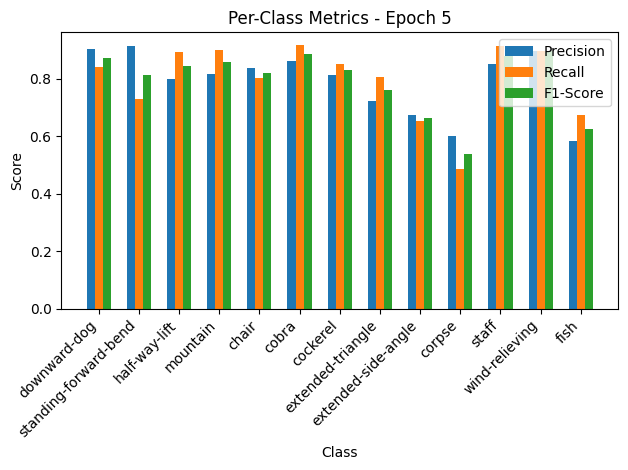

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.48it/s, loss=0.403, accuracy=84.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.64, Recall=1.00, F1-Score=0.78
extended-side-angle: Precision=1.00, Recall=0.38, F1-Score=0.55
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.47, Recall=1.00, F1-Score=0.64


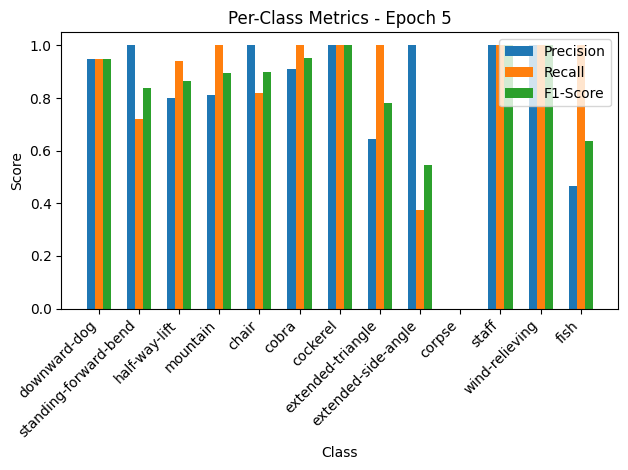


Epoch 6/50 Summary:
Train Loss: 0.5965 | Train Acc: 80.81% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.4419 | Val Acc: 84.93% | Val Precision: 0.81 | Val Recall: 0.83 | Val F1: 0.80
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.4419

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.43it/s, loss=0.527, accuracy=81.7]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.91, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.93, Recall=0.74, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.89, Recall=0.87, F1-Score=0.88
cobra: Precision=0.87, Recall=0.90, F1-Score=0.89
cockerel: Precision=0.87, Recall=0.86, F1-Score=0.87
extended-triangle: Precision=0.72, Recall=0.75, F1-Score=0.74
extended-side-angle: Precision=0.70, Recall=0.71, F1-Score=0.70
corpse: Precision=0.49, Recall=0.47, F1-Score=0.48
staff: Precision=0.86, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.87, Recall=0.90, F1-Score=0.88
fish: Precision=0.50, Recall=0.51, F1-Score=0.50


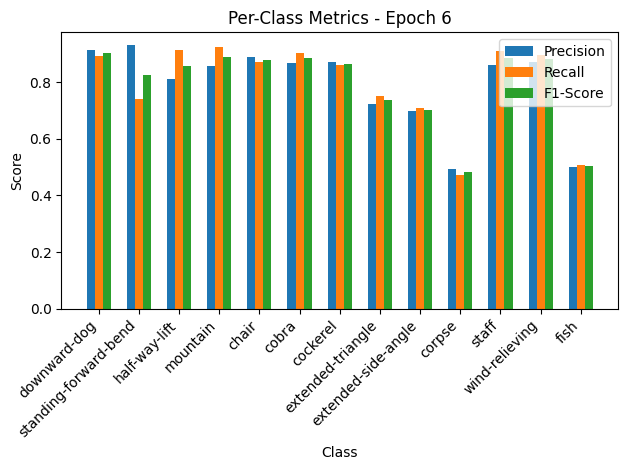

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.66it/s, loss=0.436, accuracy=82.9]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.83, Recall=0.83, F1-Score=0.83
half-way-lift: Precision=0.93, Recall=0.76, F1-Score=0.84
mountain: Precision=0.57, Recall=1.00, F1-Score=0.72
chair: Precision=0.75, Recall=0.27, F1-Score=0.40
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=0.75, Recall=1.00, F1-Score=0.86
extended-side-angle: Precision=1.00, Recall=0.62, F1-Score=0.77
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.67, Recall=0.86, F1-Score=0.75


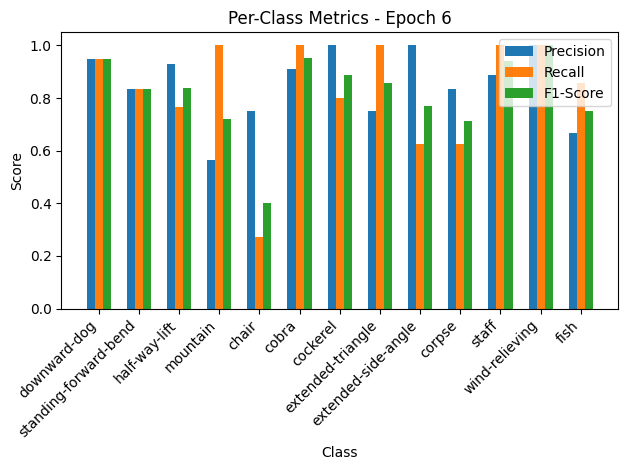


Epoch 7/50 Summary:
Train Loss: 0.5291 | Train Acc: 81.73% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.4776 | Val Acc: 82.88% | Val Precision: 0.85 | Val Recall: 0.83 | Val F1: 0.82

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.15it/s, loss=0.548, accuracy=81.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.82, Recall=0.78, F1-Score=0.80
half-way-lift: Precision=0.82, Recall=0.81, F1-Score=0.81
mountain: Precision=0.89, Recall=0.94, F1-Score=0.91
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=0.92, Recall=0.87, F1-Score=0.90
cockerel: Precision=0.86, Recall=0.87, F1-Score=0.87
extended-triangle: Precision=0.75, Recall=0.69, F1-Score=0.72
extended-side-angle: Precision=0.70, Recall=0.76, F1-Score=0.73
corpse: Precision=0.53, Recall=0.49, F1-Score=0.51
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.85, Recall=0.91, F1-Score=0.88
fish: Precision=0.54, Recall=0.57, F1-Score=0.55


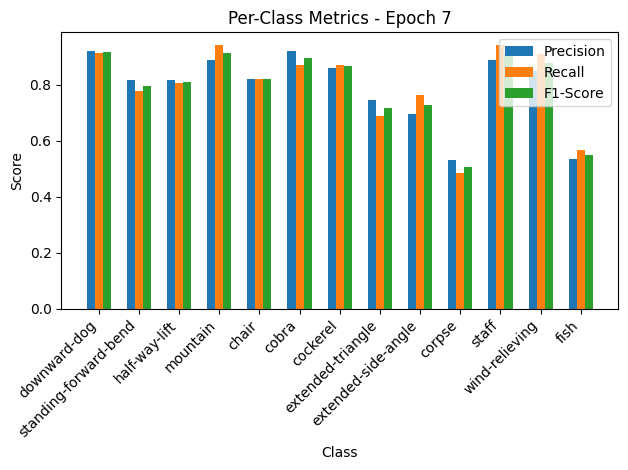

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.66it/s, loss=0.51, accuracy=79.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.54, Recall=1.00, F1-Score=0.70
chair: Precision=0.00, Recall=0.00, F1-Score=0.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.80, Recall=0.89, F1-Score=0.84
extended-side-angle: Precision=0.86, Recall=0.75, F1-Score=0.80
corpse: Precision=0.67, Recall=0.25, F1-Score=0.36
staff: Precision=1.00, Recall=0.88, F1-Score=0.93
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.50, Recall=0.86, F1-Score=0.63


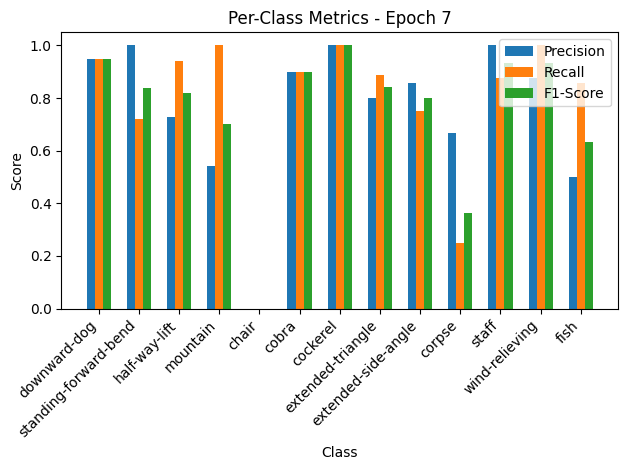


Epoch 8/50 Summary:
Train Loss: 0.5495 | Train Acc: 81.42% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.5594 | Val Acc: 79.45% | Val Precision: 0.76 | Val Recall: 0.78 | Val F1: 0.75

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.15it/s, loss=0.547, accuracy=81.6]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.90, Recall=0.86, F1-Score=0.88
standing-forward-bend: Precision=0.89, Recall=0.85, F1-Score=0.87
half-way-lift: Precision=0.87, Recall=0.87, F1-Score=0.87
mountain: Precision=0.80, Recall=0.86, F1-Score=0.83
chair: Precision=0.81, Recall=0.78, F1-Score=0.80
cobra: Precision=0.87, Recall=0.94, F1-Score=0.90
cockerel: Precision=0.91, Recall=0.92, F1-Score=0.91
extended-triangle: Precision=0.68, Recall=0.69, F1-Score=0.68
extended-side-angle: Precision=0.62, Recall=0.65, F1-Score=0.64
corpse: Precision=0.53, Recall=0.49, F1-Score=0.51
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.91, Recall=0.93, F1-Score=0.92
fish: Precision=0.58, Recall=0.57, F1-Score=0.58


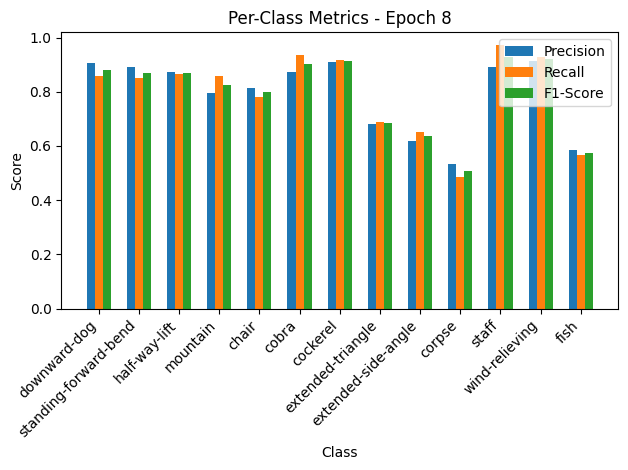

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.50it/s, loss=0.414, accuracy=84.2]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.85, Recall=1.00, F1-Score=0.92
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.20, F1-Score=0.33
extended-triangle: Precision=0.69, Recall=1.00, F1-Score=0.82
extended-side-angle: Precision=0.80, Recall=0.50, F1-Score=0.62
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.47, Recall=1.00, F1-Score=0.64
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


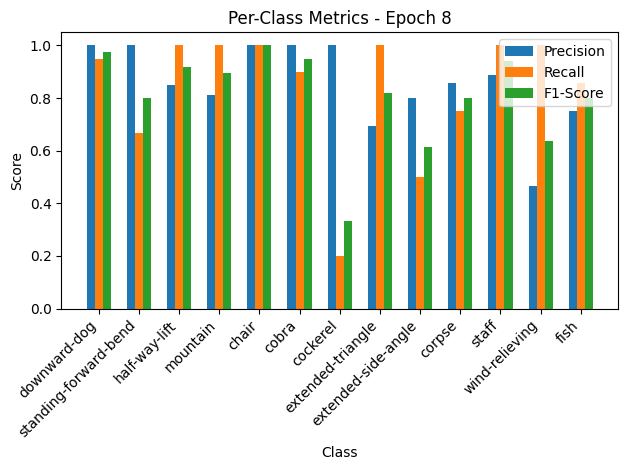


Epoch 9/50 Summary:
Train Loss: 0.5486 | Train Acc: 81.57% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.4537 | Val Acc: 84.25% | Val Precision: 0.86 | Val Recall: 0.83 | Val F1: 0.81

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.50it/s, loss=0.523, accuracy=83.1]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.92, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.92, F1-Score=0.88
mountain: Precision=0.84, Recall=0.92, F1-Score=0.88
chair: Precision=0.85, Recall=0.86, F1-Score=0.86
cobra: Precision=0.91, Recall=0.93, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.70, Recall=0.75, F1-Score=0.72
extended-side-angle: Precision=0.70, Recall=0.64, F1-Score=0.67
corpse: Precision=0.58, Recall=0.54, F1-Score=0.56
staff: Precision=0.86, Recall=0.88, F1-Score=0.87
wind-relieving: Precision=0.88, Recall=0.88, F1-Score=0.88
fish: Precision=0.59, Recall=0.63, F1-Score=0.61


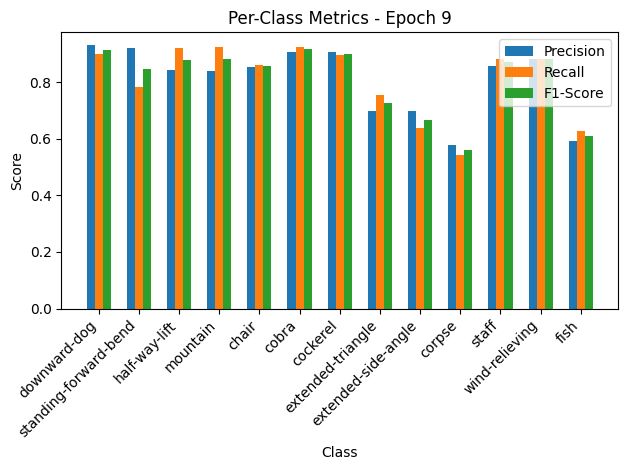

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.83it/s, loss=0.393, accuracy=86.3]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.78, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.82, F1-Score=0.80
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.33, F1-Score=0.50
extended-side-angle: Precision=0.57, Recall=1.00, F1-Score=0.73
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.83, Recall=0.71, F1-Score=0.77


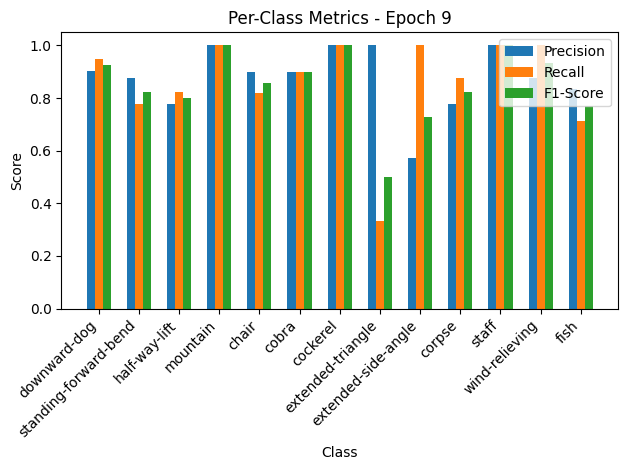


Epoch 10/50 Summary:
Train Loss: 0.5249 | Train Acc: 83.10% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.4309 | Val Acc: 86.30% | Val Precision: 0.88 | Val Recall: 0.86 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.4309

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.30it/s, loss=0.49, accuracy=83.9]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.96, Recall=0.90, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.80, Recall=0.89, F1-Score=0.84
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.92, F1-Score=0.90
extended-triangle: Precision=0.76, Recall=0.73, F1-Score=0.74
extended-side-angle: Precision=0.74, Recall=0.74, F1-Score=0.74
corpse: Precision=0.52, Recall=0.51, F1-Score=0.52
staff: Precision=0.91, Recall=0.93, F1-Score=0.92
wind-relieving: Precision=0.90, Recall=0.90, F1-Score=0.90
fish: Precision=0.54, Recall=0.55, F1-Score=0.54


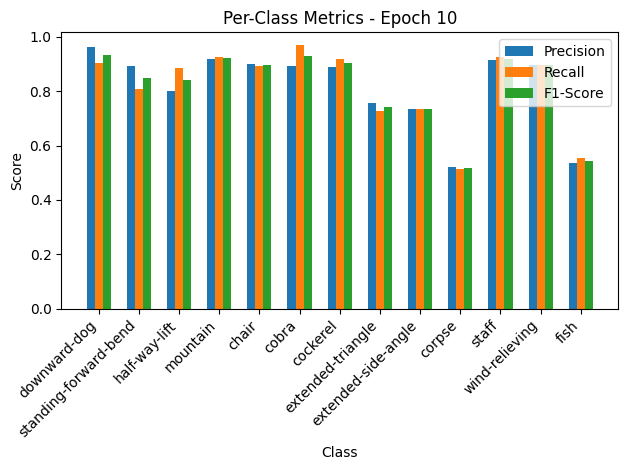

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.18it/s, loss=0.414, accuracy=85.6]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.64, F1-Score=0.78
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.56, Recall=1.00, F1-Score=0.72
extended-side-angle: Precision=1.00, Recall=0.12, F1-Score=0.22
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.64, Recall=1.00, F1-Score=0.78


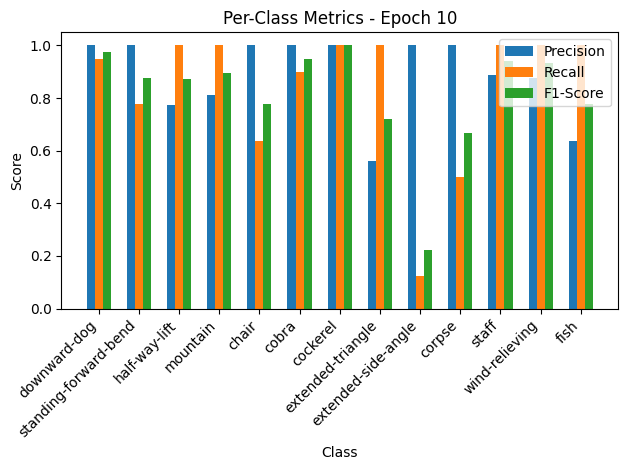


Epoch 11/50 Summary:
Train Loss: 0.4916 | Train Acc: 83.94% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.4533 | Val Acc: 85.62% | Val Precision: 0.89 | Val Recall: 0.84 | Val F1: 0.82

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.12it/s, loss=0.555, accuracy=82.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.89, F1-Score=0.92
standing-forward-bend: Precision=0.87, Recall=0.81, F1-Score=0.84
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.92, F1-Score=0.89
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.87, Recall=0.96, F1-Score=0.91
cockerel: Precision=0.83, Recall=0.85, F1-Score=0.84
extended-triangle: Precision=0.70, Recall=0.75, F1-Score=0.72
extended-side-angle: Precision=0.75, Recall=0.71, F1-Score=0.73
corpse: Precision=0.57, Recall=0.50, F1-Score=0.53
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.46, Recall=0.43, F1-Score=0.45


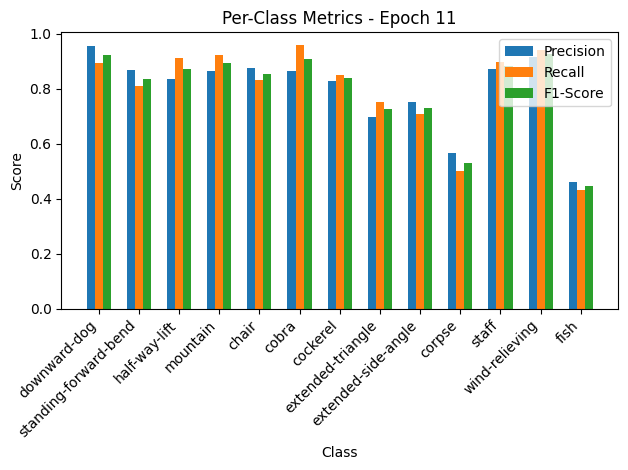

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.06it/s, loss=0.359, accuracy=85.6]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.64, F1-Score=0.78
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.69, Recall=1.00, F1-Score=0.82
extended-side-angle: Precision=1.00, Recall=0.50, F1-Score=0.67
corpse: Precision=0.53, Recall=1.00, F1-Score=0.70
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


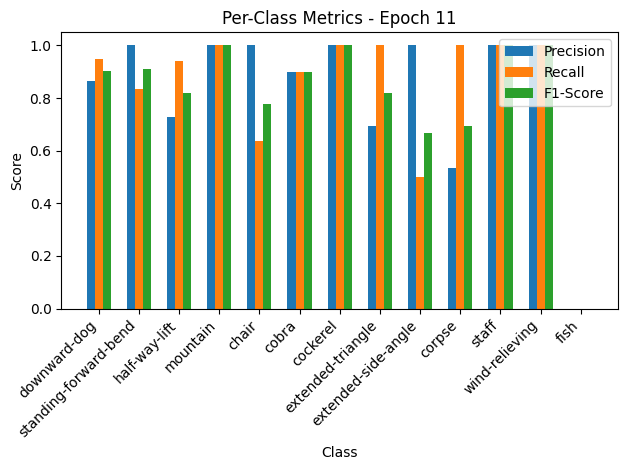


Epoch 12/50 Summary:
Train Loss: 0.5563 | Train Acc: 82.49% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.3934 | Val Acc: 85.62% | Val Precision: 0.82 | Val Recall: 0.83 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.3934

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.68it/s, loss=0.493, accuracy=83.5]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.93, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.79, F1-Score=0.85
half-way-lift: Precision=0.85, Recall=0.92, F1-Score=0.88
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.93, Recall=0.85, F1-Score=0.89
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.87, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.72, Recall=0.73, F1-Score=0.72
extended-side-angle: Precision=0.72, Recall=0.72, F1-Score=0.72
corpse: Precision=0.49, Recall=0.50, F1-Score=0.49
staff: Precision=0.88, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.86, Recall=0.99, F1-Score=0.92
fish: Precision=0.55, Recall=0.49, F1-Score=0.52


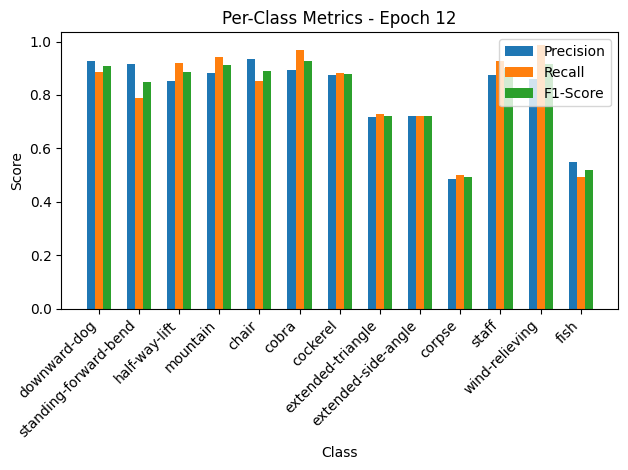

Validation: 100%|██████████| 10/10 [00:00<00:00, 44.41it/s, loss=0.311, accuracy=89.7]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=1.00, Recall=0.88, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.44, Recall=1.00, F1-Score=0.61


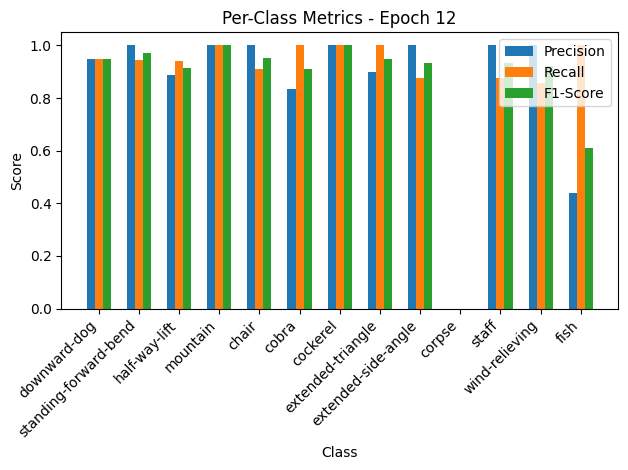


Epoch 13/50 Summary:
Train Loss: 0.4945 | Train Acc: 83.49% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.3404 | Val Acc: 89.73% | Val Precision: 0.85 | Val Recall: 0.87 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 13
New best model saved! Validation Loss: 0.3404

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.08it/s, loss=0.496, accuracy=83.6]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.85, Recall=0.81, F1-Score=0.83
half-way-lift: Precision=0.87, Recall=0.86, F1-Score=0.87
mountain: Precision=0.85, Recall=0.92, F1-Score=0.88
chair: Precision=0.91, Recall=0.88, F1-Score=0.89
cobra: Precision=0.88, Recall=0.95, F1-Score=0.91
cockerel: Precision=0.92, Recall=0.93, F1-Score=0.92
extended-triangle: Precision=0.79, Recall=0.77, F1-Score=0.78
extended-side-angle: Precision=0.79, Recall=0.75, F1-Score=0.77
corpse: Precision=0.53, Recall=0.40, F1-Score=0.45
staff: Precision=0.87, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.86, Recall=0.91, F1-Score=0.89
fish: Precision=0.49, Recall=0.58, F1-Score=0.53


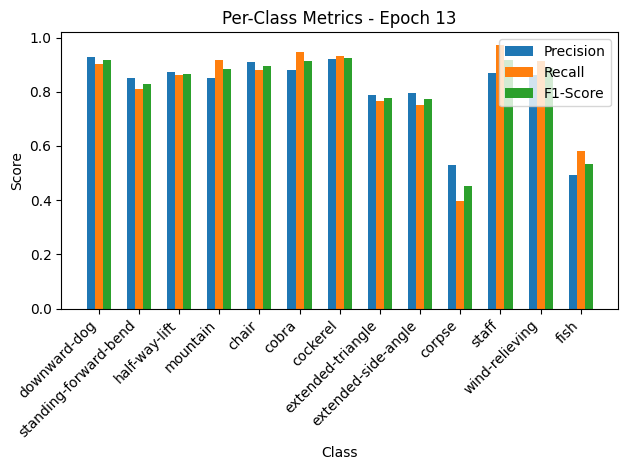

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.65it/s, loss=0.349, accuracy=87]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.50, Recall=0.25, F1-Score=0.33
staff: Precision=0.62, Recall=1.00, F1-Score=0.76
wind-relieving: Precision=0.86, Recall=0.86, F1-Score=0.86
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


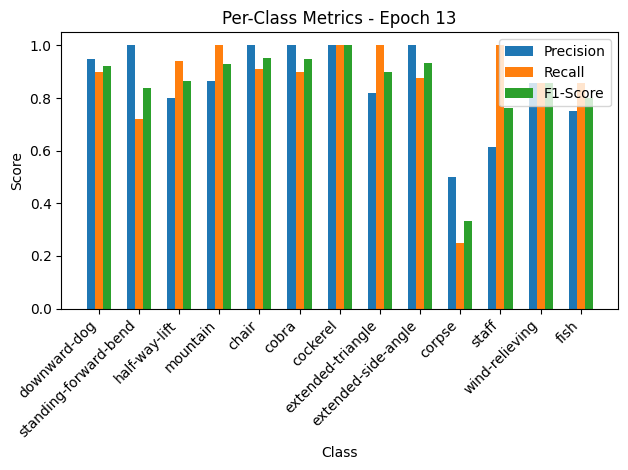


Epoch 14/50 Summary:
Train Loss: 0.4979 | Train Acc: 83.56% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.3820 | Val Acc: 86.99% | Val Precision: 0.86 | Val Recall: 0.86 | Val F1: 0.85

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.84it/s, loss=0.56, accuracy=81.9]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.75, F1-Score=0.82
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.81, Recall=0.91, F1-Score=0.86
chair: Precision=0.88, Recall=0.85, F1-Score=0.86
cobra: Precision=0.89, Recall=0.93, F1-Score=0.91
cockerel: Precision=0.85, Recall=0.92, F1-Score=0.88
extended-triangle: Precision=0.74, Recall=0.69, F1-Score=0.71
extended-side-angle: Precision=0.69, Recall=0.69, F1-Score=0.69
corpse: Precision=0.56, Recall=0.53, F1-Score=0.55
staff: Precision=0.86, Recall=0.91, F1-Score=0.89
wind-relieving: Precision=0.91, Recall=0.85, F1-Score=0.88
fish: Precision=0.59, Recall=0.66, F1-Score=0.62


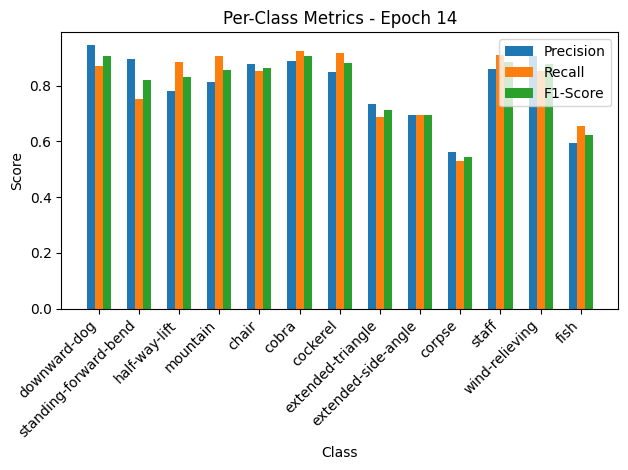

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.23it/s, loss=0.486, accuracy=80.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.62, Recall=0.83, F1-Score=0.71
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=0.23, F1-Score=0.38
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=1.00, Recall=0.88, F1-Score=0.93
wind-relieving: Precision=0.78, Recall=1.00, F1-Score=0.88
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


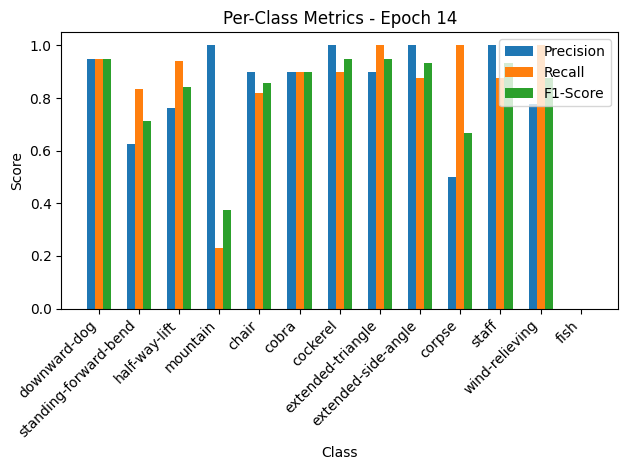


Epoch 15/50 Summary:
Train Loss: 0.5619 | Train Acc: 81.88% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.5329 | Val Acc: 80.82% | Val Precision: 0.79 | Val Recall: 0.79 | Val F1: 0.76

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.44it/s, loss=0.5, accuracy=82.4]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.91, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.91, F1-Score=0.86
mountain: Precision=0.88, Recall=0.94, F1-Score=0.91
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.86, Recall=0.87, F1-Score=0.87
cockerel: Precision=0.88, Recall=0.86, F1-Score=0.87
extended-triangle: Precision=0.79, Recall=0.79, F1-Score=0.79
extended-side-angle: Precision=0.77, Recall=0.79, F1-Score=0.78
corpse: Precision=0.47, Recall=0.38, F1-Score=0.42
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.88, Recall=0.94, F1-Score=0.91
fish: Precision=0.46, Recall=0.54, F1-Score=0.50


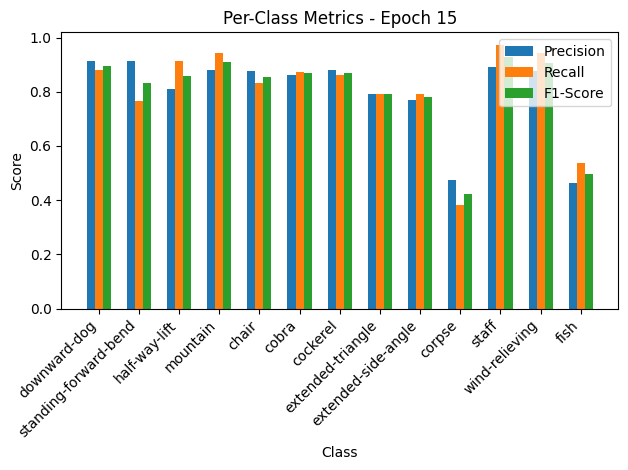

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.00it/s, loss=0.38, accuracy=81.5]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.69, Recall=1.00, F1-Score=0.82
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.62, Recall=1.00, F1-Score=0.76
chair: Precision=1.00, Recall=0.45, F1-Score=0.62
cobra: Precision=1.00, Recall=0.10, F1-Score=0.18
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


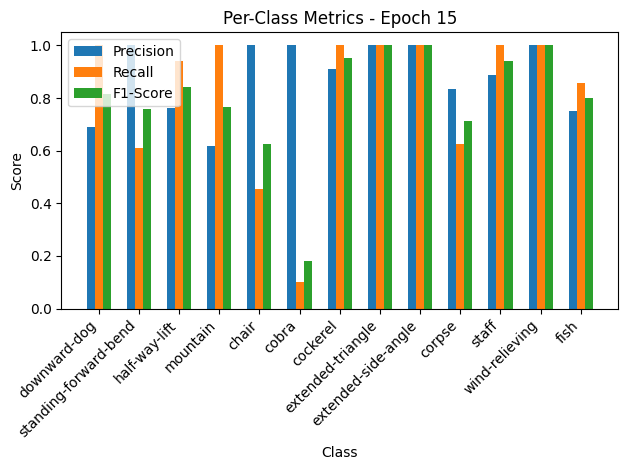


Epoch 16/50 Summary:
Train Loss: 0.5017 | Train Acc: 82.42% | Train Precision: 0.80 | Train Recall: 0.81 | Train F1: 0.80
Val Loss: 0.4170 | Val Acc: 81.51% | Val Precision: 0.88 | Val Recall: 0.81 | Val F1: 0.80

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.30it/s, loss=0.538, accuracy=84.8]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.94, Recall=0.87, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.86, Recall=0.91, F1-Score=0.88
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.88, Recall=0.88, F1-Score=0.88
cobra: Precision=0.91, Recall=0.97, F1-Score=0.94
cockerel: Precision=0.88, Recall=0.97, F1-Score=0.92
extended-triangle: Precision=0.77, Recall=0.75, F1-Score=0.76
extended-side-angle: Precision=0.76, Recall=0.81, F1-Score=0.78
corpse: Precision=0.63, Recall=0.38, F1-Score=0.48
staff: Precision=0.90, Recall=0.91, F1-Score=0.91
wind-relieving: Precision=0.86, Recall=0.91, F1-Score=0.89
fish: Precision=0.58, Recall=0.75, F1-Score=0.65


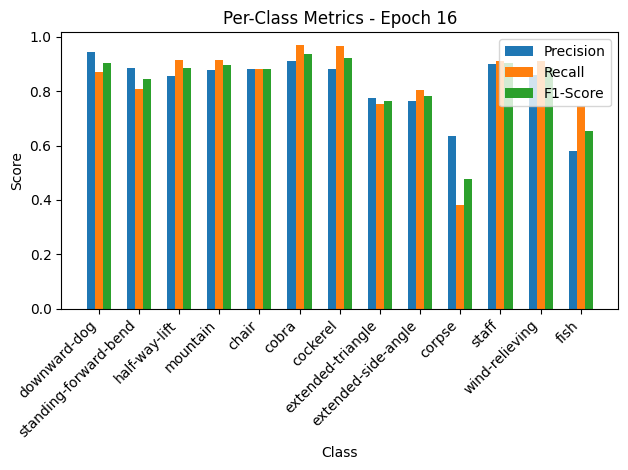

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.10it/s, loss=0.325, accuracy=85.6]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.92, Recall=0.61, F1-Score=0.73
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.75, Recall=0.92, F1-Score=0.83
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


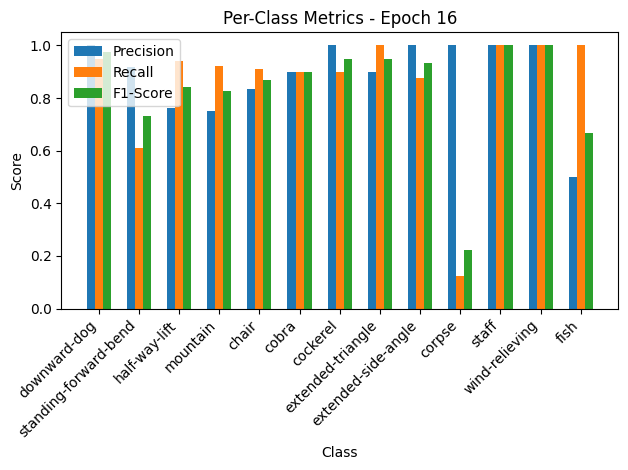


Epoch 17/50 Summary:
Train Loss: 0.5400 | Train Acc: 84.79% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.3567 | Val Acc: 85.62% | Val Precision: 0.89 | Val Recall: 0.86 | Val F1: 0.84

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.31it/s, loss=0.558, accuracy=83.1]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.90, Recall=0.85, F1-Score=0.87
standing-forward-bend: Precision=0.90, Recall=0.73, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.87, F1-Score=0.83
mountain: Precision=0.82, Recall=0.90, F1-Score=0.86
chair: Precision=0.86, Recall=0.87, F1-Score=0.87
cobra: Precision=0.86, Recall=0.94, F1-Score=0.90
cockerel: Precision=0.82, Recall=0.90, F1-Score=0.86
extended-triangle: Precision=0.77, Recall=0.82, F1-Score=0.79
extended-side-angle: Precision=0.83, Recall=0.76, F1-Score=0.80
corpse: Precision=0.66, Recall=0.49, F1-Score=0.56
staff: Precision=0.89, Recall=0.93, F1-Score=0.91
wind-relieving: Precision=0.93, Recall=0.96, F1-Score=0.94
fish: Precision=0.62, Recall=0.75, F1-Score=0.68


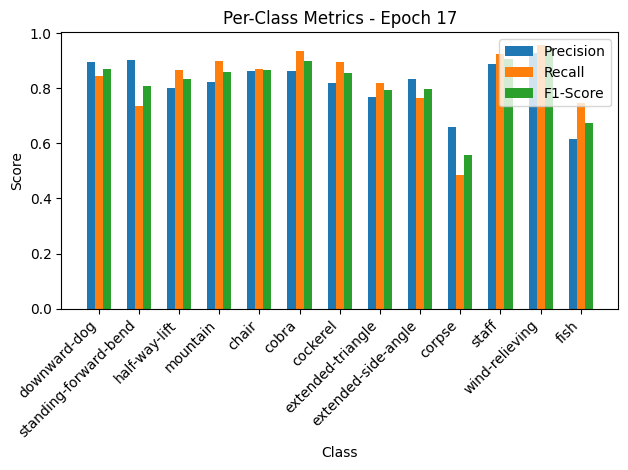

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.48it/s, loss=0.33, accuracy=87.7]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.86, Recall=0.86, F1-Score=0.86
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


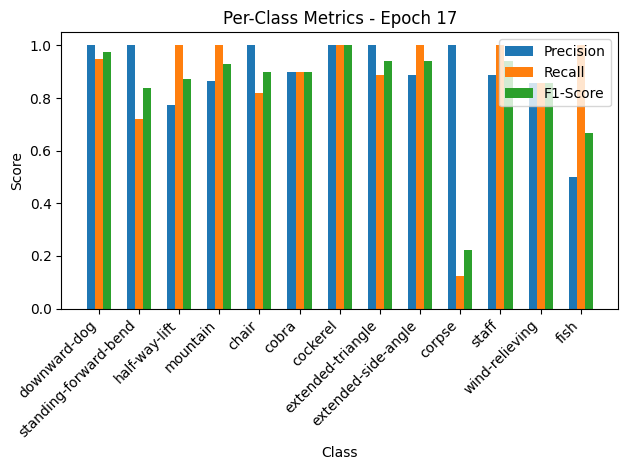


Epoch 18/50 Summary:
Train Loss: 0.5593 | Train Acc: 83.10% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.3614 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.84

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.16it/s, loss=0.385, accuracy=88.1]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.95, Recall=0.77, F1-Score=0.85
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.87
mountain: Precision=0.88, Recall=0.97, F1-Score=0.92
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.91, Recall=0.99, F1-Score=0.95
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.89, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.88, F1-Score=0.88
corpse: Precision=0.86, Recall=0.26, F1-Score=0.40
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.57, Recall=0.93, F1-Score=0.70


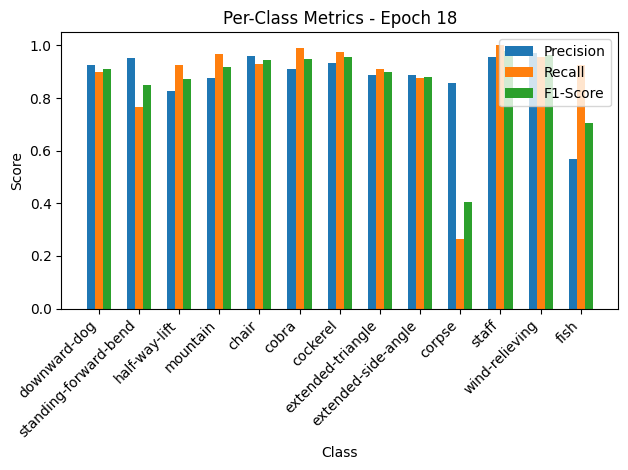

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.82it/s, loss=0.194, accuracy=93.8]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


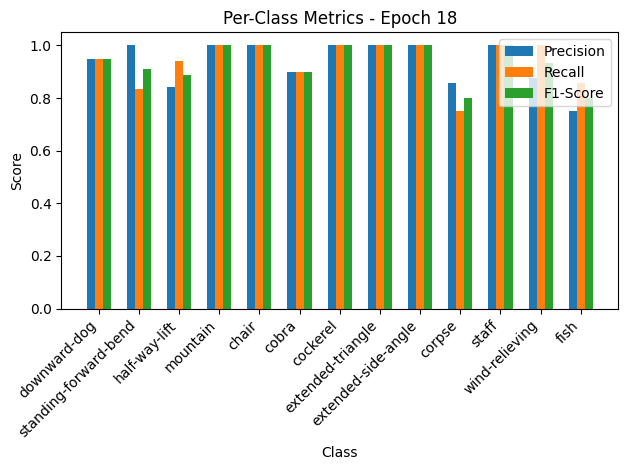


Epoch 19/50 Summary:
Train Loss: 0.3863 | Train Acc: 88.15% | Train Precision: 0.89 | Train Recall: 0.88 | Train F1: 0.86
Val Loss: 0.2127 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 19
New best model saved! Validation Loss: 0.2127

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.26it/s, loss=0.348, accuracy=89.1]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.86, Recall=0.93, F1-Score=0.89
mountain: Precision=0.90, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.90, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.87, Recall=0.92, F1-Score=0.89
extended-side-angle: Precision=0.86, Recall=0.83, F1-Score=0.85
corpse: Precision=0.68, Recall=0.44, F1-Score=0.54
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=0.94, Recall=0.99, F1-Score=0.96
fish: Precision=0.60, Recall=0.75, F1-Score=0.67


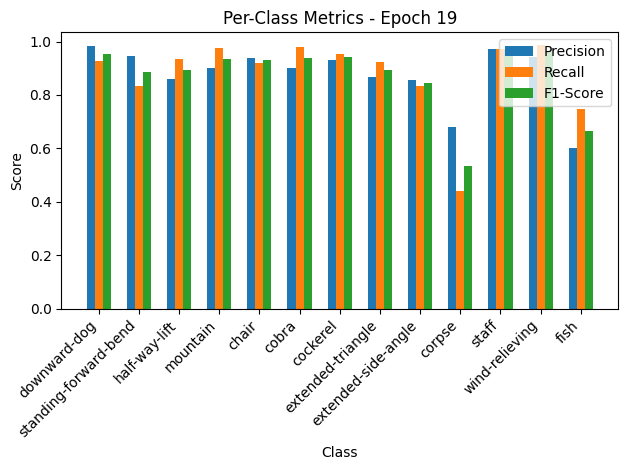

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.02it/s, loss=0.168, accuracy=93.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


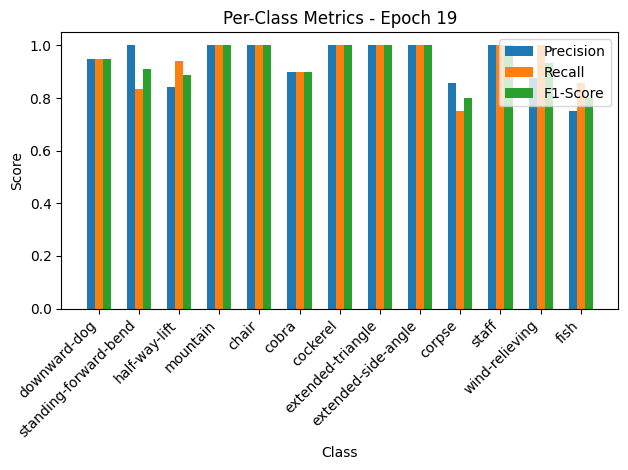


Epoch 20/50 Summary:
Train Loss: 0.3489 | Train Acc: 89.07% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.87
Val Loss: 0.1840 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.1840

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.65it/s, loss=0.31, accuracy=90.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.93, Recall=0.86, F1-Score=0.89
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.89, Recall=0.99, F1-Score=0.94
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.91, Recall=0.99, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.92
corpse: Precision=0.69, Recall=0.60, F1-Score=0.65
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.64, Recall=0.69, F1-Score=0.66


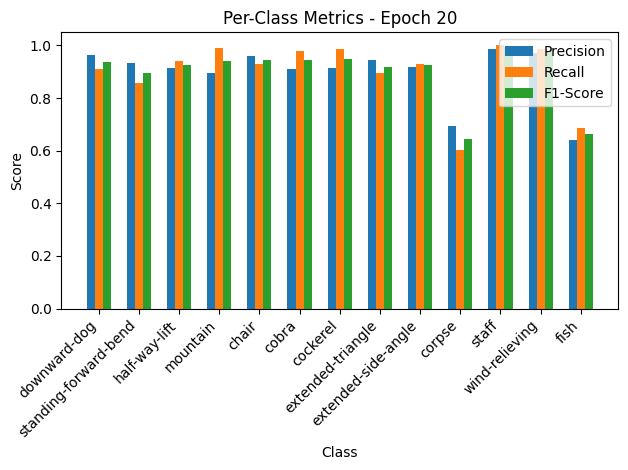

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.59it/s, loss=0.18, accuracy=92.5]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.57, Recall=1.00, F1-Score=0.73
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=1.00, Recall=0.14, F1-Score=0.25


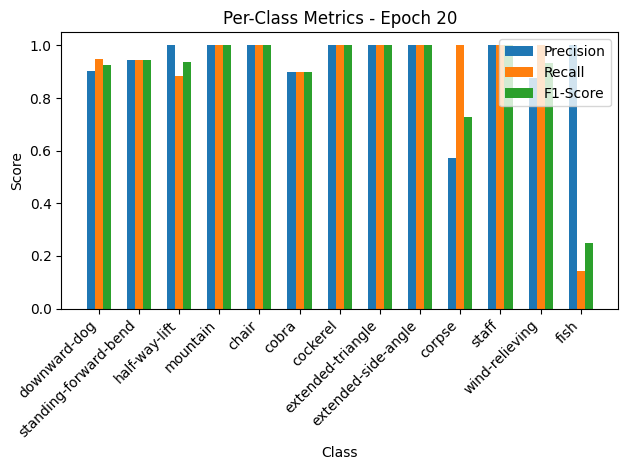


Epoch 21/50 Summary:
Train Loss: 0.3105 | Train Acc: 90.75% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.1974 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.91 | Val F1: 0.89

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.34it/s, loss=0.289, accuracy=91.7]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.92, F1-Score=0.93
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.98, Recall=0.93, F1-Score=0.95
cobra: Precision=0.90, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.92, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.88, Recall=0.94, F1-Score=0.91
extended-side-angle: Precision=0.93, Recall=0.89, F1-Score=0.91
corpse: Precision=0.63, Recall=0.84, F1-Score=0.72
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.78, Recall=0.52, F1-Score=0.62


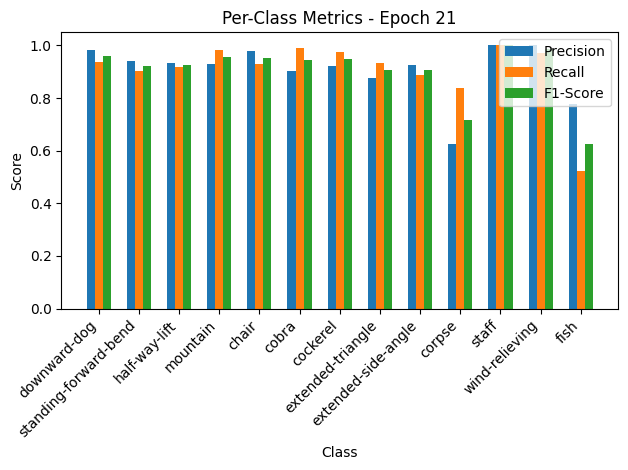

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.19it/s, loss=0.167, accuracy=93.2]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.58, Recall=0.88, F1-Score=0.70
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=0.67, Recall=0.29, F1-Score=0.40


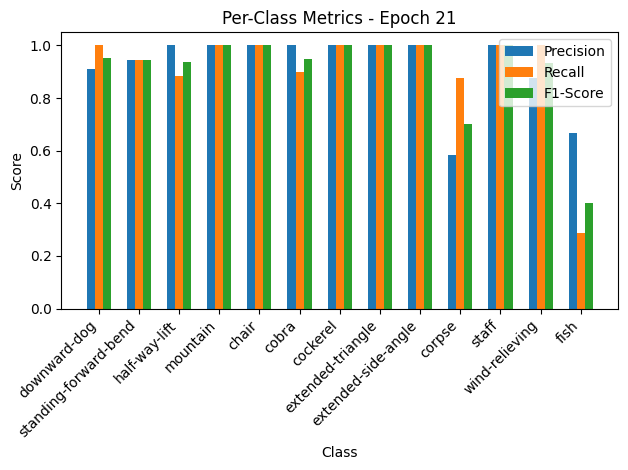


Epoch 22/50 Summary:
Train Loss: 0.2902 | Train Acc: 91.67% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.90
Val Loss: 0.1828 | Val Acc: 93.15% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 22
New best model saved! Validation Loss: 0.1828

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.91it/s, loss=0.283, accuracy=91.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.97, Recall=0.92, F1-Score=0.94
cobra: Precision=0.97, Recall=0.96, F1-Score=0.96
cockerel: Precision=0.95, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.94, F1-Score=0.93
corpse: Precision=0.69, Recall=0.74, F1-Score=0.71
staff: Precision=0.94, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.73, Recall=0.69, F1-Score=0.71


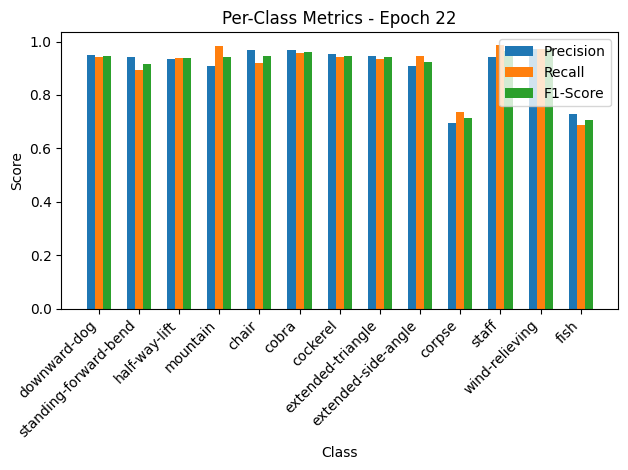

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.26it/s, loss=0.132, accuracy=97.3]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


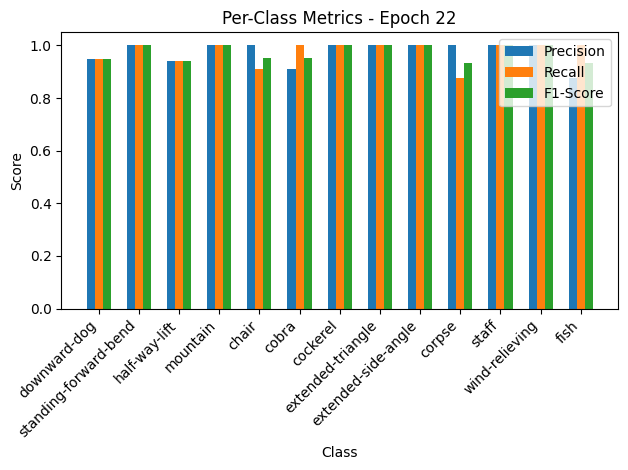


Epoch 23/50 Summary:
Train Loss: 0.2835 | Train Acc: 91.90% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.1450 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.1450

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.10it/s, loss=0.285, accuracy=92.4]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.92, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.90, Recall=0.99, F1-Score=0.94
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.92, F1-Score=0.92
corpse: Precision=0.72, Recall=0.76, F1-Score=0.74
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=1.00, F1-Score=0.98
fish: Precision=0.77, Recall=0.70, F1-Score=0.73


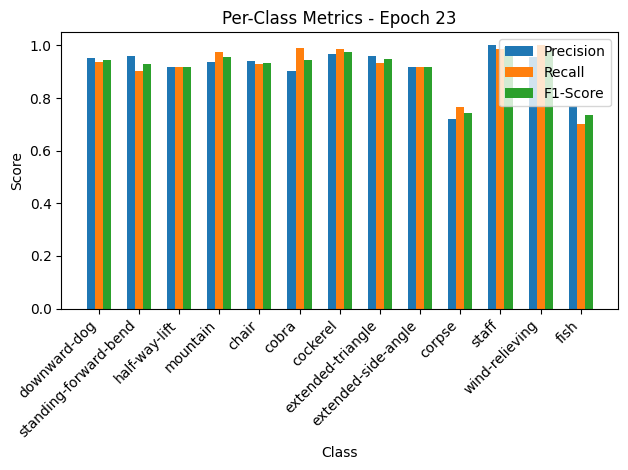

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.21it/s, loss=0.155, accuracy=94.5]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.67, Recall=1.00, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=1.00, Recall=0.43, F1-Score=0.60


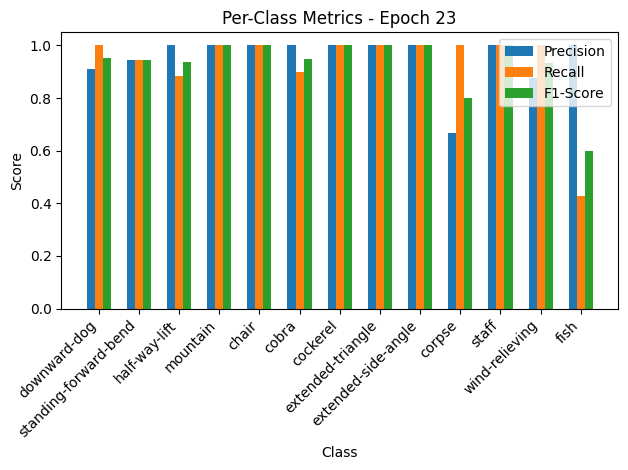


Epoch 24/50 Summary:
Train Loss: 0.2857 | Train Acc: 92.43% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1694 | Val Acc: 94.52% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.93

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.09it/s, loss=0.263, accuracy=93.7]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.98, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.89, Recall=0.99, F1-Score=0.93
corpse: Precision=0.83, Recall=0.74, F1-Score=0.78
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.77, Recall=0.84, F1-Score=0.80


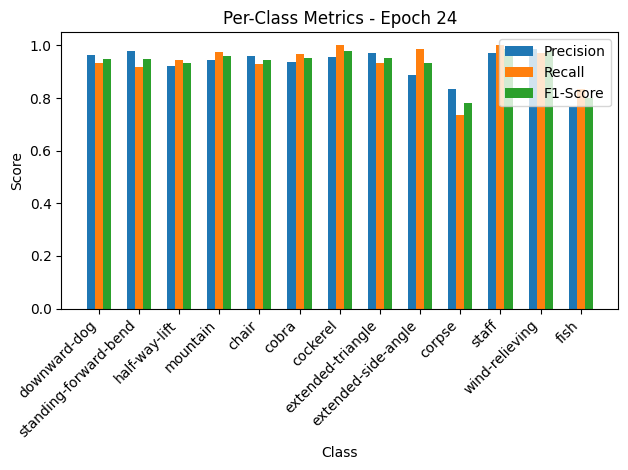

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.71it/s, loss=0.109, accuracy=97.3]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.89, Recall=0.94, F1-Score=0.92
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


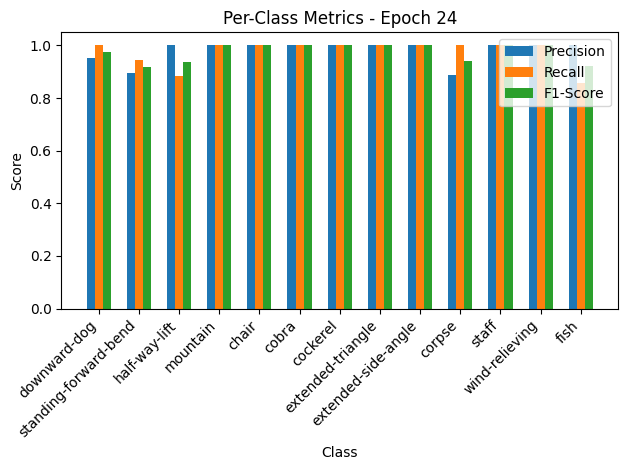


Epoch 25/50 Summary:
Train Loss: 0.2634 | Train Acc: 93.65% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1195 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 25
New best model saved! Validation Loss: 0.1195

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.72it/s, loss=0.276, accuracy=92.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.91, Recall=0.97, F1-Score=0.94
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.90, F1-Score=0.93
corpse: Precision=0.72, Recall=0.63, F1-Score=0.67
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.68, Recall=0.75, F1-Score=0.71


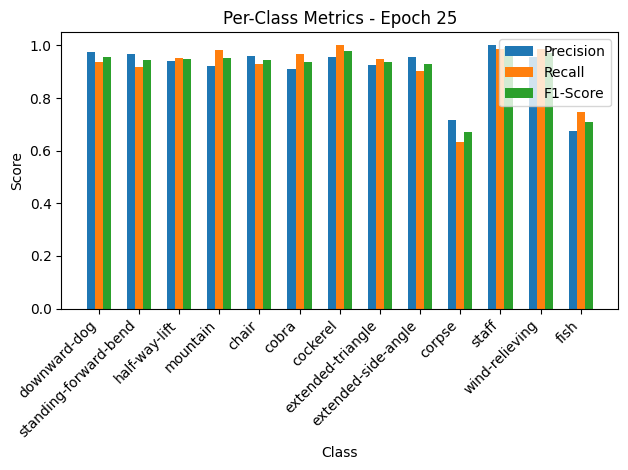

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.77it/s, loss=0.107, accuracy=98.6]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


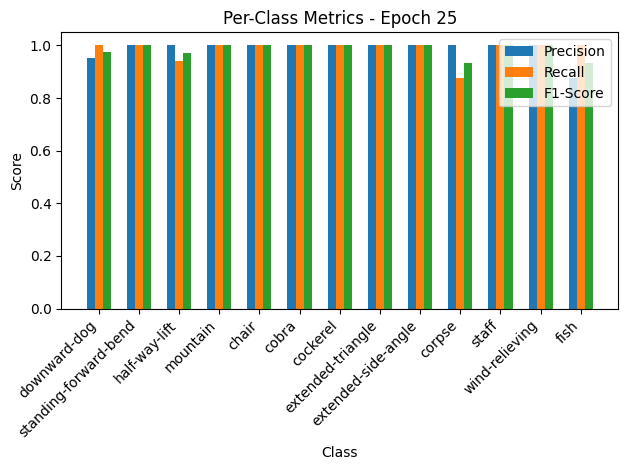


Epoch 26/50 Summary:
Train Loss: 0.2771 | Train Acc: 92.51% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.1178 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.1178

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.17it/s, loss=0.252, accuracy=94.2]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.96, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.92, F1-Score=0.94
corpse: Precision=0.77, Recall=0.85, F1-Score=0.81
staff: Precision=0.96, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.83, Recall=0.75, F1-Score=0.79


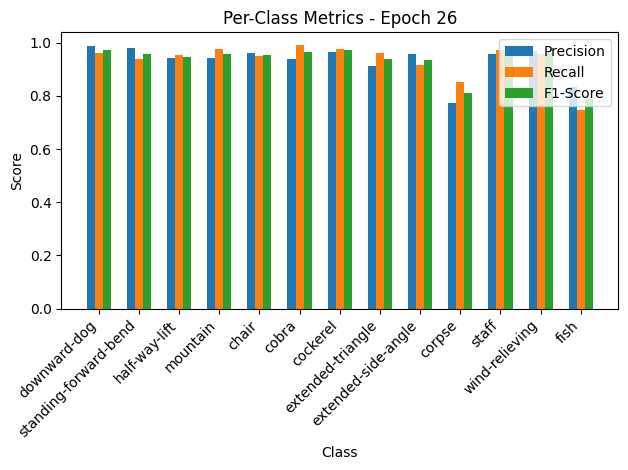

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.91it/s, loss=0.0978, accuracy=97.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


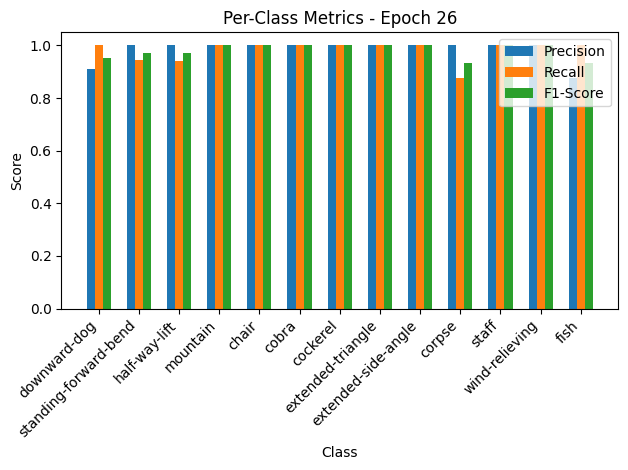


Epoch 27/50 Summary:
Train Loss: 0.2523 | Train Acc: 94.19% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1071 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 27
New best model saved! Validation Loss: 0.1071

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.64it/s, loss=0.236, accuracy=94.4]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.93, Recall=0.99, F1-Score=0.96
corpse: Precision=0.77, Recall=0.84, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.82, Recall=0.70, F1-Score=0.76


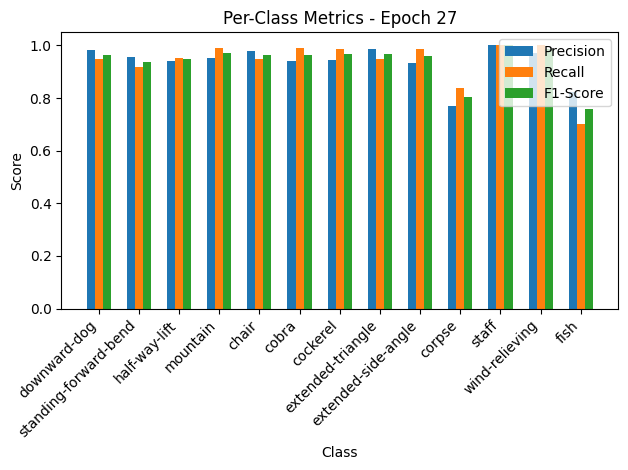

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.20it/s, loss=0.119, accuracy=97.3]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.71, F1-Score=0.83


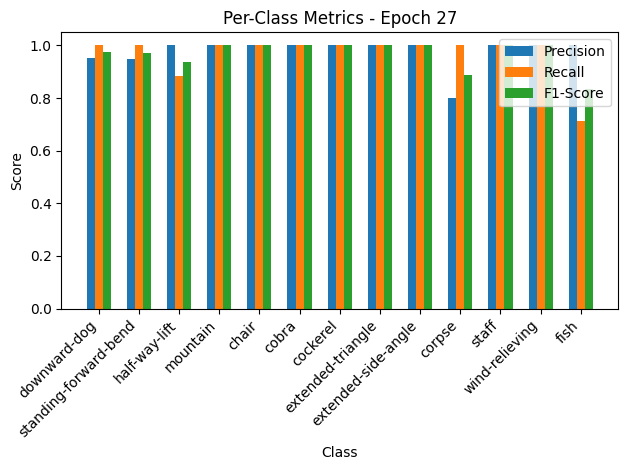


Epoch 28/50 Summary:
Train Loss: 0.2367 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1306 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.97

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.91it/s, loss=0.241, accuracy=94]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.92, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.94, F1-Score=0.93
corpse: Precision=0.80, Recall=0.84, F1-Score=0.82
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.79, F1-Score=0.82


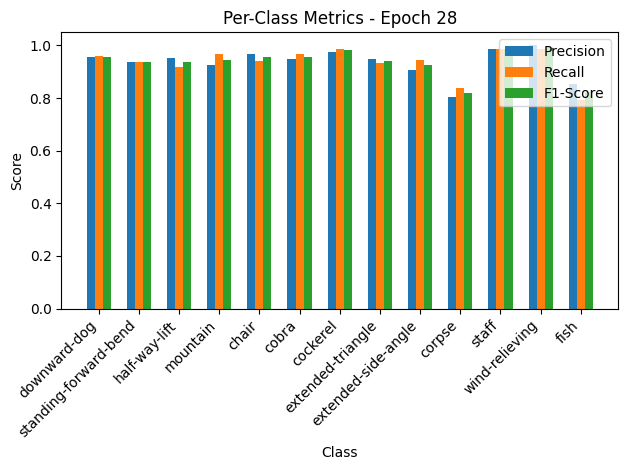

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.09it/s, loss=0.104, accuracy=97.9]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


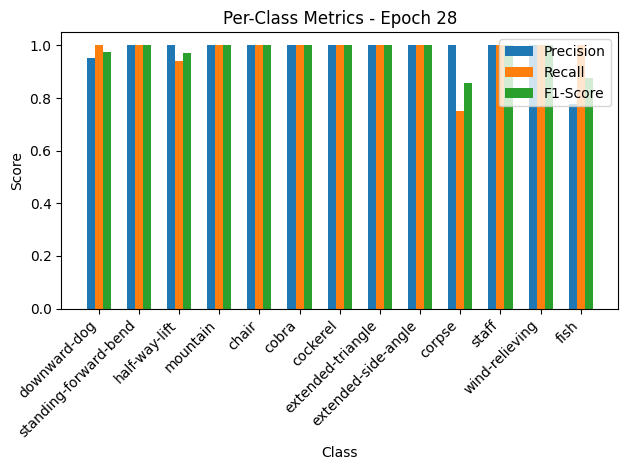


Epoch 29/50 Summary:
Train Loss: 0.2416 | Train Acc: 93.96% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1140 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.51it/s, loss=0.242, accuracy=94.5]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.93, Recall=0.92, F1-Score=0.92
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.87, Recall=0.88, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.85, F1-Score=0.86


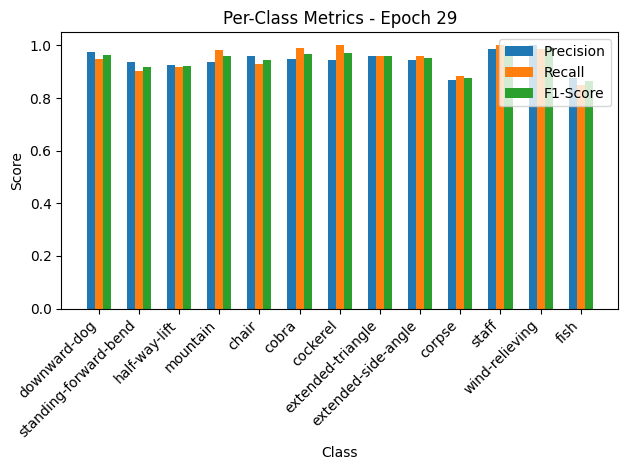

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.21it/s, loss=0.0941, accuracy=97.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


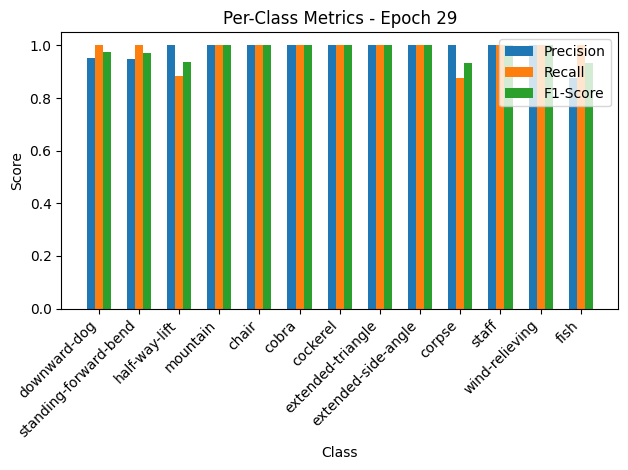


Epoch 30/50 Summary:
Train Loss: 0.2426 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1031 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 30
New best model saved! Validation Loss: 0.1031

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.47it/s, loss=0.248, accuracy=94.1]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.92, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.79, Recall=0.78, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.79, Recall=0.81, F1-Score=0.80


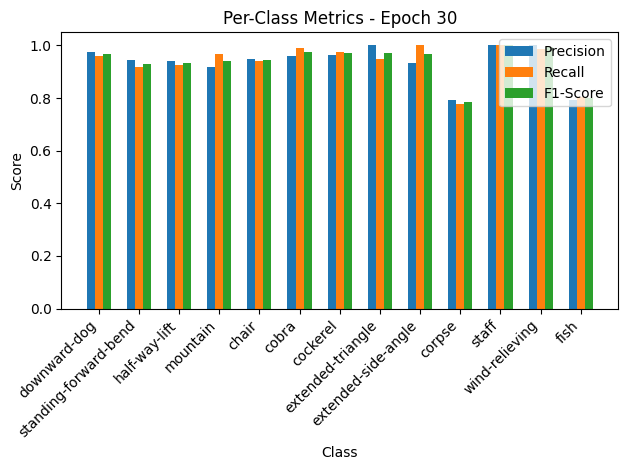

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.08it/s, loss=0.192, accuracy=94.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.62, Recall=1.00, F1-Score=0.76
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.29, F1-Score=0.44


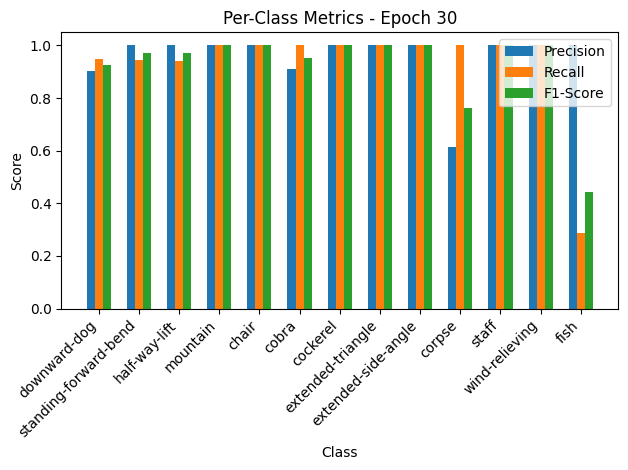


Epoch 31/50 Summary:
Train Loss: 0.2491 | Train Acc: 94.11% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2105 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.93 | Val F1: 0.93

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.96it/s, loss=0.241, accuracy=94.3]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.96, F1-Score=0.96
fish: Precision=0.85, Recall=0.82, F1-Score=0.83


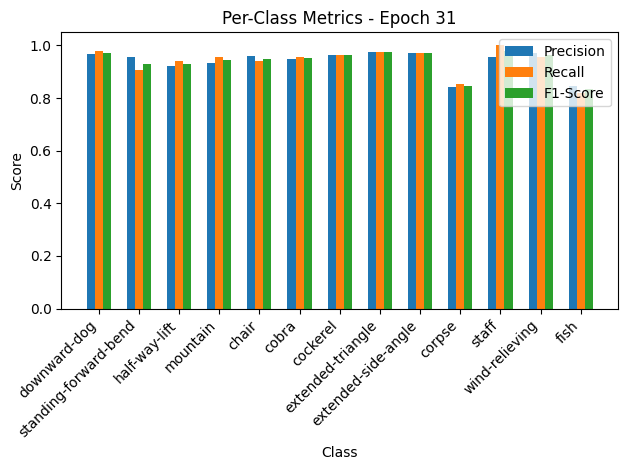

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.18it/s, loss=0.0881, accuracy=98.6]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


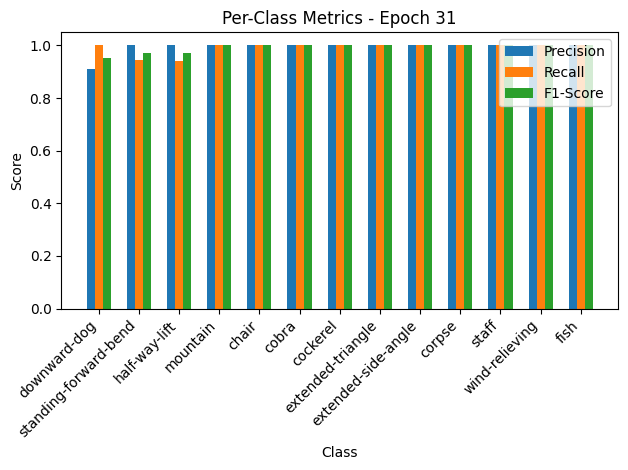


Epoch 32/50 Summary:
Train Loss: 0.2414 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.0966 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 32
New best model saved! Validation Loss: 0.0966

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.77it/s, loss=0.242, accuracy=94]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.96, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.95, Recall=0.93, F1-Score=0.94
mountain: Precision=0.92, Recall=0.98, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.79, Recall=0.81, F1-Score=0.80
staff: Precision=0.98, Recall=0.96, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


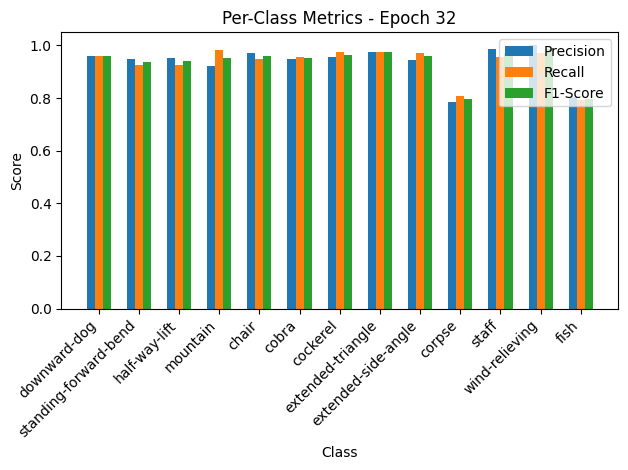

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.30it/s, loss=0.115, accuracy=97.9]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


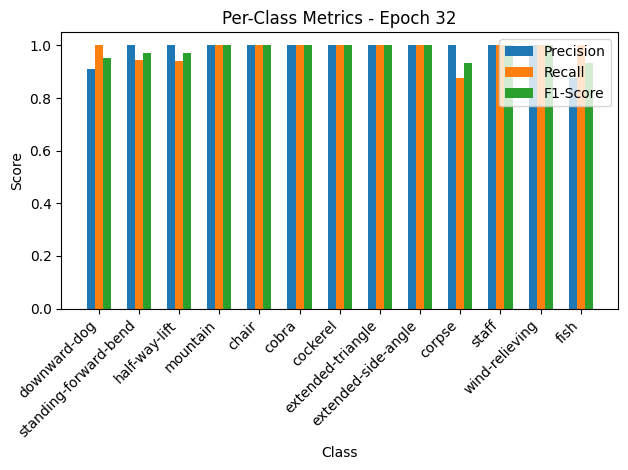


Epoch 33/50 Summary:
Train Loss: 0.2423 | Train Acc: 93.96% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1266 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.11it/s, loss=0.221, accuracy=95.9]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.92, Recall=0.99, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.94, F1-Score=0.95
corpse: Precision=0.89, Recall=0.84, F1-Score=0.86
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.85, Recall=0.90, F1-Score=0.87


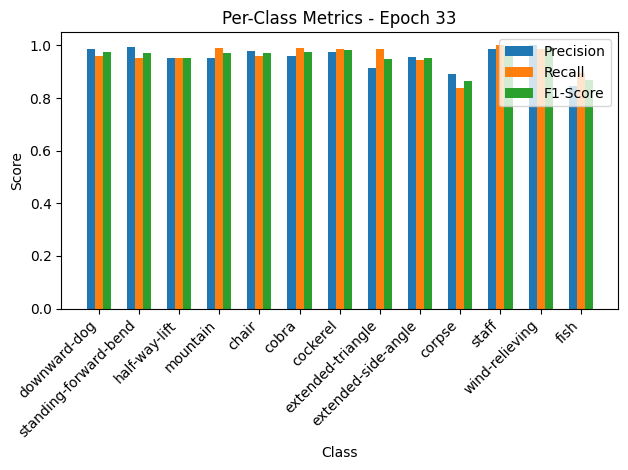

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.53it/s, loss=0.12, accuracy=96.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.90, Recall=1.00, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.82, F1-Score=0.88
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


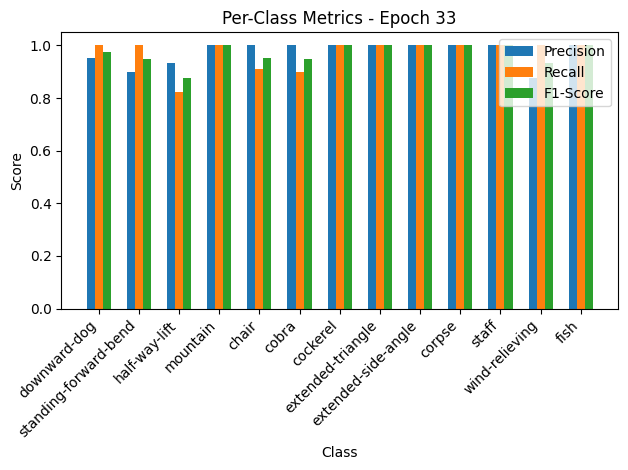


Epoch 34/50 Summary:
Train Loss: 0.2221 | Train Acc: 95.95% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1314 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.16it/s, loss=0.229, accuracy=94.5]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.99, F1-Score=0.97
mountain: Precision=0.93, Recall=0.98, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.80, Recall=0.81, F1-Score=0.80
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.79, F1-Score=0.80


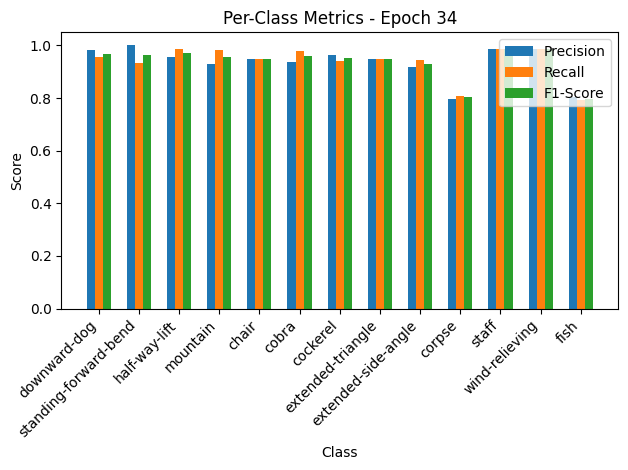

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.21it/s, loss=0.145, accuracy=95.2]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.88, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.88, Recall=1.00, F1-Score=0.93
fish: Precision=1.00, Recall=0.71, F1-Score=0.83


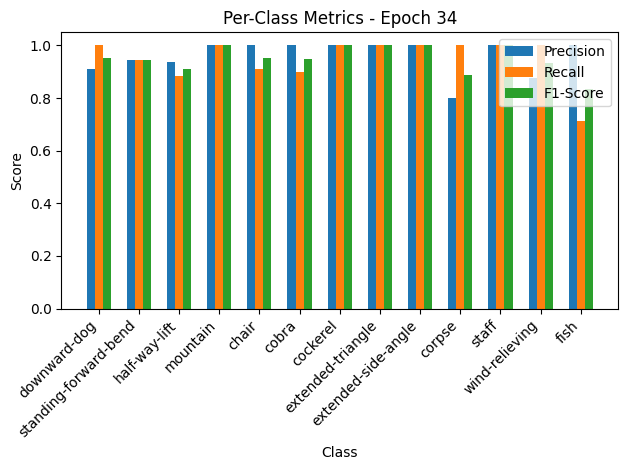


Epoch 35/50 Summary:
Train Loss: 0.2298 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1590 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.35it/s, loss=0.232, accuracy=95]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.95, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.98, F1-Score=0.95
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.94, F1-Score=0.93
corpse: Precision=0.83, Recall=0.88, F1-Score=0.86
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.81, F1-Score=0.84


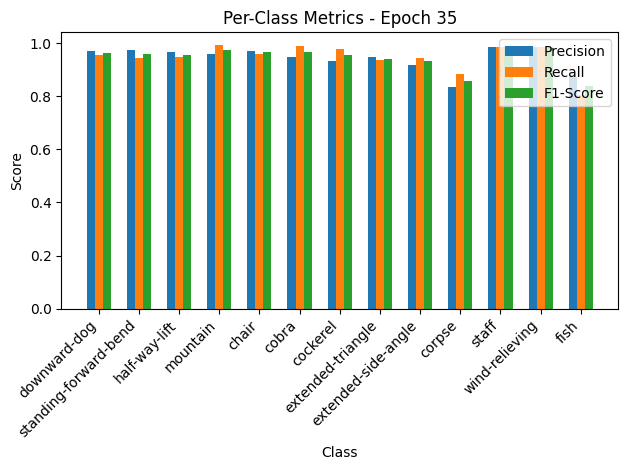

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.30it/s, loss=0.116, accuracy=95.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.71, F1-Score=0.83


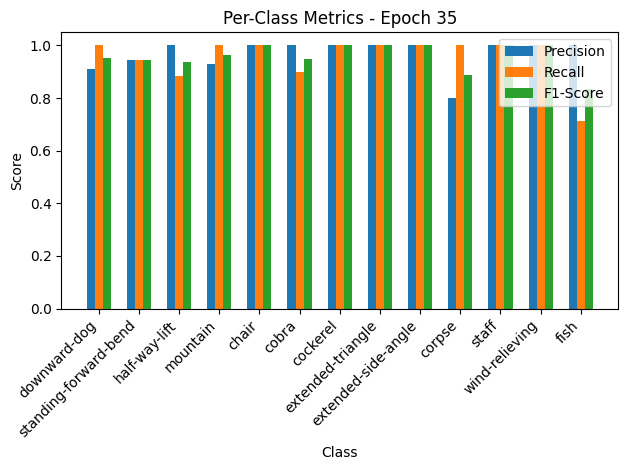


Epoch 36/50 Summary:
Train Loss: 0.2331 | Train Acc: 95.03% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.1275 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.96

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.80it/s, loss=0.221, accuracy=95.6]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.96, F1-Score=0.96
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.83, Recall=0.87, F1-Score=0.85
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.89, Recall=0.82, F1-Score=0.85


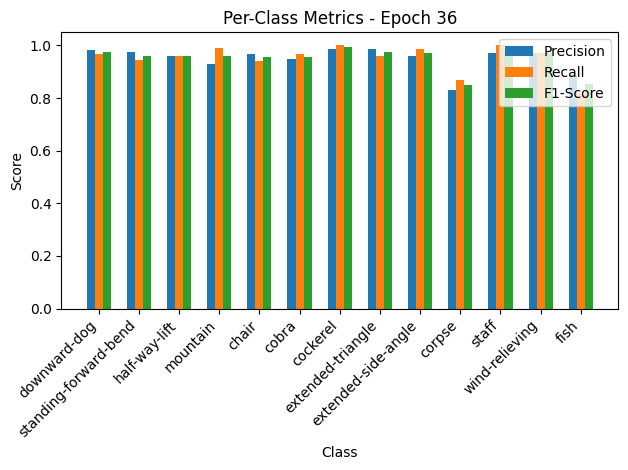

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.64it/s, loss=0.092, accuracy=97.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


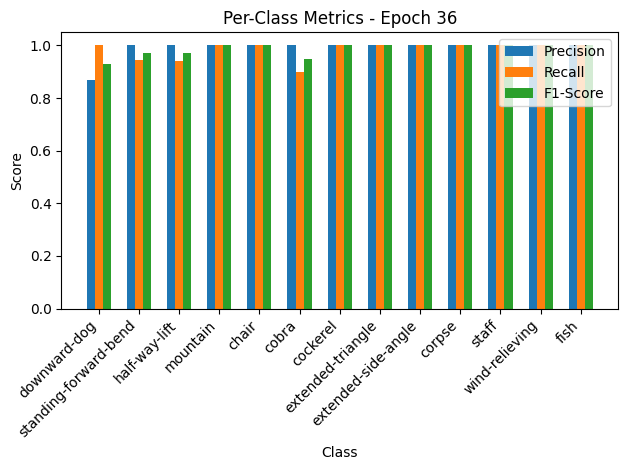


Epoch 37/50 Summary:
Train Loss: 0.2214 | Train Acc: 95.57% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1008 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.99

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  9.08it/s, loss=0.208, accuracy=96]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.95
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.95, Recall=0.96, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.92, F1-Score=0.94
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.88, F1-Score=0.89


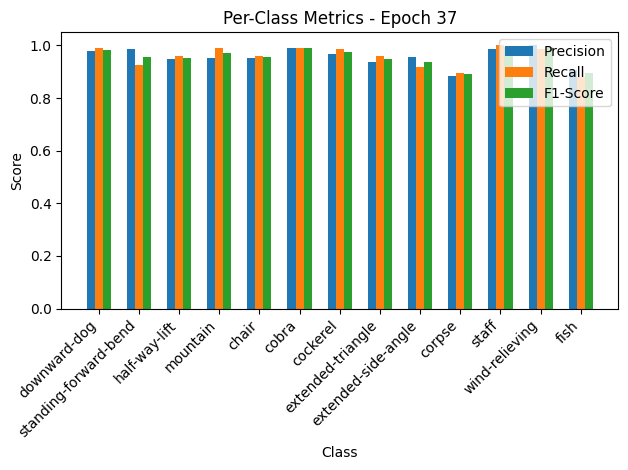

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.94it/s, loss=0.078, accuracy=99.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


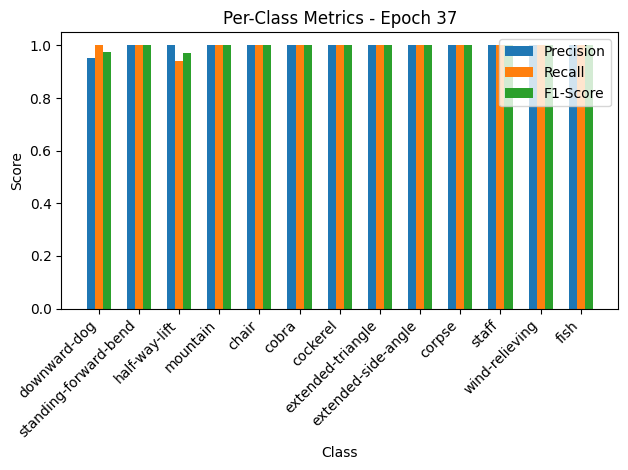


Epoch 38/50 Summary:
Train Loss: 0.2091 | Train Acc: 96.02% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0854 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 38
New best model saved! Validation Loss: 0.0854

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:07<00:00, 10.25it/s, loss=0.181, accuracy=96.8]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.98
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.94, F1-Score=0.96
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.90, F1-Score=0.90


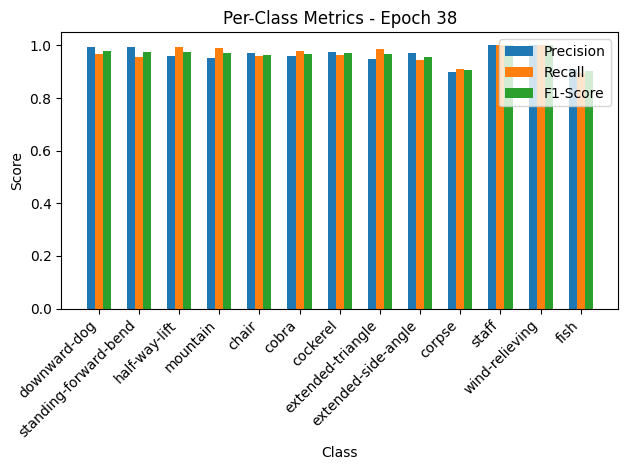

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.90it/s, loss=0.0719, accuracy=99.3]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


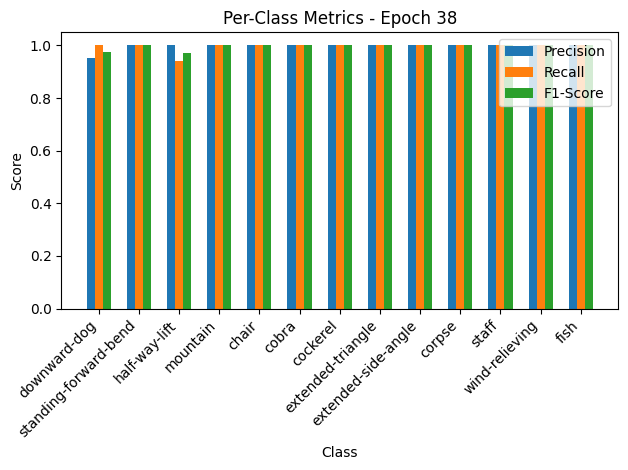


Epoch 39/50 Summary:
Train Loss: 0.1819 | Train Acc: 96.79% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0788 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 39
New best model saved! Validation Loss: 0.0788

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.28it/s, loss=0.19, accuracy=96.8]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.97, F1-Score=0.98
mountain: Precision=0.94, Recall=0.99, F1-Score=0.96
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.86, Recall=0.91, F1-Score=0.89
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.85, F1-Score=0.88


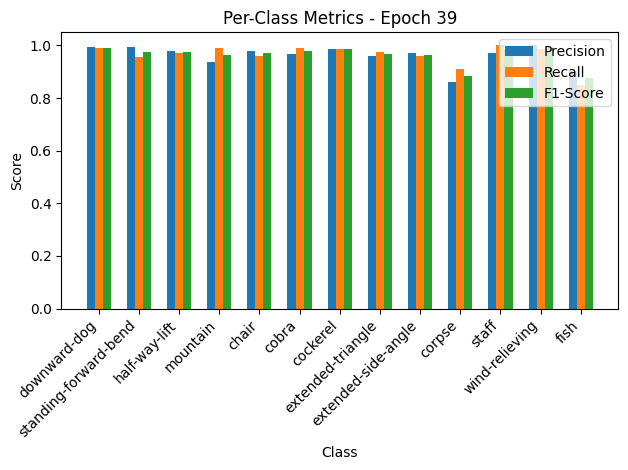

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.89it/s, loss=0.0695, accuracy=99.3]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


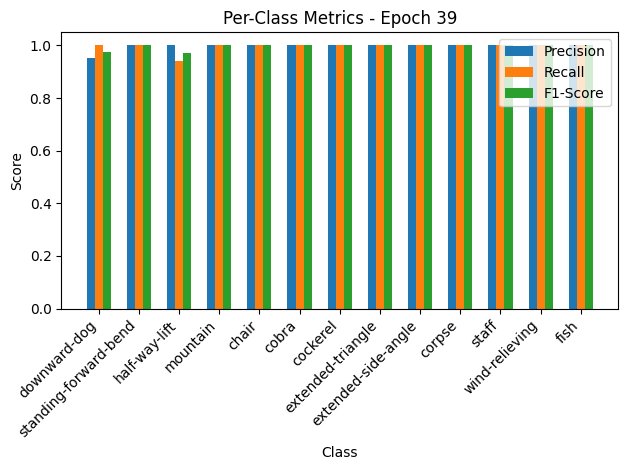


Epoch 40/50 Summary:
Train Loss: 0.1901 | Train Acc: 96.79% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0761 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 40
New best model saved! Validation Loss: 0.0761

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.89it/s, loss=0.186, accuracy=96.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.90, F1-Score=0.90


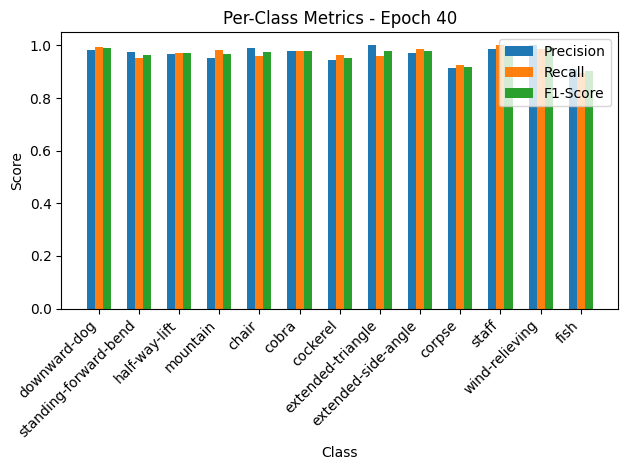

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.49it/s, loss=0.0815, accuracy=97.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


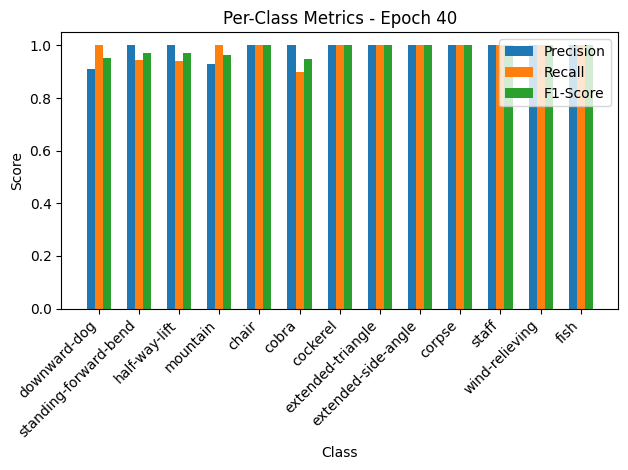


Epoch 41/50 Summary:
Train Loss: 0.1865 | Train Acc: 96.87% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0893 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.98

Epoch 42/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.99it/s, loss=0.181, accuracy=96.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.97
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.88, F1-Score=0.90
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.93, F1-Score=0.91


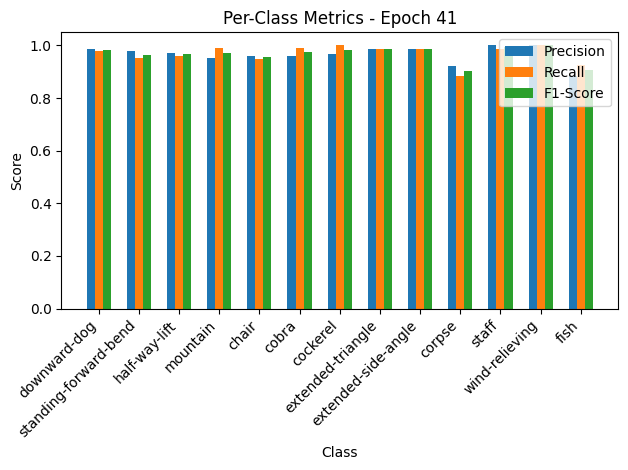

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.96it/s, loss=0.0722, accuracy=98.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


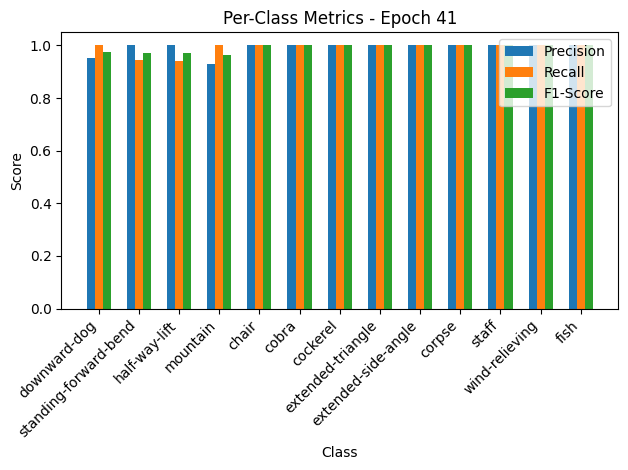


Epoch 42/50 Summary:
Train Loss: 0.1811 | Train Acc: 96.87% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0792 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 43/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.36it/s, loss=0.169, accuracy=97.6]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=1.00, F1-Score=0.98
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.91, Recall=0.99, F1-Score=0.94
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


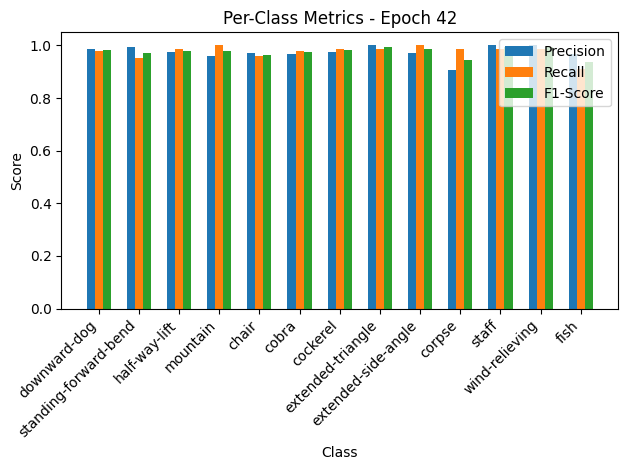

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.34it/s, loss=0.0724, accuracy=99.3]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


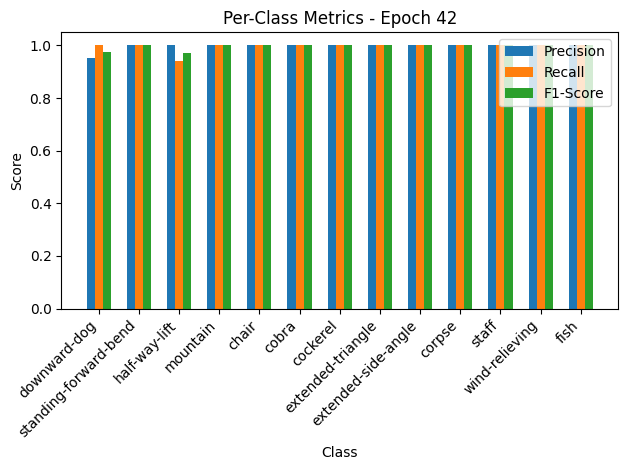


Epoch 43/50 Summary:
Train Loss: 0.1697 | Train Acc: 97.63% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0794 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00

Epoch 44/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.175, accuracy=97.2]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.94, Recall=0.91, F1-Score=0.93
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


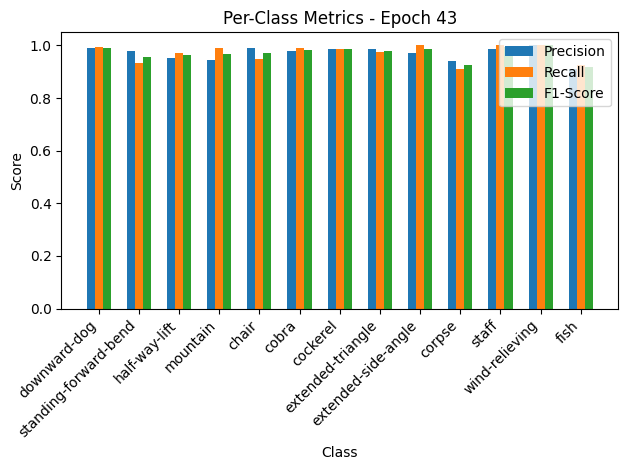

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.49it/s, loss=0.0676, accuracy=99.3]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=1.00, F1-Score=1.00
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


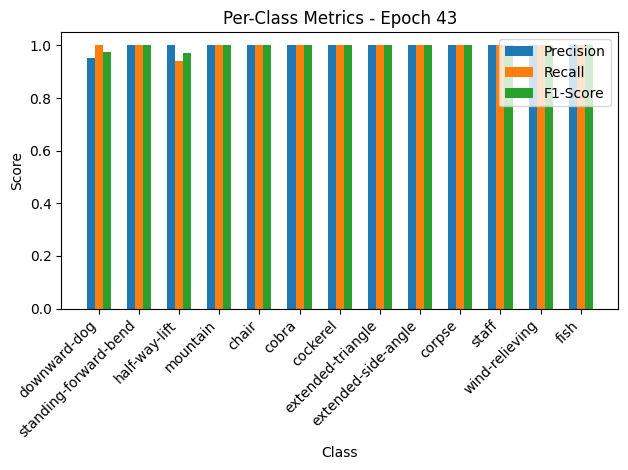


Epoch 44/50 Summary:
Train Loss: 0.1751 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0741 | Val Acc: 99.32% | Val Precision: 1.00 | Val Recall: 1.00 | Val F1: 1.00
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 44
New best model saved! Validation Loss: 0.0741

Epoch 45/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.65it/s, loss=0.179, accuracy=96.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=1.00, F1-Score=0.98
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.93, Recall=0.91, F1-Score=0.92
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


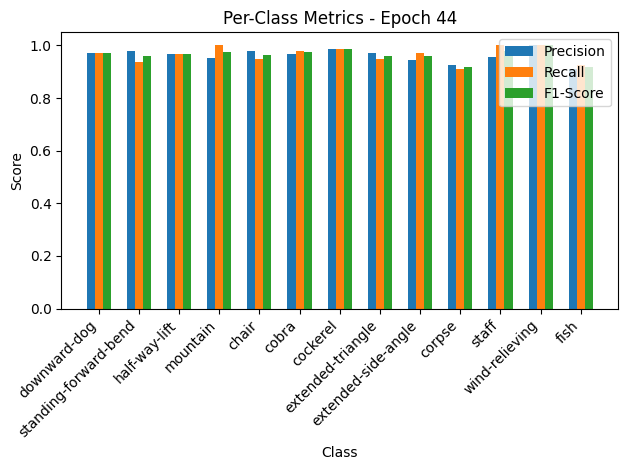

Validation: 100%|██████████| 10/10 [00:00<00:00, 43.04it/s, loss=0.0729, accuracy=97.9]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


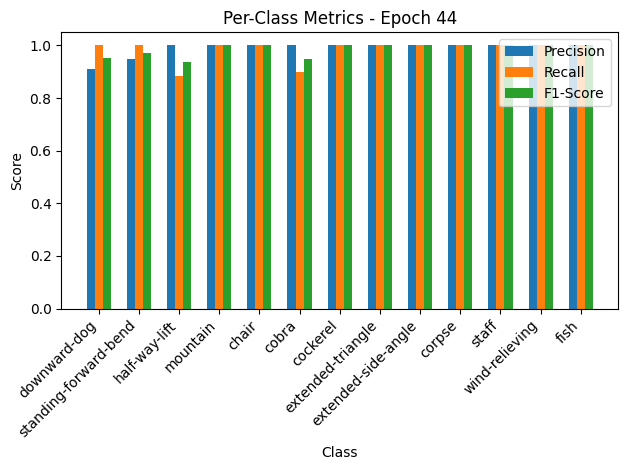


Epoch 45/50 Summary:
Train Loss: 0.1799 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0799 | Val Acc: 97.95% | Val Precision: 0.99 | Val Recall: 0.98 | Val F1: 0.99

Epoch 46/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.76it/s, loss=0.168, accuracy=97.2]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.96, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.90, F1-Score=0.92


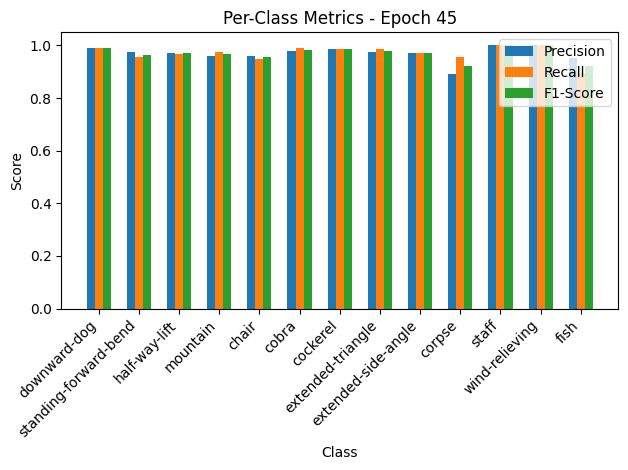

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.13it/s, loss=0.0701, accuracy=98.6]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


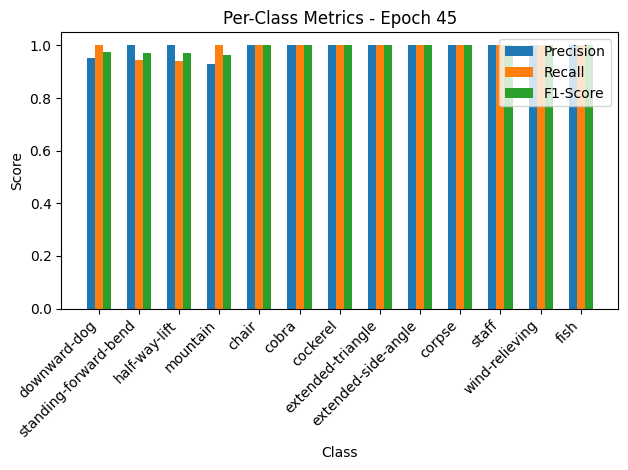


Epoch 46/50 Summary:
Train Loss: 0.1681 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0768 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 47/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.93it/s, loss=0.184, accuracy=96.6]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.91, F1-Score=0.91


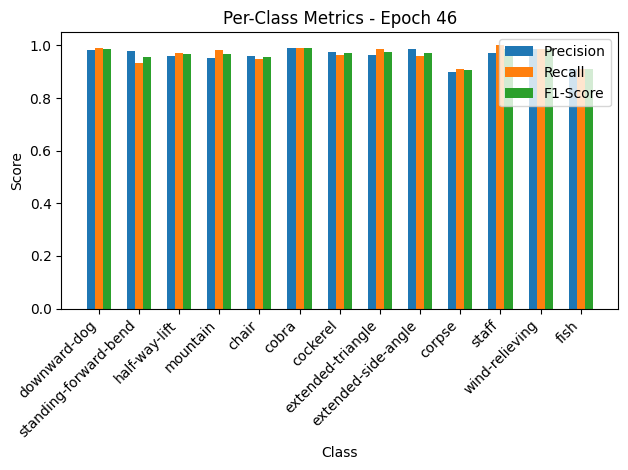

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.24it/s, loss=0.067, accuracy=98.6]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


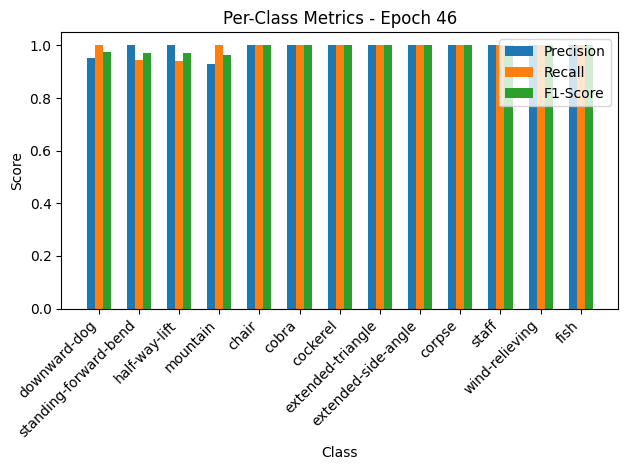


Epoch 47/50 Summary:
Train Loss: 0.1847 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0734 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_1.pth
Checkpoint saved at epoch 47
New best model saved! Validation Loss: 0.0734

Epoch 48/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.90it/s, loss=0.162, accuracy=97]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.98
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.92, Recall=0.88, F1-Score=0.90
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.93, F1-Score=0.91


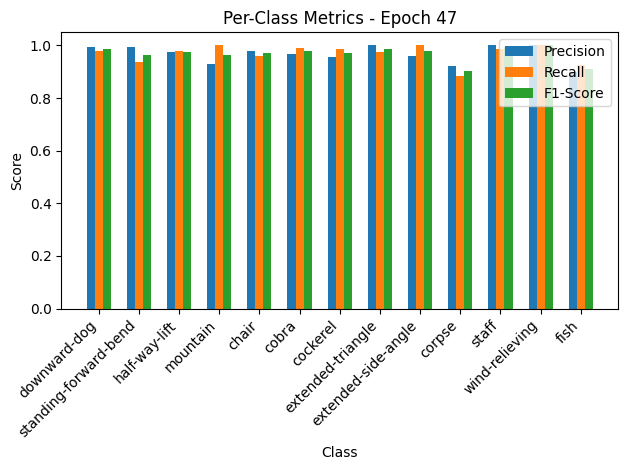

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.15it/s, loss=0.0743, accuracy=98.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


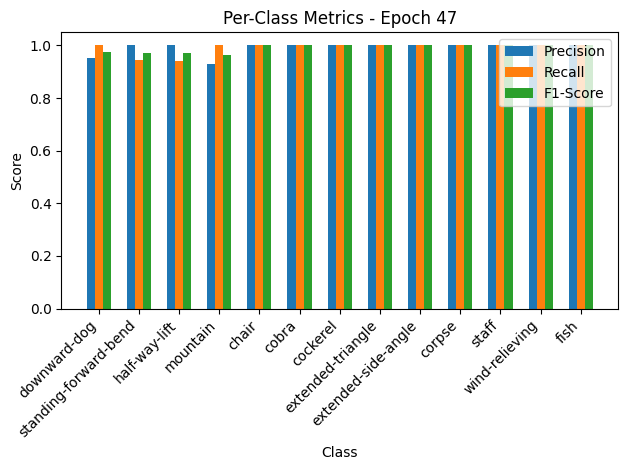


Epoch 48/50 Summary:
Train Loss: 0.1627 | Train Acc: 97.02% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0814 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 49/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.58it/s, loss=0.163, accuracy=97.3]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.99, Recall=0.97, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.90, Recall=0.94, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.90, F1-Score=0.92


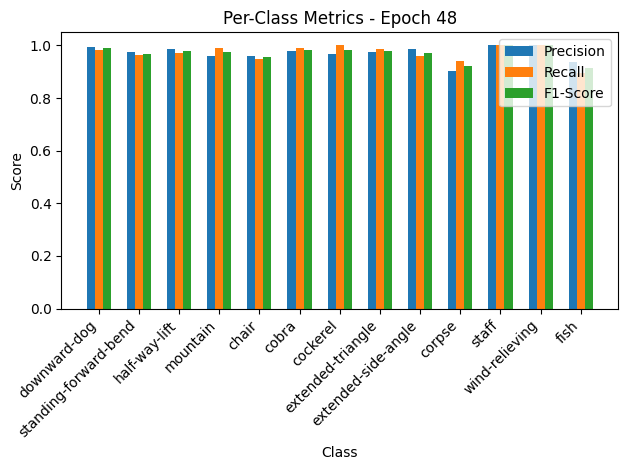

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.90it/s, loss=0.0689, accuracy=98.6]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


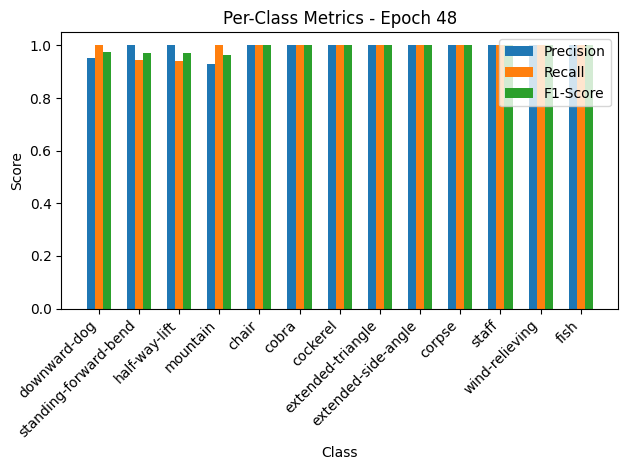


Epoch 49/50 Summary:
Train Loss: 0.1637 | Train Acc: 97.32% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0755 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.72it/s, loss=0.169, accuracy=97.1]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.99, F1-Score=0.97
mountain: Precision=0.93, Recall=0.99, F1-Score=0.96
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.93, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.88, F1-Score=0.90


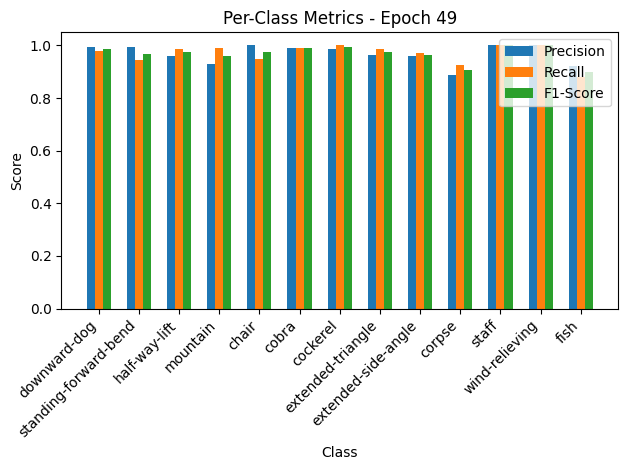

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.80it/s, loss=0.0713, accuracy=98.6]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=1.00, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=0.88, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


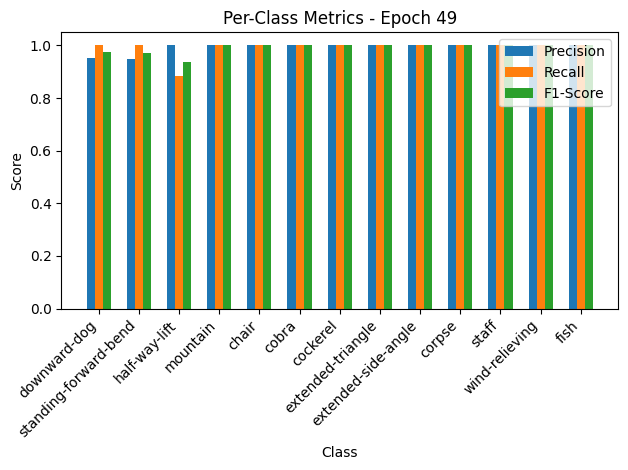


Epoch 50/50 Summary:
Train Loss: 0.1695 | Train Acc: 97.09% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0781 | Val Acc: 98.63% | Val Precision: 0.99 | Val Recall: 0.99 | Val F1: 0.99


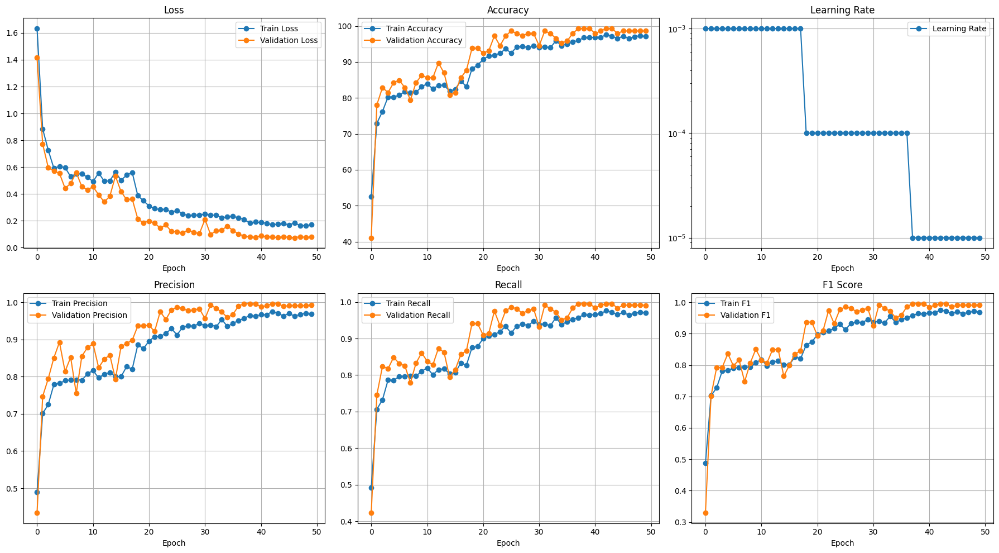

Testing: 100%|██████████| 23/23 [00:00<00:00, 42.39it/s]


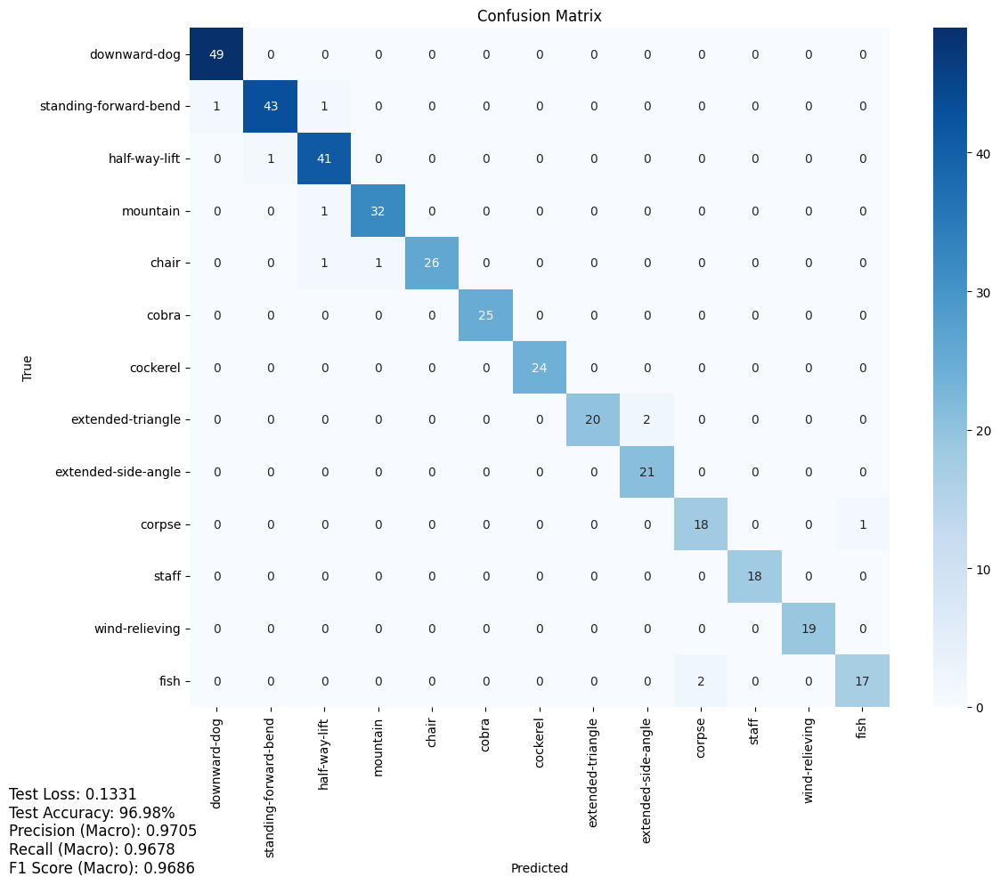

Test Loss: 0.1331
Test Accuracy: 96.98%
Precision (Macro): 0.9705
Recall (Macro): 0.9678
F1 Score (Macro): 0.9686


Testing: 100%|██████████| 23/23 [00:00<00:00, 43.63it/s]


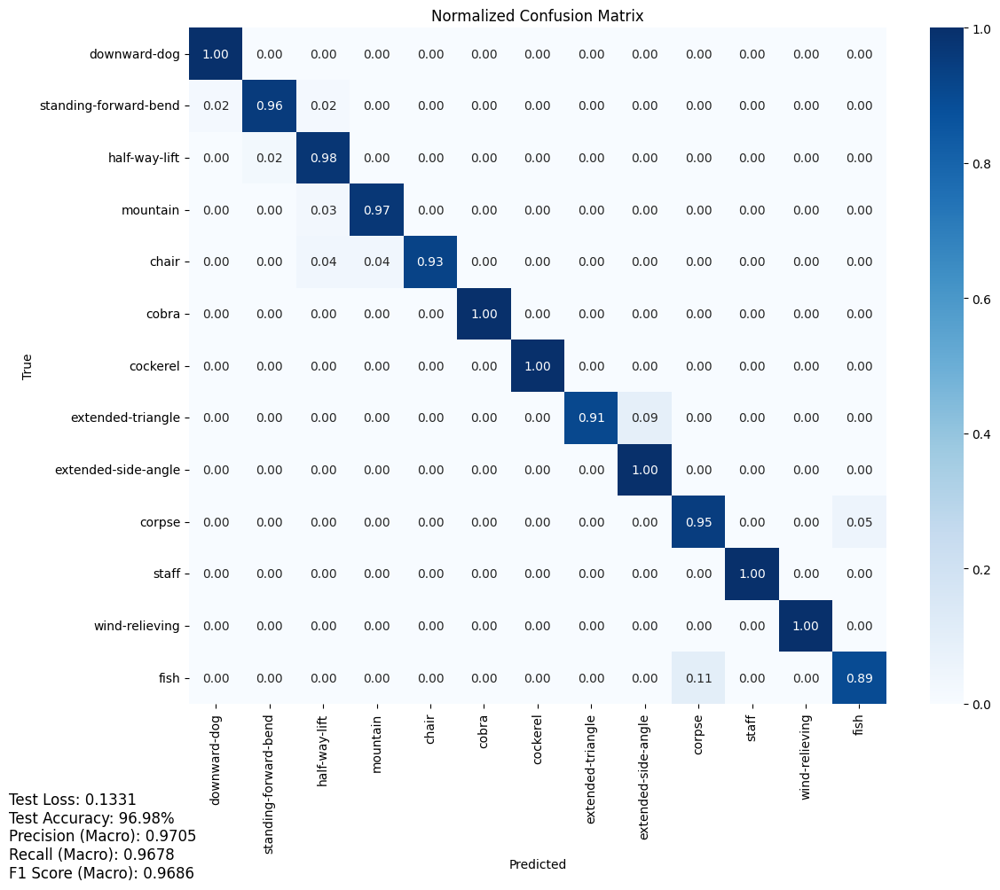

Test Loss: 0.1331
Test Accuracy: 96.98%
Precision (Macro): 0.9705
Recall (Macro): 0.9678
F1 Score (Macro): 0.9686
Saved checkpoint for fold 2
Fold 3/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 176 samples (13.46%)
Class 1: 162 samples (12.39%)
Class 2: 151 samples (11.54%)
Class 3: 119 samples (9.10%)
Class 4: 101 samples (7.72%)
Class 5: 93 samples (7.11%)
Class 6: 86 samples (6.57%)
Class 7: 77 samples (5.89%)
Class 8: 73 samples (5.58%)
Class 9: 68 samples (5.20%)
Class 10: 67 samples (5.12%)
Class 11: 68 samples (5.20%)
Class 12: 67 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 176
Minimum class size: 67
Average class size: 100.62
Class weights aligned with indices: tensor([0.5112, 0.5550, 0.5951, 0.7539, 0.8875, 0.9635, 1.0415, 1.1627, 1.2262,
        1.3160, 1.3356, 1.3160, 1.3356])
Cached criterion for fold 2
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.89it/s, loss=1.57, accuracy=51.7]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.66, Recall=0.59, F1-Score=0.62
standing-forward-bend: Precision=0.71, Recall=0.46, F1-Score=0.56
half-way-lift: Precision=0.67, Recall=0.79, F1-Score=0.72
mountain: Precision=0.56, Recall=0.63, F1-Score=0.60
chair: Precision=0.43, Recall=0.37, F1-Score=0.40
cobra: Precision=0.49, Recall=0.42, F1-Score=0.45
cockerel: Precision=0.39, Recall=0.43, F1-Score=0.41
extended-triangle: Precision=0.42, Recall=0.38, F1-Score=0.40
extended-side-angle: Precision=0.34, Recall=0.41, F1-Score=0.37
corpse: Precision=0.29, Recall=0.25, F1-Score=0.27
staff: Precision=0.36, Recall=0.58, F1-Score=0.45
wind-relieving: Precision=0.66, Recall=0.71, F1-Score=0.68
fish: Precision=0.35, Recall=0.43, F1-Score=0.39


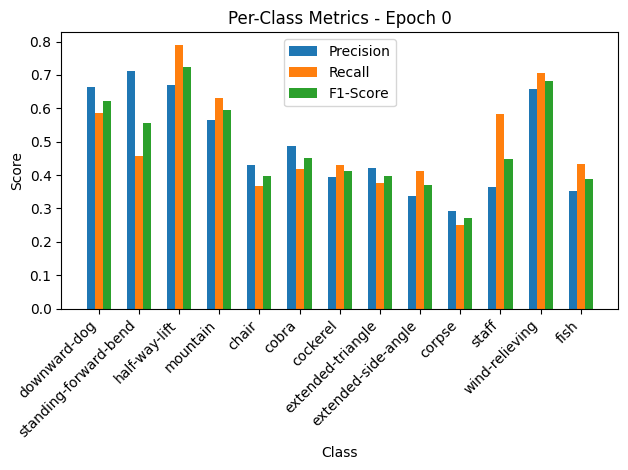

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.07it/s, loss=1.01, accuracy=53.4]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.00, Recall=0.00, F1-Score=0.00
standing-forward-bend: Precision=0.80, Recall=0.67, F1-Score=0.73
half-way-lift: Precision=0.64, Recall=0.94, F1-Score=0.76
mountain: Precision=0.80, Recall=0.92, F1-Score=0.86
chair: Precision=1.00, Recall=0.27, F1-Score=0.43
cobra: Precision=0.00, Recall=0.00, F1-Score=0.00
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.14, Recall=0.11, F1-Score=0.12
extended-side-angle: Precision=0.17, Recall=1.00, F1-Score=0.29
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=1.00, Recall=0.62, F1-Score=0.77
wind-relieving: Precision=1.00, Recall=0.71, F1-Score=0.83
fish: Precision=0.46, Recall=0.86, F1-Score=0.60


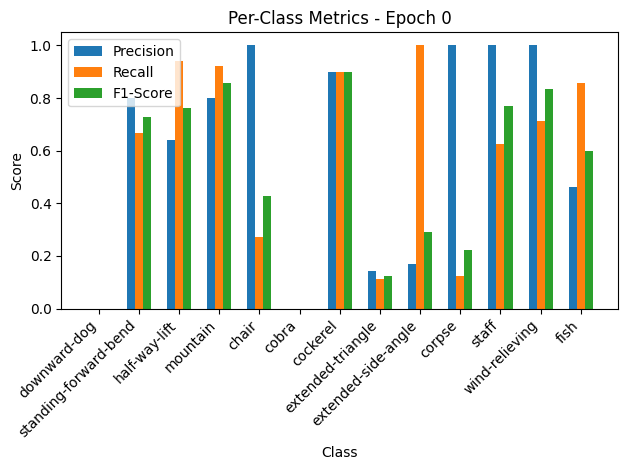


Epoch 1/50 Summary:
Train Loss: 1.5757 | Train Acc: 51.68% | Train Precision: 0.49 | Train Recall: 0.49 | Train F1: 0.49
Val Loss: 1.1019 | Val Acc: 53.42% | Val Precision: 0.61 | Val Recall: 0.55 | Val F1: 0.50
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.1019

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.90it/s, loss=0.82, accuracy=73]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.78, F1-Score=0.83
standing-forward-bend: Precision=0.82, Recall=0.67, F1-Score=0.73
half-way-lift: Precision=0.76, Recall=0.83, F1-Score=0.79
mountain: Precision=0.71, Recall=0.77, F1-Score=0.74
chair: Precision=0.70, Recall=0.72, F1-Score=0.71
cobra: Precision=0.77, Recall=0.87, F1-Score=0.82
cockerel: Precision=0.80, Recall=0.80, F1-Score=0.80
extended-triangle: Precision=0.63, Recall=0.69, F1-Score=0.66
extended-side-angle: Precision=0.54, Recall=0.56, F1-Score=0.55
corpse: Precision=0.45, Recall=0.47, F1-Score=0.46
staff: Precision=0.75, Recall=0.78, F1-Score=0.76
wind-relieving: Precision=0.88, Recall=0.88, F1-Score=0.88
fish: Precision=0.50, Recall=0.48, F1-Score=0.49


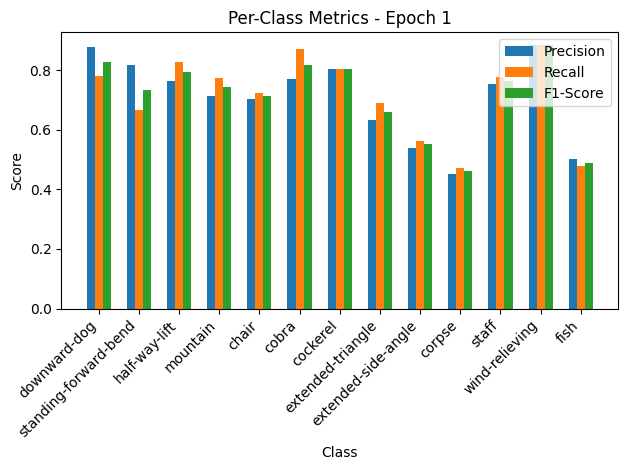

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.35it/s, loss=0.777, accuracy=72.6]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.82, Recall=0.90, F1-Score=0.86
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.70, Recall=0.94, F1-Score=0.80
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.71, Recall=1.00, F1-Score=0.83
cockerel: Precision=1.00, Recall=0.10, F1-Score=0.18
extended-triangle: Precision=0.53, Recall=1.00, F1-Score=0.69
extended-side-angle: Precision=1.00, Recall=0.12, F1-Score=0.22
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.38, Recall=1.00, F1-Score=0.55
wind-relieving: Precision=1.00, Recall=0.71, F1-Score=0.83
fish: Precision=0.71, Recall=0.71, F1-Score=0.71


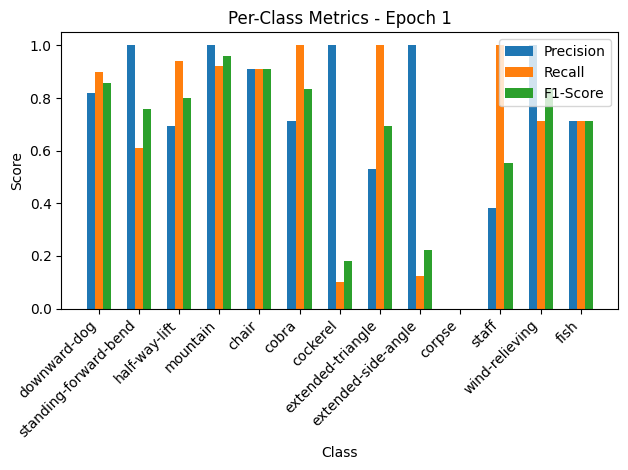


Epoch 2/50 Summary:
Train Loss: 0.8226 | Train Acc: 73.01% | Train Precision: 0.71 | Train Recall: 0.72 | Train F1: 0.71
Val Loss: 0.8512 | Val Acc: 72.60% | Val Precision: 0.75 | Val Recall: 0.69 | Val F1: 0.64
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.8512

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.58it/s, loss=0.665, accuracy=78.5]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.90, Recall=0.84, F1-Score=0.86
standing-forward-bend: Precision=0.90, Recall=0.73, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.90, F1-Score=0.85
mountain: Precision=0.81, Recall=0.86, F1-Score=0.83
chair: Precision=0.75, Recall=0.77, F1-Score=0.76
cobra: Precision=0.85, Recall=0.88, F1-Score=0.87
cockerel: Precision=0.83, Recall=0.88, F1-Score=0.85
extended-triangle: Precision=0.66, Recall=0.64, F1-Score=0.65
extended-side-angle: Precision=0.56, Recall=0.60, F1-Score=0.58
corpse: Precision=0.54, Recall=0.46, F1-Score=0.50
staff: Precision=0.87, Recall=0.88, F1-Score=0.87
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.55, Recall=0.63, F1-Score=0.58


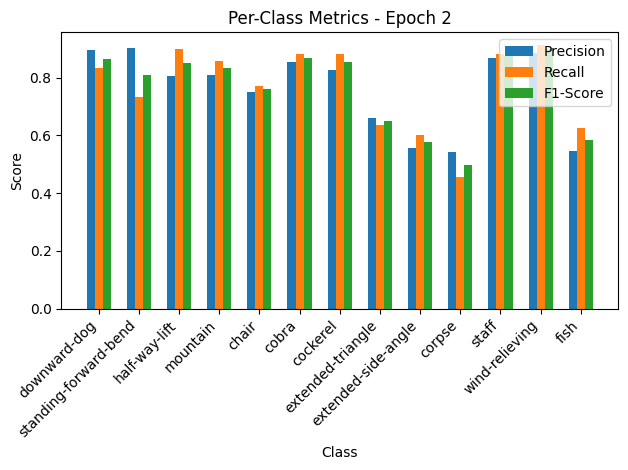

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.93it/s, loss=0.516, accuracy=80.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.87, Recall=0.65, F1-Score=0.74
standing-forward-bend: Precision=0.89, Recall=0.89, F1-Score=0.89
half-way-lift: Precision=0.94, Recall=0.88, F1-Score=0.91
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.62, Recall=1.00, F1-Score=0.77
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.47, Recall=1.00, F1-Score=0.64
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.58, Recall=1.00, F1-Score=0.74


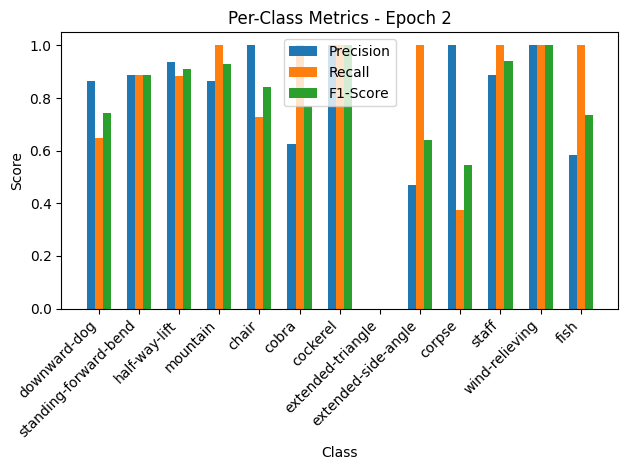


Epoch 3/50 Summary:
Train Loss: 0.6673 | Train Acc: 78.52% | Train Precision: 0.76 | Train Recall: 0.77 | Train F1: 0.76
Val Loss: 0.5650 | Val Acc: 80.82% | Val Precision: 0.78 | Val Recall: 0.81 | Val F1: 0.76
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.5650

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.42it/s, loss=0.635, accuracy=79.7]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.91, Recall=0.84, F1-Score=0.87
standing-forward-bend: Precision=0.94, Recall=0.75, F1-Score=0.83
half-way-lift: Precision=0.79, Recall=0.91, F1-Score=0.85
mountain: Precision=0.88, Recall=0.90, F1-Score=0.89
chair: Precision=0.80, Recall=0.81, F1-Score=0.80
cobra: Precision=0.88, Recall=0.91, F1-Score=0.89
cockerel: Precision=0.85, Recall=0.87, F1-Score=0.86
extended-triangle: Precision=0.68, Recall=0.68, F1-Score=0.68
extended-side-angle: Precision=0.51, Recall=0.60, F1-Score=0.55
corpse: Precision=0.50, Recall=0.46, F1-Score=0.48
staff: Precision=0.86, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.88, Recall=0.84, F1-Score=0.86
fish: Precision=0.57, Recall=0.60, F1-Score=0.58


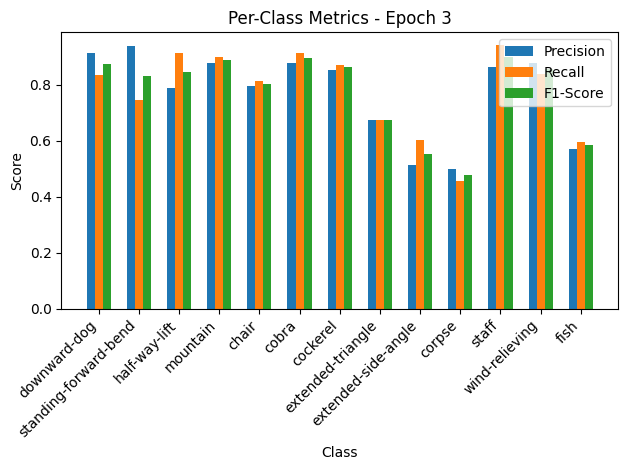

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.04it/s, loss=0.476, accuracy=85.6]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.90, Recall=0.95, F1-Score=0.93
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.85, Recall=1.00, F1-Score=0.92
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=0.89, Recall=0.80, F1-Score=0.84
extended-triangle: Precision=0.73, Recall=0.89, F1-Score=0.80
extended-side-angle: Precision=0.86, Recall=0.75, F1-Score=0.80
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=0.75, F1-Score=0.86
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


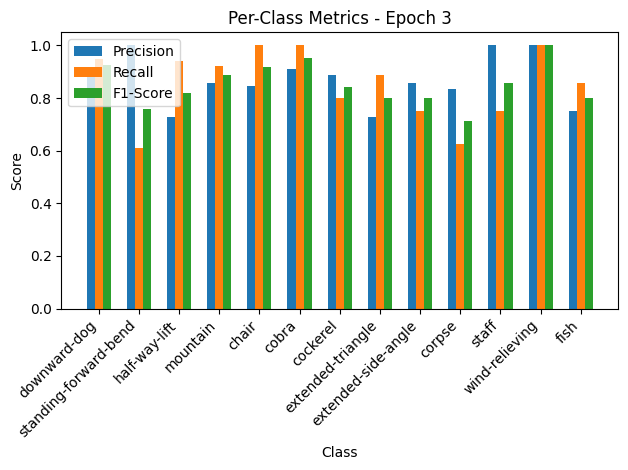


Epoch 4/50 Summary:
Train Loss: 0.6365 | Train Acc: 79.66% | Train Precision: 0.77 | Train Recall: 0.78 | Train F1: 0.77
Val Loss: 0.5216 | Val Acc: 85.62% | Val Precision: 0.87 | Val Recall: 0.85 | Val F1: 0.85
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.5216

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.85it/s, loss=0.611, accuracy=80.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.89, Recall=0.89, F1-Score=0.89
standing-forward-bend: Precision=0.87, Recall=0.73, F1-Score=0.79
half-way-lift: Precision=0.82, Recall=0.87, F1-Score=0.85
mountain: Precision=0.80, Recall=0.86, F1-Score=0.83
chair: Precision=0.80, Recall=0.85, F1-Score=0.83
cobra: Precision=0.92, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.85, Recall=0.88, F1-Score=0.87
extended-triangle: Precision=0.73, Recall=0.73, F1-Score=0.73
extended-side-angle: Precision=0.67, Recall=0.63, F1-Score=0.65
corpse: Precision=0.56, Recall=0.53, F1-Score=0.55
staff: Precision=0.87, Recall=0.90, F1-Score=0.88
wind-relieving: Precision=0.92, Recall=0.88, F1-Score=0.90
fish: Precision=0.54, Recall=0.57, F1-Score=0.55


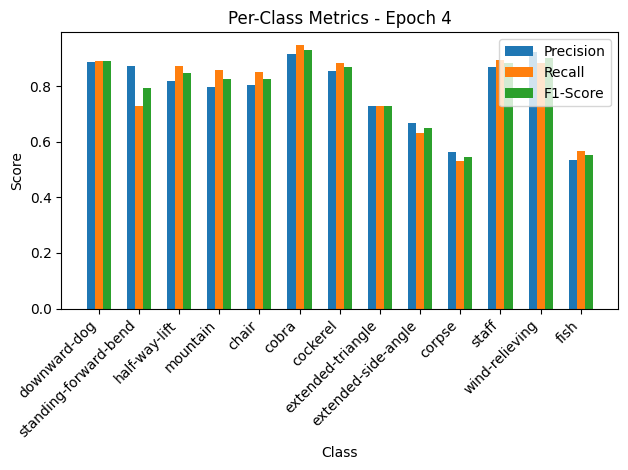

Validation: 100%|██████████| 10/10 [00:00<00:00, 25.54it/s, loss=0.631, accuracy=74.7]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=1.00, Recall=0.85, F1-Score=0.92
standing-forward-bend: Precision=0.55, Recall=0.67, F1-Score=0.60
half-way-lift: Precision=0.57, Recall=1.00, F1-Score=0.72
mountain: Precision=1.00, Recall=0.15, F1-Score=0.27
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.22, F1-Score=0.36
extended-side-angle: Precision=0.44, Recall=1.00, F1-Score=0.62
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=1.00, Recall=0.75, F1-Score=0.86
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


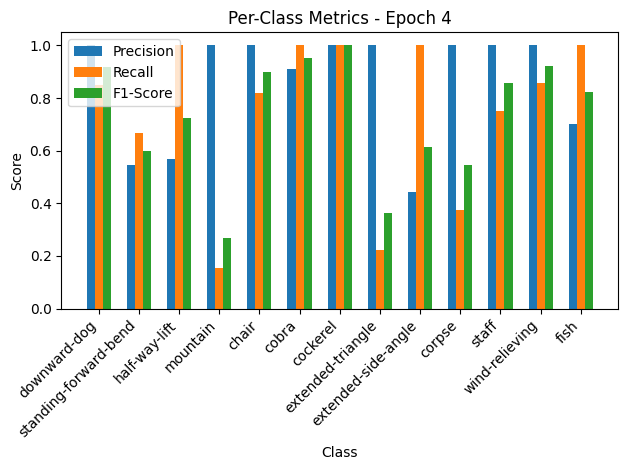


Epoch 5/50 Summary:
Train Loss: 0.6131 | Train Acc: 80.66% | Train Precision: 0.79 | Train Recall: 0.79 | Train F1: 0.79
Val Loss: 0.6915 | Val Acc: 74.66% | Val Precision: 0.86 | Val Recall: 0.75 | Val F1: 0.73

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.35it/s, loss=0.51, accuracy=83]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.92, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.89, Recall=0.76, F1-Score=0.82
half-way-lift: Precision=0.82, Recall=0.89, F1-Score=0.86
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.80, Recall=0.88, F1-Score=0.84
cobra: Precision=0.85, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.87, Recall=0.83, F1-Score=0.85
extended-triangle: Precision=0.79, Recall=0.87, F1-Score=0.83
extended-side-angle: Precision=0.80, Recall=0.70, F1-Score=0.74
corpse: Precision=0.57, Recall=0.60, F1-Score=0.59
staff: Precision=0.89, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.88, Recall=0.87, F1-Score=0.87
fish: Precision=0.58, Recall=0.54, F1-Score=0.56


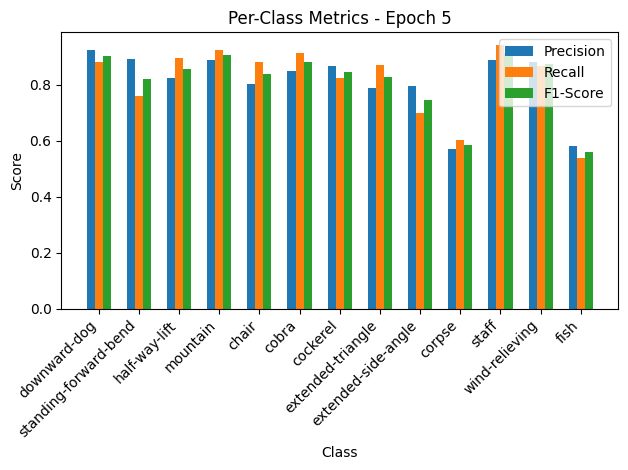

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.66it/s, loss=0.339, accuracy=84.9]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=0.72, Recall=1.00, F1-Score=0.84
chair: Precision=1.00, Recall=0.18, F1-Score=0.31
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.71, Recall=0.62, F1-Score=0.67
staff: Precision=0.80, Recall=1.00, F1-Score=0.89
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


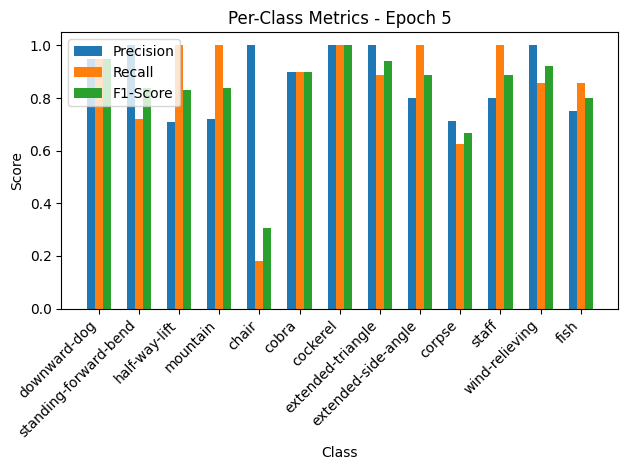


Epoch 6/50 Summary:
Train Loss: 0.5112 | Train Acc: 82.95% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.3711 | Val Acc: 84.93% | Val Precision: 0.87 | Val Recall: 0.84 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.3711

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.93it/s, loss=0.537, accuracy=83.9]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.93, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.91, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.82, Recall=0.92, F1-Score=0.87
mountain: Precision=0.85, Recall=0.94, F1-Score=0.90
chair: Precision=0.90, Recall=0.82, F1-Score=0.86
cobra: Precision=0.85, Recall=0.92, F1-Score=0.89
cockerel: Precision=0.89, Recall=0.88, F1-Score=0.89
extended-triangle: Precision=0.78, Recall=0.75, F1-Score=0.77
extended-side-angle: Precision=0.73, Recall=0.74, F1-Score=0.73
corpse: Precision=0.61, Recall=0.57, F1-Score=0.59
staff: Precision=0.85, Recall=0.94, F1-Score=0.89
wind-relieving: Precision=0.91, Recall=0.88, F1-Score=0.90
fish: Precision=0.64, Recall=0.66, F1-Score=0.65


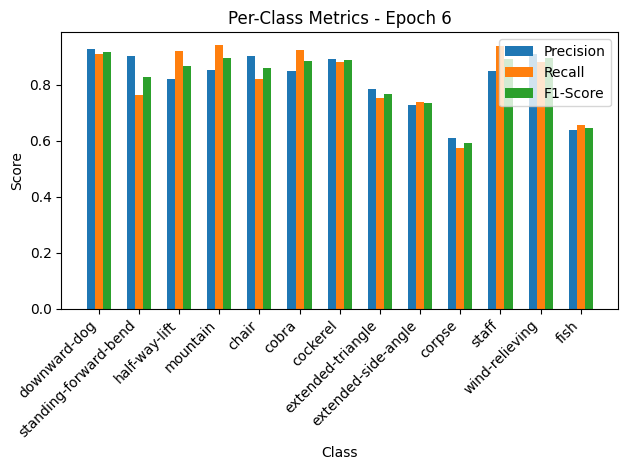

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.63it/s, loss=0.502, accuracy=82.2]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=1.00, Recall=0.90, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.45, F1-Score=0.62
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=0.59, Recall=1.00, F1-Score=0.74
extended-triangle: Precision=1.00, Recall=0.33, F1-Score=0.50
extended-side-angle: Precision=0.57, Recall=1.00, F1-Score=0.73
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=0.73, Recall=1.00, F1-Score=0.84
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.75, Recall=0.86, F1-Score=0.80


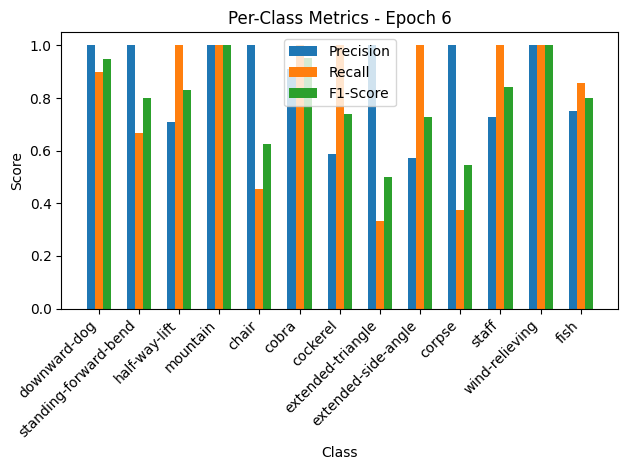


Epoch 7/50 Summary:
Train Loss: 0.5382 | Train Acc: 83.94% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5496 | Val Acc: 82.19% | Val Precision: 0.87 | Val Recall: 0.81 | Val F1: 0.79

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.01it/s, loss=0.511, accuracy=84.8]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.81, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.88
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.88, Recall=0.87, F1-Score=0.88
cobra: Precision=0.86, Recall=0.92, F1-Score=0.89
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.76, Recall=0.81, F1-Score=0.78
extended-side-angle: Precision=0.76, Recall=0.74, F1-Score=0.75
corpse: Precision=0.62, Recall=0.59, F1-Score=0.60
staff: Precision=0.88, Recall=0.88, F1-Score=0.88
wind-relieving: Precision=0.98, Recall=0.91, F1-Score=0.95
fish: Precision=0.62, Recall=0.61, F1-Score=0.62


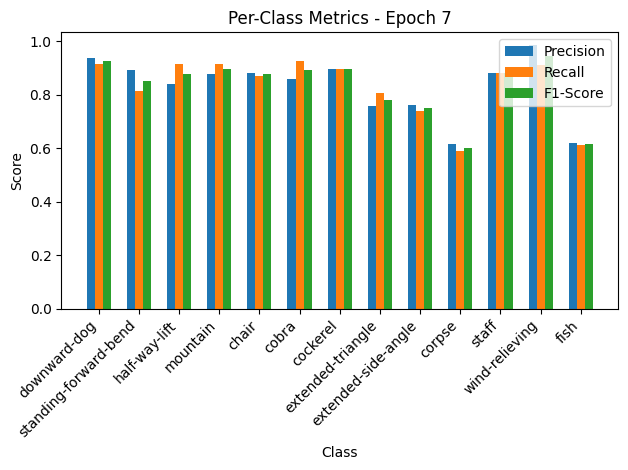

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.34it/s, loss=0.762, accuracy=78.1]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.80, Recall=0.80, F1-Score=0.80
standing-forward-bend: Precision=0.86, Recall=0.67, F1-Score=0.75
half-way-lift: Precision=0.53, Recall=1.00, F1-Score=0.69
mountain: Precision=1.00, Recall=0.85, F1-Score=0.92
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=0.70, F1-Score=0.82
cockerel: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-triangle: Precision=1.00, Recall=0.33, F1-Score=0.50
extended-side-angle: Precision=0.75, Recall=0.75, F1-Score=0.75
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=1.00, Recall=0.62, F1-Score=0.77
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.58, Recall=1.00, F1-Score=0.74


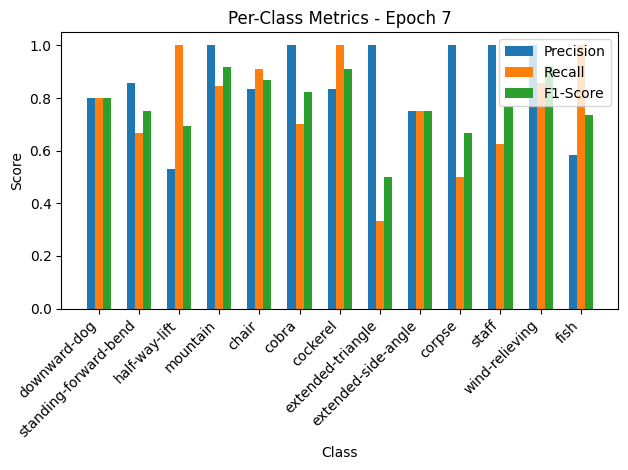


Epoch 8/50 Summary:
Train Loss: 0.5124 | Train Acc: 84.79% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.8347 | Val Acc: 78.08% | Val Precision: 0.86 | Val Recall: 0.77 | Val F1: 0.78

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.20it/s, loss=0.492, accuracy=84.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.93, Recall=0.86, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.79, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.93, F1-Score=0.87
mountain: Precision=0.89, Recall=0.92, F1-Score=0.91
chair: Precision=0.87, Recall=0.86, F1-Score=0.87
cobra: Precision=0.87, Recall=0.94, F1-Score=0.90
cockerel: Precision=0.86, Recall=0.87, F1-Score=0.87
extended-triangle: Precision=0.79, Recall=0.77, F1-Score=0.78
extended-side-angle: Precision=0.71, Recall=0.75, F1-Score=0.73
corpse: Precision=0.64, Recall=0.57, F1-Score=0.60
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.97, F1-Score=0.96
fish: Precision=0.61, Recall=0.69, F1-Score=0.65


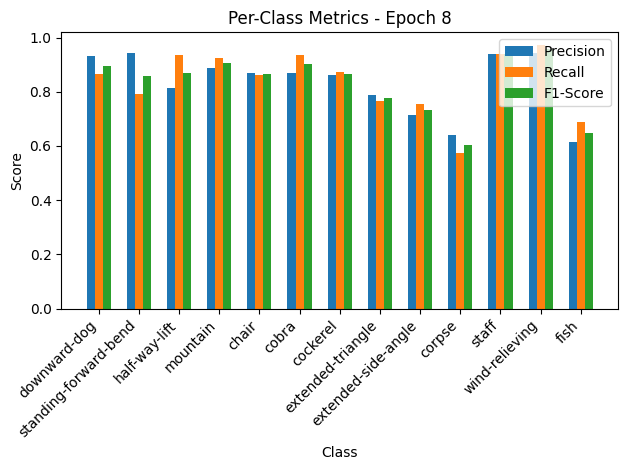

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.84it/s, loss=0.611, accuracy=86.3]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=0.59, Recall=1.00, F1-Score=0.74
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=0.89, Recall=1.00, F1-Score=0.94
wind-relieving: Precision=0.00, Recall=0.00, F1-Score=0.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


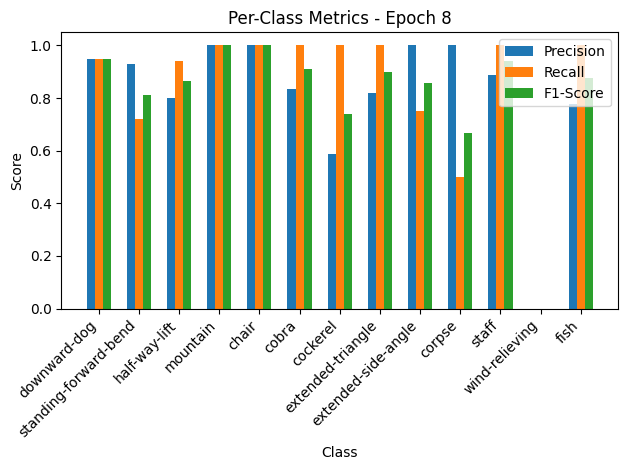


Epoch 9/50 Summary:
Train Loss: 0.4931 | Train Acc: 84.71% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.83
Val Loss: 0.6693 | Val Acc: 86.30% | Val Precision: 0.81 | Val Recall: 0.84 | Val F1: 0.81

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.84it/s, loss=0.432, accuracy=86]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.75, F1-Score=0.84
half-way-lift: Precision=0.84, Recall=0.93, F1-Score=0.88
mountain: Precision=0.85, Recall=0.92, F1-Score=0.88
chair: Precision=0.88, Recall=0.92, F1-Score=0.90
cobra: Precision=0.89, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.90, Recall=0.94, F1-Score=0.92
extended-triangle: Precision=0.78, Recall=0.81, F1-Score=0.79
extended-side-angle: Precision=0.77, Recall=0.77, F1-Score=0.77
corpse: Precision=0.66, Recall=0.62, F1-Score=0.64
staff: Precision=0.93, Recall=0.96, F1-Score=0.94
wind-relieving: Precision=0.95, Recall=0.93, F1-Score=0.94
fish: Precision=0.66, Recall=0.64, F1-Score=0.65


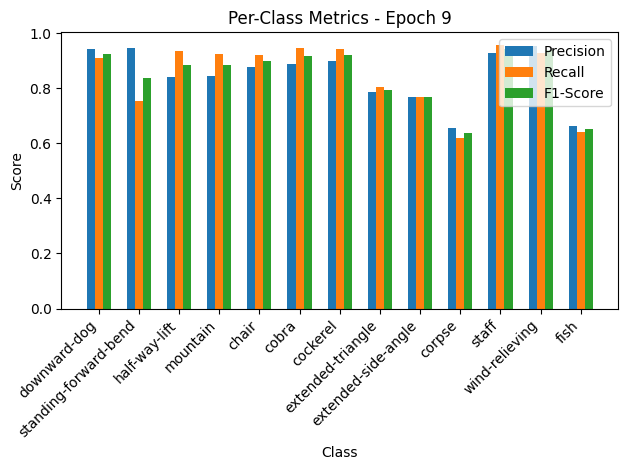

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.60it/s, loss=0.584, accuracy=83.6]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.50, F1-Score=0.67
half-way-lift: Precision=0.79, Recall=0.88, F1-Score=0.83
mountain: Precision=1.00, Recall=0.85, F1-Score=0.92
chair: Precision=0.52, Recall=1.00, F1-Score=0.69
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.67, F1-Score=0.80
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.50, Recall=0.88, F1-Score=0.64
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.57, F1-Score=0.73
fish: Precision=0.75, Recall=0.43, F1-Score=0.55


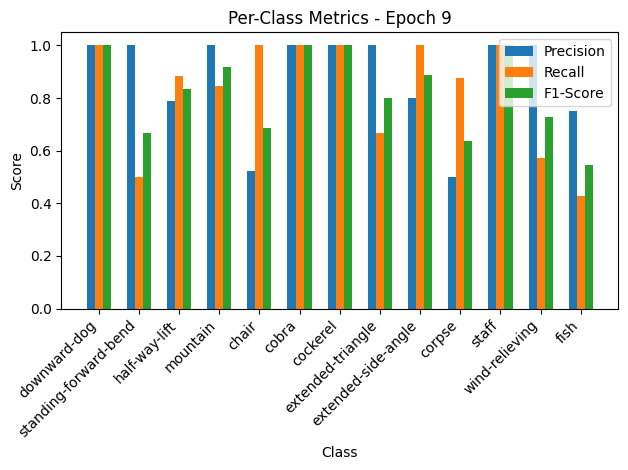


Epoch 10/50 Summary:
Train Loss: 0.4331 | Train Acc: 86.01% | Train Precision: 0.85 | Train Recall: 0.85 | Train F1: 0.85
Val Loss: 0.6401 | Val Acc: 83.56% | Val Precision: 0.87 | Val Recall: 0.83 | Val F1: 0.82

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.00it/s, loss=0.523, accuracy=83.3]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.91, Recall=0.86, F1-Score=0.89
standing-forward-bend: Precision=0.89, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.80, Recall=0.88, F1-Score=0.84
mountain: Precision=0.88, Recall=0.89, F1-Score=0.89
chair: Precision=0.88, Recall=0.87, F1-Score=0.88
cobra: Precision=0.84, Recall=0.91, F1-Score=0.88
cockerel: Precision=0.81, Recall=0.83, F1-Score=0.82
extended-triangle: Precision=0.81, Recall=0.81, F1-Score=0.81
extended-side-angle: Precision=0.82, Recall=0.84, F1-Score=0.83
corpse: Precision=0.60, Recall=0.57, F1-Score=0.59
staff: Precision=0.90, Recall=0.93, F1-Score=0.91
wind-relieving: Precision=0.86, Recall=0.90, F1-Score=0.88
fish: Precision=0.63, Recall=0.63, F1-Score=0.63


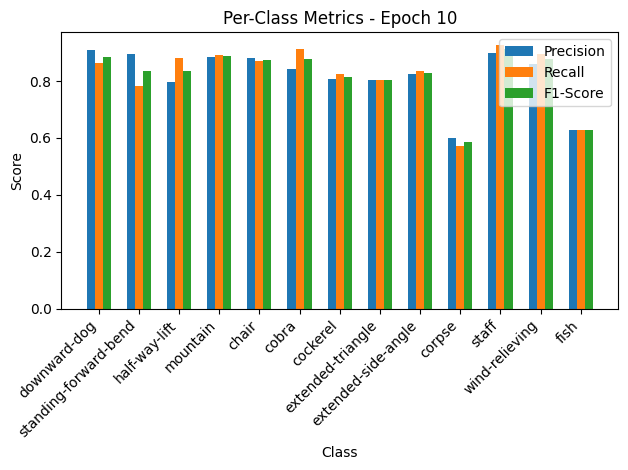

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.15it/s, loss=0.46, accuracy=84.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.77, Recall=1.00, F1-Score=0.87
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=0.47, Recall=0.88, F1-Score=0.61
staff: Precision=0.73, Recall=1.00, F1-Score=0.84
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


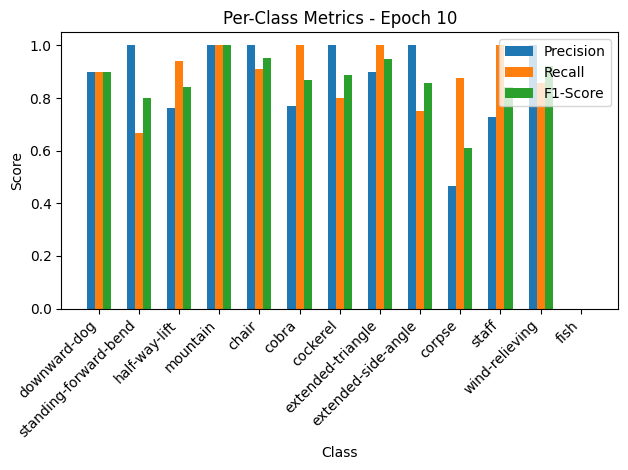


Epoch 11/50 Summary:
Train Loss: 0.5244 | Train Acc: 83.26% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5037 | Val Acc: 84.25% | Val Precision: 0.81 | Val Recall: 0.82 | Val F1: 0.80

Epoch 12/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.29it/s, loss=0.318, accuracy=90.3]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.96, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.82, Recall=0.95, F1-Score=0.88
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.88, Recall=0.99, F1-Score=0.93
cockerel: Precision=0.94, Recall=0.87, F1-Score=0.90
extended-triangle: Precision=0.95, Recall=0.91, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.76, Recall=0.62, F1-Score=0.68
staff: Precision=0.94, Recall=0.97, F1-Score=0.96
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.70, Recall=0.82, F1-Score=0.75


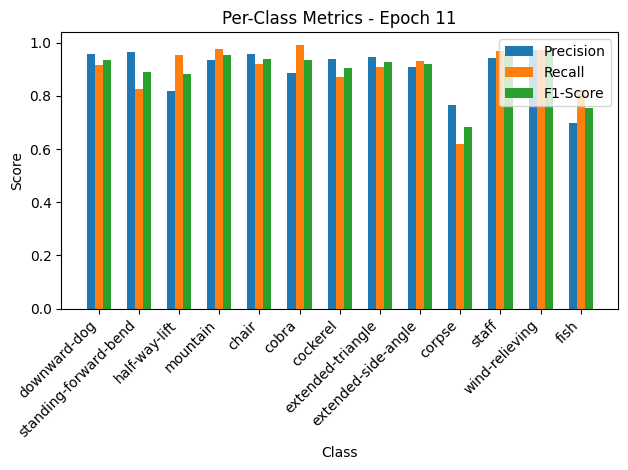

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.29it/s, loss=0.203, accuracy=92.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.67, Recall=0.86, F1-Score=0.75


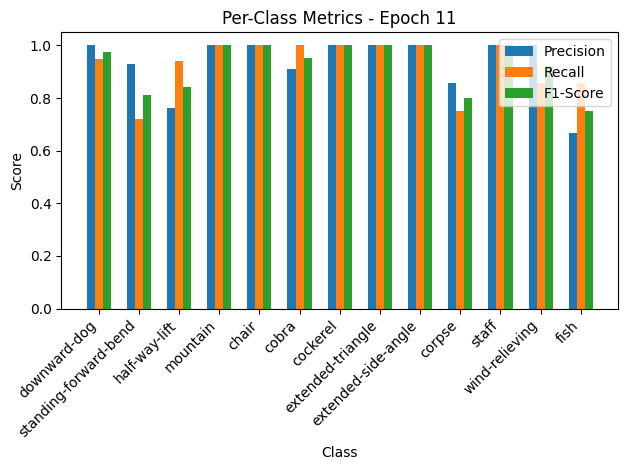


Epoch 12/50 Summary:
Train Loss: 0.3192 | Train Acc: 90.29% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90
Val Loss: 0.2229 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.2229

Epoch 13/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.257, accuracy=92]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.98, Recall=0.93, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.87, Recall=0.84, F1-Score=0.86
extended-side-angle: Precision=0.83, Recall=0.88, F1-Score=0.85
corpse: Precision=0.81, Recall=0.75, F1-Score=0.78
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.77, Recall=0.84, F1-Score=0.80


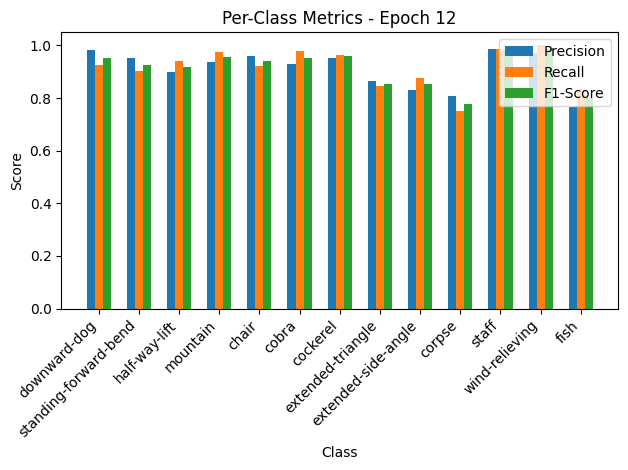

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.82it/s, loss=0.204, accuracy=91.1]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.82, Recall=1.00, F1-Score=0.90
extended-side-angle: Precision=1.00, Recall=0.75, F1-Score=0.86
corpse: Precision=0.75, Recall=0.75, F1-Score=0.75
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.62, Recall=0.71, F1-Score=0.67


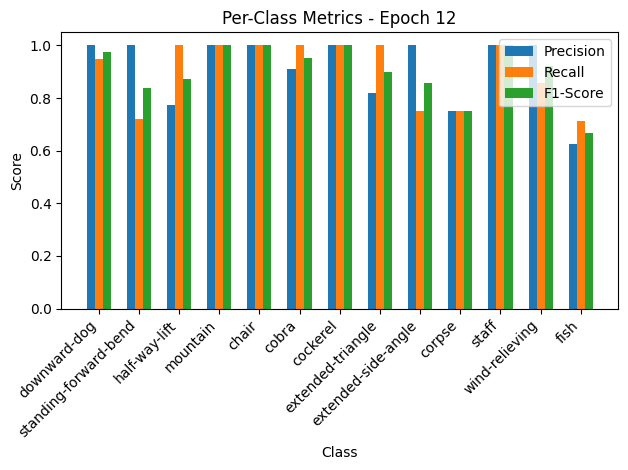


Epoch 13/50 Summary:
Train Loss: 0.2574 | Train Acc: 92.05% | Train Precision: 0.91 | Train Recall: 0.92 | Train F1: 0.91
Val Loss: 0.2234 | Val Acc: 91.10% | Val Precision: 0.91 | Val Recall: 0.90 | Val F1: 0.90

Epoch 14/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.49it/s, loss=0.242, accuracy=93.4]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.94, Recall=0.93, F1-Score=0.94
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.88, Recall=0.78, F1-Score=0.83
staff: Precision=0.92, Recall=0.99, F1-Score=0.95
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.80, Recall=0.82, F1-Score=0.81


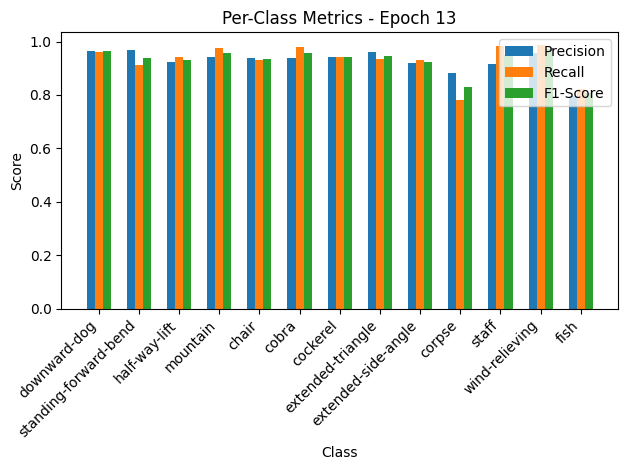

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.82it/s, loss=0.127, accuracy=95.2]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


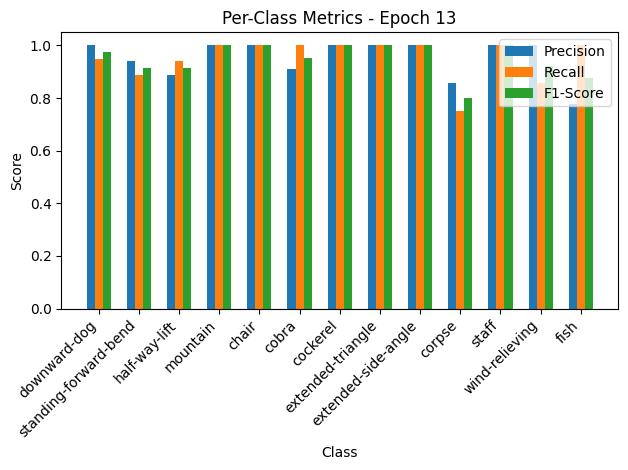


Epoch 14/50 Summary:
Train Loss: 0.2427 | Train Acc: 93.43% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1396 | Val Acc: 95.21% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 14
New best model saved! Validation Loss: 0.1396

Epoch 15/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.31it/s, loss=0.243, accuracy=92.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.92
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.91, Recall=0.94, F1-Score=0.92
extended-side-angle: Precision=0.92, Recall=0.92, F1-Score=0.92
corpse: Precision=0.77, Recall=0.74, F1-Score=0.75
staff: Precision=0.96, Recall=0.96, F1-Score=0.96
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.74, Recall=0.79, F1-Score=0.76


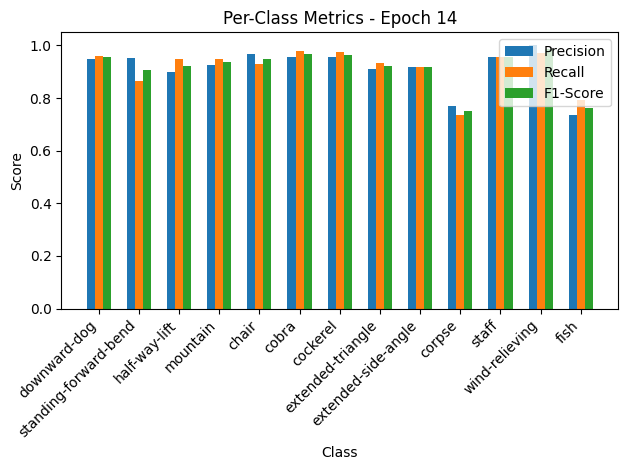

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.35it/s, loss=0.144, accuracy=93.2]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.62, F1-Score=0.77
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


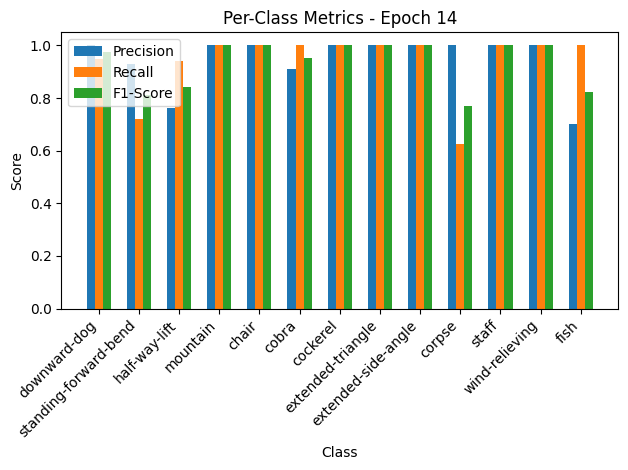


Epoch 15/50 Summary:
Train Loss: 0.2438 | Train Acc: 92.20% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1576 | Val Acc: 93.15% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 16/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.12it/s, loss=0.187, accuracy=94.5]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.92, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.97, F1-Score=0.95
corpse: Precision=0.85, Recall=0.81, F1-Score=0.83
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.83, Recall=0.85, F1-Score=0.84


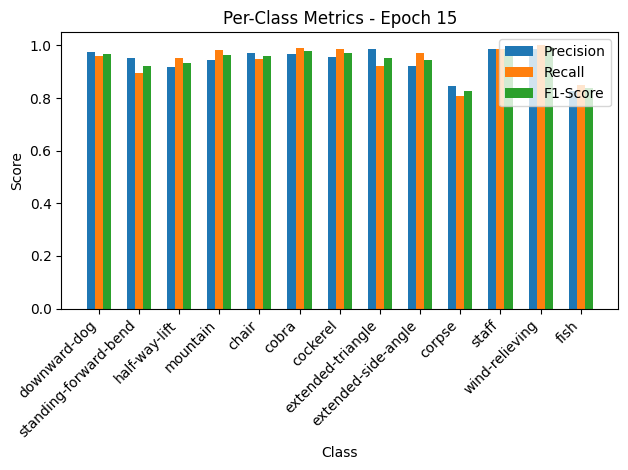

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.15it/s, loss=0.121, accuracy=95.9]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


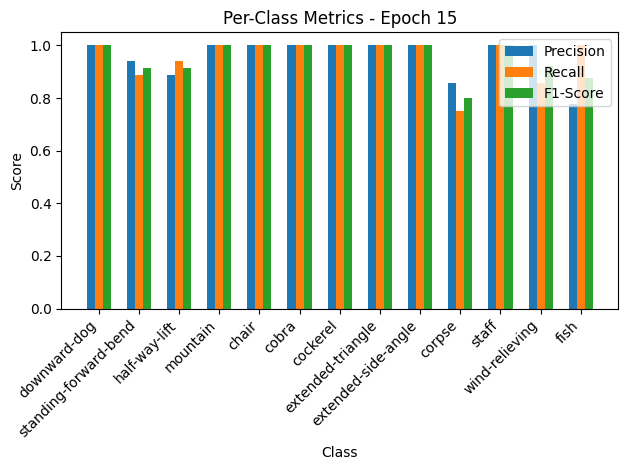


Epoch 16/50 Summary:
Train Loss: 0.1875 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1321 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 16
New best model saved! Validation Loss: 0.1321

Epoch 17/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.01it/s, loss=0.221, accuracy=93.3]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.95, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.94, F1-Score=0.94
extended-triangle: Precision=0.93, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.89, Recall=0.92, F1-Score=0.91
corpse: Precision=0.81, Recall=0.79, F1-Score=0.80
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.78, Recall=0.78, F1-Score=0.78


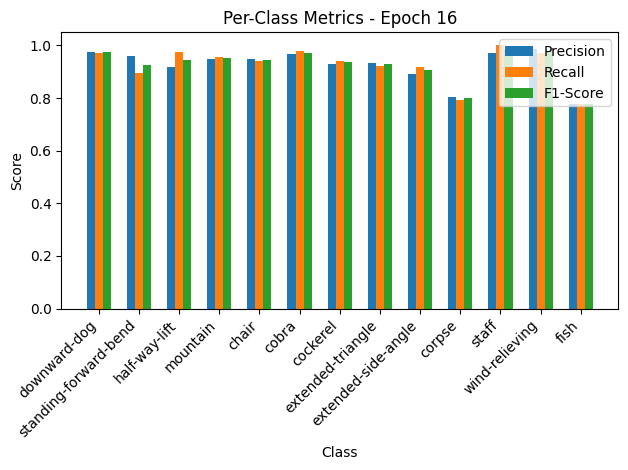

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.62it/s, loss=0.158, accuracy=92.5]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=1.00, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


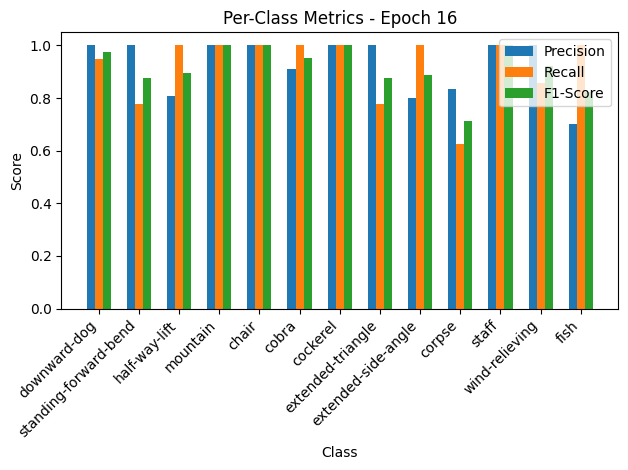


Epoch 17/50 Summary:
Train Loss: 0.2214 | Train Acc: 93.35% | Train Precision: 0.92 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1729 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.35it/s, loss=0.198, accuracy=94.4]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.91, F1-Score=0.95
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.93
mountain: Precision=0.91, Recall=0.98, F1-Score=0.94
chair: Precision=0.96, Recall=0.92, F1-Score=0.94
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.84, Recall=0.79, F1-Score=0.82
staff: Precision=0.97, Recall=0.97, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.85, F1-Score=0.83


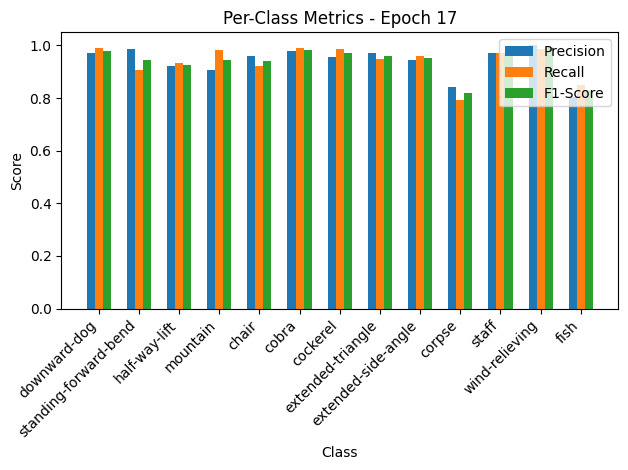

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.79it/s, loss=0.177, accuracy=93.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=0.92, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


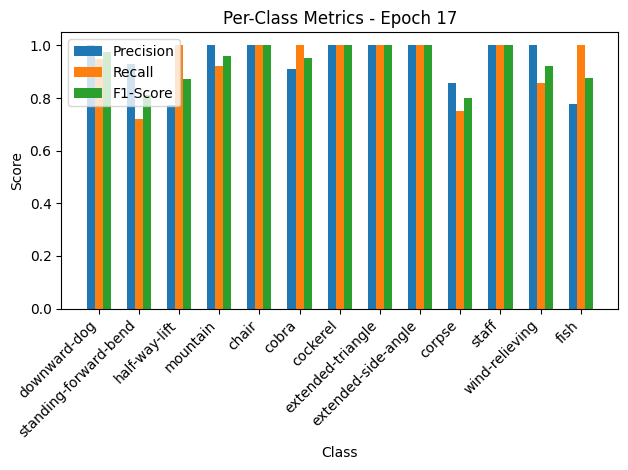


Epoch 18/50 Summary:
Train Loss: 0.1991 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1940 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.195, accuracy=93.8]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.92, Recall=0.95, F1-Score=0.93
chair: Precision=0.97, Recall=0.94, F1-Score=0.95
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.92, Recall=0.95, F1-Score=0.93
corpse: Precision=0.76, Recall=0.76, F1-Score=0.76
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.76, Recall=0.76, F1-Score=0.76


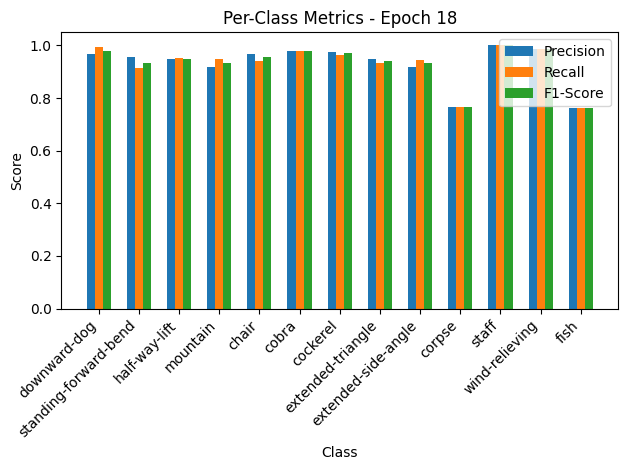

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.46it/s, loss=0.144, accuracy=93.8]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.83, Recall=0.62, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


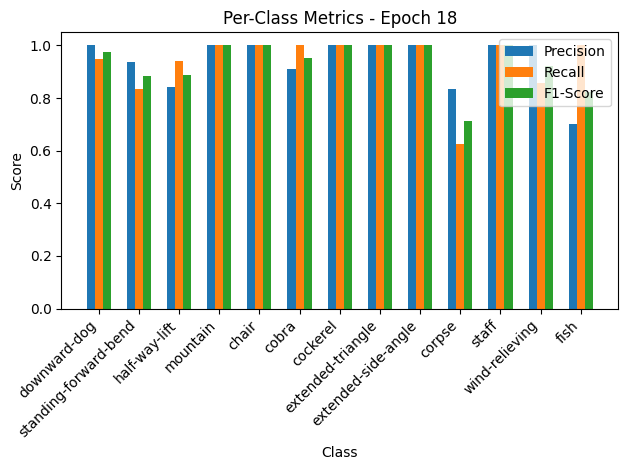


Epoch 19/50 Summary:
Train Loss: 0.1955 | Train Acc: 93.81% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1581 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.77it/s, loss=0.183, accuracy=95]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.99, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.91, Recall=0.92, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.92, F1-Score=0.91
corpse: Precision=0.84, Recall=0.84, F1-Score=0.84
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


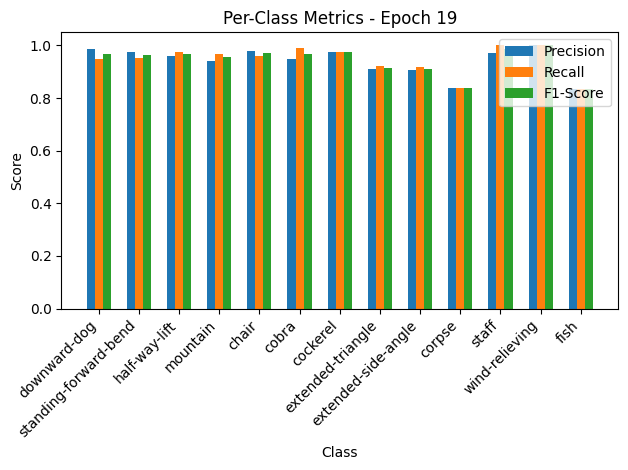

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.66it/s, loss=0.19, accuracy=93.2]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.72, F1-Score=0.81
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


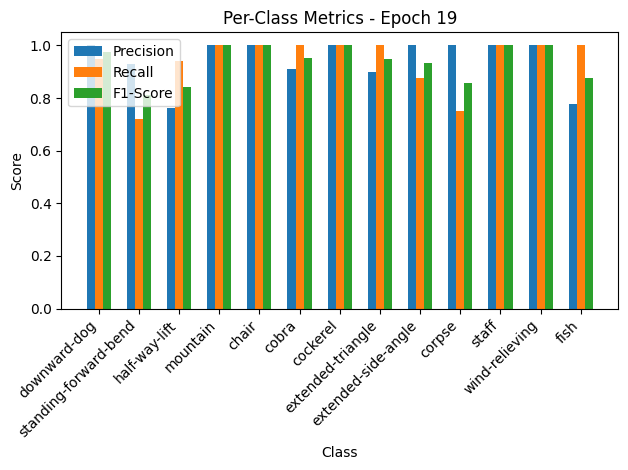


Epoch 20/50 Summary:
Train Loss: 0.1840 | Train Acc: 94.95% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2082 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.10it/s, loss=0.205, accuracy=94.3]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.94, Recall=0.94, F1-Score=0.94
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.90, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.83, Recall=0.72, F1-Score=0.77
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.77, Recall=0.85, F1-Score=0.81


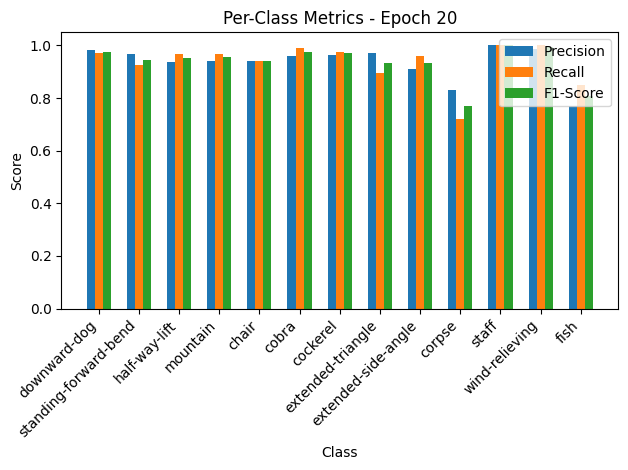

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.80it/s, loss=0.119, accuracy=95.2]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


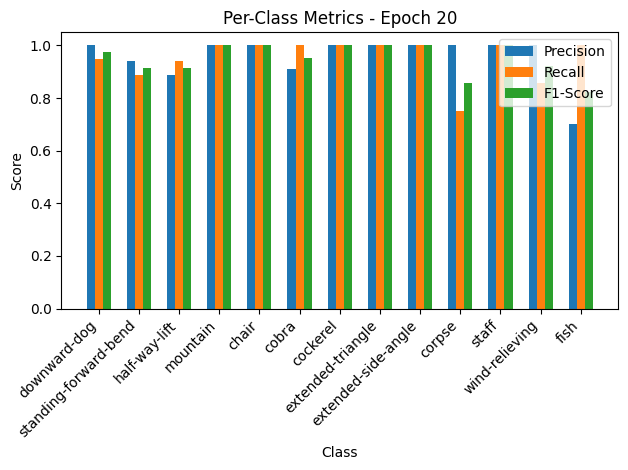


Epoch 21/50 Summary:
Train Loss: 0.2056 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1304 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 21
New best model saved! Validation Loss: 0.1304

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.27it/s, loss=0.208, accuracy=94.7]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.99, Recall=0.94, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.90, Recall=0.97, F1-Score=0.93
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.92, F1-Score=0.92
corpse: Precision=0.84, Recall=0.82, F1-Score=0.83
staff: Precision=0.94, Recall=1.00, F1-Score=0.97
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.84, F1-Score=0.84


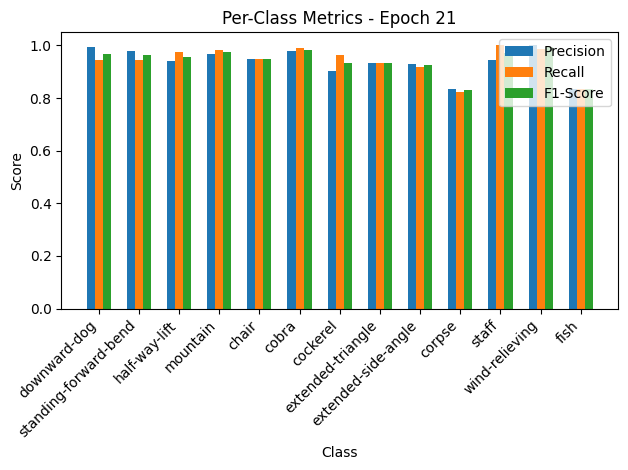

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.71it/s, loss=0.138, accuracy=93.2]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


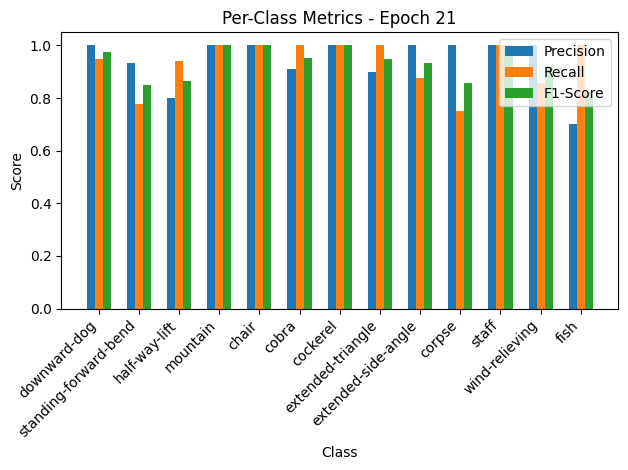


Epoch 22/50 Summary:
Train Loss: 0.2082 | Train Acc: 94.72% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1514 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=0.189, accuracy=95.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.96, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.94, F1-Score=0.95
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.94, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.95
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.92, Recall=0.82, F1-Score=0.87
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.82, Recall=0.90, F1-Score=0.86


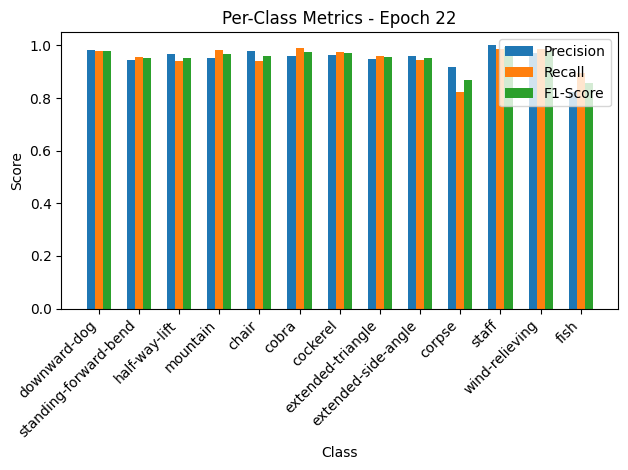

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.23it/s, loss=0.118, accuracy=94.5]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


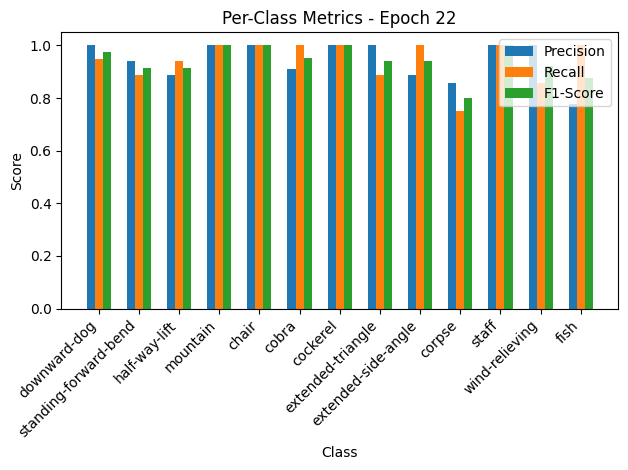


Epoch 23/50 Summary:
Train Loss: 0.1899 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1288 | Val Acc: 94.52% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.94
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.1288

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.05it/s, loss=0.186, accuracy=95.4]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.93, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.89, Recall=0.93, F1-Score=0.91
corpse: Precision=0.90, Recall=0.82, F1-Score=0.86
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.91, F1-Score=0.87


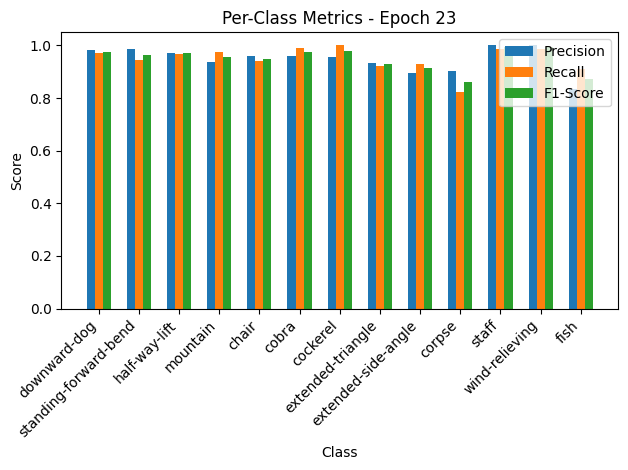

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.85it/s, loss=0.126, accuracy=95.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=1.00, F1-Score=0.82


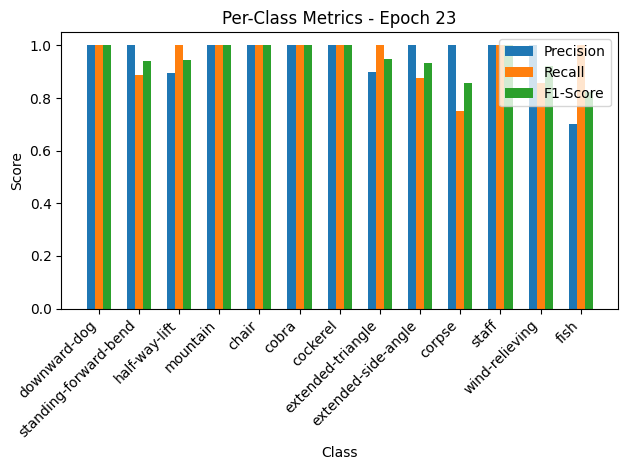


Epoch 24/50 Summary:
Train Loss: 0.1866 | Train Acc: 95.41% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1379 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.60it/s, loss=0.185, accuracy=94.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.95, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.95, Recall=0.92, F1-Score=0.93
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.83, Recall=0.85, F1-Score=0.84
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.86, Recall=0.81, F1-Score=0.83


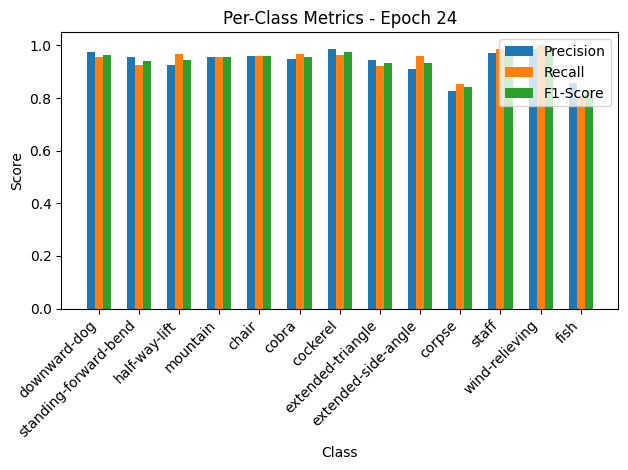

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.63it/s, loss=0.235, accuracy=93.8]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.54, Recall=0.88, F1-Score=0.67
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.50, Recall=0.14, F1-Score=0.22


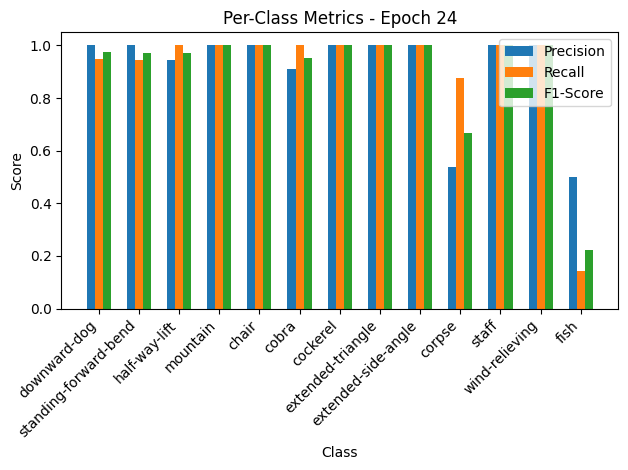


Epoch 25/50 Summary:
Train Loss: 0.1857 | Train Acc: 94.42% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.2571 | Val Acc: 93.84% | Val Precision: 0.91 | Val Recall: 0.92 | Val F1: 0.90

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.92it/s, loss=0.158, accuracy=95.9]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.95, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.89, Recall=0.87, F1-Score=0.88
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.87, Recall=0.90, F1-Score=0.88


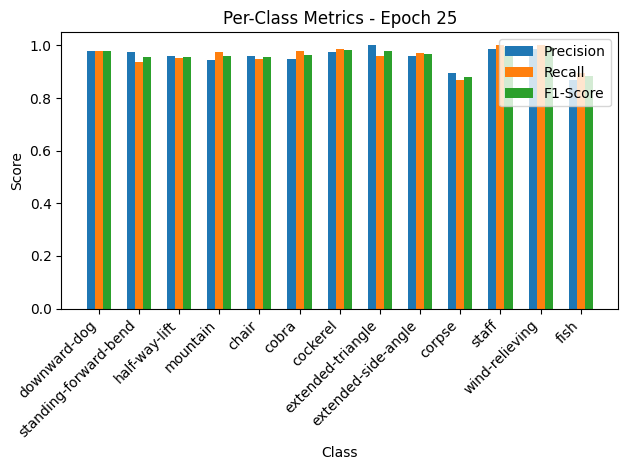

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.50it/s, loss=0.136, accuracy=94.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


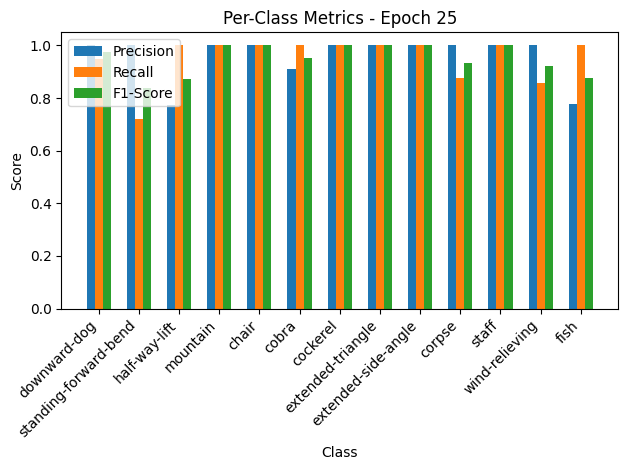


Epoch 26/50 Summary:
Train Loss: 0.1580 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1488 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.23it/s, loss=0.179, accuracy=94.8]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.95, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.95, F1-Score=0.95
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


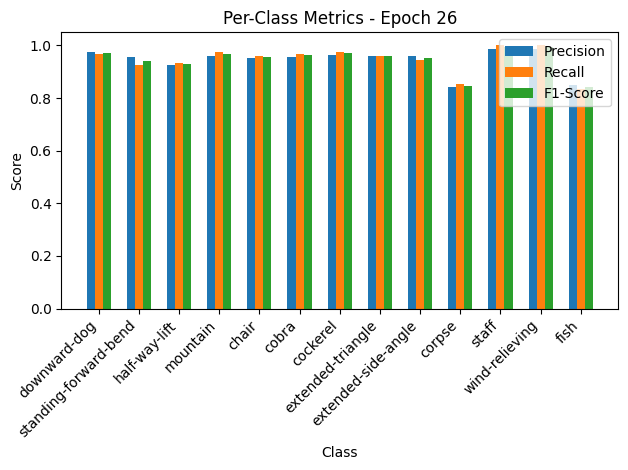

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.38it/s, loss=0.126, accuracy=95.2]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.78, Recall=0.88, F1-Score=0.82
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.71, Recall=0.71, F1-Score=0.71


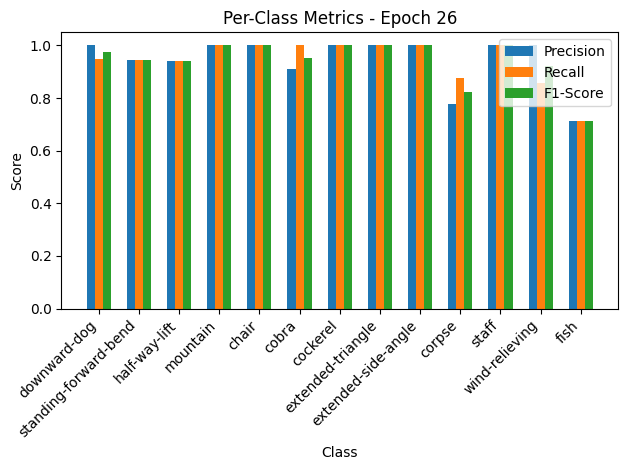


Epoch 27/50 Summary:
Train Loss: 0.1798 | Train Acc: 94.80% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1383 | Val Acc: 95.21% | Val Precision: 0.95 | Val Recall: 0.94 | Val F1: 0.94

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.99it/s, loss=0.183, accuracy=95.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.96, F1-Score=0.96
half-way-lift: Precision=0.98, Recall=0.95, F1-Score=0.96
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.90, Recall=0.97, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.89, F1-Score=0.92
corpse: Precision=0.85, Recall=0.78, F1-Score=0.82
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.79, Recall=0.87, F1-Score=0.83


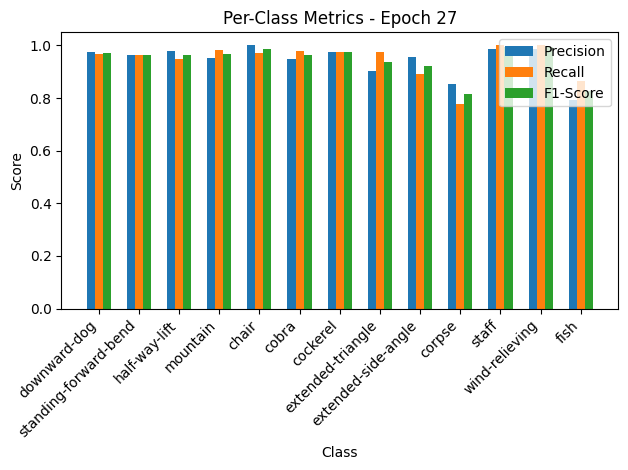

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.35it/s, loss=0.177, accuracy=92.5]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.81, Recall=1.00, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.58, Recall=0.88, F1-Score=0.70
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.67, Recall=0.29, F1-Score=0.40


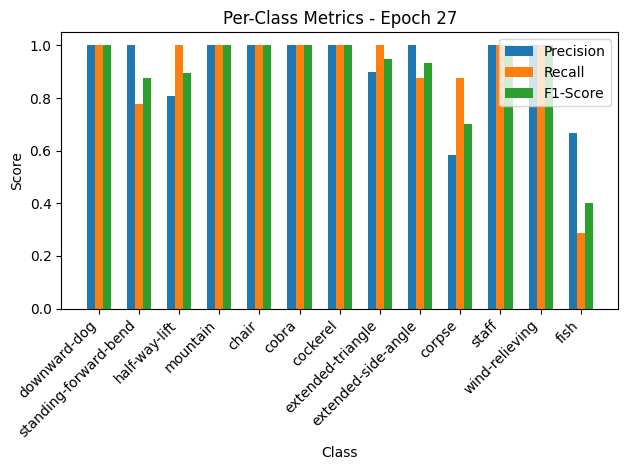


Epoch 28/50 Summary:
Train Loss: 0.1832 | Train Acc: 95.18% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.1937 | Val Acc: 92.47% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.90

Epoch 29/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.57it/s, loss=0.168, accuracy=95.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.93, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.78, Recall=0.91, F1-Score=0.84
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.73, F1-Score=0.80


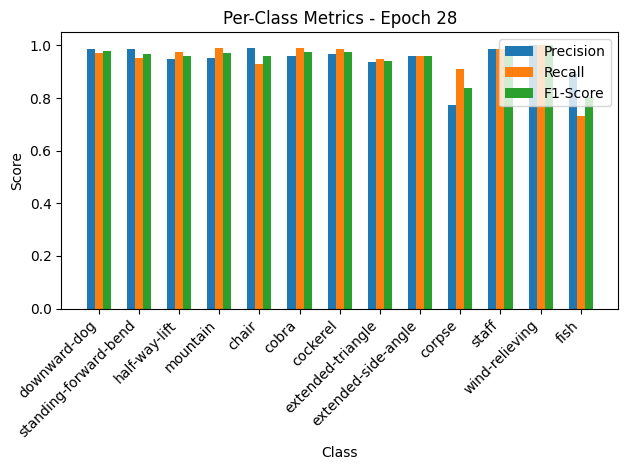

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.91it/s, loss=0.0615, accuracy=96.6]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


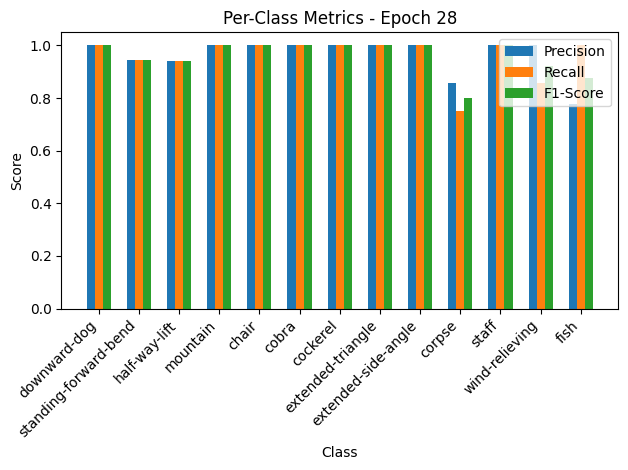


Epoch 29/50 Summary:
Train Loss: 0.1689 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.0674 | Val Acc: 96.58% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 29
New best model saved! Validation Loss: 0.0674

Epoch 30/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.38it/s, loss=0.12, accuracy=96.8]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.96, F1-Score=0.96
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.88, Recall=0.90, F1-Score=0.89
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.88, F1-Score=0.89


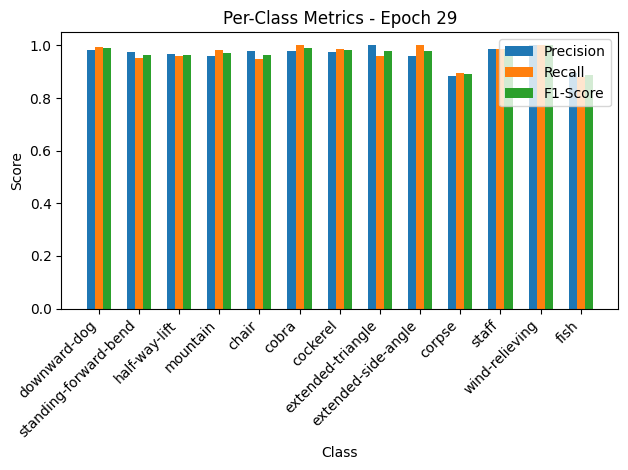

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.78it/s, loss=0.0773, accuracy=97.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


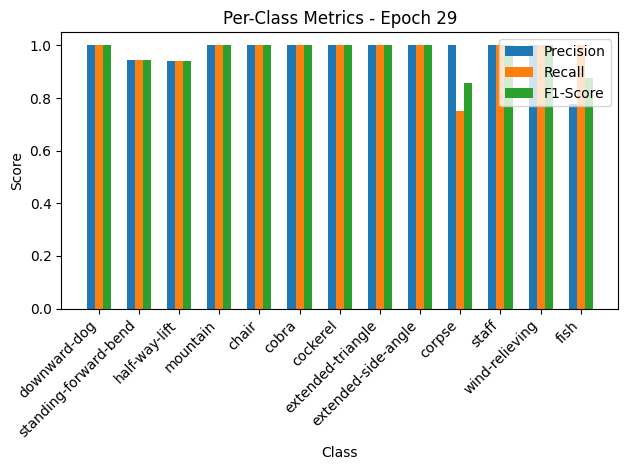


Epoch 30/50 Summary:
Train Loss: 0.1206 | Train Acc: 96.79% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0848 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 31/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.55it/s, loss=0.106, accuracy=97.3]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


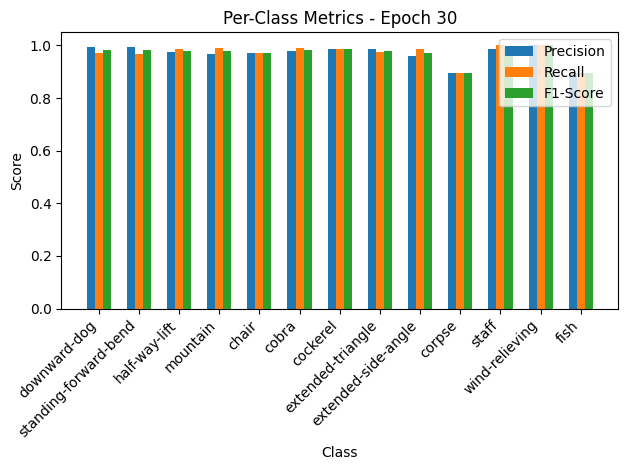

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.46it/s, loss=0.0614, accuracy=97.9]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


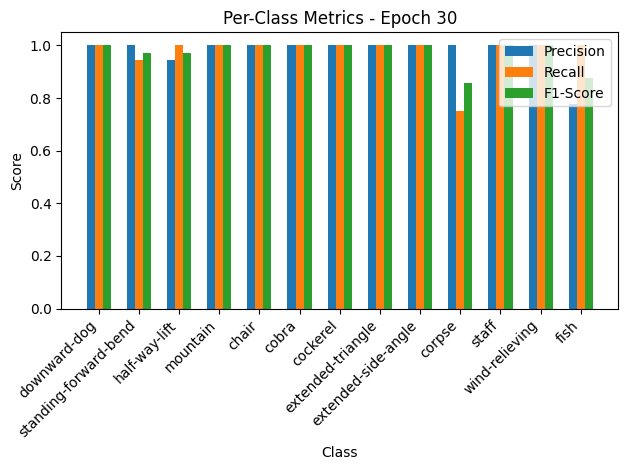


Epoch 31/50 Summary:
Train Loss: 0.1065 | Train Acc: 97.32% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0673 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 31
New best model saved! Validation Loss: 0.0673

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.65it/s, loss=0.121, accuracy=97.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.89, Recall=0.94, F1-Score=0.91
staff: Precision=1.00, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


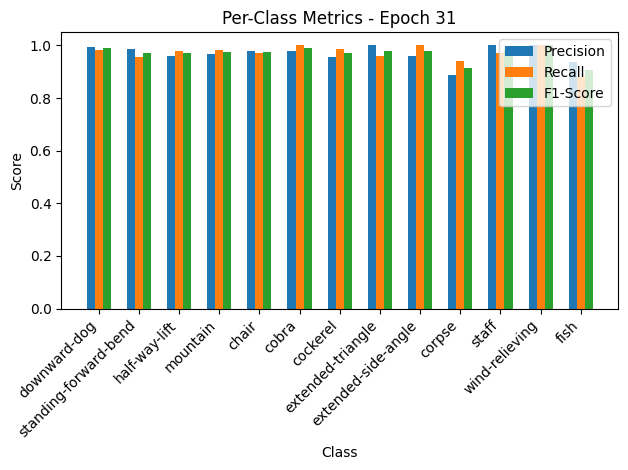

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.13it/s, loss=0.0708, accuracy=97.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


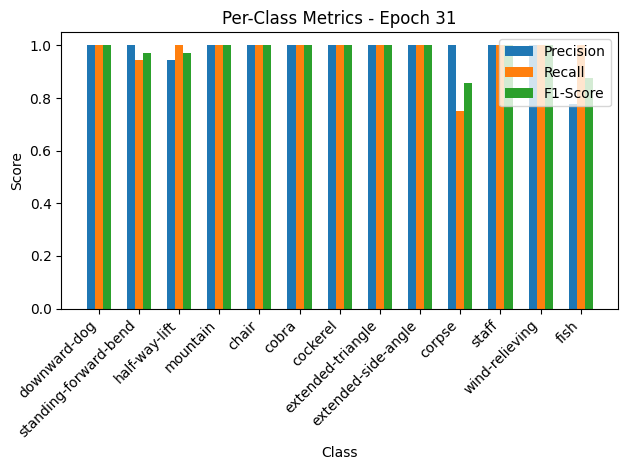


Epoch 32/50 Summary:
Train Loss: 0.1212 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0776 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.64it/s, loss=0.124, accuracy=96.7]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.91, F1-Score=0.90


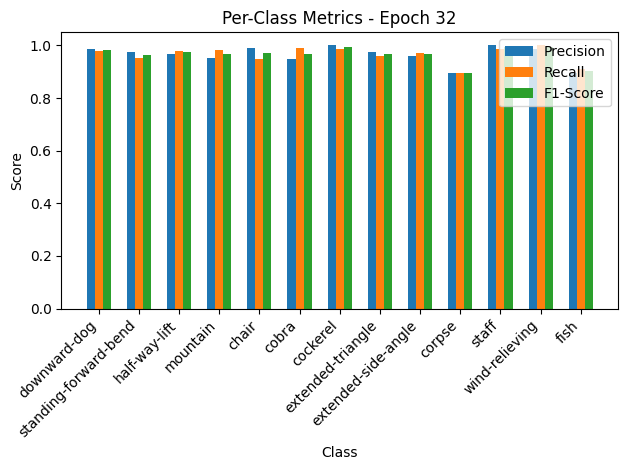

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.91it/s, loss=0.0645, accuracy=97.9]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


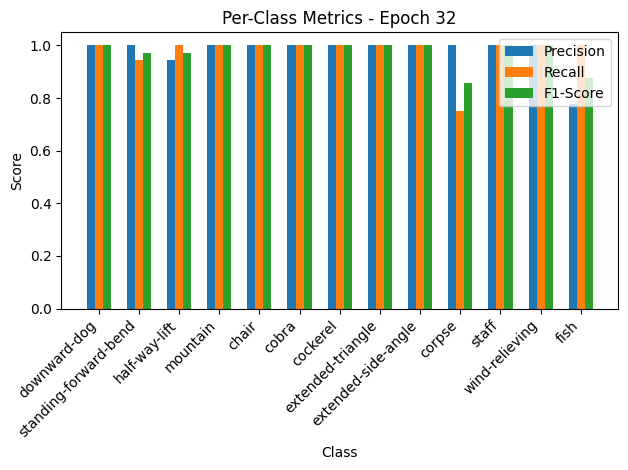


Epoch 33/50 Summary:
Train Loss: 0.1241 | Train Acc: 96.71% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0707 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.92it/s, loss=0.116, accuracy=97.2]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.95, F1-Score=0.94
corpse: Precision=0.92, Recall=0.90, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.93, F1-Score=0.91


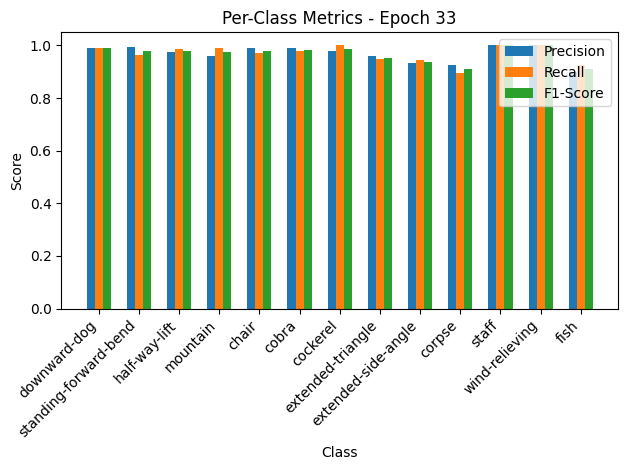

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.85it/s, loss=0.0874, accuracy=97.3]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


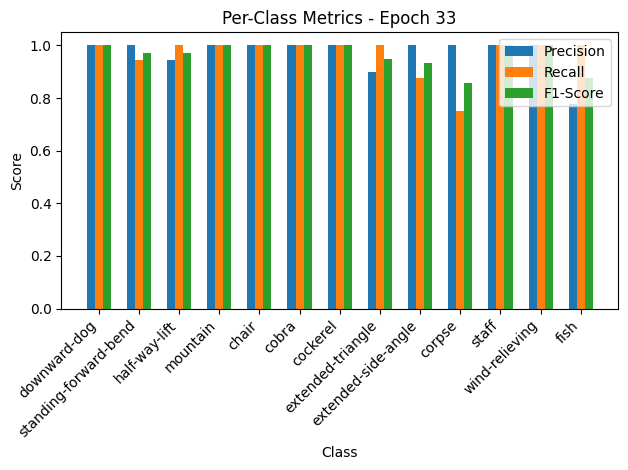


Epoch 34/50 Summary:
Train Loss: 0.1159 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0958 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.70it/s, loss=0.13, accuracy=96.6]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


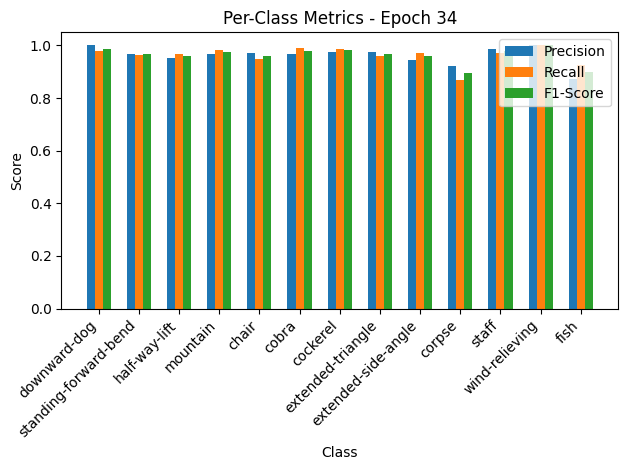

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.07it/s, loss=0.0691, accuracy=96.6]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


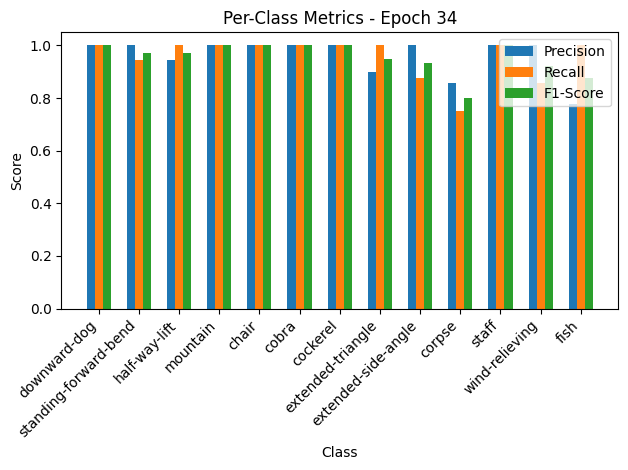


Epoch 35/50 Summary:
Train Loss: 0.1301 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0757 | Val Acc: 96.58% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:10<00:00,  8.03it/s, loss=0.112, accuracy=97.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.95, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.88, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.91, F1-Score=0.90


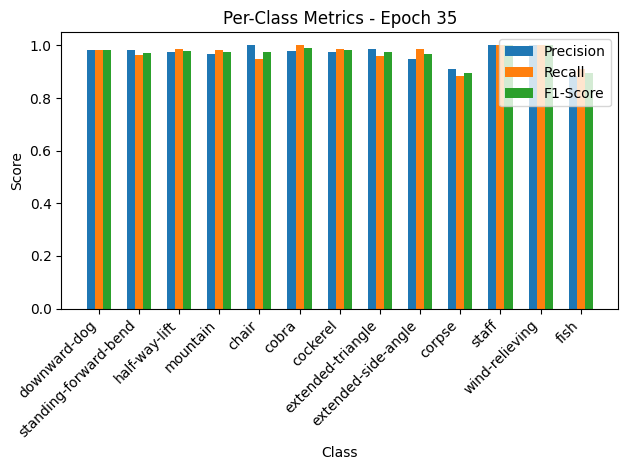

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.26it/s, loss=0.0693, accuracy=97.9]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


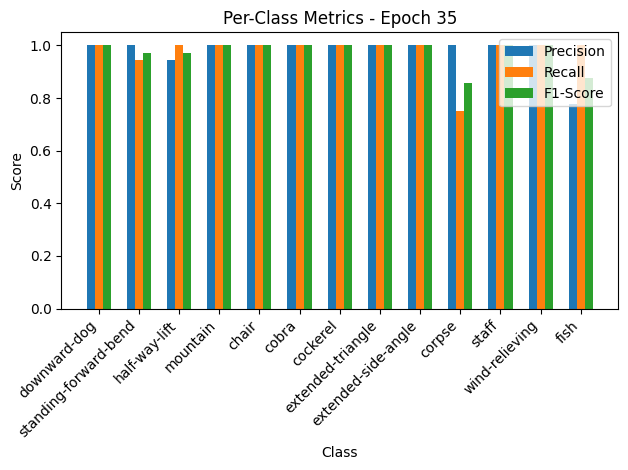


Epoch 36/50 Summary:
Train Loss: 0.1120 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0760 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 37/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00, 10.25it/s, loss=0.107, accuracy=97.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.94, Recall=0.90, F1-Score=0.92
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.91, Recall=0.94, F1-Score=0.93


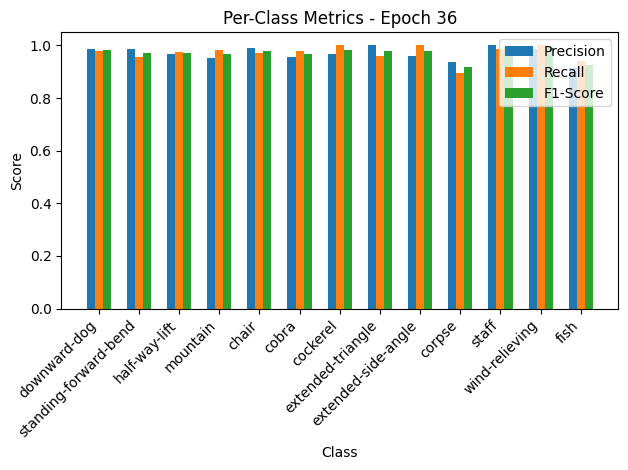

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.28it/s, loss=0.0737, accuracy=97.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


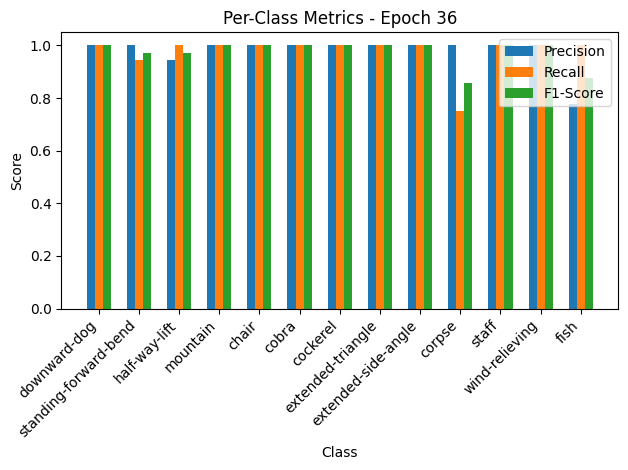


Epoch 37/50 Summary:
Train Loss: 0.1073 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0807 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 38/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.70it/s, loss=0.102, accuracy=97.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.98, F1-Score=0.97
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.94, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


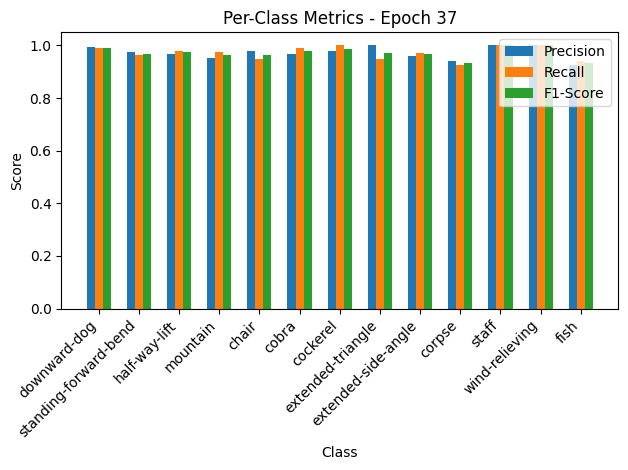

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.80it/s, loss=0.0675, accuracy=97.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


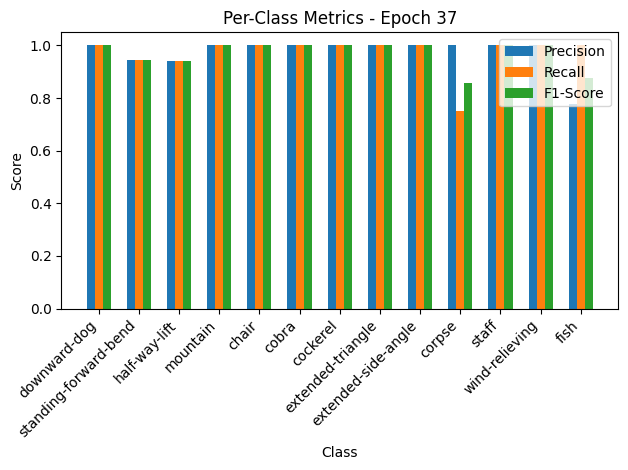


Epoch 38/50 Summary:
Train Loss: 0.1024 | Train Acc: 97.32% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0740 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.31it/s, loss=0.0975, accuracy=97.7]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.98, Recall=0.93, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.99, F1-Score=0.96


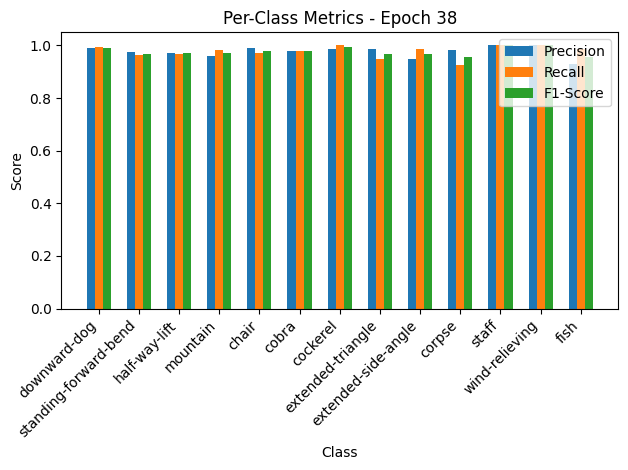

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.31it/s, loss=0.0689, accuracy=97.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


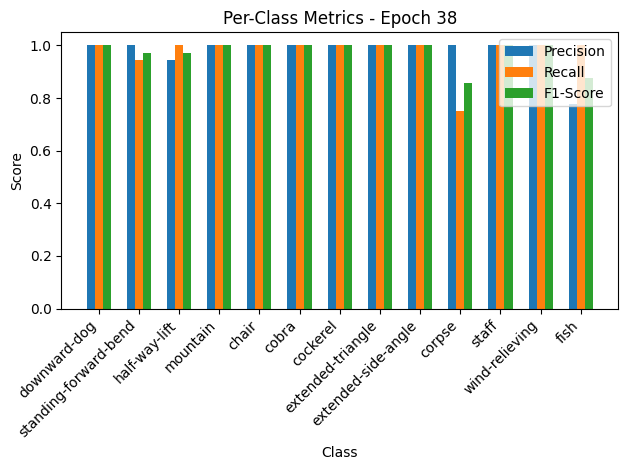


Epoch 39/50 Summary:
Train Loss: 0.0978 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0755 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00, 10.09it/s, loss=0.103, accuracy=97]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.98, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.85, F1-Score=0.86


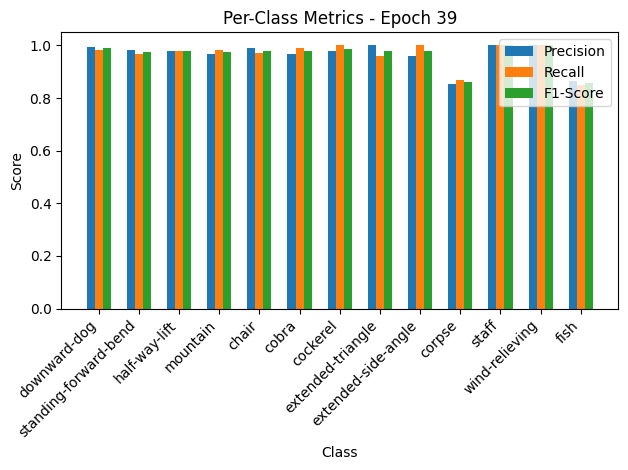

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.39it/s, loss=0.0737, accuracy=97.9]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


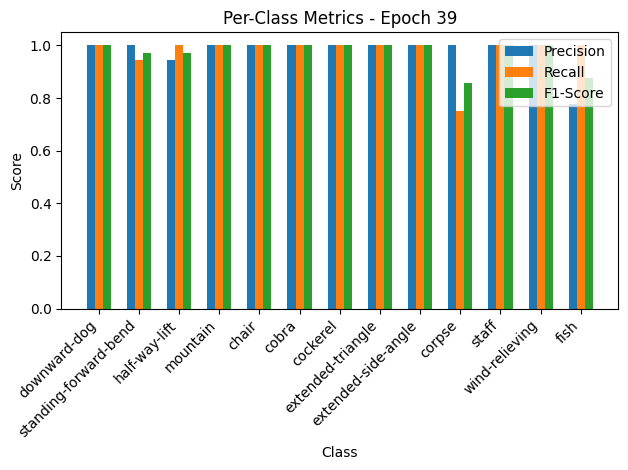


Epoch 40/50 Summary:
Train Loss: 0.1032 | Train Acc: 97.02% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0807 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.81it/s, loss=0.1, accuracy=97.2]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


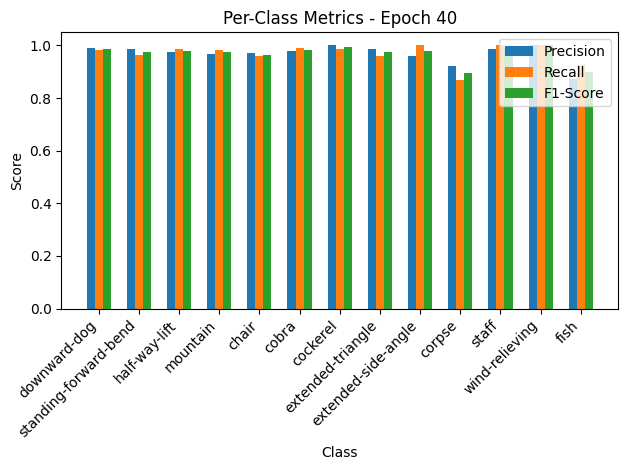

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.90it/s, loss=0.0675, accuracy=97.9]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


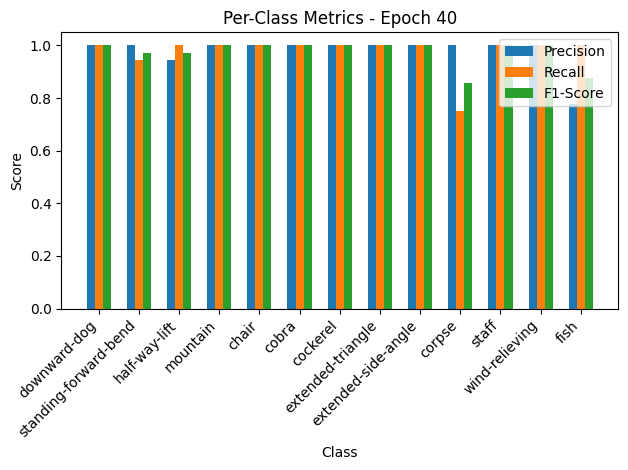


Epoch 41/50 Summary:
Train Loss: 0.1007 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0739 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.72it/s, loss=0.0938, accuracy=97.7]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.98, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.94, F1-Score=0.97
extended-side-angle: Precision=0.94, Recall=1.00, F1-Score=0.97
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


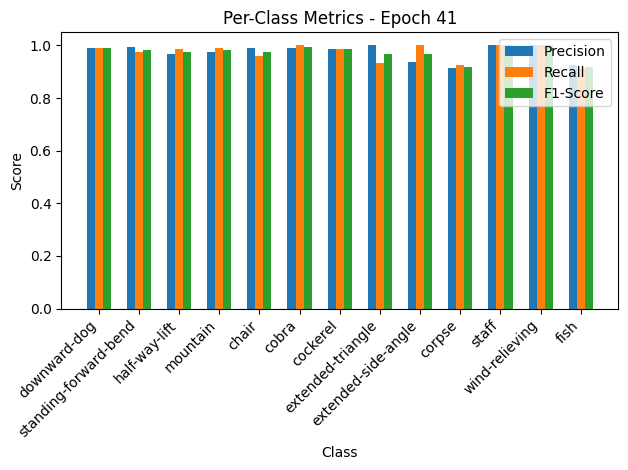

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.50it/s, loss=0.0607, accuracy=97.9]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


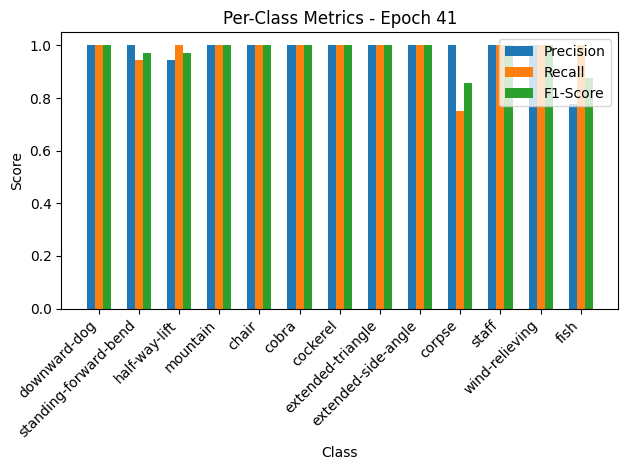


Epoch 42/50 Summary:
Train Loss: 0.0941 | Train Acc: 97.71% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0665 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_2.pth
Checkpoint saved at epoch 42
New best model saved! Validation Loss: 0.0665

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.95it/s, loss=0.112, accuracy=97.5]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.95, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.94, F1-Score=0.93
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


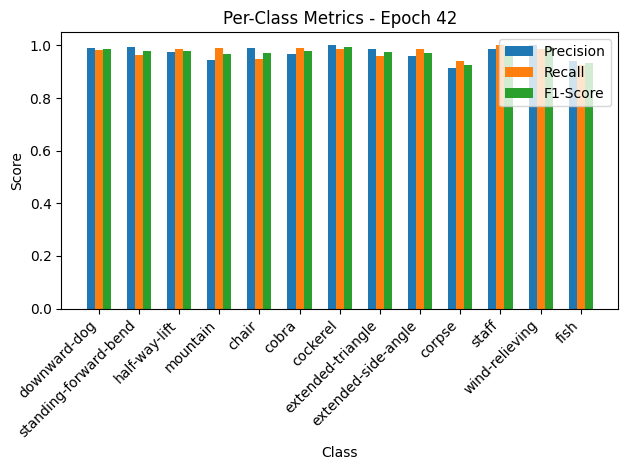

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.47it/s, loss=0.067, accuracy=97.9]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


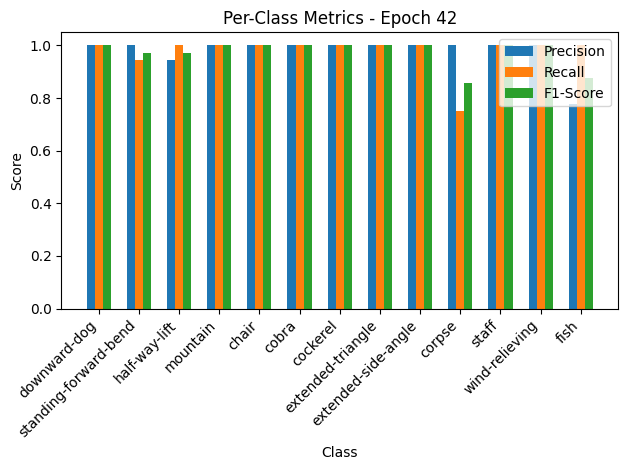


Epoch 43/50 Summary:
Train Loss: 0.1120 | Train Acc: 97.48% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0734 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.91it/s, loss=0.0938, accuracy=97.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.98, F1-Score=0.98
half-way-lift: Precision=0.98, Recall=0.99, F1-Score=0.98
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


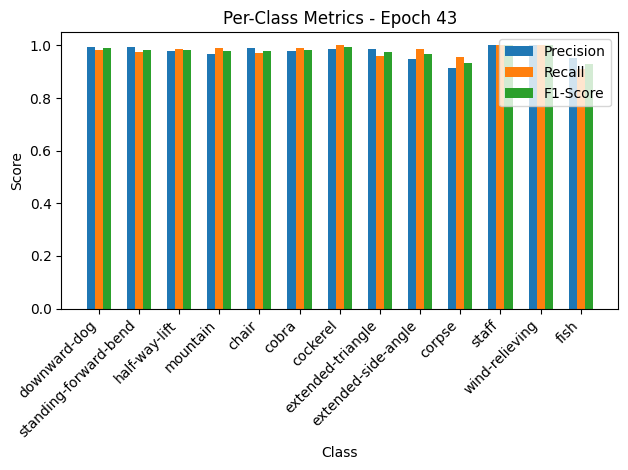

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.88it/s, loss=0.0632, accuracy=97.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


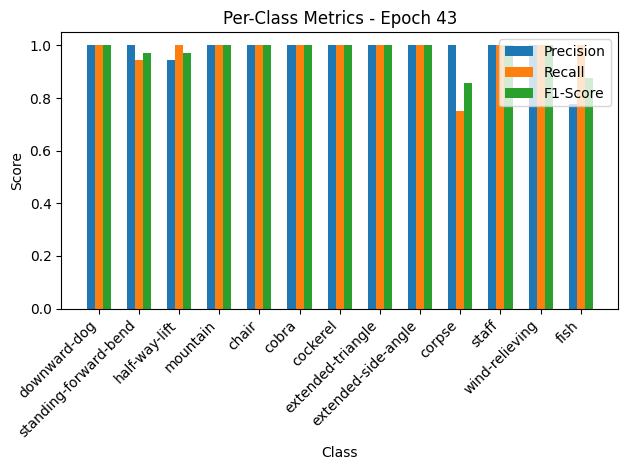


Epoch 44/50 Summary:
Train Loss: 0.0941 | Train Acc: 97.94% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0693 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.32it/s, loss=0.109, accuracy=97.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.97, Recall=0.99, F1-Score=0.98
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.94, F1-Score=0.97
cobra: Precision=0.99, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.91, F1-Score=0.92


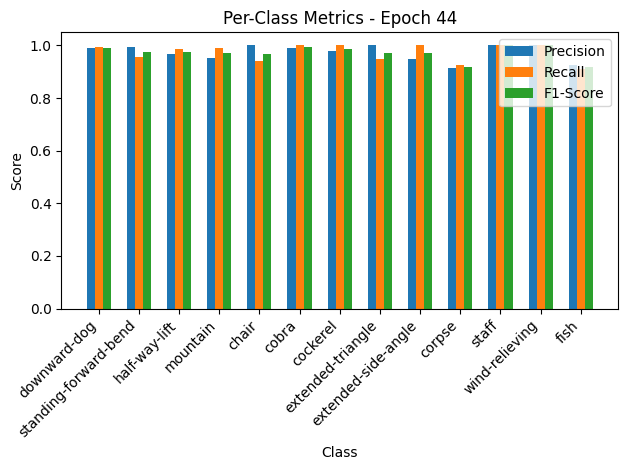

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.33it/s, loss=0.0707, accuracy=97.9]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


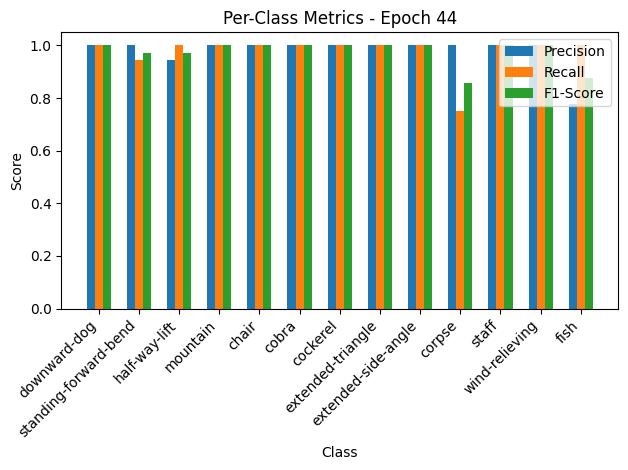


Epoch 45/50 Summary:
Train Loss: 0.1093 | Train Acc: 97.55% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0775 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:07<00:00, 10.57it/s, loss=0.109, accuracy=97.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.99, Recall=0.98, F1-Score=0.98
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.99, Recall=0.96, F1-Score=0.97
corpse: Precision=0.92, Recall=0.88, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.93, F1-Score=0.91


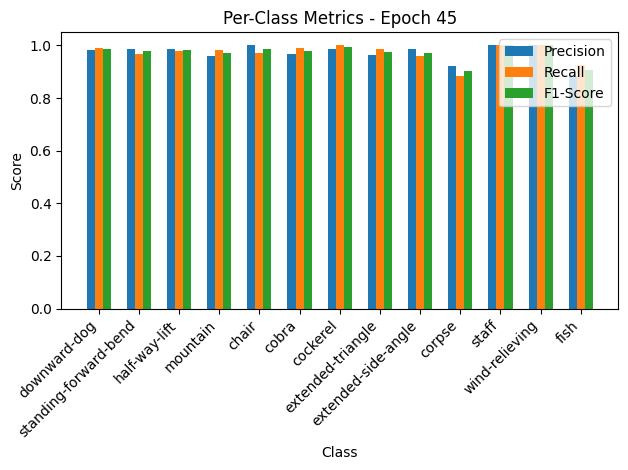

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.60it/s, loss=0.0635, accuracy=97.3]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


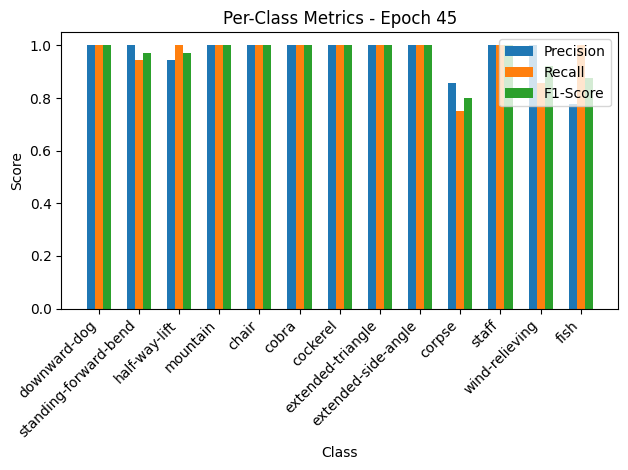


Epoch 46/50 Summary:
Train Loss: 0.1090 | Train Acc: 97.48% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0696 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.47it/s, loss=0.113, accuracy=97.2]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.97, F1-Score=0.98
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.94, Recall=0.93, F1-Score=0.93
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


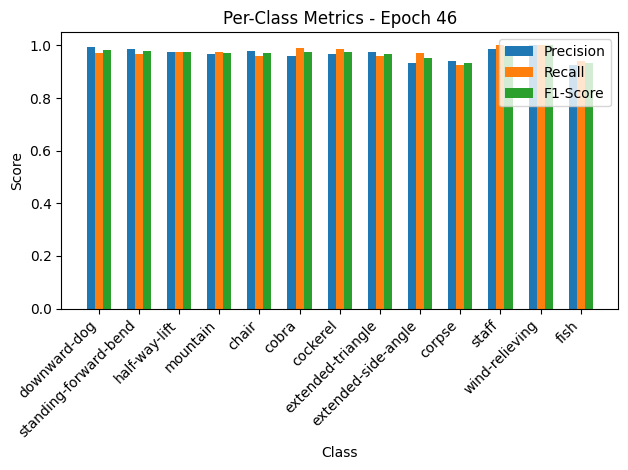

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.53it/s, loss=0.0679, accuracy=97.9]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


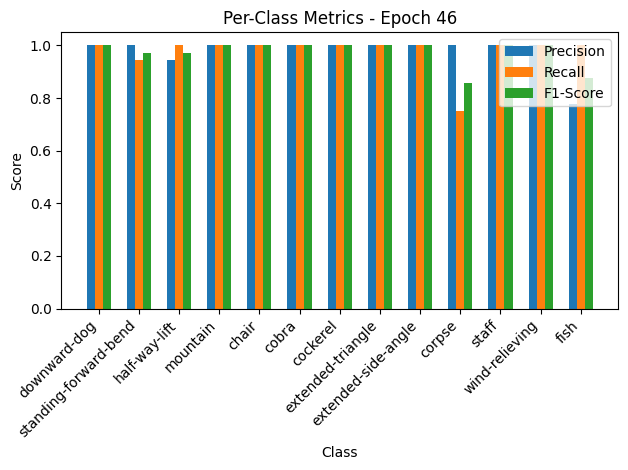


Epoch 47/50 Summary:
Train Loss: 0.1133 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0744 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 48/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.50it/s, loss=0.0991, accuracy=97.7]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.98, Recall=0.95, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.96, Recall=0.99, F1-Score=0.97
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.98, Recall=0.96, F1-Score=0.97


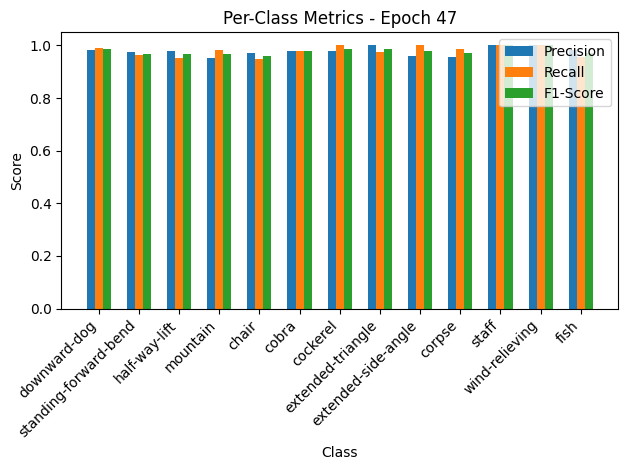

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.03it/s, loss=0.0636, accuracy=97.9]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


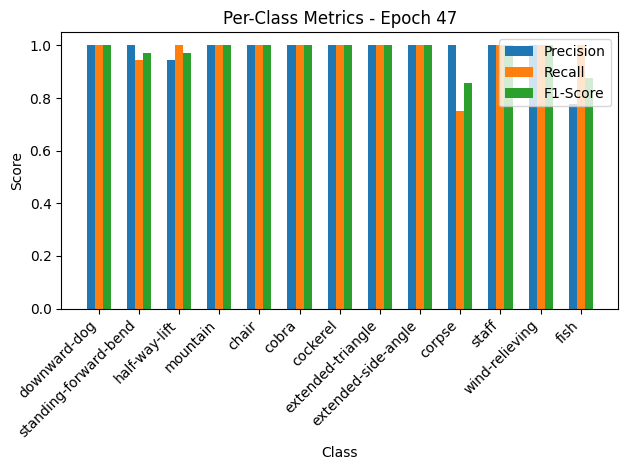


Epoch 48/50 Summary:
Train Loss: 0.0994 | Train Acc: 97.71% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.0696 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:07<00:00, 10.34it/s, loss=0.112, accuracy=96.8]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.97, F1-Score=0.97
half-way-lift: Precision=0.99, Recall=0.97, F1-Score=0.98
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.97, F1-Score=0.98
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.99, F1-Score=0.96
corpse: Precision=0.89, Recall=0.91, F1-Score=0.90
staff: Precision=0.98, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.89, Recall=0.87, F1-Score=0.88


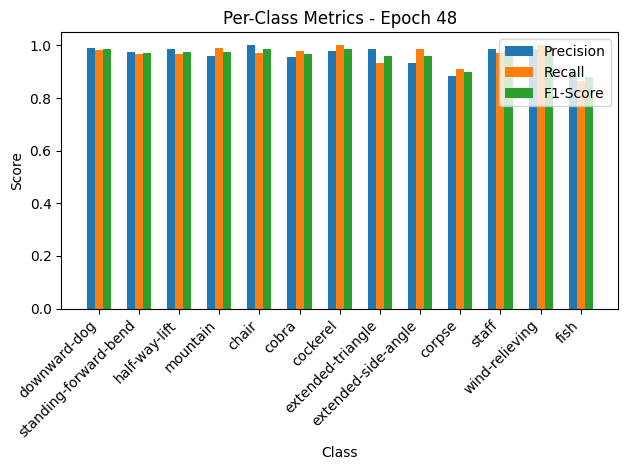

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.82it/s, loss=0.0611, accuracy=97.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


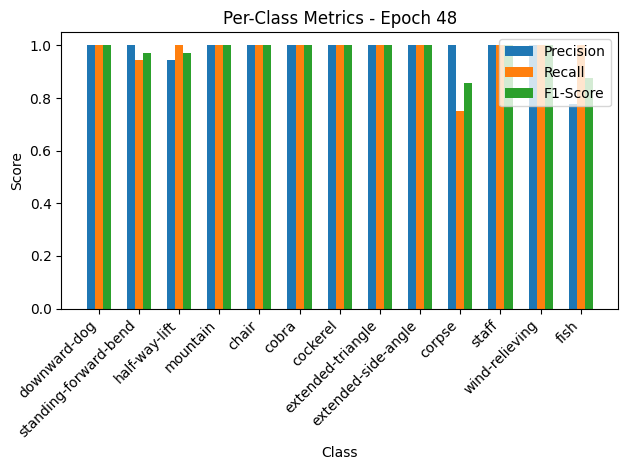


Epoch 49/50 Summary:
Train Loss: 0.1121 | Train Acc: 96.79% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0670 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.16it/s, loss=0.105, accuracy=97.4]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.97, Recall=0.97, F1-Score=0.97
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.97, Recall=0.90, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.97, F1-Score=0.94


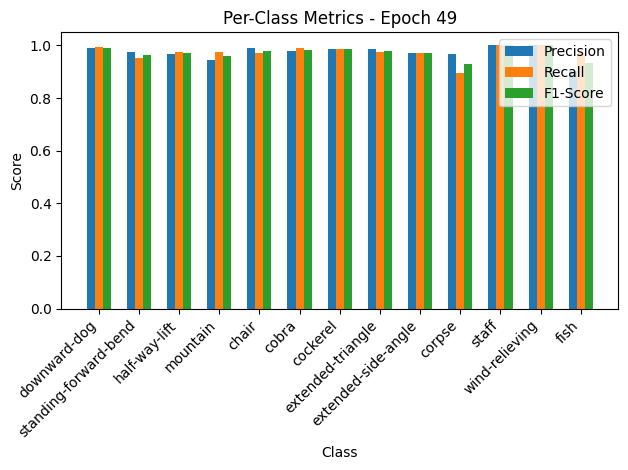

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.35it/s, loss=0.0776, accuracy=97.9]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


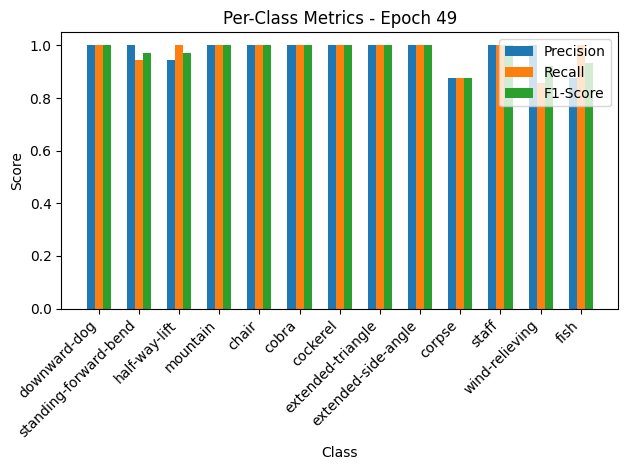


Epoch 50/50 Summary:
Train Loss: 0.1054 | Train Acc: 97.40% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0850 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.97


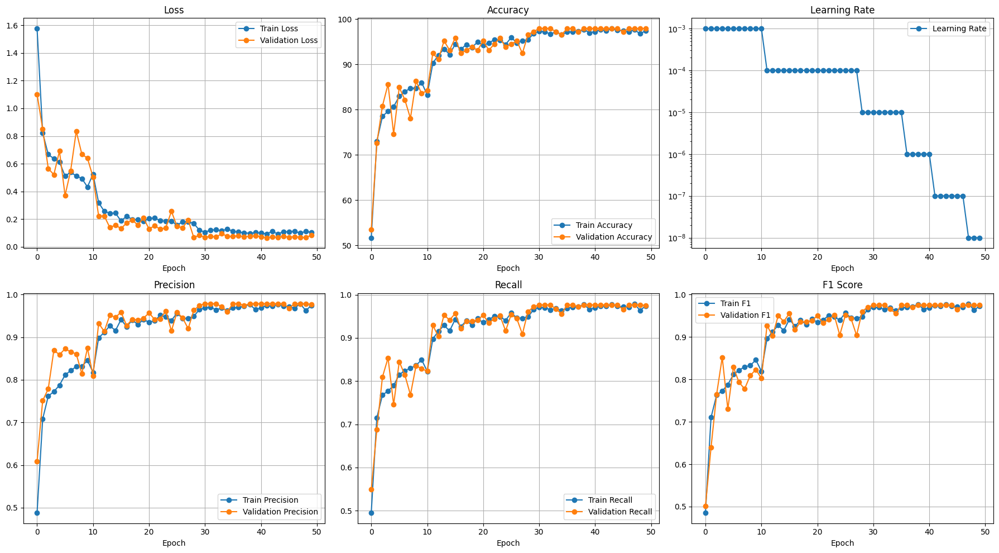

Testing: 100%|██████████| 23/23 [00:00<00:00, 41.76it/s]


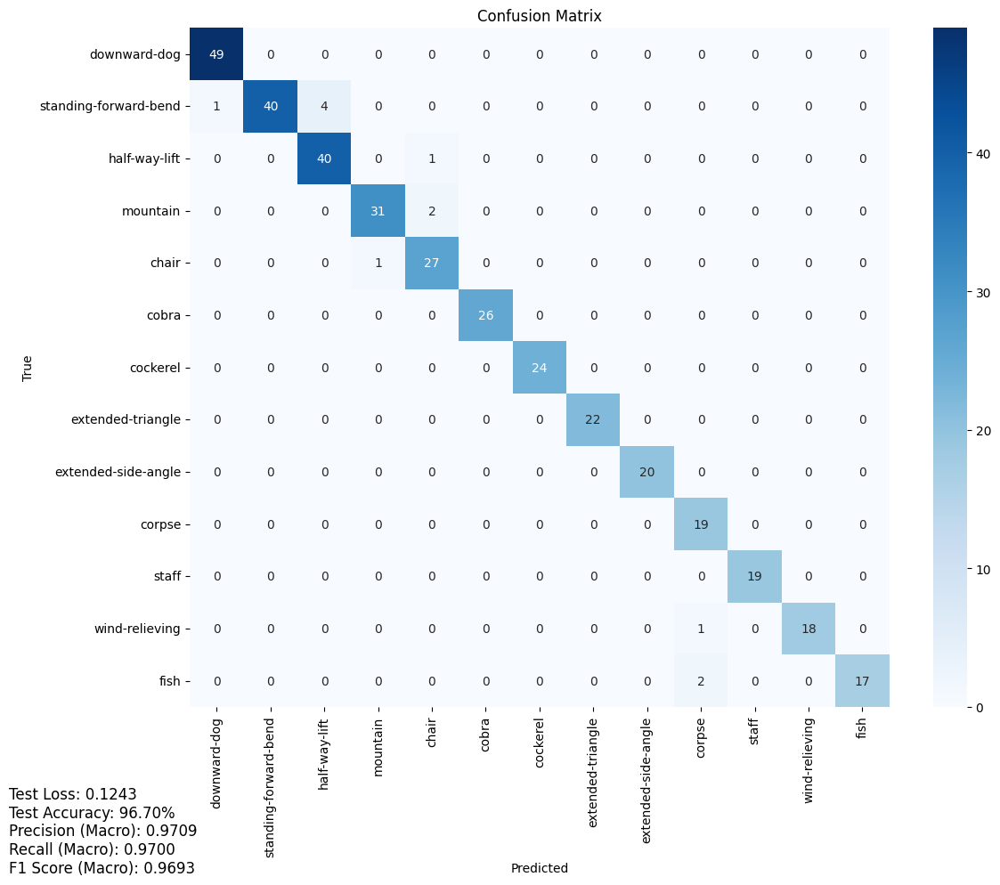

Test Loss: 0.1243
Test Accuracy: 96.70%
Precision (Macro): 0.9709
Recall (Macro): 0.9700
F1 Score (Macro): 0.9693


Testing: 100%|██████████| 23/23 [00:00<00:00, 39.73it/s]


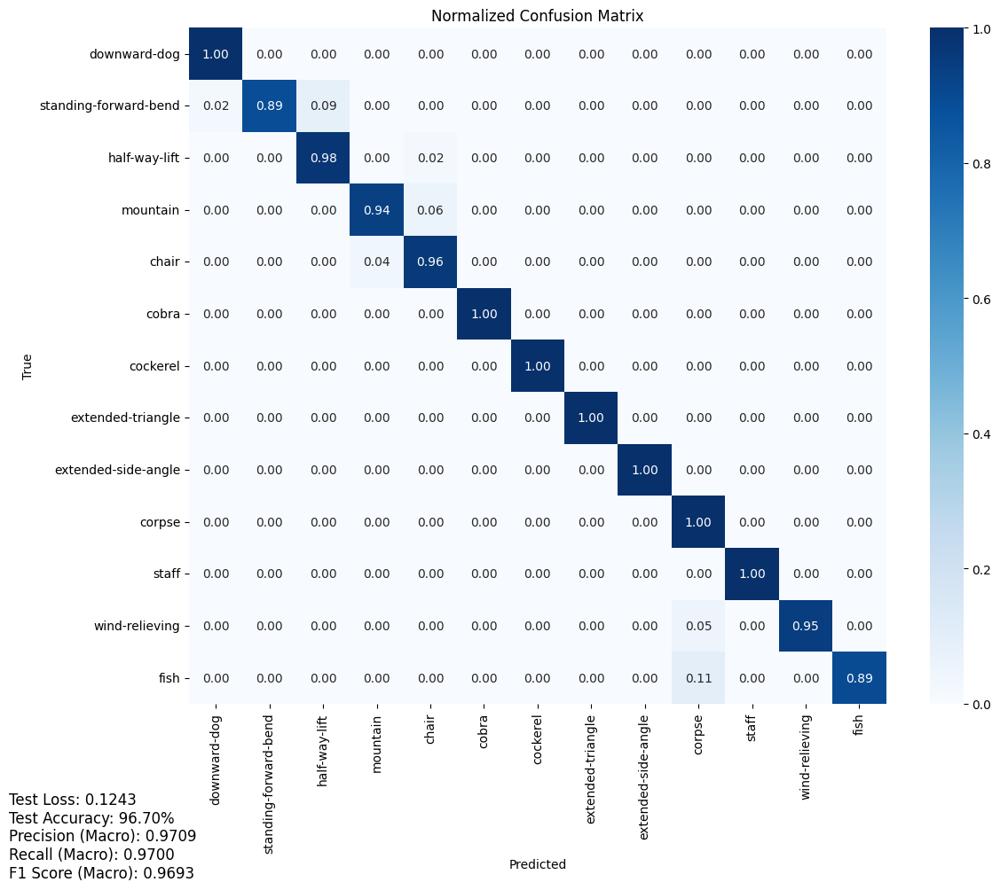

Test Loss: 0.1243
Test Accuracy: 96.70%
Precision (Macro): 0.9709
Recall (Macro): 0.9700
F1 Score (Macro): 0.9693
Saved checkpoint for fold 3
Fold 4/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 176 samples (13.45%)
Class 1: 162 samples (12.38%)
Class 2: 150 samples (11.46%)
Class 3: 119 samples (9.09%)
Class 4: 101 samples (7.72%)
Class 5: 93 samples (7.10%)
Class 6: 86 samples (6.57%)
Class 7: 78 samples (5.96%)
Class 8: 73 samples (5.58%)
Class 9: 68 samples (5.19%)
Class 10: 68 samples (5.19%)
Class 11: 68 samples (5.19%)
Class 12: 67 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 176
Minimum class size: 67
Average class size: 100.69
Class weights aligned with indices: tensor([0.5124, 0.5563, 0.6005, 0.7557, 0.8896, 0.9657, 1.0440, 1.1506, 1.2291,
        1.3191, 1.3191, 1.3191, 1.3388])
Cached criterion for fold 3
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.60it/s, loss=1.59, accuracy=50.8]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.67, Recall=0.59, F1-Score=0.63
standing-forward-bend: Precision=0.61, Recall=0.52, F1-Score=0.56
half-way-lift: Precision=0.74, Recall=0.77, F1-Score=0.75
mountain: Precision=0.56, Recall=0.70, F1-Score=0.62
chair: Precision=0.54, Recall=0.40, F1-Score=0.46
cobra: Precision=0.50, Recall=0.48, F1-Score=0.49
cockerel: Precision=0.41, Recall=0.40, F1-Score=0.40
extended-triangle: Precision=0.25, Recall=0.26, F1-Score=0.25
extended-side-angle: Precision=0.35, Recall=0.34, F1-Score=0.34
corpse: Precision=0.23, Recall=0.25, F1-Score=0.24
staff: Precision=0.40, Recall=0.60, F1-Score=0.48
wind-relieving: Precision=0.56, Recall=0.50, F1-Score=0.53
fish: Precision=0.30, Recall=0.33, F1-Score=0.31


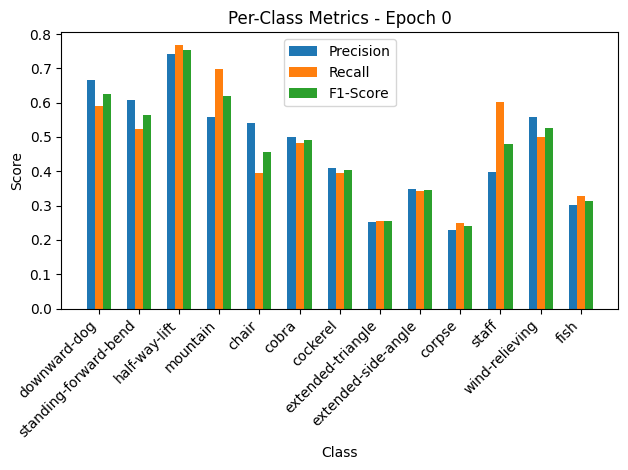

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.76it/s, loss=1.15, accuracy=58.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=1.00, Recall=0.30, F1-Score=0.46
standing-forward-bend: Precision=1.00, Recall=0.50, F1-Score=0.67
half-way-lift: Precision=0.65, Recall=1.00, F1-Score=0.79
mountain: Precision=0.82, Recall=0.69, F1-Score=0.75
chair: Precision=0.38, Recall=0.82, F1-Score=0.51
cobra: Precision=0.69, Recall=0.90, F1-Score=0.78
cockerel: Precision=1.00, Recall=0.30, F1-Score=0.46
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.28, Recall=1.00, F1-Score=0.43
corpse: Precision=0.44, Recall=0.50, F1-Score=0.47
staff: Precision=0.64, Recall=1.00, F1-Score=0.78
wind-relieving: Precision=1.00, Recall=0.62, F1-Score=0.77
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


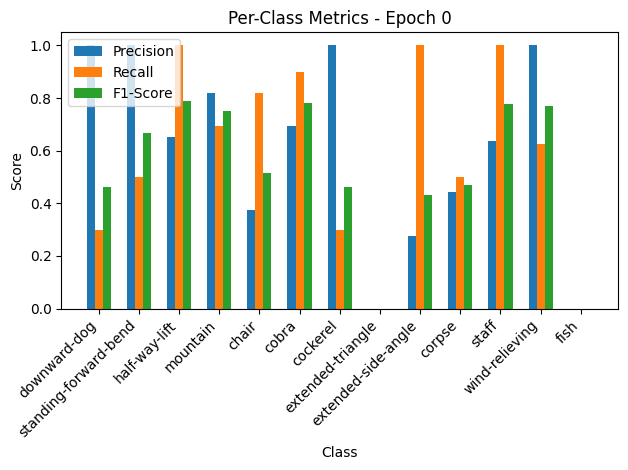


Epoch 1/50 Summary:
Train Loss: 1.5929 | Train Acc: 50.80% | Train Precision: 0.47 | Train Recall: 0.47 | Train F1: 0.47
Val Loss: 1.2587 | Val Acc: 58.90% | Val Precision: 0.61 | Val Recall: 0.59 | Val F1: 0.53
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.2587

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.75it/s, loss=0.841, accuracy=73.7]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.88, Recall=0.81, F1-Score=0.85
standing-forward-bend: Precision=0.87, Recall=0.72, F1-Score=0.79
half-way-lift: Precision=0.78, Recall=0.89, F1-Score=0.83
mountain: Precision=0.76, Recall=0.77, F1-Score=0.77
chair: Precision=0.67, Recall=0.68, F1-Score=0.68
cobra: Precision=0.79, Recall=0.86, F1-Score=0.82
cockerel: Precision=0.77, Recall=0.81, F1-Score=0.79
extended-triangle: Precision=0.61, Recall=0.56, F1-Score=0.59
extended-side-angle: Precision=0.49, Recall=0.51, F1-Score=0.50
corpse: Precision=0.49, Recall=0.50, F1-Score=0.50
staff: Precision=0.74, Recall=0.81, F1-Score=0.77
wind-relieving: Precision=0.84, Recall=0.78, F1-Score=0.81
fish: Precision=0.51, Recall=0.55, F1-Score=0.53


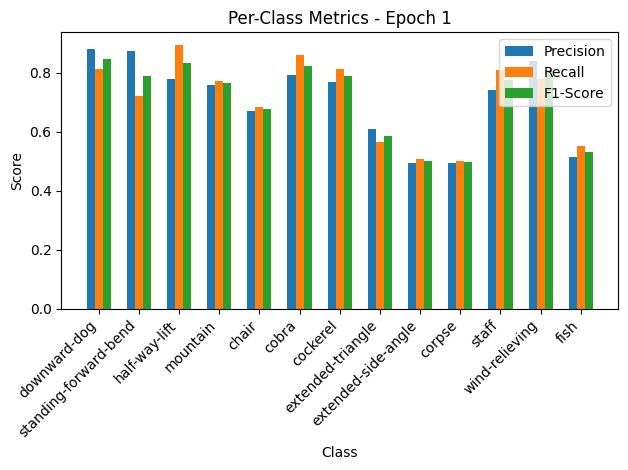

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.61it/s, loss=0.59, accuracy=75.3]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=1.00, Recall=0.90, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=0.50, F1-Score=0.67
extended-triangle: Precision=0.75, Recall=0.33, F1-Score=0.46
extended-side-angle: Precision=0.50, Recall=0.88, F1-Score=0.64
corpse: Precision=0.40, Recall=0.75, F1-Score=0.52
staff: Precision=0.44, Recall=1.00, F1-Score=0.61
wind-relieving: Precision=1.00, Recall=0.62, F1-Score=0.77
fish: Precision=1.00, Recall=0.14, F1-Score=0.25


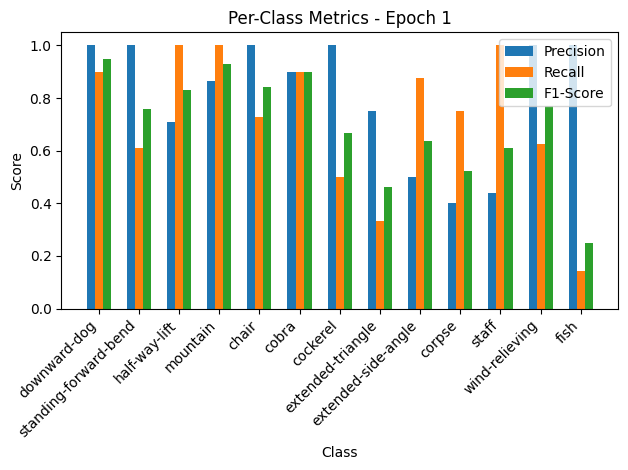


Epoch 2/50 Summary:
Train Loss: 0.8425 | Train Acc: 73.72% | Train Precision: 0.71 | Train Recall: 0.71 | Train F1: 0.71
Val Loss: 0.6464 | Val Acc: 75.34% | Val Precision: 0.81 | Val Recall: 0.72 | Val F1: 0.70
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.6464

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.14it/s, loss=0.673, accuracy=77.2]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.87, Recall=0.81, F1-Score=0.84
standing-forward-bend: Precision=0.84, Recall=0.75, F1-Score=0.79
half-way-lift: Precision=0.79, Recall=0.85, F1-Score=0.82
mountain: Precision=0.80, Recall=0.79, F1-Score=0.79
chair: Precision=0.75, Recall=0.82, F1-Score=0.78
cobra: Precision=0.83, Recall=0.88, F1-Score=0.85
cockerel: Precision=0.80, Recall=0.80, F1-Score=0.80
extended-triangle: Precision=0.65, Recall=0.63, F1-Score=0.64
extended-side-angle: Precision=0.69, Recall=0.64, F1-Score=0.67
corpse: Precision=0.56, Recall=0.51, F1-Score=0.53
staff: Precision=0.78, Recall=0.90, F1-Score=0.84
wind-relieving: Precision=0.82, Recall=0.90, F1-Score=0.86
fish: Precision=0.56, Recall=0.55, F1-Score=0.56


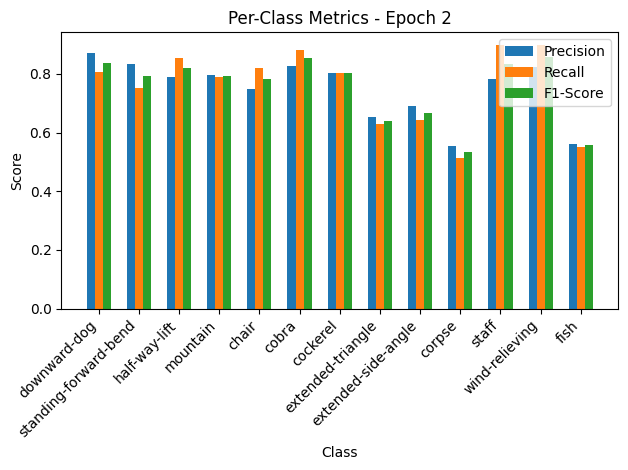

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.28it/s, loss=0.702, accuracy=77.4]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.79, Recall=0.95, F1-Score=0.86
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=0.92, Recall=0.85, F1-Score=0.88
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.82, Recall=0.90, F1-Score=0.86
cockerel: Precision=0.64, Recall=0.90, F1-Score=0.75
extended-triangle: Precision=0.00, Recall=0.00, F1-Score=0.00
extended-side-angle: Precision=0.55, Recall=0.75, F1-Score=0.63
corpse: Precision=0.71, Recall=0.62, F1-Score=0.67
staff: Precision=1.00, Recall=0.57, F1-Score=0.73
wind-relieving: Precision=0.88, Recall=0.88, F1-Score=0.88
fish: Precision=0.62, Recall=0.71, F1-Score=0.67


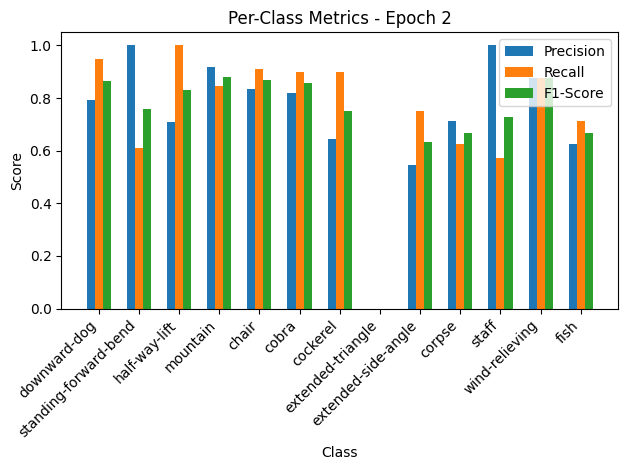


Epoch 3/50 Summary:
Train Loss: 0.6748 | Train Acc: 77.16% | Train Precision: 0.75 | Train Recall: 0.76 | Train F1: 0.75
Val Loss: 0.7695 | Val Acc: 77.40% | Val Precision: 0.73 | Val Recall: 0.74 | Val F1: 0.72

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.40it/s, loss=0.606, accuracy=80.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.80, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.89, F1-Score=0.86
mountain: Precision=0.82, Recall=0.82, F1-Score=0.82
chair: Precision=0.77, Recall=0.79, F1-Score=0.78
cobra: Precision=0.85, Recall=0.94, F1-Score=0.89
cockerel: Precision=0.85, Recall=0.88, F1-Score=0.87
extended-triangle: Precision=0.62, Recall=0.62, F1-Score=0.62
extended-side-angle: Precision=0.64, Recall=0.56, F1-Score=0.60
corpse: Precision=0.58, Recall=0.50, F1-Score=0.54
staff: Precision=0.85, Recall=0.90, F1-Score=0.87
wind-relieving: Precision=0.90, Recall=0.93, F1-Score=0.91
fish: Precision=0.55, Recall=0.60, F1-Score=0.57


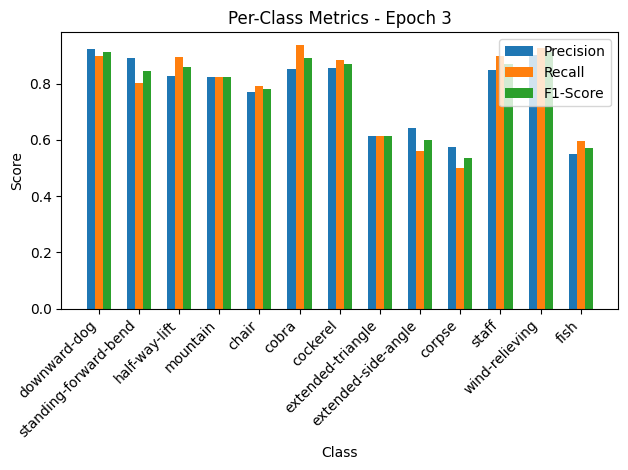

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.61it/s, loss=0.526, accuracy=82.2]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.87, Recall=1.00, F1-Score=0.93
standing-forward-bend: Precision=0.92, Recall=0.61, F1-Score=0.73
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.22, F1-Score=0.36
extended-side-angle: Precision=0.58, Recall=0.88, F1-Score=0.70
corpse: Precision=0.55, Recall=0.75, F1-Score=0.63
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=0.62, F1-Score=0.77
fish: Precision=0.80, Recall=0.57, F1-Score=0.67


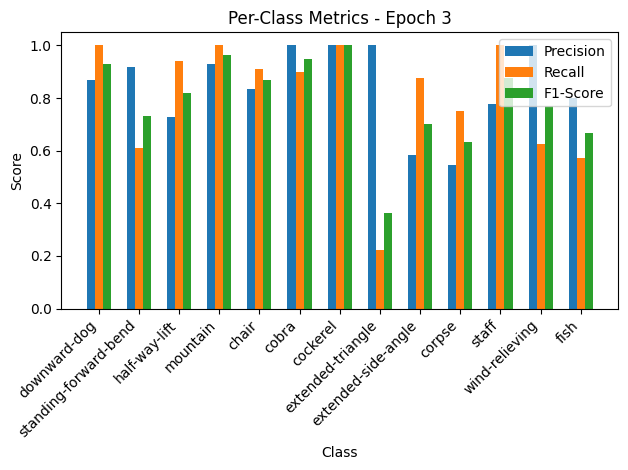


Epoch 4/50 Summary:
Train Loss: 0.6074 | Train Acc: 80.21% | Train Precision: 0.77 | Train Recall: 0.78 | Train F1: 0.78
Val Loss: 0.5760 | Val Acc: 82.19% | Val Precision: 0.84 | Val Recall: 0.80 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 4
New best model saved! Validation Loss: 0.5760

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.10it/s, loss=0.536, accuracy=82.1]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.94
standing-forward-bend: Precision=0.87, Recall=0.80, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.87, F1-Score=0.84
mountain: Precision=0.80, Recall=0.82, F1-Score=0.81
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.95, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.93, Recall=0.90, F1-Score=0.91
extended-triangle: Precision=0.68, Recall=0.67, F1-Score=0.67
extended-side-angle: Precision=0.58, Recall=0.66, F1-Score=0.62
corpse: Precision=0.63, Recall=0.63, F1-Score=0.63
staff: Precision=0.86, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.87, Recall=0.88, F1-Score=0.88
fish: Precision=0.66, Recall=0.63, F1-Score=0.64


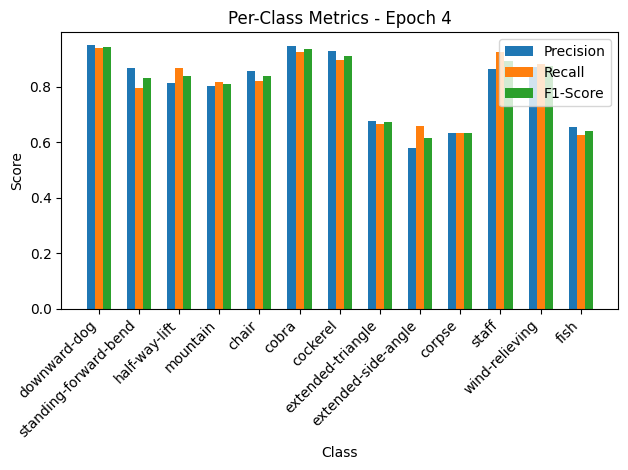

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.27it/s, loss=0.548, accuracy=80.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 4:
downward-dog: Precision=1.00, Recall=0.75, F1-Score=0.86
standing-forward-bend: Precision=1.00, Recall=0.56, F1-Score=0.71
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.59, Recall=1.00, F1-Score=0.74
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=0.75, Recall=1.00, F1-Score=0.86
extended-side-angle: Precision=1.00, Recall=0.62, F1-Score=0.77
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.70, Recall=1.00, F1-Score=0.82
wind-relieving: Precision=1.00, Recall=0.88, F1-Score=0.93
fish: Precision=0.54, Recall=1.00, F1-Score=0.70


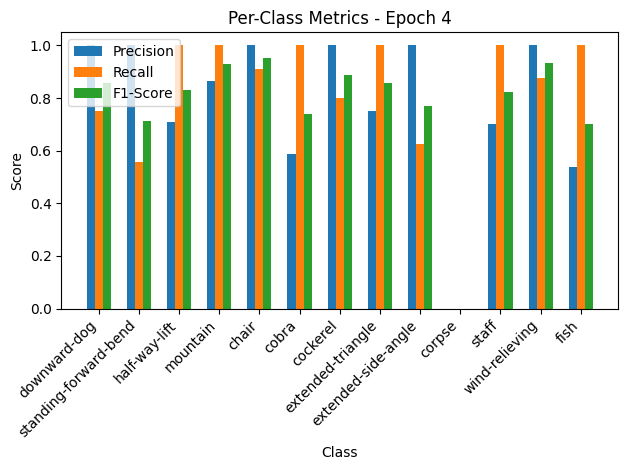


Epoch 5/50 Summary:
Train Loss: 0.5371 | Train Acc: 82.12% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.6005 | Val Acc: 80.82% | Val Precision: 0.78 | Val Recall: 0.81 | Val F1: 0.77

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.90it/s, loss=0.561, accuracy=80.9]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.79, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.95, F1-Score=0.87
mountain: Precision=0.83, Recall=0.88, F1-Score=0.85
chair: Precision=0.89, Recall=0.79, F1-Score=0.84
cobra: Precision=0.87, Recall=0.92, F1-Score=0.90
cockerel: Precision=0.83, Recall=0.78, F1-Score=0.80
extended-triangle: Precision=0.67, Recall=0.71, F1-Score=0.69
extended-side-angle: Precision=0.67, Recall=0.62, F1-Score=0.64
corpse: Precision=0.47, Recall=0.41, F1-Score=0.44
staff: Precision=0.91, Recall=0.90, F1-Score=0.90
wind-relieving: Precision=0.86, Recall=0.91, F1-Score=0.89
fish: Precision=0.53, Recall=0.60, F1-Score=0.56


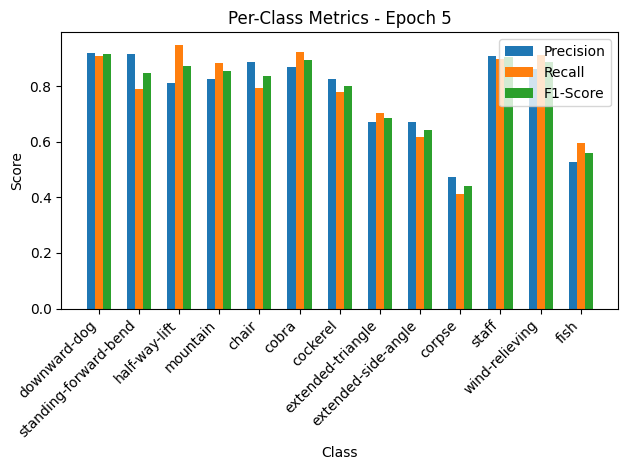

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.35it/s, loss=0.428, accuracy=84.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 5:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.80, F1-Score=0.89
extended-triangle: Precision=0.86, Recall=0.67, F1-Score=0.75
extended-side-angle: Precision=0.78, Recall=0.88, F1-Score=0.82
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=0.64, Recall=1.00, F1-Score=0.78
wind-relieving: Precision=1.00, Recall=0.88, F1-Score=0.93
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


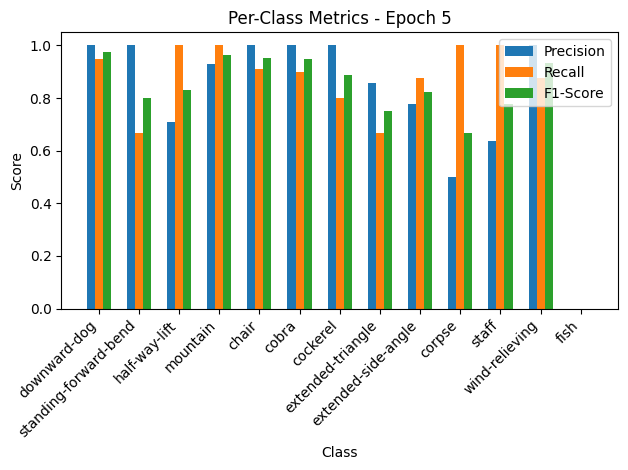


Epoch 6/50 Summary:
Train Loss: 0.5620 | Train Acc: 80.90% | Train Precision: 0.78 | Train Recall: 0.78 | Train F1: 0.78
Val Loss: 0.4692 | Val Acc: 84.25% | Val Precision: 0.80 | Val Recall: 0.82 | Val F1: 0.79
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.4692

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.61it/s, loss=0.506, accuracy=83]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.91, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.81, Recall=0.89, F1-Score=0.85
mountain: Precision=0.88, Recall=0.87, F1-Score=0.87
chair: Precision=0.82, Recall=0.90, F1-Score=0.86
cobra: Precision=0.91, Recall=0.92, F1-Score=0.91
cockerel: Precision=0.91, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=0.69, Recall=0.64, F1-Score=0.67
extended-side-angle: Precision=0.63, Recall=0.68, F1-Score=0.66
corpse: Precision=0.60, Recall=0.59, F1-Score=0.59
staff: Precision=0.91, Recall=0.91, F1-Score=0.91
wind-relieving: Precision=0.96, Recall=0.94, F1-Score=0.95
fish: Precision=0.62, Recall=0.64, F1-Score=0.63


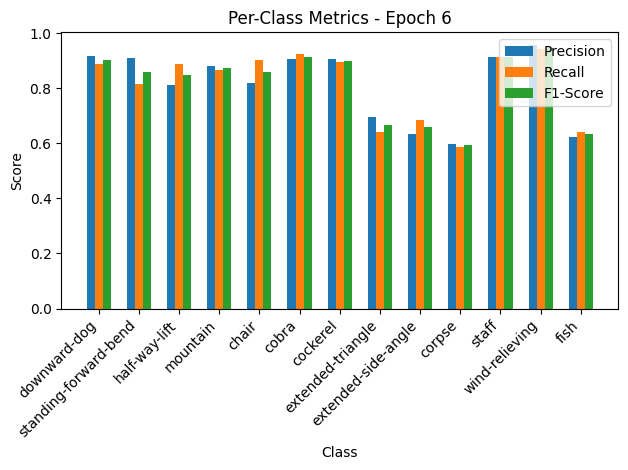

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.95it/s, loss=0.423, accuracy=84.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=0.69, F1-Score=0.82
chair: Precision=0.73, Recall=1.00, F1-Score=0.85
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.60, Recall=1.00, F1-Score=0.75
extended-side-angle: Precision=0.00, Recall=0.00, F1-Score=0.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.88, F1-Score=0.93
fish: Precision=0.64, Recall=1.00, F1-Score=0.78


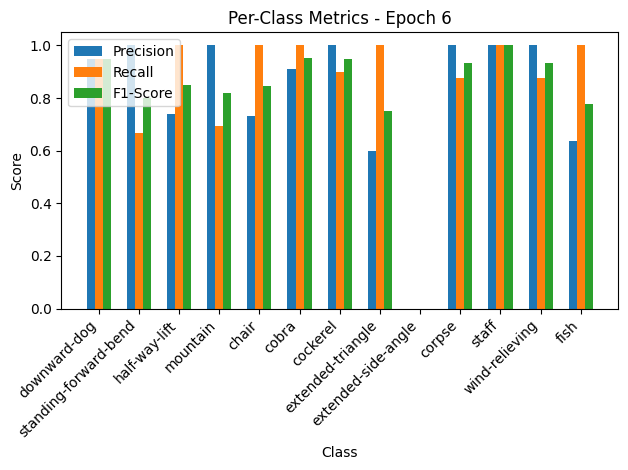


Epoch 7/50 Summary:
Train Loss: 0.5074 | Train Acc: 83.04% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.4636 | Val Acc: 84.93% | Val Precision: 0.81 | Val Recall: 0.84 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.4636

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.503, accuracy=83.8]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.95, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.94, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.87, Recall=0.95, F1-Score=0.91
chair: Precision=0.92, Recall=0.87, F1-Score=0.89
cobra: Precision=0.89, Recall=0.98, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.91, F1-Score=0.90
extended-triangle: Precision=0.68, Recall=0.68, F1-Score=0.68
extended-side-angle: Precision=0.63, Recall=0.62, F1-Score=0.62
corpse: Precision=0.60, Recall=0.68, F1-Score=0.63
staff: Precision=0.86, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.90, Recall=0.93, F1-Score=0.91
fish: Precision=0.61, Recall=0.45, F1-Score=0.52


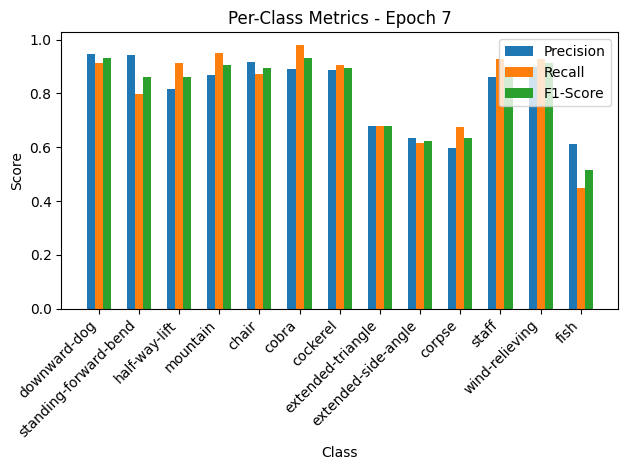

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.67it/s, loss=0.441, accuracy=87.7]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.92, Recall=0.67, F1-Score=0.77
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=0.77, F1-Score=0.87
chair: Precision=0.79, Recall=1.00, F1-Score=0.88
cobra: Precision=0.82, Recall=0.90, F1-Score=0.86
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.78, Recall=0.88, F1-Score=0.82
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.89, Recall=1.00, F1-Score=0.94
fish: Precision=0.86, Recall=0.86, F1-Score=0.86


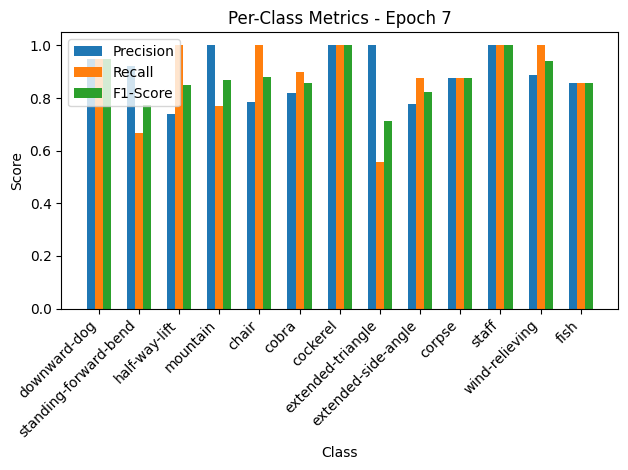


Epoch 8/50 Summary:
Train Loss: 0.5045 | Train Acc: 83.80% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.4835 | Val Acc: 87.67% | Val Precision: 0.89 | Val Recall: 0.88 | Val F1: 0.88

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.69it/s, loss=0.502, accuracy=83.6]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.92, Recall=0.90, F1-Score=0.91
standing-forward-bend: Precision=0.91, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.86, Recall=0.86, F1-Score=0.86
chair: Precision=0.78, Recall=0.84, F1-Score=0.81
cobra: Precision=0.94, Recall=0.96, F1-Score=0.95
cockerel: Precision=0.92, Recall=0.97, F1-Score=0.94
extended-triangle: Precision=0.74, Recall=0.72, F1-Score=0.73
extended-side-angle: Precision=0.72, Recall=0.71, F1-Score=0.72
corpse: Precision=0.60, Recall=0.51, F1-Score=0.56
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.93, Recall=0.91, F1-Score=0.92
fish: Precision=0.58, Recall=0.67, F1-Score=0.62


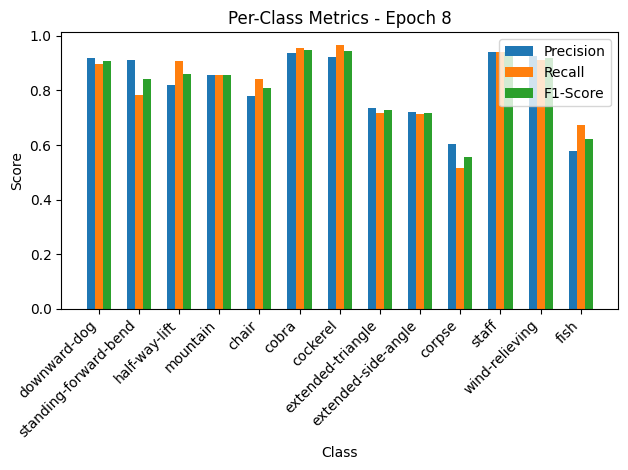

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.14it/s, loss=0.523, accuracy=77.4]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=1.00, Recall=0.90, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.22, F1-Score=0.36
half-way-lift: Precision=0.63, Recall=1.00, F1-Score=0.77
mountain: Precision=0.53, Recall=0.77, F1-Score=0.62
chair: Precision=0.83, Recall=0.91, F1-Score=0.87
cobra: Precision=0.82, Recall=0.90, F1-Score=0.86
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.83, Recall=0.56, F1-Score=0.67
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.89, Recall=1.00, F1-Score=0.94
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


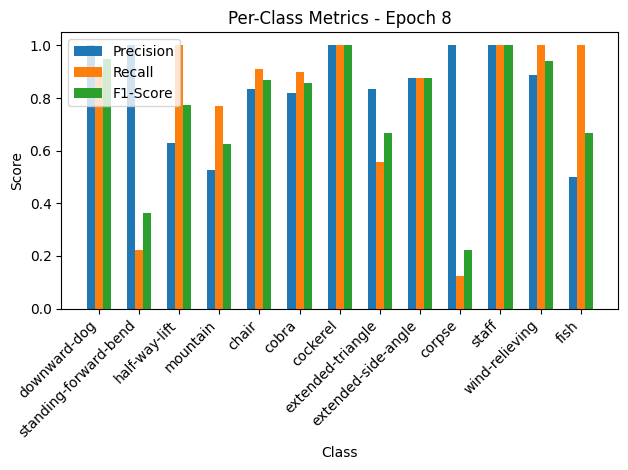


Epoch 9/50 Summary:
Train Loss: 0.5031 | Train Acc: 83.58% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5730 | Val Acc: 77.40% | Val Precision: 0.84 | Val Recall: 0.79 | Val F1: 0.75

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.98it/s, loss=0.496, accuracy=84.4]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.95, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.91, Recall=0.83, F1-Score=0.87
half-way-lift: Precision=0.82, Recall=0.95, F1-Score=0.88
mountain: Precision=0.87, Recall=0.86, F1-Score=0.86
chair: Precision=0.86, Recall=0.82, F1-Score=0.84
cobra: Precision=0.92, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.95, Recall=0.90, F1-Score=0.92
extended-triangle: Precision=0.78, Recall=0.67, F1-Score=0.72
extended-side-angle: Precision=0.70, Recall=0.78, F1-Score=0.74
corpse: Precision=0.57, Recall=0.53, F1-Score=0.55
staff: Precision=0.89, Recall=0.97, F1-Score=0.93
wind-relieving: Precision=0.90, Recall=0.96, F1-Score=0.93
fish: Precision=0.58, Recall=0.60, F1-Score=0.59


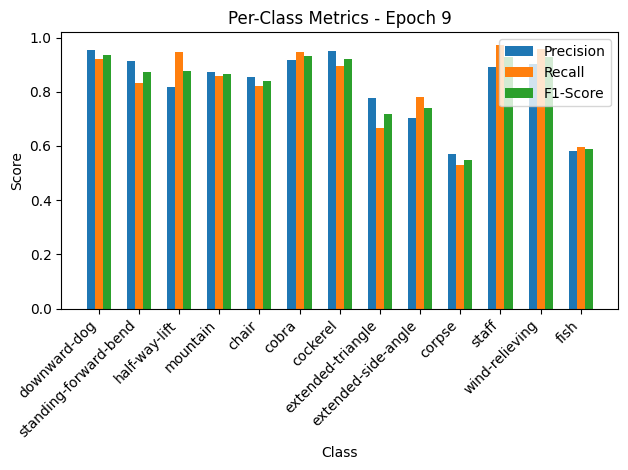

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.74it/s, loss=0.354, accuracy=83.6]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=1.00, Recall=0.85, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.65, Recall=1.00, F1-Score=0.79
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.64, F1-Score=0.78
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.67, F1-Score=0.80
extended-side-angle: Precision=0.73, Recall=1.00, F1-Score=0.84
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.14, F1-Score=0.25


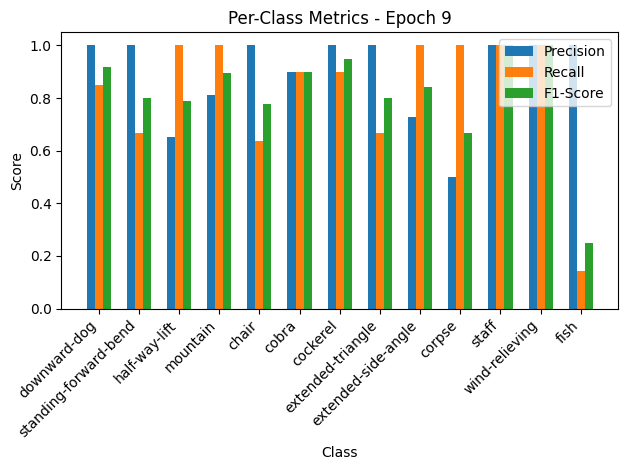


Epoch 10/50 Summary:
Train Loss: 0.4975 | Train Acc: 84.42% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.3878 | Val Acc: 83.56% | Val Precision: 0.89 | Val Recall: 0.83 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 10
New best model saved! Validation Loss: 0.3878

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.70it/s, loss=0.499, accuracy=85.2]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.93, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.80, F1-Score=0.86
half-way-lift: Precision=0.82, Recall=0.91, F1-Score=0.86
mountain: Precision=0.83, Recall=0.93, F1-Score=0.88
chair: Precision=0.89, Recall=0.84, F1-Score=0.87
cobra: Precision=0.93, Recall=0.98, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.84, F1-Score=0.85
extended-triangle: Precision=0.78, Recall=0.82, F1-Score=0.80
extended-side-angle: Precision=0.78, Recall=0.74, F1-Score=0.76
corpse: Precision=0.62, Recall=0.65, F1-Score=0.63
staff: Precision=0.93, Recall=0.97, F1-Score=0.95
wind-relieving: Precision=0.92, Recall=0.96, F1-Score=0.94
fish: Precision=0.64, Recall=0.57, F1-Score=0.60


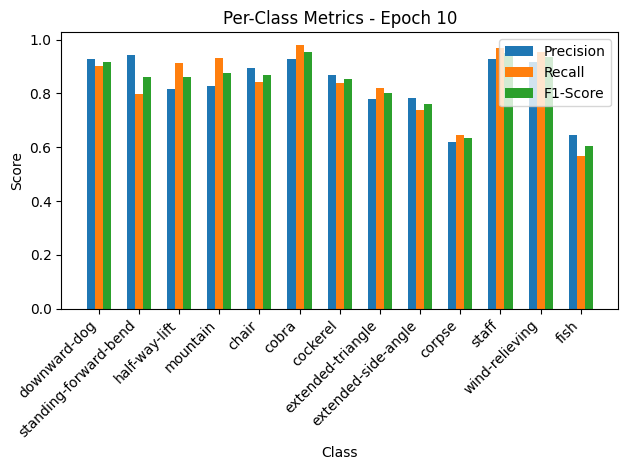

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.87it/s, loss=0.348, accuracy=86.3]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.81, Recall=1.00, F1-Score=0.89
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.64, Recall=1.00, F1-Score=0.78
extended-side-angle: Precision=1.00, Recall=0.38, F1-Score=0.55
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.47, Recall=1.00, F1-Score=0.64


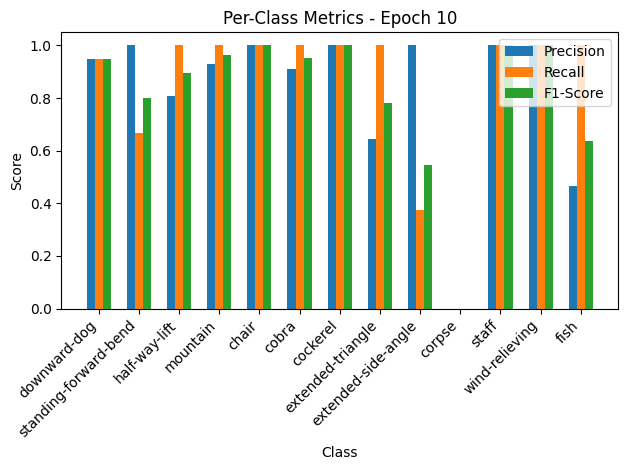


Epoch 11/50 Summary:
Train Loss: 0.5002 | Train Acc: 85.18% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.3816 | Val Acc: 86.30% | Val Precision: 0.82 | Val Recall: 0.85 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 11
New best model saved! Validation Loss: 0.3816

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.70it/s, loss=0.497, accuracy=83.9]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.92, Recall=0.89, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.80, Recall=0.92, F1-Score=0.86
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.90, Recall=0.86, F1-Score=0.88
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.84, Recall=0.88, F1-Score=0.86
extended-triangle: Precision=0.77, Recall=0.79, F1-Score=0.78
extended-side-angle: Precision=0.78, Recall=0.74, F1-Score=0.76
corpse: Precision=0.50, Recall=0.53, F1-Score=0.51
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.91, Recall=0.88, F1-Score=0.90
fish: Precision=0.57, Recall=0.58, F1-Score=0.57


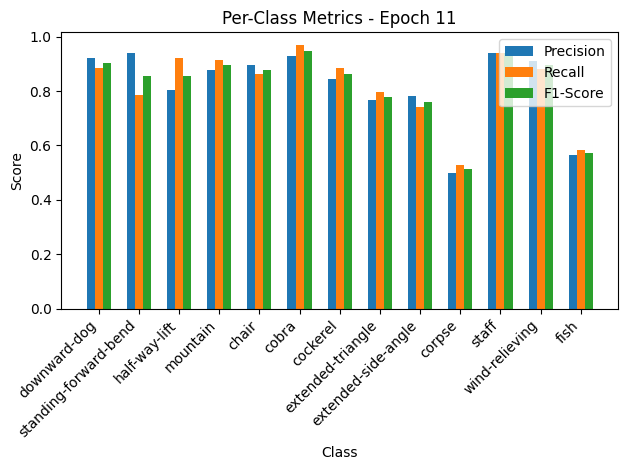

Validation: 100%|██████████| 10/10 [00:00<00:00, 24.61it/s, loss=0.341, accuracy=87]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 11:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.68, Recall=1.00, F1-Score=0.81
mountain: Precision=1.00, Recall=0.85, F1-Score=0.92
chair: Precision=0.92, Recall=1.00, F1-Score=0.96
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.53, Recall=1.00, F1-Score=0.70
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


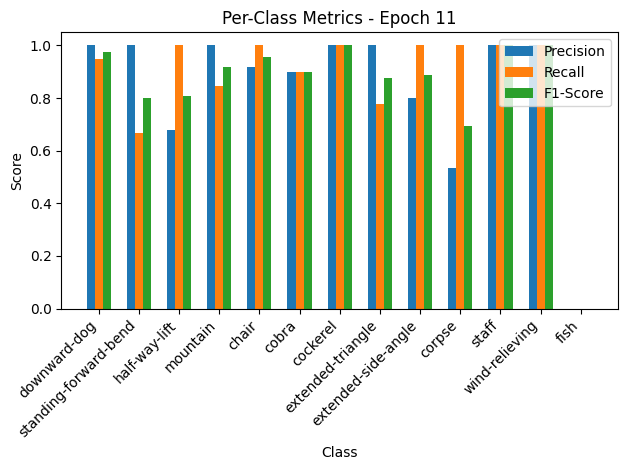


Epoch 12/50 Summary:
Train Loss: 0.4982 | Train Acc: 83.88% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.3742 | Val Acc: 86.99% | Val Precision: 0.83 | Val Recall: 0.86 | Val F1: 0.83
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.3742

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.17it/s, loss=0.521, accuracy=82.7]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.84, Recall=0.75, F1-Score=0.79
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.84, Recall=0.87, F1-Score=0.85
chair: Precision=0.88, Recall=0.83, F1-Score=0.85
cobra: Precision=0.91, Recall=0.98, F1-Score=0.94
cockerel: Precision=0.84, Recall=0.85, F1-Score=0.84
extended-triangle: Precision=0.75, Recall=0.67, F1-Score=0.71
extended-side-angle: Precision=0.69, Recall=0.74, F1-Score=0.72
corpse: Precision=0.63, Recall=0.54, F1-Score=0.58
staff: Precision=0.86, Recall=0.93, F1-Score=0.89
wind-relieving: Precision=0.93, Recall=0.99, F1-Score=0.96
fish: Precision=0.61, Recall=0.69, F1-Score=0.64


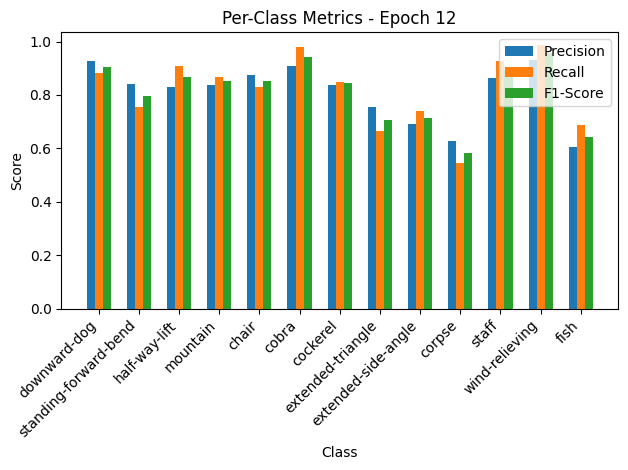

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.68it/s, loss=0.392, accuracy=93.2]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.90, Recall=1.00, F1-Score=0.95
extended-side-angle: Precision=1.00, Recall=0.88, F1-Score=0.93
corpse: Precision=0.67, Recall=1.00, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.88, F1-Score=0.93
fish: Precision=0.80, Recall=0.57, F1-Score=0.67


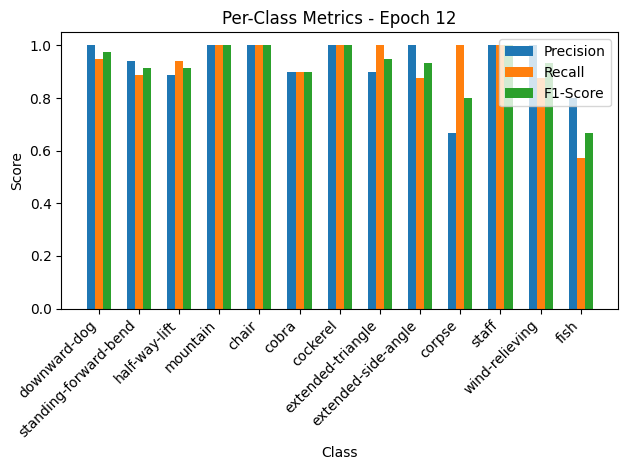


Epoch 13/50 Summary:
Train Loss: 0.5218 | Train Acc: 82.73% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.4297 | Val Acc: 93.15% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.92

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.09it/s, loss=0.516, accuracy=84]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.92, Recall=0.93, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.81, F1-Score=0.86
half-way-lift: Precision=0.84, Recall=0.89, F1-Score=0.86
mountain: Precision=0.85, Recall=0.90, F1-Score=0.87
chair: Precision=0.90, Recall=0.83, F1-Score=0.87
cobra: Precision=0.89, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.85, Recall=0.90, F1-Score=0.87
extended-triangle: Precision=0.80, Recall=0.81, F1-Score=0.80
extended-side-angle: Precision=0.77, Recall=0.79, F1-Score=0.78
corpse: Precision=0.58, Recall=0.56, F1-Score=0.57
staff: Precision=0.81, Recall=0.84, F1-Score=0.83
wind-relieving: Precision=0.98, Recall=0.91, F1-Score=0.95
fish: Precision=0.57, Recall=0.58, F1-Score=0.58


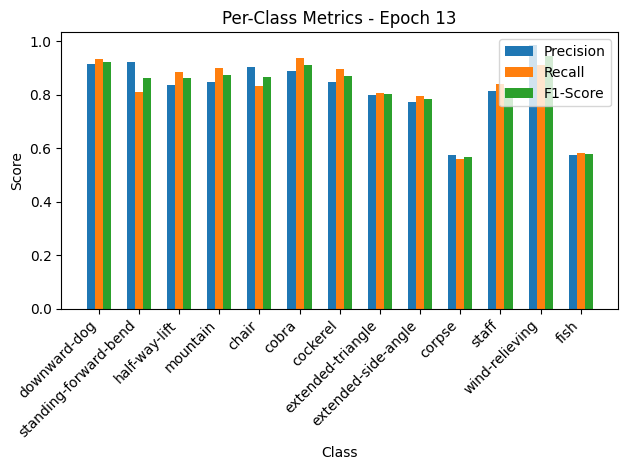

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.87it/s, loss=0.355, accuracy=87.7]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.69, Recall=1.00, F1-Score=0.82
extended-side-angle: Precision=1.00, Recall=0.50, F1-Score=0.67
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=0.89, Recall=1.00, F1-Score=0.94
fish: Precision=0.54, Recall=1.00, F1-Score=0.70


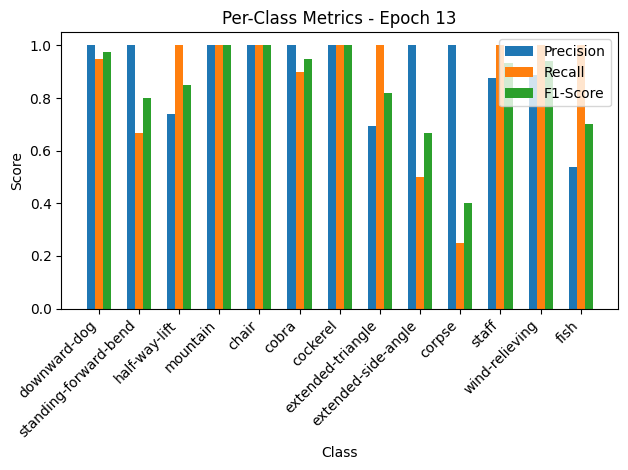


Epoch 14/50 Summary:
Train Loss: 0.5176 | Train Acc: 84.03% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.3887 | Val Acc: 87.67% | Val Precision: 0.90 | Val Recall: 0.87 | Val F1: 0.85

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.38it/s, loss=0.516, accuracy=82.9]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.87, Recall=0.87, F1-Score=0.87
chair: Precision=0.82, Recall=0.83, F1-Score=0.82
cobra: Precision=0.89, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.84, Recall=0.88, F1-Score=0.86
extended-triangle: Precision=0.78, Recall=0.68, F1-Score=0.73
extended-side-angle: Precision=0.70, Recall=0.75, F1-Score=0.72
corpse: Precision=0.56, Recall=0.65, F1-Score=0.60
staff: Precision=0.87, Recall=0.97, F1-Score=0.92
wind-relieving: Precision=0.92, Recall=0.97, F1-Score=0.94
fish: Precision=0.57, Recall=0.45, F1-Score=0.50


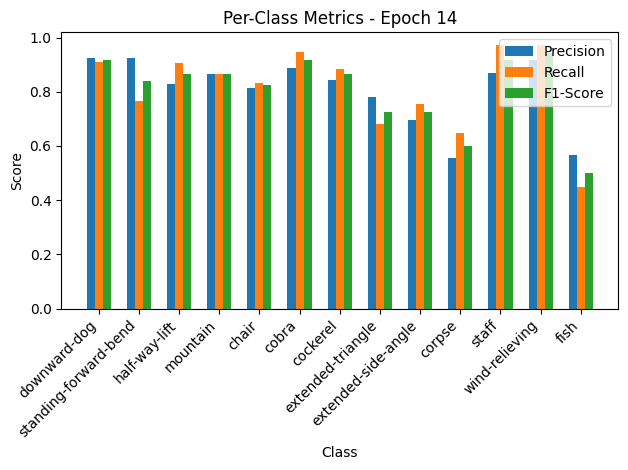

Validation: 100%|██████████| 10/10 [00:00<00:00, 27.23it/s, loss=0.568, accuracy=78.8]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.86, Recall=0.67, F1-Score=0.75
half-way-lift: Precision=0.71, Recall=1.00, F1-Score=0.83
mountain: Precision=1.00, Recall=0.69, F1-Score=0.82
chair: Precision=0.82, Recall=0.82, F1-Score=0.82
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=0.90, Recall=0.90, F1-Score=0.90
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.67, Recall=1.00, F1-Score=0.80
corpse: Precision=0.80, Recall=0.50, F1-Score=0.62
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.00, Recall=0.00, F1-Score=0.00
fish: Precision=0.35, Recall=1.00, F1-Score=0.52


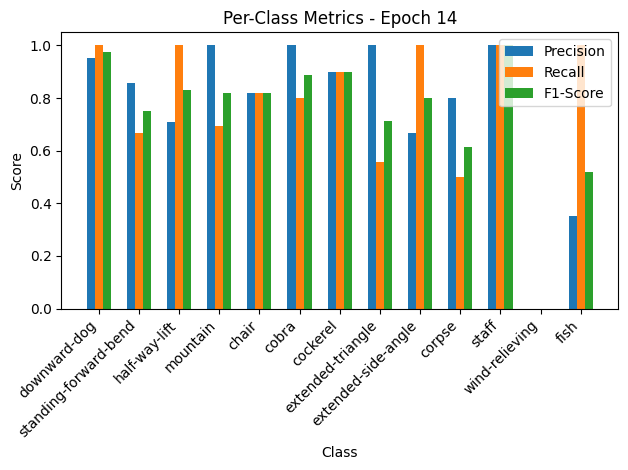


Epoch 15/50 Summary:
Train Loss: 0.5170 | Train Acc: 82.89% | Train Precision: 0.81 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.6229 | Val Acc: 78.77% | Val Precision: 0.77 | Val Recall: 0.76 | Val F1: 0.74

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.52it/s, loss=0.516, accuracy=85.3]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.93, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.95, Recall=0.80, F1-Score=0.87
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.86, Recall=0.93, F1-Score=0.90
chair: Precision=0.87, Recall=0.81, F1-Score=0.84
cobra: Precision=0.89, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.90, Recall=0.87, F1-Score=0.89
extended-triangle: Precision=0.84, Recall=0.83, F1-Score=0.84
extended-side-angle: Precision=0.78, Recall=0.79, F1-Score=0.79
corpse: Precision=0.62, Recall=0.63, F1-Score=0.63
staff: Precision=0.85, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.89, Recall=0.91, F1-Score=0.90
fish: Precision=0.63, Recall=0.55, F1-Score=0.59


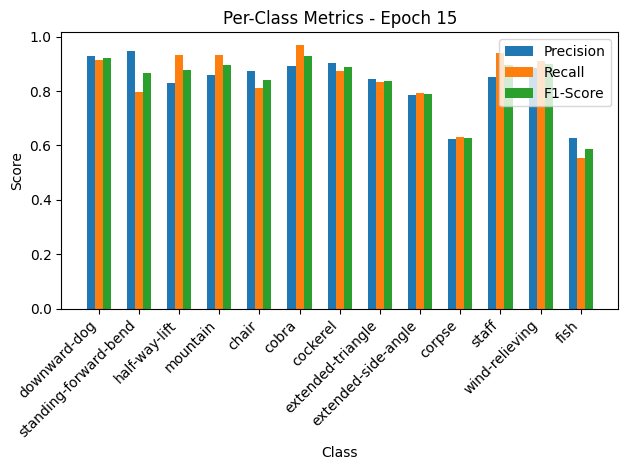

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.86it/s, loss=0.406, accuracy=82.9]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=0.85, F1-Score=0.92
chair: Precision=0.85, Recall=1.00, F1-Score=0.92
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=0.83, Recall=0.56, F1-Score=0.67
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.50, Recall=0.88, F1-Score=0.64
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=0.64, Recall=0.88, F1-Score=0.74
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


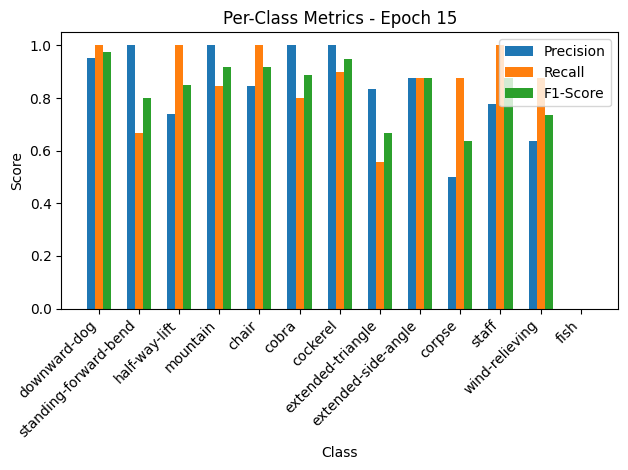


Epoch 16/50 Summary:
Train Loss: 0.5171 | Train Acc: 85.33% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.83
Val Loss: 0.4449 | Val Acc: 82.88% | Val Precision: 0.78 | Val Recall: 0.80 | Val F1: 0.78

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.527, accuracy=84.5]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.95, Recall=0.78, F1-Score=0.86
half-way-lift: Precision=0.79, Recall=0.92, F1-Score=0.85
mountain: Precision=0.85, Recall=0.92, F1-Score=0.88
chair: Precision=0.89, Recall=0.84, F1-Score=0.87
cobra: Precision=0.88, Recall=0.95, F1-Score=0.91
cockerel: Precision=0.87, Recall=0.85, F1-Score=0.86
extended-triangle: Precision=0.79, Recall=0.76, F1-Score=0.77
extended-side-angle: Precision=0.72, Recall=0.79, F1-Score=0.75
corpse: Precision=0.68, Recall=0.65, F1-Score=0.66
staff: Precision=0.93, Recall=0.94, F1-Score=0.93
wind-relieving: Precision=0.93, Recall=0.93, F1-Score=0.93
fish: Precision=0.63, Recall=0.66, F1-Score=0.64


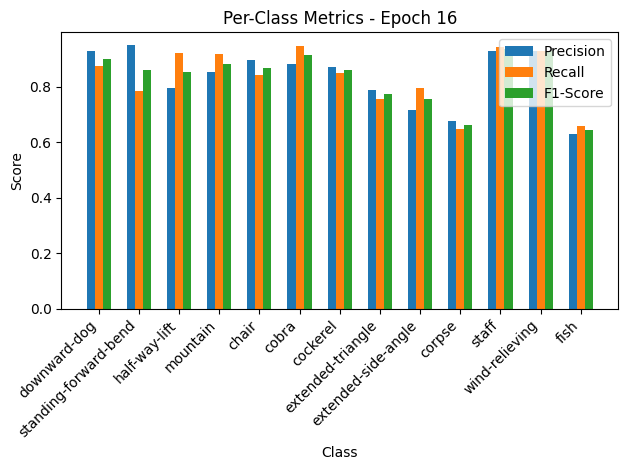

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.35it/s, loss=0.506, accuracy=82.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=0.60, F1-Score=0.75
extended-triangle: Precision=0.53, Recall=1.00, F1-Score=0.69
extended-side-angle: Precision=0.00, Recall=0.00, F1-Score=0.00
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=0.88, F1-Score=0.93
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


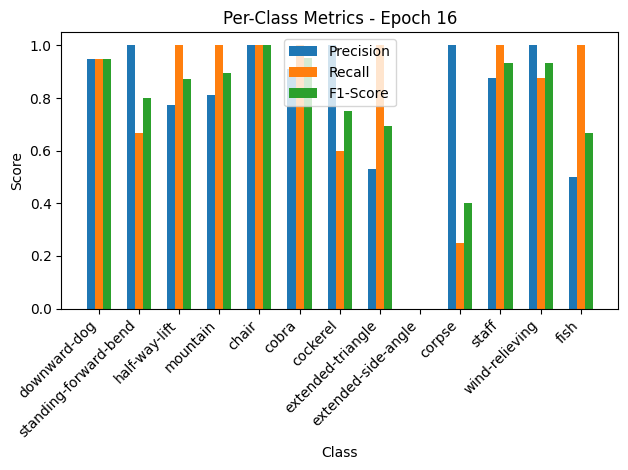


Epoch 17/50 Summary:
Train Loss: 0.5281 | Train Acc: 84.49% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.5548 | Val Acc: 82.19% | Val Precision: 0.80 | Val Recall: 0.80 | Val F1: 0.76

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:11<00:00,  7.43it/s, loss=0.372, accuracy=88.8]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.97, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.84, Recall=0.95, F1-Score=0.89
mountain: Precision=0.89, Recall=0.96, F1-Score=0.92
chair: Precision=0.95, Recall=0.88, F1-Score=0.91
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.79, Recall=0.86, F1-Score=0.82
extended-side-angle: Precision=0.85, Recall=0.75, F1-Score=0.80
corpse: Precision=0.72, Recall=0.49, F1-Score=0.58
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.62, Recall=0.78, F1-Score=0.69


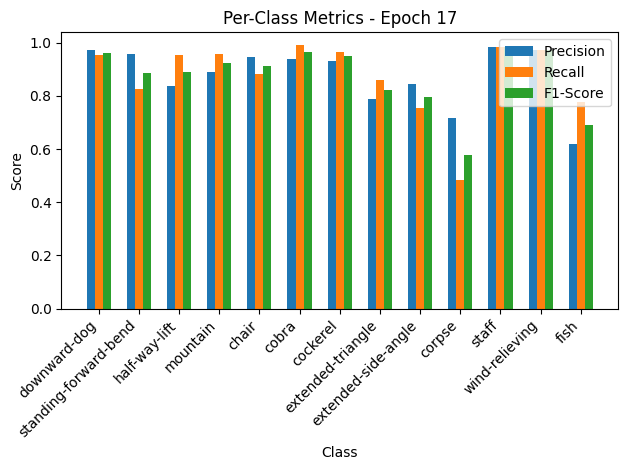

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.96it/s, loss=0.204, accuracy=92.5]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.88, Recall=0.78, F1-Score=0.82
extended-side-angle: Precision=0.78, Recall=0.88, F1-Score=0.82
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


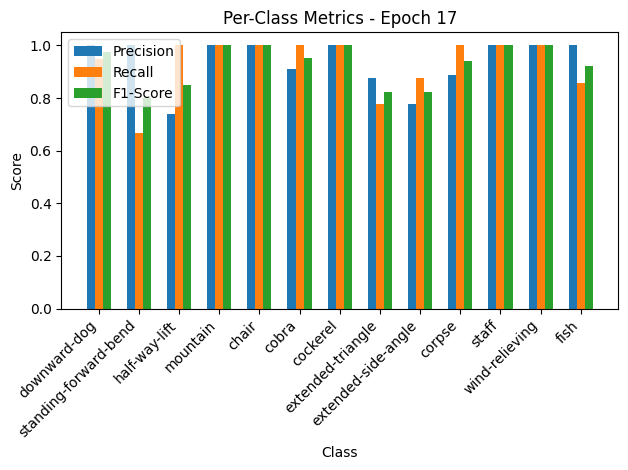


Epoch 18/50 Summary:
Train Loss: 0.3729 | Train Acc: 88.85% | Train Precision: 0.88 | Train Recall: 0.87 | Train F1: 0.87
Val Loss: 0.2236 | Val Acc: 92.47% | Val Precision: 0.94 | Val Recall: 0.93 | Val F1: 0.93
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.2236

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.13it/s, loss=0.316, accuracy=91.1]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.95, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.96, Recall=0.83, F1-Score=0.89
half-way-lift: Precision=0.85, Recall=0.94, F1-Score=0.89
mountain: Precision=0.93, Recall=0.95, F1-Score=0.94
chair: Precision=0.95, Recall=0.91, F1-Score=0.93
cobra: Precision=0.94, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.98, F1-Score=0.96
extended-triangle: Precision=0.91, Recall=0.95, F1-Score=0.93
extended-side-angle: Precision=0.92, Recall=0.92, F1-Score=0.92
corpse: Precision=0.70, Recall=0.78, F1-Score=0.74
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.72, Recall=0.63, F1-Score=0.67


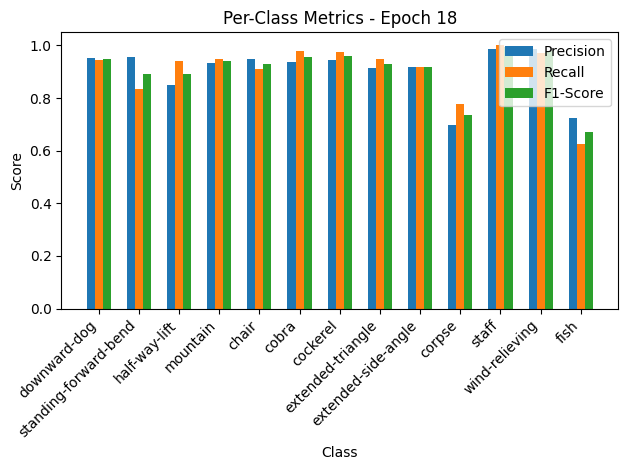

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.99it/s, loss=0.205, accuracy=91.1]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.88, Recall=0.78, F1-Score=0.82
extended-side-angle: Precision=0.78, Recall=0.88, F1-Score=0.82
corpse: Precision=0.73, Recall=1.00, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.57, F1-Score=0.73


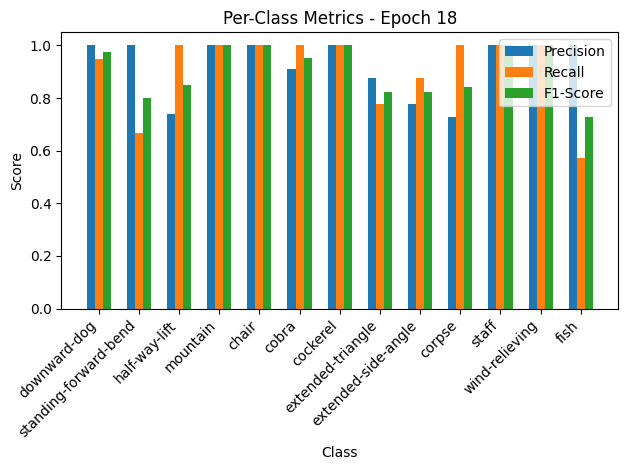


Epoch 19/50 Summary:
Train Loss: 0.3168 | Train Acc: 91.06% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.90
Val Loss: 0.2245 | Val Acc: 91.10% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.91

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.35it/s, loss=0.273, accuracy=92.8]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.86, F1-Score=0.90
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.95, Recall=0.94, F1-Score=0.95
chair: Precision=0.96, Recall=0.94, F1-Score=0.95
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.94, Recall=0.94, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=0.93, F1-Score=0.91
corpse: Precision=0.77, Recall=0.87, F1-Score=0.81
staff: Precision=0.99, Recall=0.97, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.73, F1-Score=0.78


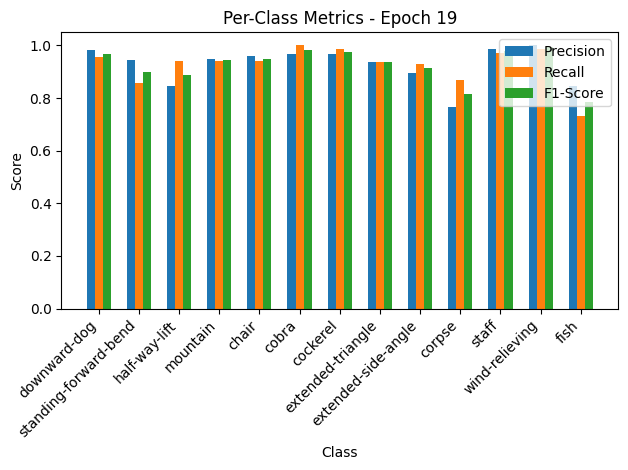

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.36it/s, loss=0.159, accuracy=94.5]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


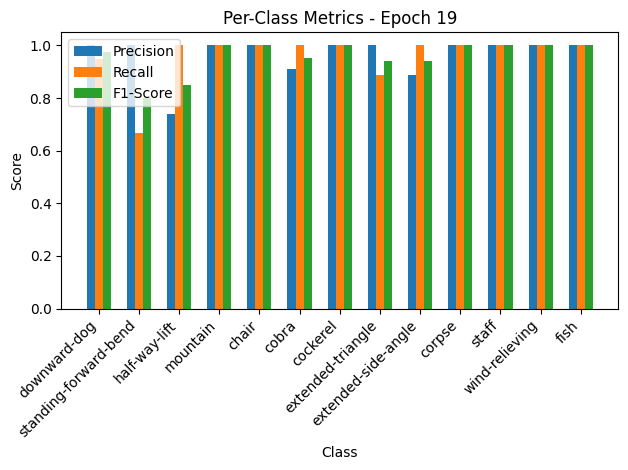


Epoch 20/50 Summary:
Train Loss: 0.2735 | Train Acc: 92.82% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1742 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.1742

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.82it/s, loss=0.257, accuracy=92.7]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.87, F1-Score=0.92
half-way-lift: Precision=0.87, Recall=0.94, F1-Score=0.90
mountain: Precision=0.96, Recall=0.96, F1-Score=0.96
chair: Precision=0.95, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.93, Recall=0.99, F1-Score=0.96
extended-triangle: Precision=0.94, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.93, F1-Score=0.93
corpse: Precision=0.78, Recall=0.72, F1-Score=0.75
staff: Precision=0.98, Recall=0.96, F1-Score=0.97
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.74, Recall=0.76, F1-Score=0.75


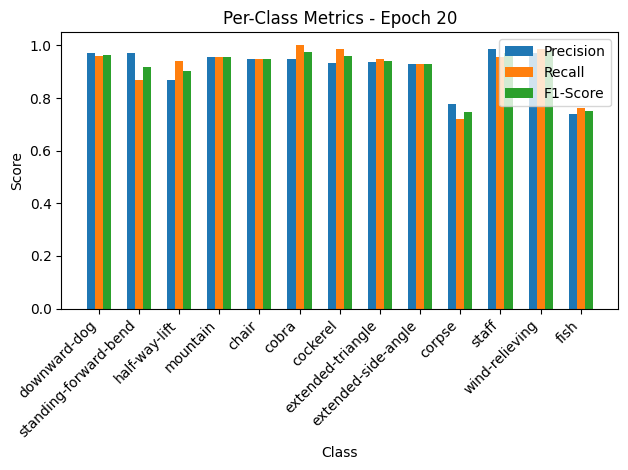

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.40it/s, loss=0.158, accuracy=94.5]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


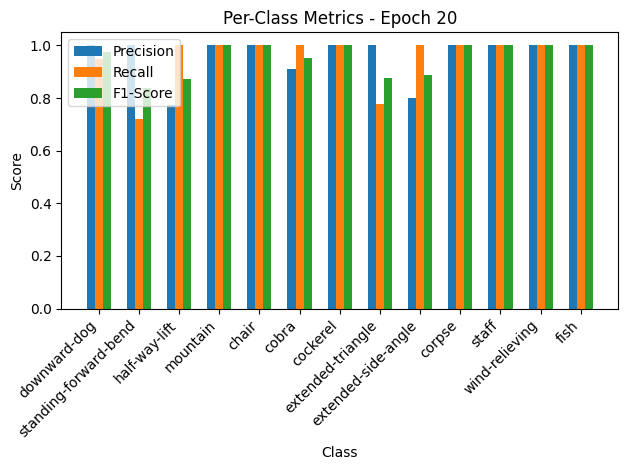


Epoch 21/50 Summary:
Train Loss: 0.2572 | Train Acc: 92.67% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1728 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 21
New best model saved! Validation Loss: 0.1728

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.30it/s, loss=0.267, accuracy=92.3]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.95, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.86, Recall=0.89, F1-Score=0.88
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.93, Recall=0.92, F1-Score=0.93
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.82, Recall=0.82, F1-Score=0.82
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.97, F1-Score=0.98
fish: Precision=0.83, Recall=0.79, F1-Score=0.81


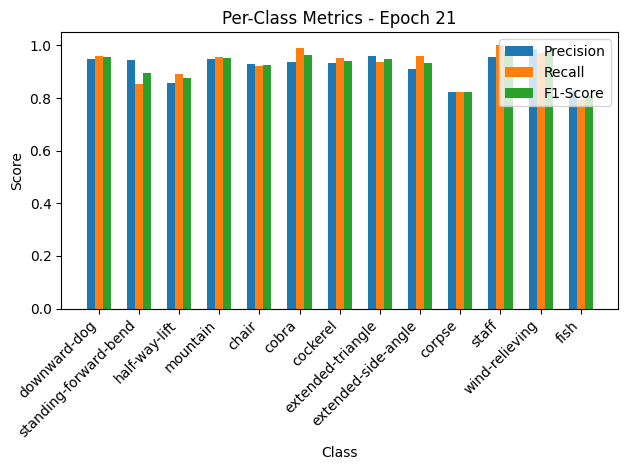

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.68it/s, loss=0.179, accuracy=91.8]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.73, Recall=1.00, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.80, Recall=0.57, F1-Score=0.67


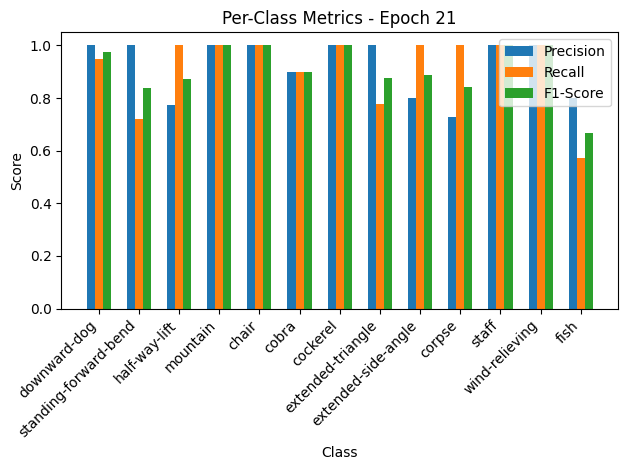


Epoch 22/50 Summary:
Train Loss: 0.2675 | Train Acc: 92.28% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.1963 | Val Acc: 91.78% | Val Precision: 0.92 | Val Recall: 0.92 | Val F1: 0.91

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.98it/s, loss=0.248, accuracy=92.6]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.85, F1-Score=0.89
half-way-lift: Precision=0.85, Recall=0.94, F1-Score=0.90
mountain: Precision=0.94, Recall=0.94, F1-Score=0.94
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.94, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-side-angle: Precision=0.97, Recall=0.96, F1-Score=0.97
corpse: Precision=0.72, Recall=0.82, F1-Score=0.77
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.79, Recall=0.67, F1-Score=0.73


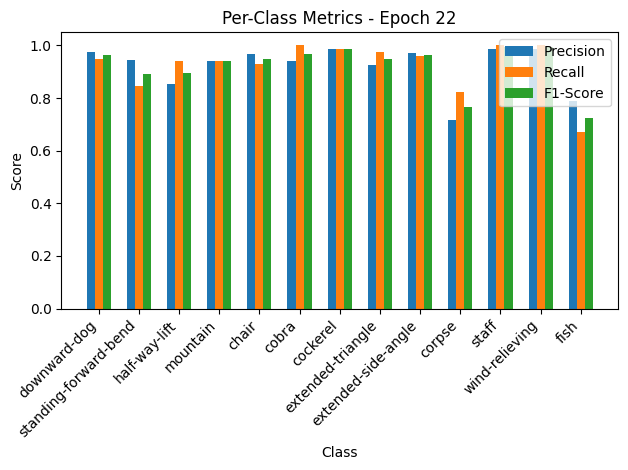

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.60it/s, loss=0.188, accuracy=91.8]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.89, Recall=0.89, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=1.00, Recall=0.50, F1-Score=0.67
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=1.00, F1-Score=0.78


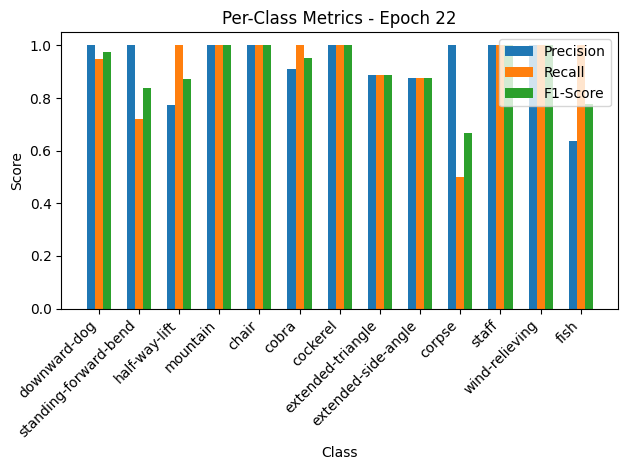


Epoch 23/50 Summary:
Train Loss: 0.2489 | Train Acc: 92.59% | Train Precision: 0.92 | Train Recall: 0.92 | Train F1: 0.92
Val Loss: 0.2065 | Val Acc: 91.78% | Val Precision: 0.93 | Val Recall: 0.92 | Val F1: 0.91

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.80it/s, loss=0.245, accuracy=93.3]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.96, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.88, F1-Score=0.91
half-way-lift: Precision=0.87, Recall=0.92, F1-Score=0.89
mountain: Precision=0.97, Recall=0.96, F1-Score=0.96
chair: Precision=0.95, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.83, Recall=0.72, F1-Score=0.77
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.76, Recall=0.84, F1-Score=0.79


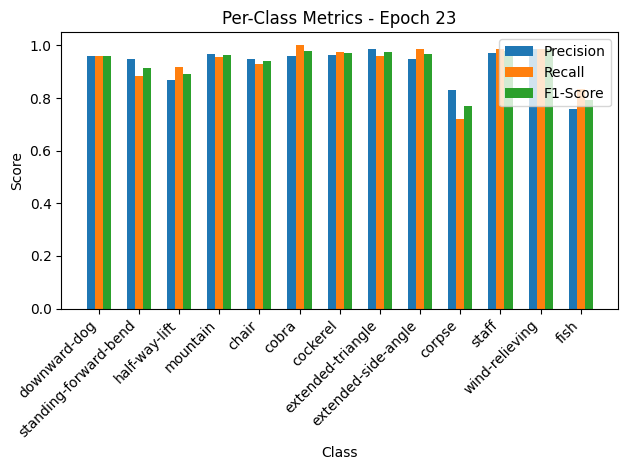

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.52it/s, loss=0.205, accuracy=91.1]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.80, Recall=0.89, F1-Score=0.84
extended-side-angle: Precision=0.86, Recall=0.75, F1-Score=0.80
corpse: Precision=0.73, Recall=1.00, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.57, F1-Score=0.73


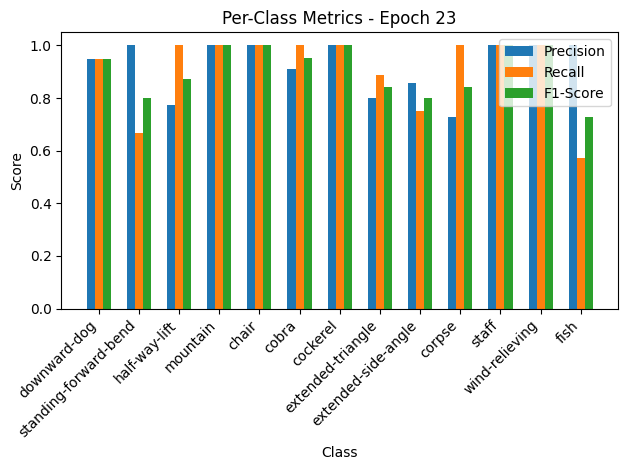


Epoch 24/50 Summary:
Train Loss: 0.2459 | Train Acc: 93.28% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2251 | Val Acc: 91.10% | Val Precision: 0.92 | Val Recall: 0.91 | Val F1: 0.91

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.44it/s, loss=0.239, accuracy=93.4]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.76, Recall=0.82, F1-Score=0.79
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.79, Recall=0.73, F1-Score=0.76


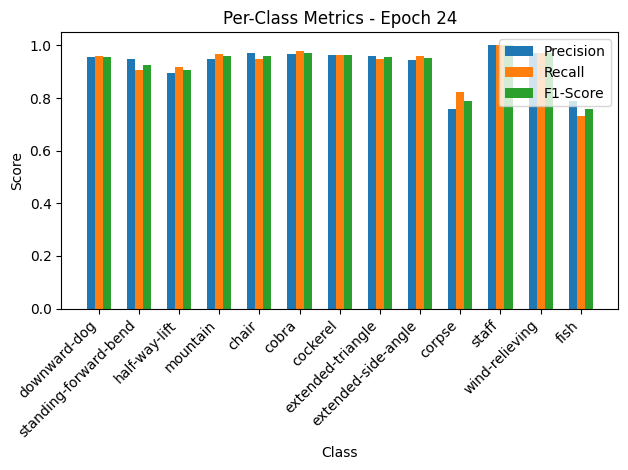

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.35it/s, loss=0.222, accuracy=92.5]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.54, Recall=1.00, F1-Score=0.70


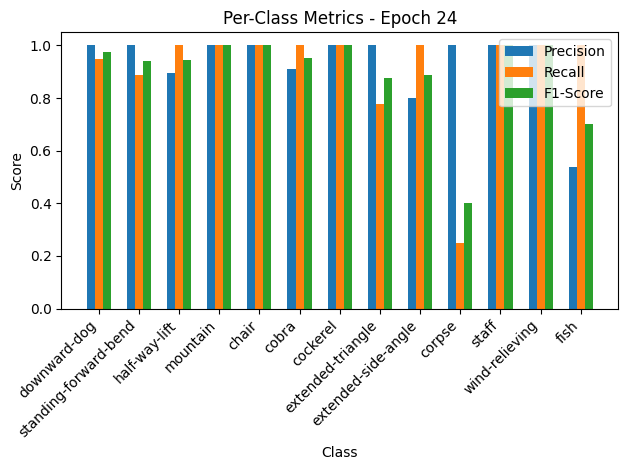


Epoch 25/50 Summary:
Train Loss: 0.2398 | Train Acc: 93.35% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.2428 | Val Acc: 92.47% | Val Precision: 0.93 | Val Recall: 0.91 | Val F1: 0.90

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.37it/s, loss=0.203, accuracy=94.7]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.93, F1-Score=0.92
mountain: Precision=0.97, Recall=0.96, F1-Score=0.96
chair: Precision=0.96, Recall=0.96, F1-Score=0.96
cobra: Precision=0.96, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.91, Recall=0.96, F1-Score=0.93
corpse: Precision=0.83, Recall=0.84, F1-Score=0.83
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.85, Recall=0.82, F1-Score=0.83


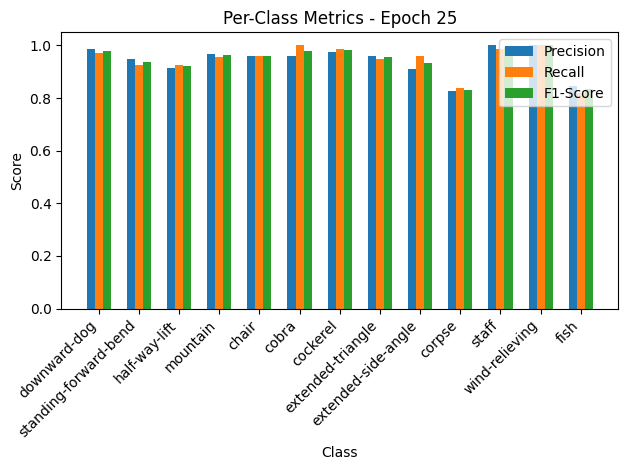

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.23it/s, loss=0.141, accuracy=94.5]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.85, Recall=1.00, F1-Score=0.92
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.70, F1-Score=0.82
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=1.00, F1-Score=0.93


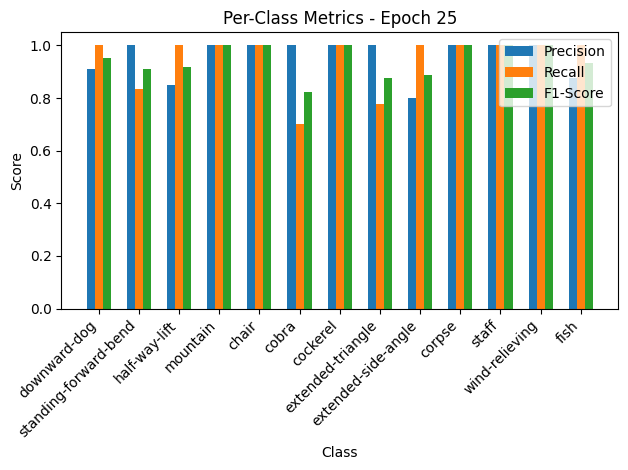


Epoch 26/50 Summary:
Train Loss: 0.2030 | Train Acc: 94.73% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1549 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.1549

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.05it/s, loss=0.226, accuracy=94.5]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.96, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.90, Recall=0.93, F1-Score=0.92
mountain: Precision=0.94, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.93, F1-Score=0.95
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.85, Recall=0.81, F1-Score=0.83
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.81, Recall=0.85, F1-Score=0.83


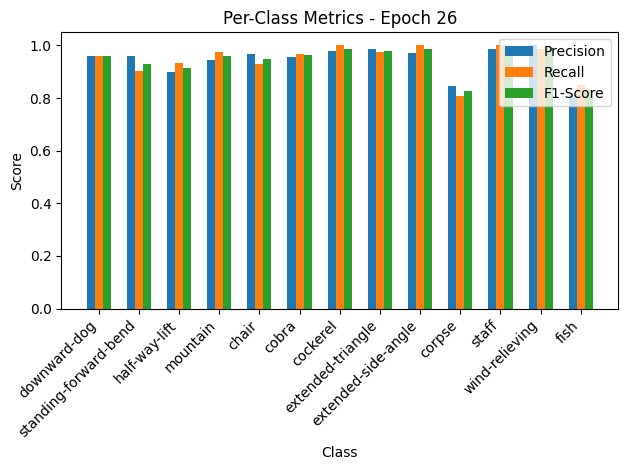

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.91it/s, loss=0.114, accuracy=95.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.89, F1-Score=0.91
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


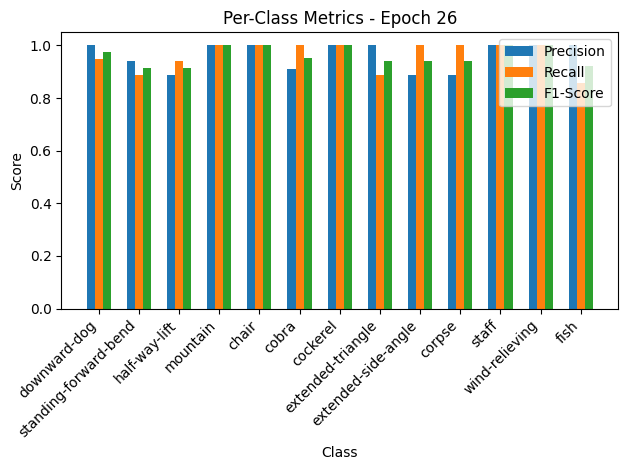


Epoch 27/50 Summary:
Train Loss: 0.2265 | Train Acc: 94.50% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.1248 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 27
New best model saved! Validation Loss: 0.1248

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.23it/s, loss=0.224, accuracy=93.8]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.96, Recall=0.96, F1-Score=0.96
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.92, F1-Score=0.92
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.94, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.94, Recall=0.99, F1-Score=0.96
corpse: Precision=0.79, Recall=0.84, F1-Score=0.81
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.83, Recall=0.75, F1-Score=0.79


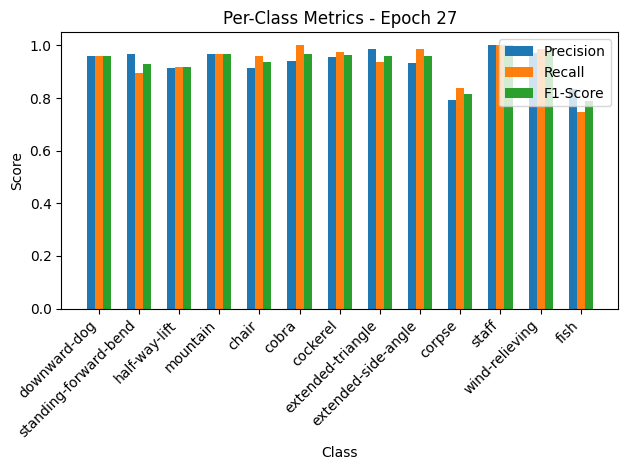

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.90it/s, loss=0.159, accuracy=93.2]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.77, Recall=1.00, F1-Score=0.87
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.89, Recall=0.89, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=1.00, Recall=0.75, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=1.00, F1-Score=0.88


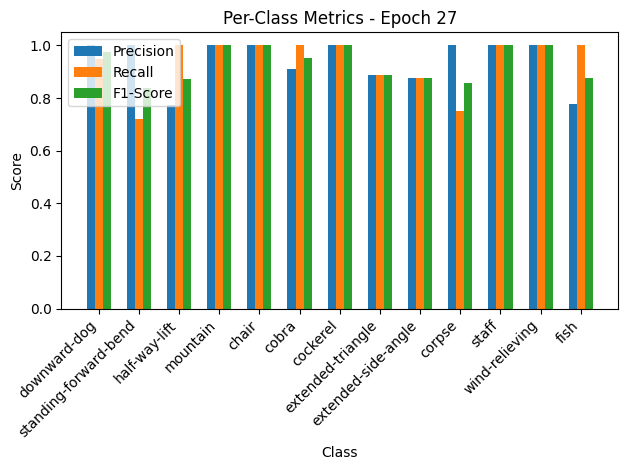


Epoch 28/50 Summary:
Train Loss: 0.2245 | Train Acc: 93.81% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1745 | Val Acc: 93.15% | Val Precision: 0.94 | Val Recall: 0.94 | Val F1: 0.93

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.64it/s, loss=0.242, accuracy=93.7]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=1.00, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.89, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.95, F1-Score=0.91
mountain: Precision=0.97, Recall=0.94, F1-Score=0.96
chair: Precision=0.96, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.92, Recall=0.91, F1-Score=0.92
extended-side-angle: Precision=0.91, Recall=0.93, F1-Score=0.92
corpse: Precision=0.79, Recall=0.81, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.80, Recall=0.78, F1-Score=0.79


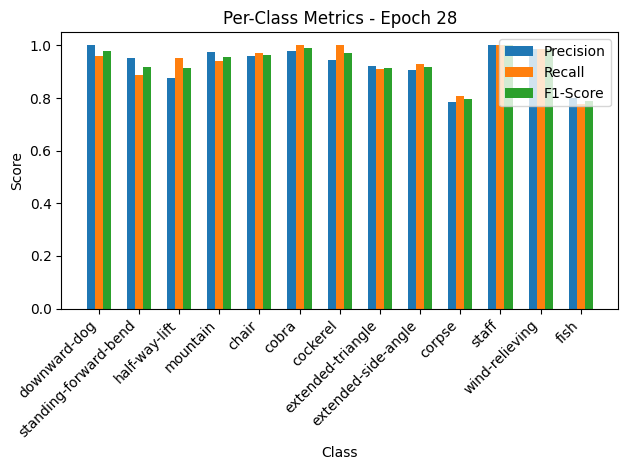

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.96it/s, loss=0.175, accuracy=94.5]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.72, F1-Score=0.84
half-way-lift: Precision=0.81, Recall=1.00, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


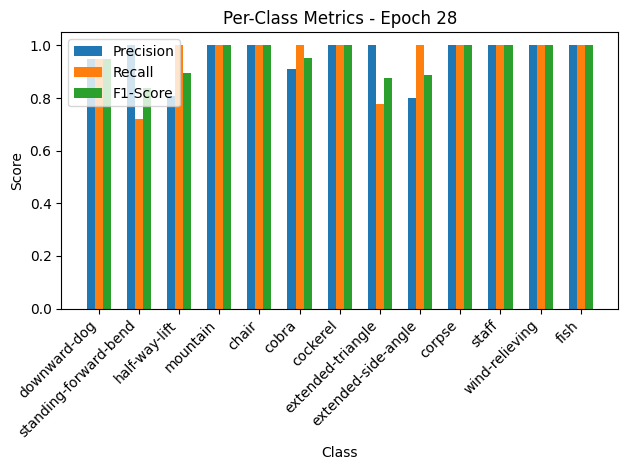


Epoch 29/50 Summary:
Train Loss: 0.2428 | Train Acc: 93.66% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1916 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.95

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.24it/s, loss=0.212, accuracy=94.8]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=0.96, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.93, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.97, F1-Score=0.97
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.86, Recall=0.82, F1-Score=0.84
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.85, F1-Score=0.84


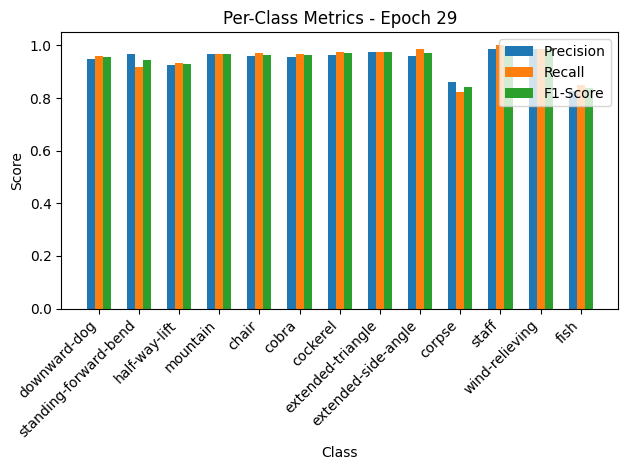

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.16it/s, loss=0.11, accuracy=97.9]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=1.00, Recall=1.00, F1-Score=1.00
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


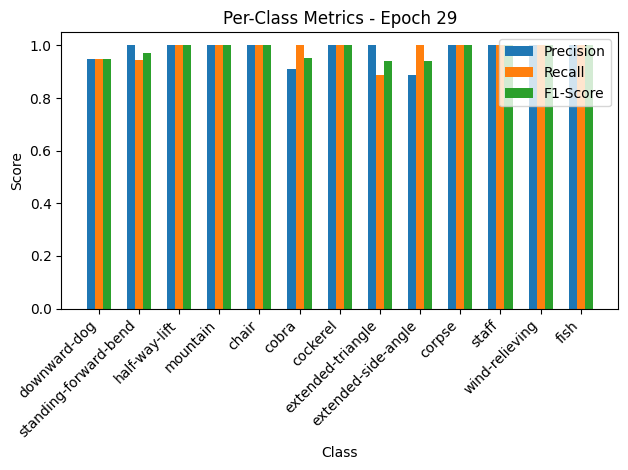


Epoch 30/50 Summary:
Train Loss: 0.2125 | Train Acc: 94.81% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1202 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 30
New best model saved! Validation Loss: 0.1202

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.16it/s, loss=0.194, accuracy=95.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.87, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.88, F1-Score=0.89


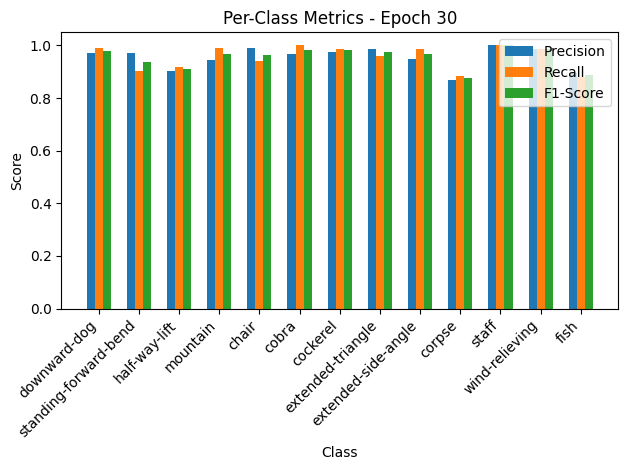

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.96it/s, loss=0.11, accuracy=95.9]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.86, Recall=0.86, F1-Score=0.86


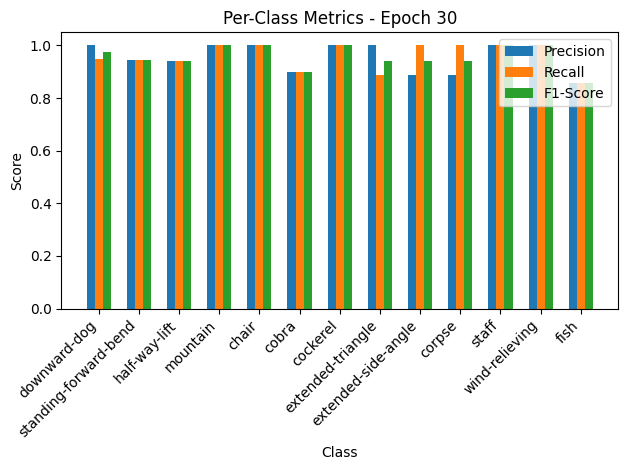


Epoch 31/50 Summary:
Train Loss: 0.1941 | Train Acc: 95.49% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.95
Val Loss: 0.1206 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 32/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.68it/s, loss=0.205, accuracy=95.4]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.93, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.94, F1-Score=0.94
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=1.00, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.84, Recall=0.85, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.85, Recall=0.84, F1-Score=0.84


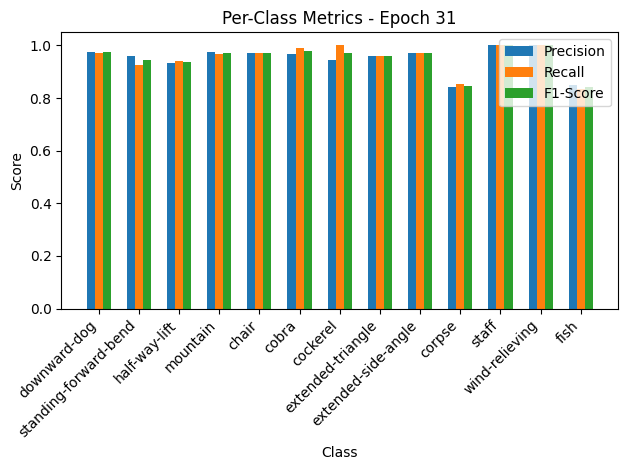

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.46it/s, loss=0.193, accuracy=93.8]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.58, Recall=1.00, F1-Score=0.74


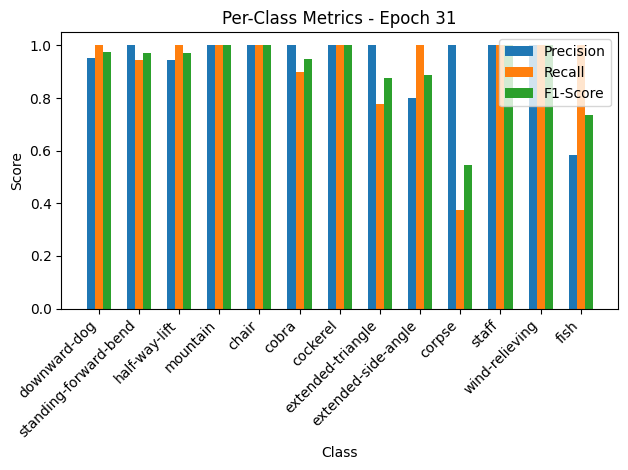


Epoch 32/50 Summary:
Train Loss: 0.2057 | Train Acc: 95.42% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.2114 | Val Acc: 93.84% | Val Precision: 0.94 | Val Recall: 0.92 | Val F1: 0.92

Epoch 33/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.62it/s, loss=0.208, accuracy=95.2]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.94, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.95, Recall=0.96, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.96, Recall=0.95, F1-Score=0.95
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.82, Recall=0.88, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.81, F1-Score=0.84


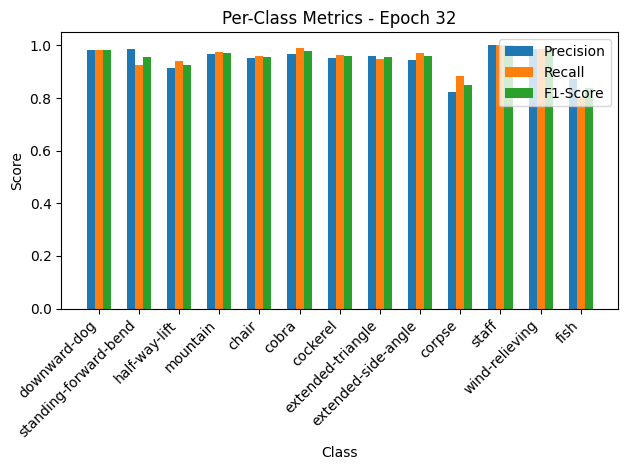

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.46it/s, loss=0.15, accuracy=95.9]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=0.85, F1-Score=0.92
chair: Precision=0.85, Recall=1.00, F1-Score=0.92
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


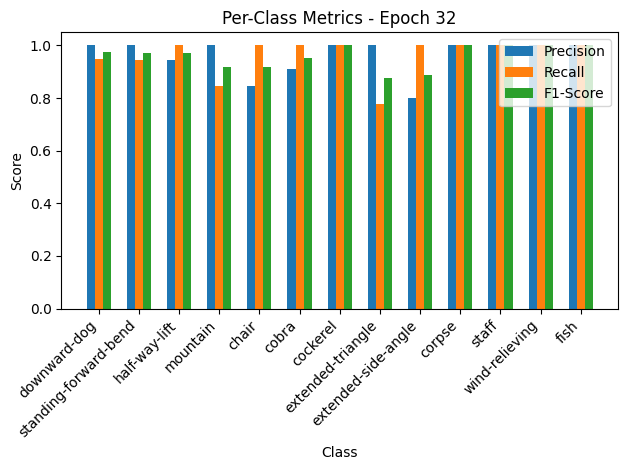


Epoch 33/50 Summary:
Train Loss: 0.2080 | Train Acc: 95.19% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1647 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.07it/s, loss=0.193, accuracy=95.4]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.91, Recall=0.94, F1-Score=0.92
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.88, Recall=0.88, F1-Score=0.88
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


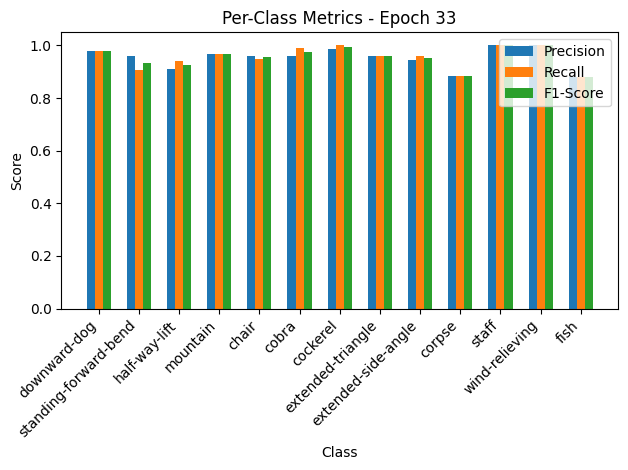

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.53it/s, loss=0.118, accuracy=96.6]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


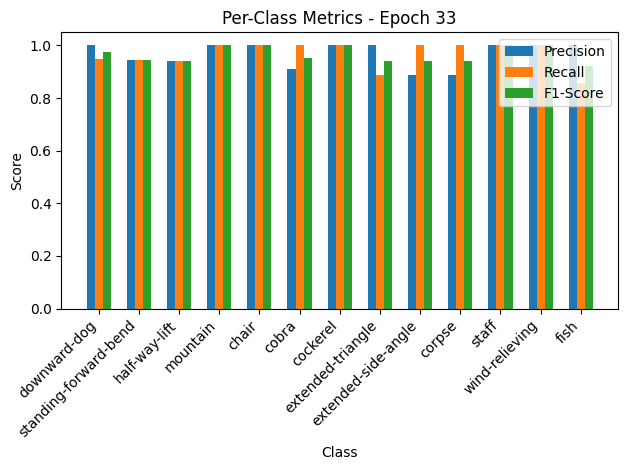


Epoch 34/50 Summary:
Train Loss: 0.1935 | Train Acc: 95.42% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1290 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=0.219, accuracy=95.3]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.94, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.89, Recall=0.85, F1-Score=0.87
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.86, Recall=0.90, F1-Score=0.88


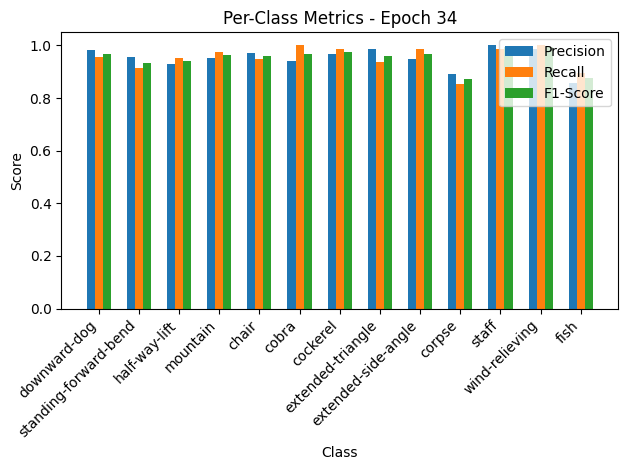

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.79it/s, loss=0.128, accuracy=95.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.80, Recall=1.00, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.71, F1-Score=0.83


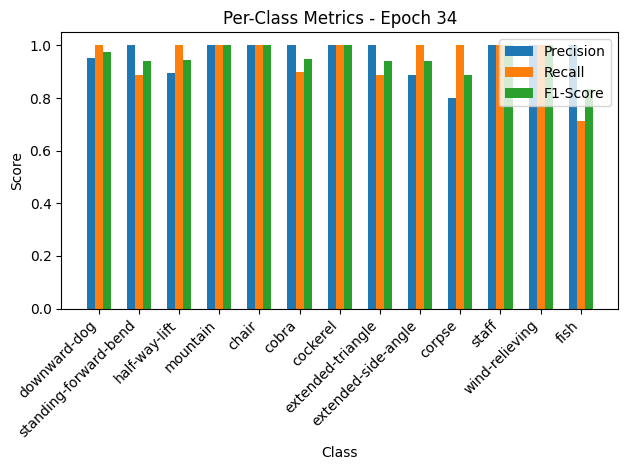


Epoch 35/50 Summary:
Train Loss: 0.2192 | Train Acc: 95.26% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1405 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.90it/s, loss=0.185, accuracy=96.2]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.96, F1-Score=0.94
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.99, Recall=0.94, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.86, Recall=0.94, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.84, F1-Score=0.88


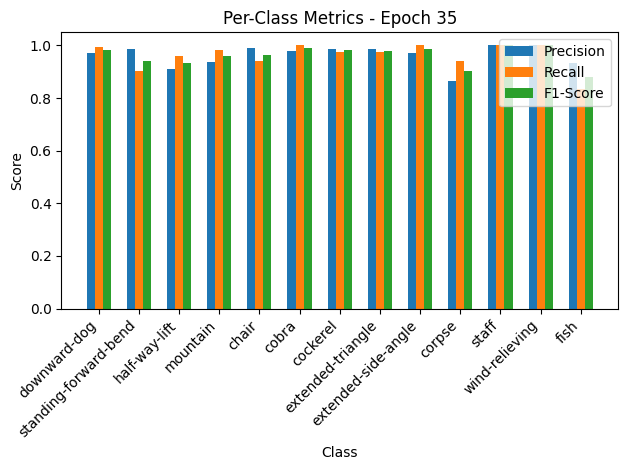

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.85it/s, loss=0.0967, accuracy=97.3]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


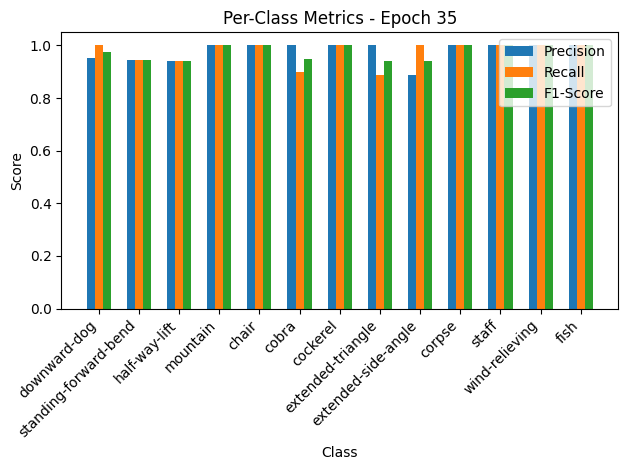


Epoch 36/50 Summary:
Train Loss: 0.1853 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1060 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 36
New best model saved! Validation Loss: 0.1060

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.94it/s, loss=0.199, accuracy=96]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.98, Recall=0.96, F1-Score=0.97
chair: Precision=0.94, Recall=0.97, F1-Score=0.96
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.95, Recall=0.97, F1-Score=0.96
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.84, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.84, Recall=0.88, F1-Score=0.86


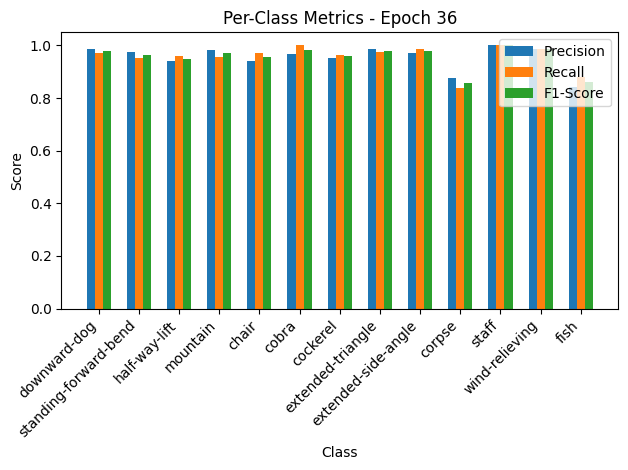

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.98it/s, loss=0.0885, accuracy=97.3]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


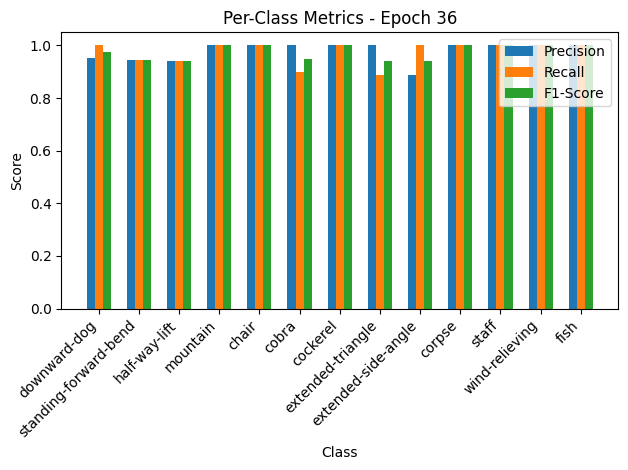


Epoch 37/50 Summary:
Train Loss: 0.1993 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0969 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 37
New best model saved! Validation Loss: 0.0969

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.15it/s, loss=0.185, accuracy=96]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.95, F1-Score=0.95
mountain: Precision=0.95, Recall=0.96, F1-Score=0.95
chair: Precision=0.96, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.87, F1-Score=0.87
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.87, Recall=0.88, F1-Score=0.87


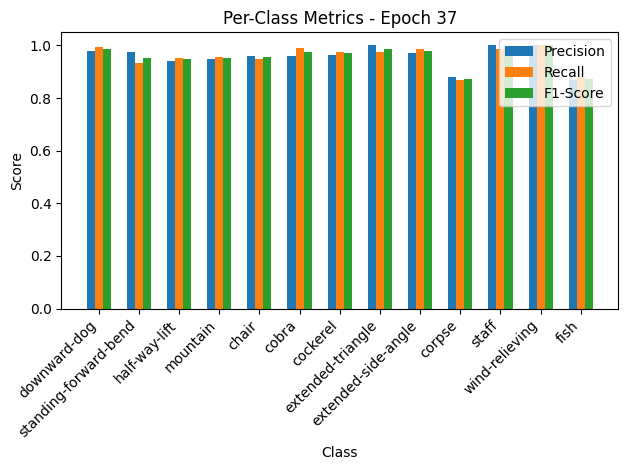

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.01it/s, loss=0.095, accuracy=97.3]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


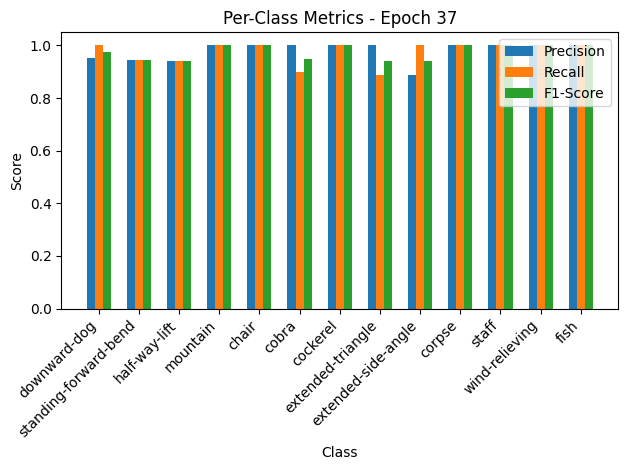


Epoch 38/50 Summary:
Train Loss: 0.1854 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1041 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98

Epoch 39/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.47it/s, loss=0.154, accuracy=96.6]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.98, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.94, Recall=0.99, F1-Score=0.96
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


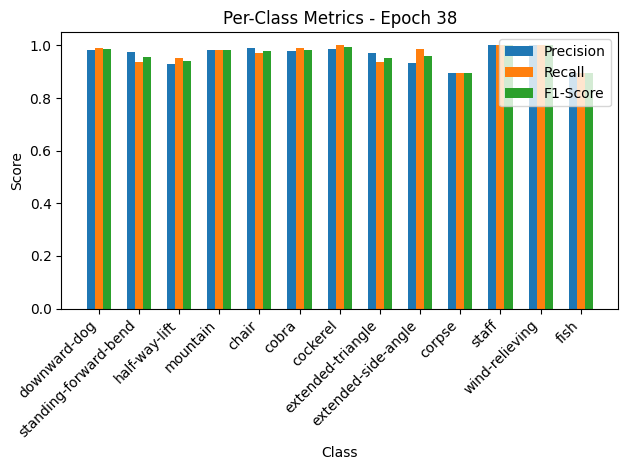

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.79it/s, loss=0.0881, accuracy=97.9]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


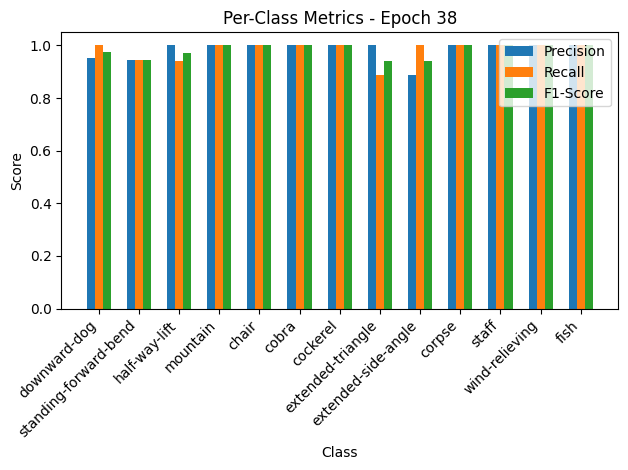


Epoch 39/50 Summary:
Train Loss: 0.1543 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0965 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 39
New best model saved! Validation Loss: 0.0965

Epoch 40/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.49it/s, loss=0.149, accuracy=96.9]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.95, Recall=1.00, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.97, Recall=0.88, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.89, Recall=0.97, F1-Score=0.93


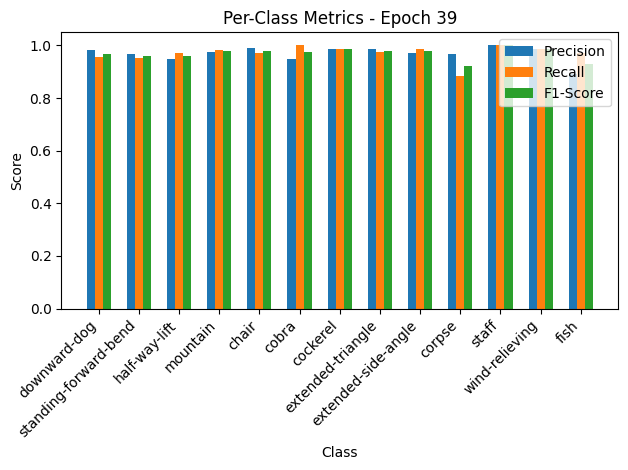

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.50it/s, loss=0.0892, accuracy=97.9]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=1.00, Recall=1.00, F1-Score=1.00
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


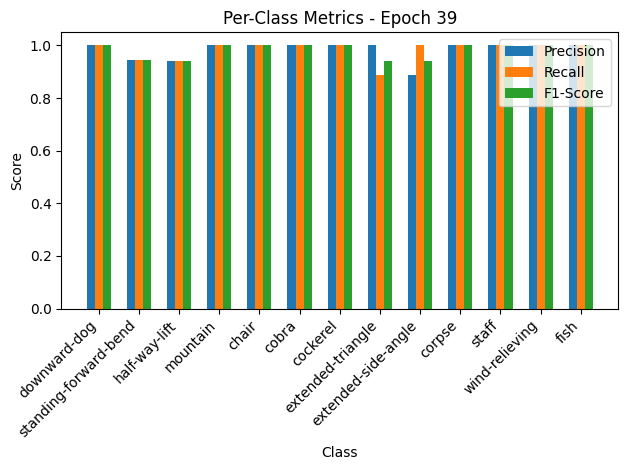


Epoch 40/50 Summary:
Train Loss: 0.1492 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0978 | Val Acc: 97.95% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 41/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.36it/s, loss=0.178, accuracy=96.6]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.93, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.97, F1-Score=0.96
corpse: Precision=0.90, Recall=0.90, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


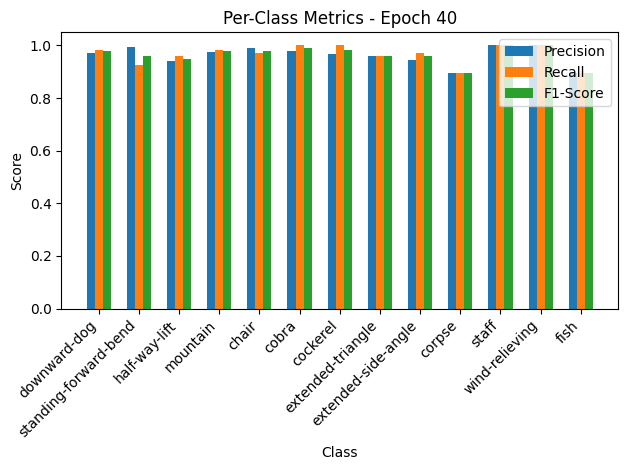

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.62it/s, loss=0.0841, accuracy=97.3]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


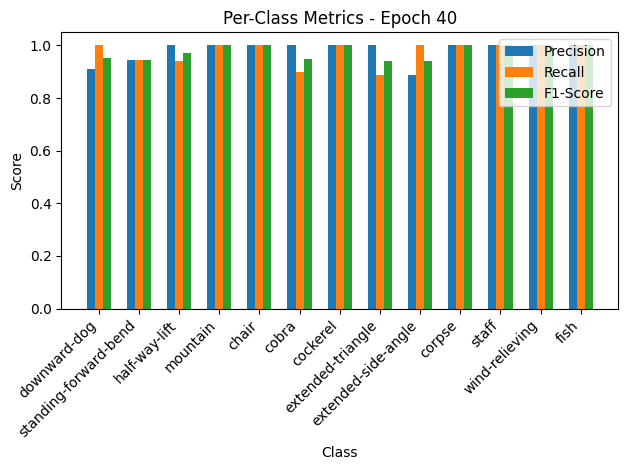


Epoch 41/50 Summary:
Train Loss: 0.1781 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0922 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_3.pth
Checkpoint saved at epoch 41
New best model saved! Validation Loss: 0.0922

Epoch 42/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  9.11it/s, loss=0.161, accuracy=96.5]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.96
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.97, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=1.00, F1-Score=0.97
corpse: Precision=0.91, Recall=0.85, F1-Score=0.88
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.86, Recall=0.91, F1-Score=0.88


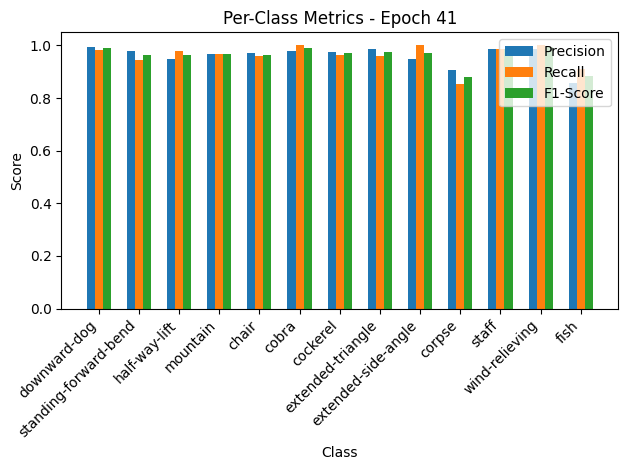

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.74it/s, loss=0.0864, accuracy=97.3]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


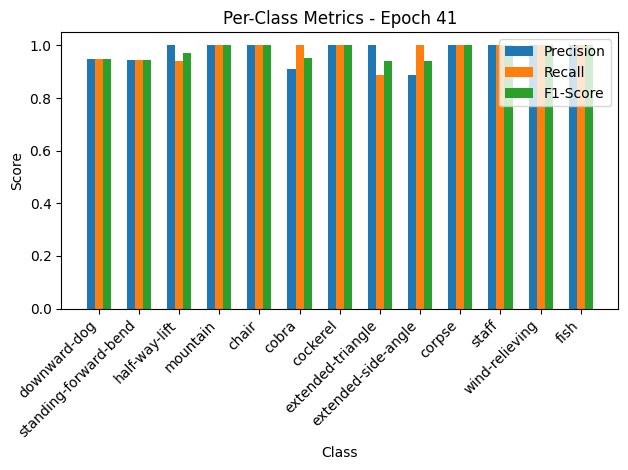


Epoch 42/50 Summary:
Train Loss: 0.1614 | Train Acc: 96.49% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.0946 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 43/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.35it/s, loss=0.163, accuracy=96.8]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.97, F1-Score=0.94
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.95, Recall=0.91, F1-Score=0.93
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.96, F1-Score=0.93


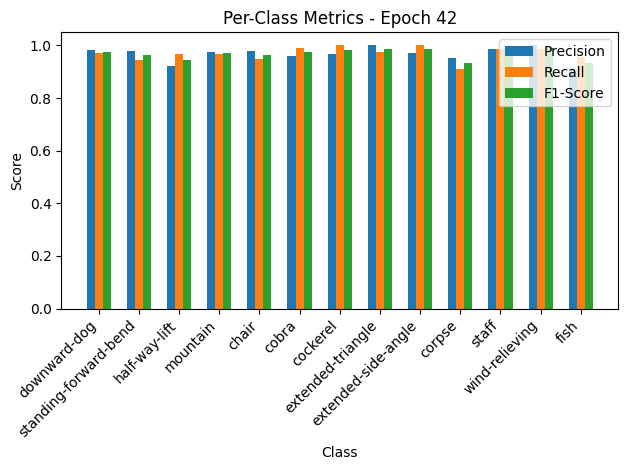

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.14it/s, loss=0.0884, accuracy=96.6]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


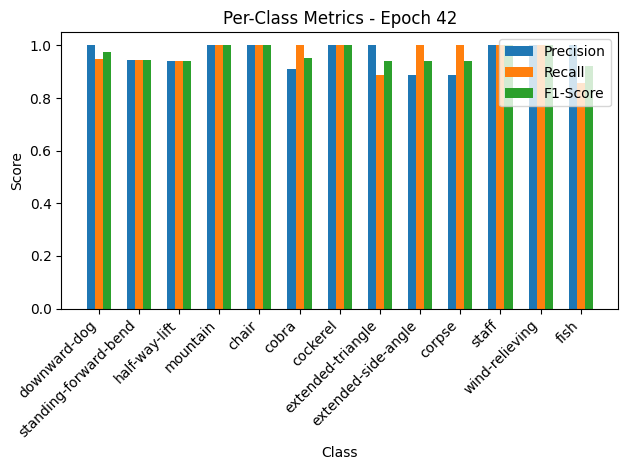


Epoch 43/50 Summary:
Train Loss: 0.1629 | Train Acc: 96.79% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.0969 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 44/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.63it/s, loss=0.162, accuracy=96.7]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.94, F1-Score=0.95
half-way-lift: Precision=0.95, Recall=0.94, F1-Score=0.94
mountain: Precision=0.98, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.91, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.93, F1-Score=0.92


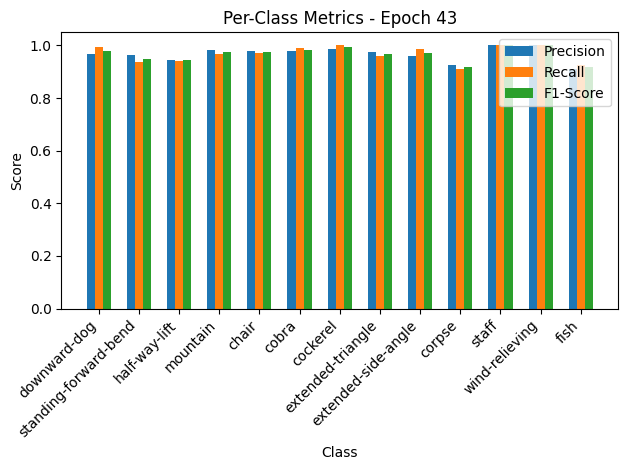

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.67it/s, loss=0.0979, accuracy=96.6]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


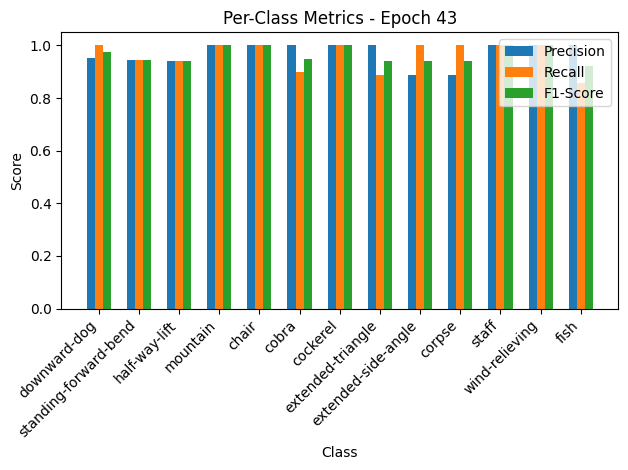


Epoch 44/50 Summary:
Train Loss: 0.1628 | Train Acc: 96.72% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1072 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.96 | Val F1: 0.97

Epoch 45/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.17, accuracy=96.2]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.96, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.89, Recall=0.93, F1-Score=0.91
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.91, Recall=0.87, F1-Score=0.89


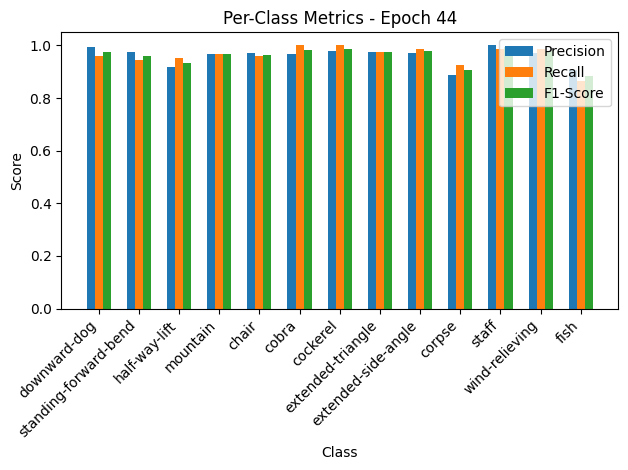

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.95it/s, loss=0.104, accuracy=95.9]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.89, Recall=0.89, F1-Score=0.89
extended-side-angle: Precision=0.88, Recall=0.88, F1-Score=0.88
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


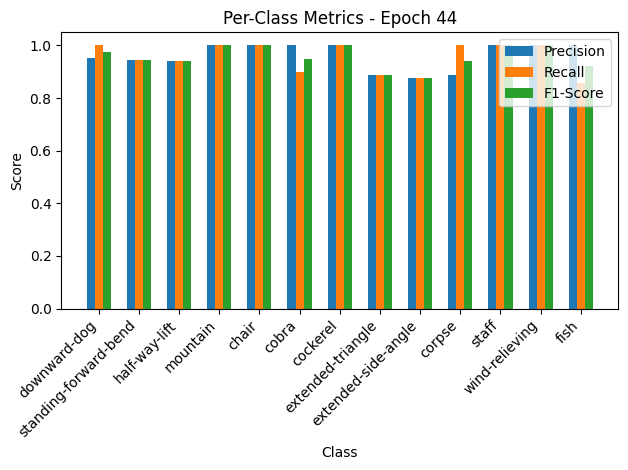


Epoch 45/50 Summary:
Train Loss: 0.1707 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1137 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.96

Epoch 46/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.85it/s, loss=0.162, accuracy=96.5]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.97, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.88, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.90, F1-Score=0.89


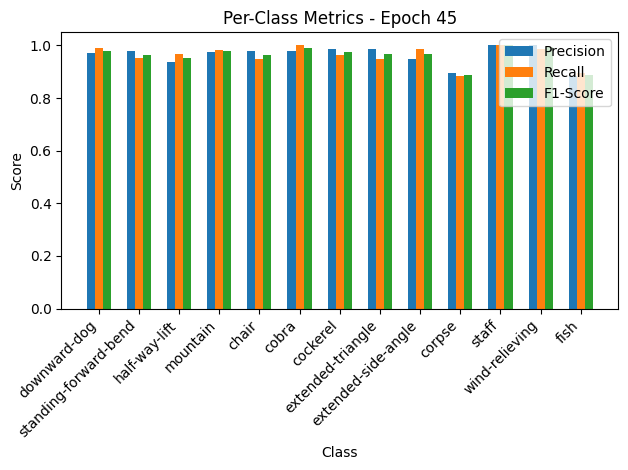

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.44it/s, loss=0.098, accuracy=97.3]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


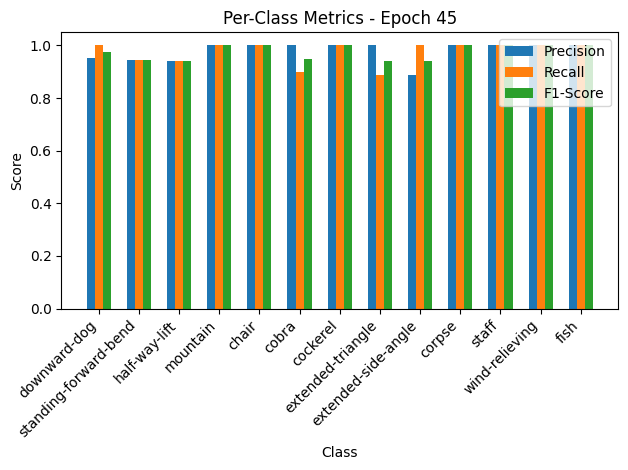


Epoch 46/50 Summary:
Train Loss: 0.1626 | Train Acc: 96.49% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1074 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.58it/s, loss=0.162, accuracy=96.7]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.97
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.96, F1-Score=0.97
cobra: Precision=0.99, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.90, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.93, F1-Score=0.91


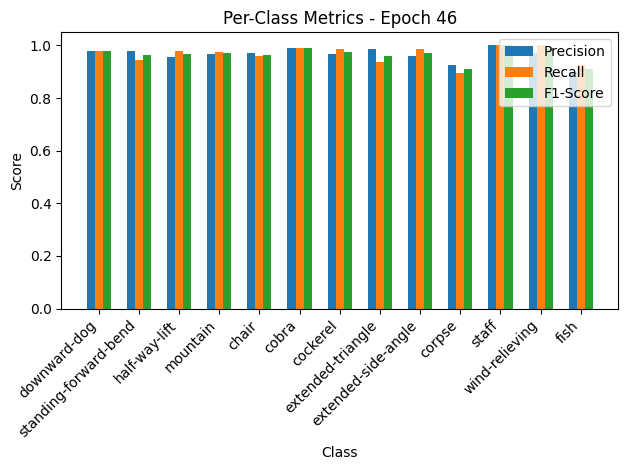

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.42it/s, loss=0.0954, accuracy=97.3]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


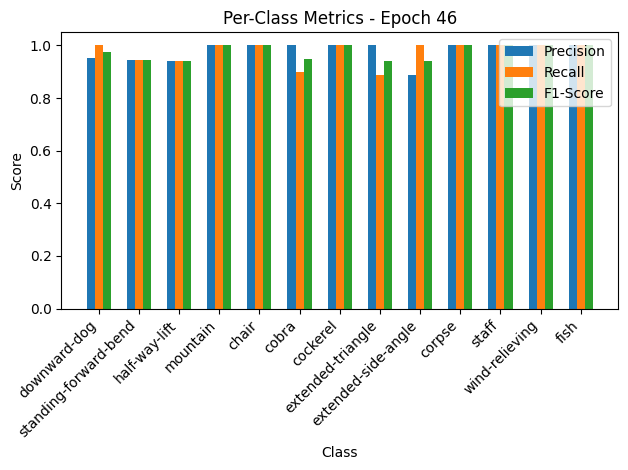


Epoch 47/50 Summary:
Train Loss: 0.1626 | Train Acc: 96.72% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1046 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.97 | Val F1: 0.98

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.95it/s, loss=0.157, accuracy=96.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.98, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.94, Recall=0.85, F1-Score=0.89
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.94, F1-Score=0.91


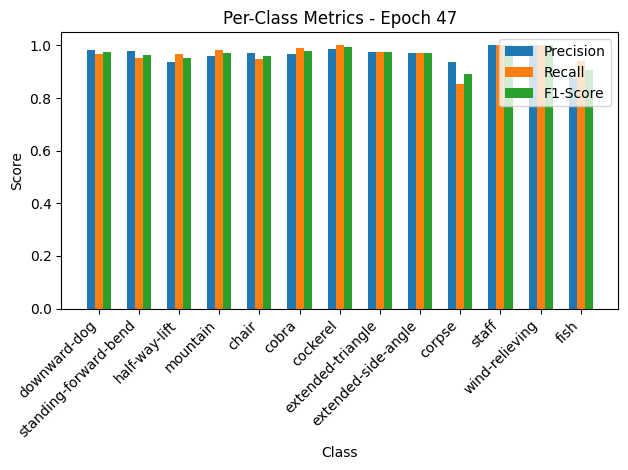

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.86it/s, loss=0.0906, accuracy=97.3]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


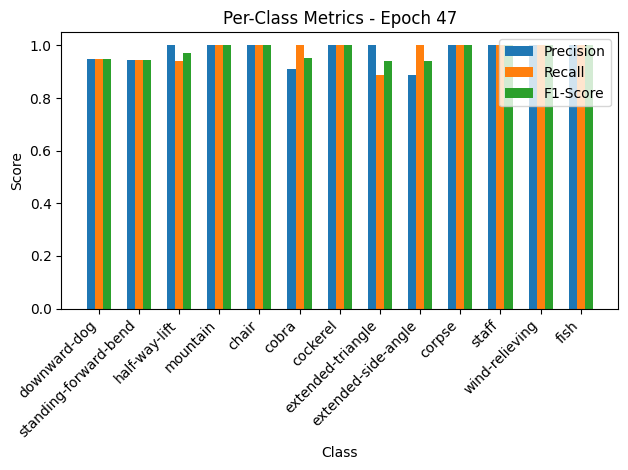


Epoch 48/50 Summary:
Train Loss: 0.1569 | Train Acc: 96.56% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.0993 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 49/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.22it/s, loss=0.151, accuracy=96.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.96
mountain: Precision=0.97, Recall=0.98, F1-Score=0.98
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.90, Recall=0.91, F1-Score=0.91
staff: Precision=1.00, Recall=0.97, F1-Score=0.99
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.90, F1-Score=0.90


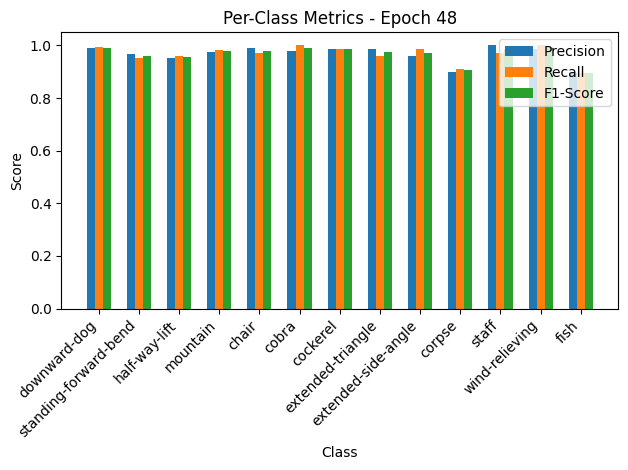

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.46it/s, loss=0.1, accuracy=97.3]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.95, Recall=1.00, F1-Score=0.98
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=1.00, Recall=0.94, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.86, F1-Score=0.92


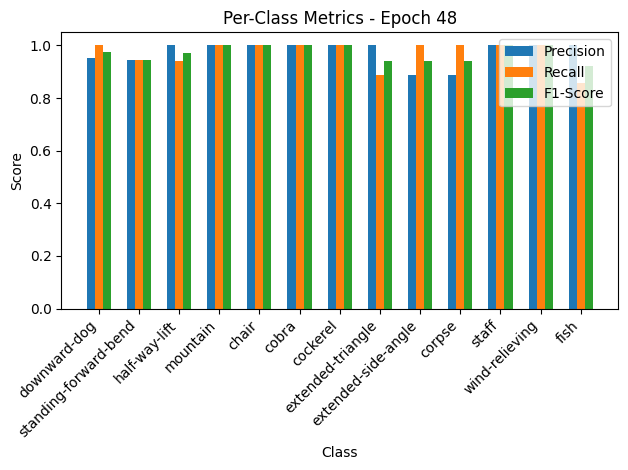


Epoch 49/50 Summary:
Train Loss: 0.1516 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1098 | Val Acc: 97.26% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 50/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  9.07it/s, loss=0.148, accuracy=97.1]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.96, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.98, Recall=0.97, F1-Score=0.98
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.95, Recall=0.90, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.90, Recall=0.96, F1-Score=0.93


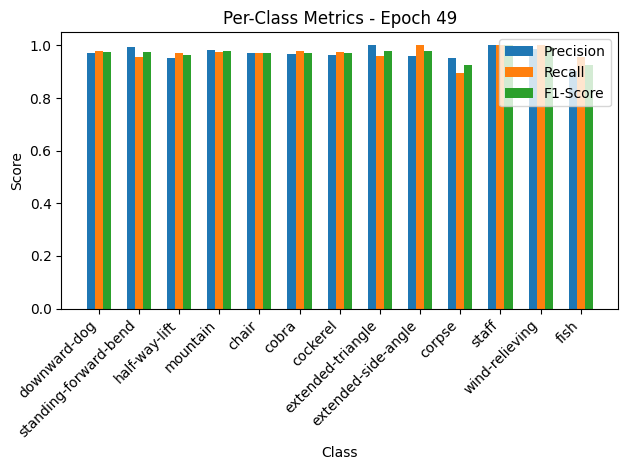

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.73it/s, loss=0.0917, accuracy=97.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=1.00, Recall=0.95, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=1.00, F1-Score=1.00
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


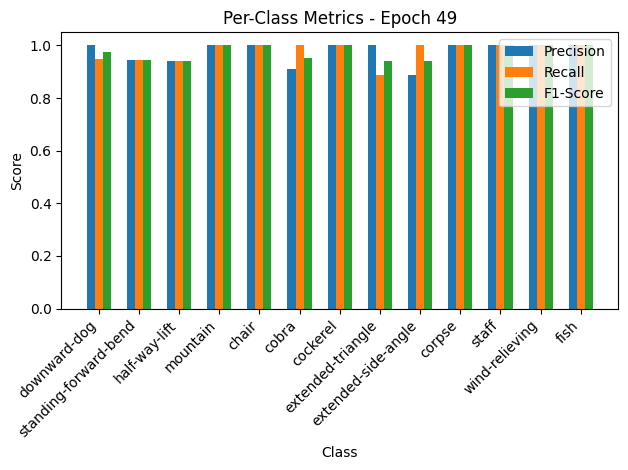


Epoch 50/50 Summary:
Train Loss: 0.1486 | Train Acc: 97.10% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1005 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98


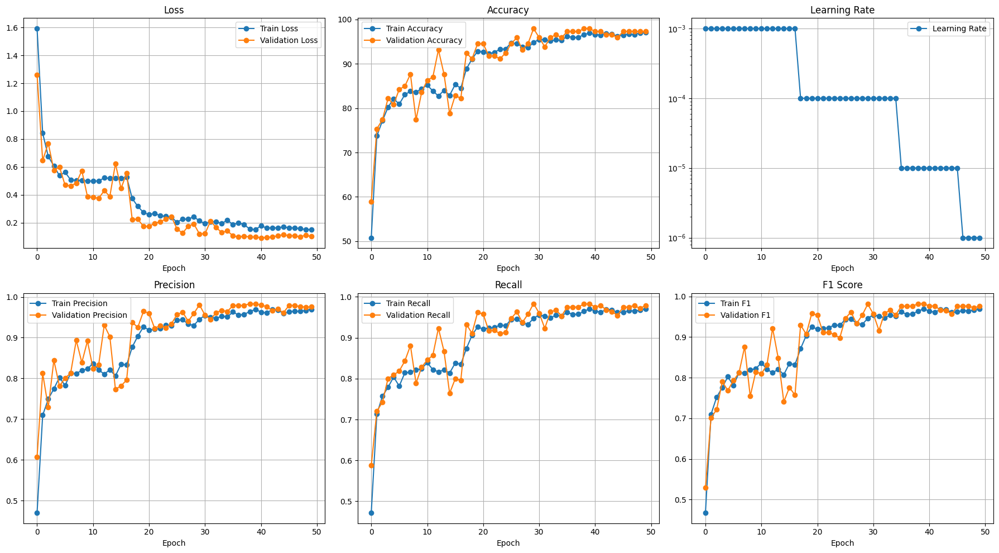

Testing: 100%|██████████| 23/23 [00:00<00:00, 33.56it/s]


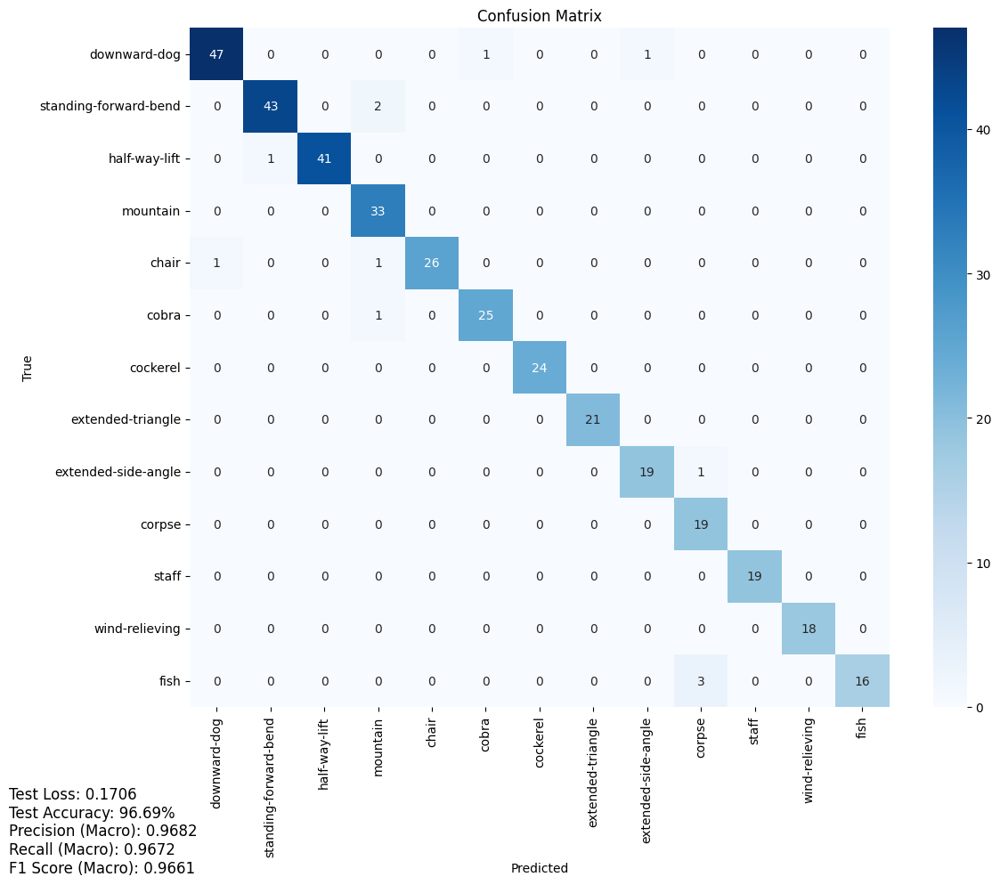

Test Loss: 0.1706
Test Accuracy: 96.69%
Precision (Macro): 0.9682
Recall (Macro): 0.9672
F1 Score (Macro): 0.9661


Testing: 100%|██████████| 23/23 [00:00<00:00, 39.03it/s]


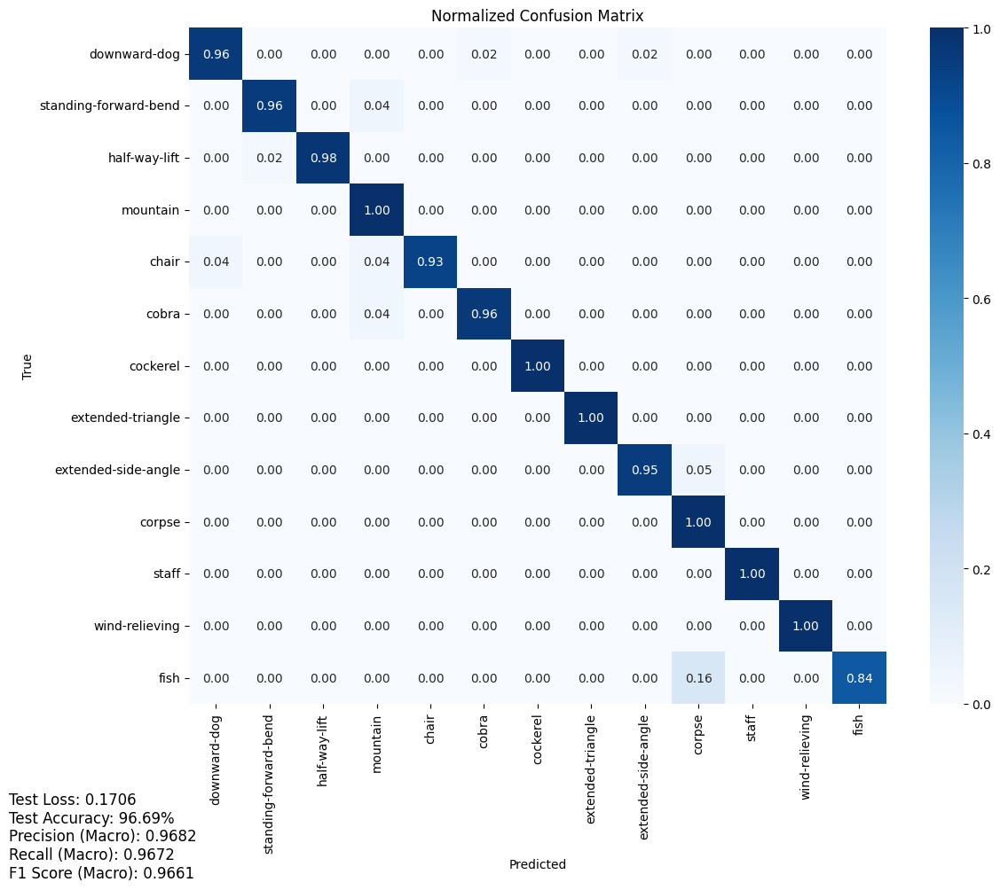

Test Loss: 0.1706
Test Accuracy: 96.69%
Precision (Macro): 0.9682
Recall (Macro): 0.9672
F1 Score (Macro): 0.9661
Saved checkpoint for fold 4
Fold 5/5

Class Distribution Analysis:
--------------------------------------------------
Class 0: 176 samples (13.45%)
Class 1: 162 samples (12.38%)
Class 2: 150 samples (11.46%)
Class 3: 119 samples (9.09%)
Class 4: 101 samples (7.72%)
Class 5: 93 samples (7.10%)
Class 6: 86 samples (6.57%)
Class 7: 78 samples (5.96%)
Class 8: 73 samples (5.58%)
Class 9: 68 samples (5.19%)
Class 10: 68 samples (5.19%)
Class 11: 68 samples (5.19%)
Class 12: 67 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 176
Minimum class size: 67
Average class size: 100.69
Class weights aligned with indices: tensor([0.5124, 0.5563, 0.6005, 0.7557, 0.8896, 0.9657, 1.0440, 1.1506, 1.2291,
        1.3191, 1.3191, 1.3191, 1.3388])
Cached criterion for fold 4
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.33it/s, loss=1.63, accuracy=49.4]


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.72, Recall=0.56, F1-Score=0.63
standing-forward-bend: Precision=0.67, Recall=0.40, F1-Score=0.50
half-way-lift: Precision=0.66, Recall=0.75, F1-Score=0.70
mountain: Precision=0.54, Recall=0.56, F1-Score=0.55
chair: Precision=0.46, Recall=0.39, F1-Score=0.42
cobra: Precision=0.44, Recall=0.47, F1-Score=0.46
cockerel: Precision=0.49, Recall=0.53, F1-Score=0.51
extended-triangle: Precision=0.46, Recall=0.42, F1-Score=0.44
extended-side-angle: Precision=0.34, Recall=0.41, F1-Score=0.38
corpse: Precision=0.17, Recall=0.24, F1-Score=0.20
staff: Precision=0.35, Recall=0.62, F1-Score=0.45
wind-relieving: Precision=0.51, Recall=0.56, F1-Score=0.53
fish: Precision=0.25, Recall=0.22, F1-Score=0.23


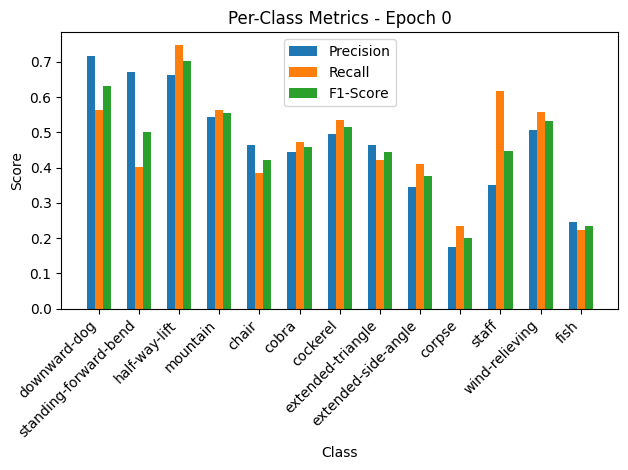

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.09it/s, loss=1.25, accuracy=55.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 0:
downward-dog: Precision=0.67, Recall=0.10, F1-Score=0.17
standing-forward-bend: Precision=0.48, Recall=0.78, F1-Score=0.60
half-way-lift: Precision=0.92, Recall=0.65, F1-Score=0.76
mountain: Precision=0.52, Recall=1.00, F1-Score=0.68
chair: Precision=0.50, Recall=0.09, F1-Score=0.15
cobra: Precision=0.33, Recall=1.00, F1-Score=0.50
cockerel: Precision=0.45, Recall=1.00, F1-Score=0.62
extended-triangle: Precision=1.00, Recall=0.44, F1-Score=0.62
extended-side-angle: Precision=0.75, Recall=0.75, F1-Score=0.75
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.80, Recall=0.57, F1-Score=0.67
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


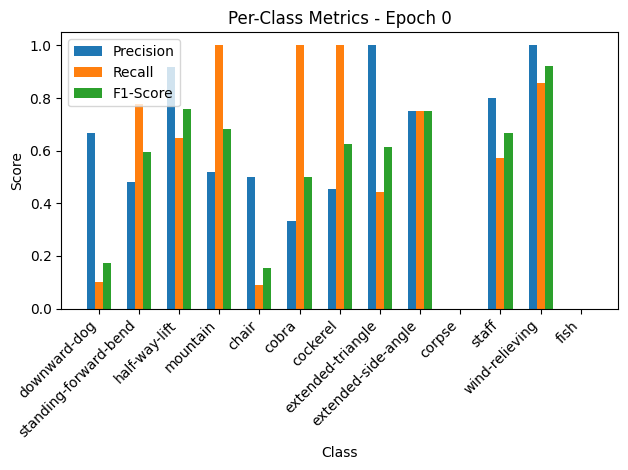


Epoch 1/50 Summary:
Train Loss: 1.6361 | Train Acc: 49.35% | Train Precision: 0.47 | Train Recall: 0.47 | Train F1: 0.46
Val Loss: 1.3747 | Val Acc: 55.48% | Val Precision: 0.57 | Val Recall: 0.56 | Val F1: 0.50
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 1
New best model saved! Validation Loss: 1.3747

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.89it/s, loss=0.828, accuracy=71.9]


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.87, Recall=0.81, F1-Score=0.84
standing-forward-bend: Precision=0.76, Recall=0.65, F1-Score=0.70
half-way-lift: Precision=0.76, Recall=0.83, F1-Score=0.80
mountain: Precision=0.76, Recall=0.74, F1-Score=0.75
chair: Precision=0.65, Recall=0.72, F1-Score=0.69
cobra: Precision=0.83, Recall=0.88, F1-Score=0.85
cockerel: Precision=0.84, Recall=0.84, F1-Score=0.84
extended-triangle: Precision=0.68, Recall=0.64, F1-Score=0.66
extended-side-angle: Precision=0.47, Recall=0.48, F1-Score=0.47
corpse: Precision=0.35, Recall=0.32, F1-Score=0.34
staff: Precision=0.77, Recall=0.88, F1-Score=0.82
wind-relieving: Precision=0.77, Recall=0.81, F1-Score=0.79
fish: Precision=0.46, Recall=0.46, F1-Score=0.46


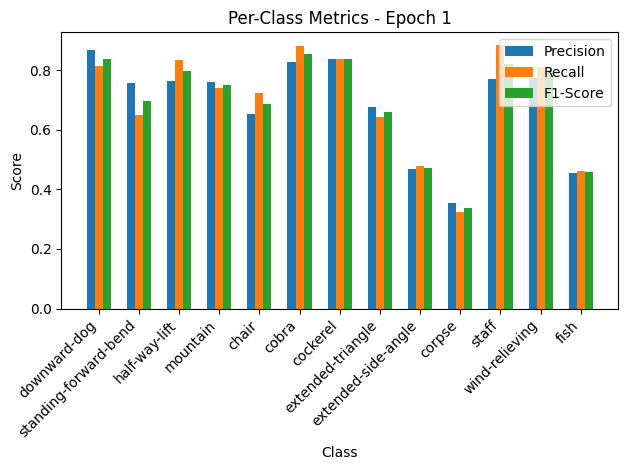

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.20it/s, loss=0.804, accuracy=73.3]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 1:
downward-dog: Precision=0.80, Recall=0.80, F1-Score=0.80
standing-forward-bend: Precision=0.80, Recall=0.67, F1-Score=0.73
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=0.52, Recall=1.00, F1-Score=0.68
chair: Precision=0.00, Recall=0.00, F1-Score=0.00
cobra: Precision=0.77, Recall=1.00, F1-Score=0.87
cockerel: Precision=0.59, Recall=1.00, F1-Score=0.74
extended-triangle: Precision=0.80, Recall=0.89, F1-Score=0.84
extended-side-angle: Precision=1.00, Recall=0.62, F1-Score=0.77
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=0.70, Recall=1.00, F1-Score=0.82
wind-relieving: Precision=1.00, Recall=0.43, F1-Score=0.60
fish: Precision=0.78, Recall=0.88, F1-Score=0.82


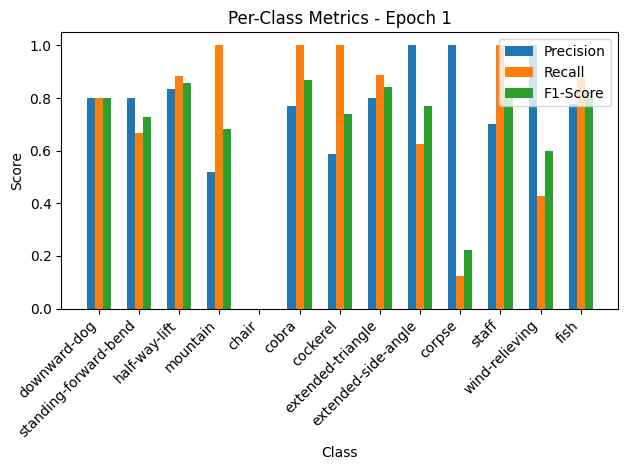


Epoch 2/50 Summary:
Train Loss: 0.8294 | Train Acc: 71.89% | Train Precision: 0.69 | Train Recall: 0.70 | Train F1: 0.69
Val Loss: 0.8811 | Val Acc: 73.29% | Val Precision: 0.74 | Val Recall: 0.71 | Val F1: 0.67
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 2
New best model saved! Validation Loss: 0.8811

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.35it/s, loss=0.698, accuracy=76.5]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.87, Recall=0.85, F1-Score=0.86
standing-forward-bend: Precision=0.86, Recall=0.74, F1-Score=0.80
half-way-lift: Precision=0.76, Recall=0.84, F1-Score=0.80
mountain: Precision=0.81, Recall=0.82, F1-Score=0.82
chair: Precision=0.71, Recall=0.71, F1-Score=0.71
cobra: Precision=0.83, Recall=0.86, F1-Score=0.85
cockerel: Precision=0.82, Recall=0.85, F1-Score=0.83
extended-triangle: Precision=0.56, Recall=0.62, F1-Score=0.59
extended-side-angle: Precision=0.46, Recall=0.42, F1-Score=0.44
corpse: Precision=0.55, Recall=0.47, F1-Score=0.51
staff: Precision=0.85, Recall=0.97, F1-Score=0.90
wind-relieving: Precision=0.89, Recall=0.93, F1-Score=0.91
fish: Precision=0.64, Recall=0.64, F1-Score=0.64


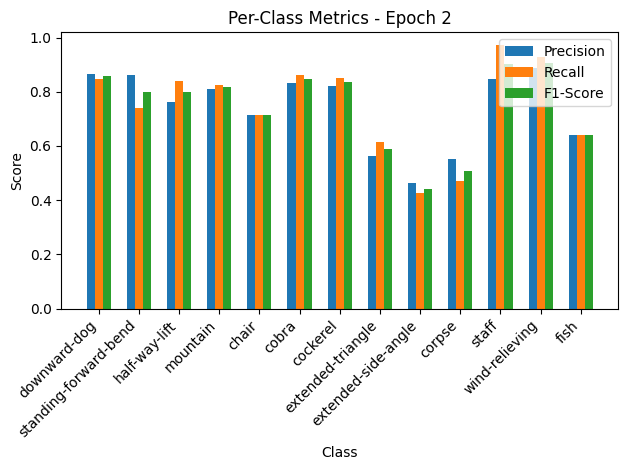

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.89it/s, loss=0.65, accuracy=72.6]


Per-Class Metrics for Epoch 2:
downward-dog: Precision=0.83, Recall=0.25, F1-Score=0.38
standing-forward-bend: Precision=0.92, Recall=0.67, F1-Score=0.77
half-way-lift: Precision=0.88, Recall=0.82, F1-Score=0.85
mountain: Precision=0.65, Recall=1.00, F1-Score=0.79
chair: Precision=0.73, Recall=0.73, F1-Score=0.73
cobra: Precision=0.77, Recall=1.00, F1-Score=0.87
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.60, Recall=0.67, F1-Score=0.63
extended-side-angle: Precision=0.35, Recall=0.88, F1-Score=0.50
corpse: Precision=0.62, Recall=0.62, F1-Score=0.62
staff: Precision=1.00, Recall=0.71, F1-Score=0.83
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.57, Recall=0.50, F1-Score=0.53


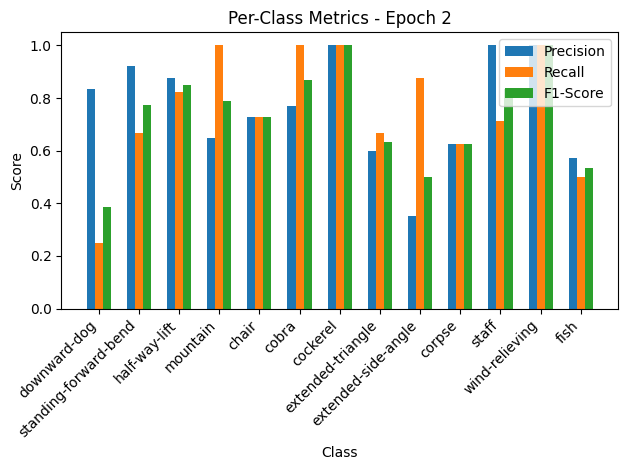


Epoch 3/50 Summary:
Train Loss: 0.6994 | Train Acc: 76.47% | Train Precision: 0.74 | Train Recall: 0.75 | Train F1: 0.74
Val Loss: 0.7128 | Val Acc: 72.60% | Val Precision: 0.76 | Val Recall: 0.76 | Val F1: 0.73
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 3
New best model saved! Validation Loss: 0.7128

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.30it/s, loss=0.665, accuracy=78.5]


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.91
standing-forward-bend: Precision=0.87, Recall=0.76, F1-Score=0.81
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.80, Recall=0.81, F1-Score=0.80
chair: Precision=0.81, Recall=0.78, F1-Score=0.79
cobra: Precision=0.81, Recall=0.82, F1-Score=0.81
cockerel: Precision=0.83, Recall=0.81, F1-Score=0.82
extended-triangle: Precision=0.71, Recall=0.72, F1-Score=0.71
extended-side-angle: Precision=0.58, Recall=0.66, F1-Score=0.62
corpse: Precision=0.44, Recall=0.40, F1-Score=0.42
staff: Precision=0.87, Recall=0.96, F1-Score=0.91
wind-relieving: Precision=0.86, Recall=0.91, F1-Score=0.89
fish: Precision=0.50, Recall=0.51, F1-Score=0.50


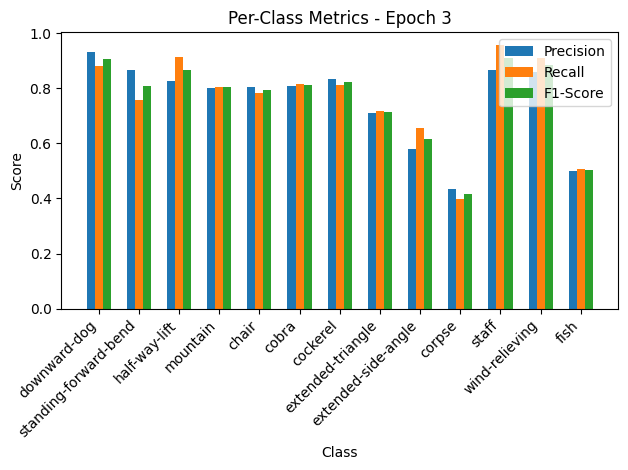

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.37it/s, loss=0.824, accuracy=74]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 3:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=1.00, Recall=0.33, F1-Score=0.50
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=0.73, Recall=0.85, F1-Score=0.79
chair: Precision=0.71, Recall=0.91, F1-Score=0.80
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=0.83, Recall=1.00, F1-Score=0.91
extended-triangle: Precision=0.56, Recall=1.00, F1-Score=0.72
extended-side-angle: Precision=0.80, Recall=0.50, F1-Score=0.62
corpse: Precision=0.43, Recall=0.38, F1-Score=0.40
staff: Precision=0.44, Recall=1.00, F1-Score=0.61
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


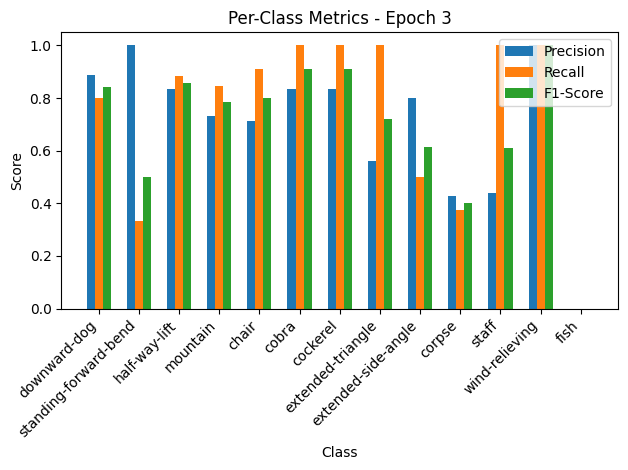


Epoch 4/50 Summary:
Train Loss: 0.6664 | Train Acc: 78.53% | Train Precision: 0.76 | Train Recall: 0.76 | Train F1: 0.76
Val Loss: 0.9032 | Val Acc: 73.97% | Val Precision: 0.70 | Val Recall: 0.74 | Val F1: 0.69

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.43it/s, loss=0.584, accuracy=79.8]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.87, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.85, F1-Score=0.83
mountain: Precision=0.80, Recall=0.79, F1-Score=0.79
chair: Precision=0.75, Recall=0.81, F1-Score=0.78
cobra: Precision=0.89, Recall=0.96, F1-Score=0.92
cockerel: Precision=0.81, Recall=0.80, F1-Score=0.81
extended-triangle: Precision=0.73, Recall=0.67, F1-Score=0.70
extended-side-angle: Precision=0.61, Recall=0.64, F1-Score=0.63
corpse: Precision=0.54, Recall=0.49, F1-Score=0.51
staff: Precision=0.86, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.90, Recall=0.94, F1-Score=0.92
fish: Precision=0.58, Recall=0.57, F1-Score=0.57


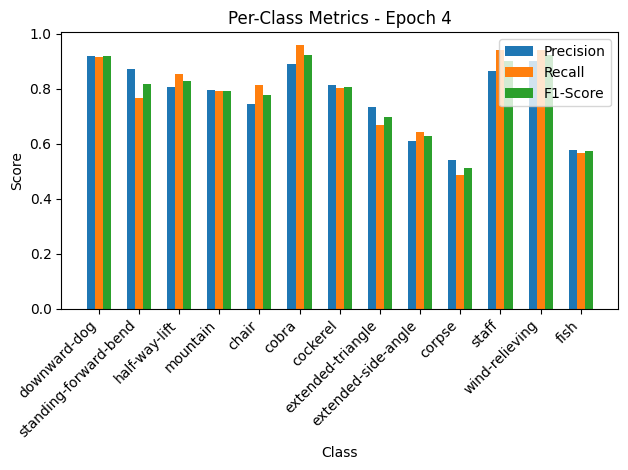

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.22it/s, loss=0.489, accuracy=82.9]


Per-Class Metrics for Epoch 4:
downward-dog: Precision=0.94, Recall=0.75, F1-Score=0.83
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.76, Recall=1.00, F1-Score=0.87
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=0.71, Recall=1.00, F1-Score=0.83
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.67, F1-Score=0.80
extended-side-angle: Precision=0.70, Recall=0.88, F1-Score=0.78
corpse: Precision=1.00, Recall=0.25, F1-Score=0.40
staff: Precision=0.64, Recall=1.00, F1-Score=0.78
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


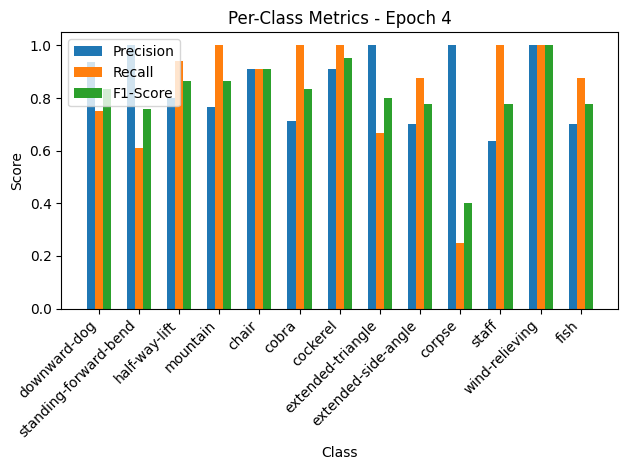


Epoch 5/50 Summary:
Train Loss: 0.5850 | Train Acc: 79.83% | Train Precision: 0.77 | Train Recall: 0.78 | Train F1: 0.78
Val Loss: 0.5354 | Val Acc: 82.88% | Val Precision: 0.85 | Val Recall: 0.84 | Val F1: 0.81
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 5
New best model saved! Validation Loss: 0.5354

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.608, accuracy=81.3]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.95, Recall=0.89, F1-Score=0.91
standing-forward-bend: Precision=0.89, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.81, Recall=0.85, F1-Score=0.83
mountain: Precision=0.80, Recall=0.85, F1-Score=0.82
chair: Precision=0.73, Recall=0.81, F1-Score=0.77
cobra: Precision=0.88, Recall=0.89, F1-Score=0.89
cockerel: Precision=0.83, Recall=0.85, F1-Score=0.84
extended-triangle: Precision=0.82, Recall=0.76, F1-Score=0.79
extended-side-angle: Precision=0.72, Recall=0.79, F1-Score=0.76
corpse: Precision=0.53, Recall=0.54, F1-Score=0.54
staff: Precision=0.89, Recall=0.91, F1-Score=0.90
wind-relieving: Precision=0.91, Recall=0.85, F1-Score=0.88
fish: Precision=0.60, Recall=0.63, F1-Score=0.61


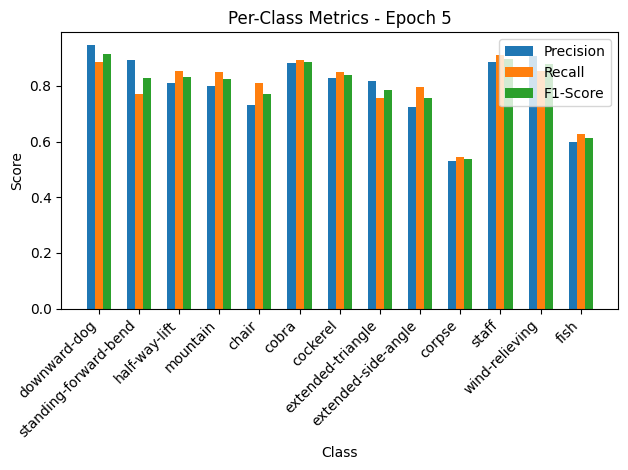

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.81it/s, loss=0.431, accuracy=88.4]


Per-Class Metrics for Epoch 5:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=1.00, F1-Score=1.00
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.75, Recall=0.38, F1-Score=0.50
staff: Precision=0.54, Recall=1.00, F1-Score=0.70
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.64, Recall=0.88, F1-Score=0.74


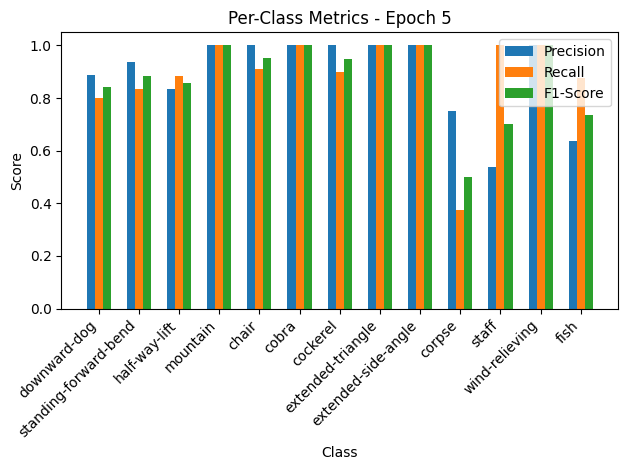


Epoch 6/50 Summary:
Train Loss: 0.6099 | Train Acc: 81.28% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.4719 | Val Acc: 88.36% | Val Precision: 0.89 | Val Recall: 0.89 | Val F1: 0.88
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 6
New best model saved! Validation Loss: 0.4719

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.74it/s, loss=0.519, accuracy=83.3]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.86, Recall=0.78, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.89, F1-Score=0.85
mountain: Precision=0.85, Recall=0.87, F1-Score=0.86
chair: Precision=0.86, Recall=0.84, F1-Score=0.85
cobra: Precision=0.91, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.88, Recall=0.92, F1-Score=0.90
extended-triangle: Precision=0.81, Recall=0.83, F1-Score=0.82
extended-side-angle: Precision=0.74, Recall=0.73, F1-Score=0.73
corpse: Precision=0.51, Recall=0.49, F1-Score=0.50
staff: Precision=0.94, Recall=0.94, F1-Score=0.94
wind-relieving: Precision=0.94, Recall=0.91, F1-Score=0.93
fish: Precision=0.55, Recall=0.58, F1-Score=0.57


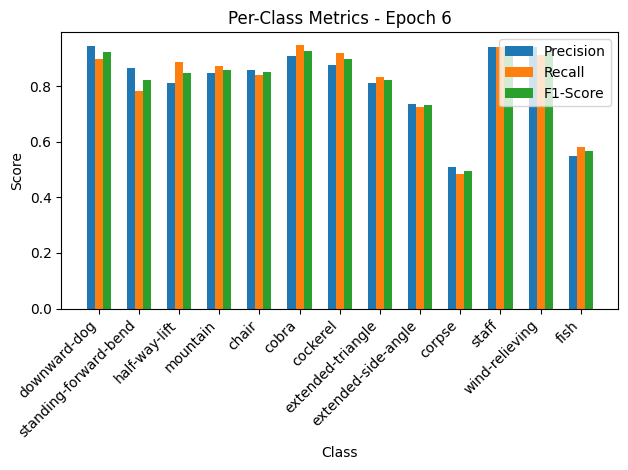

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.13it/s, loss=0.39, accuracy=84.9]


Per-Class Metrics for Epoch 6:
downward-dog: Precision=0.88, Recall=0.75, F1-Score=0.81
standing-forward-bend: Precision=0.65, Recall=0.94, F1-Score=0.77
half-way-lift: Precision=0.78, Recall=0.41, F1-Score=0.54
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=0.91, Recall=1.00, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=0.78, Recall=1.00, F1-Score=0.88
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.78, Recall=0.88, F1-Score=0.82


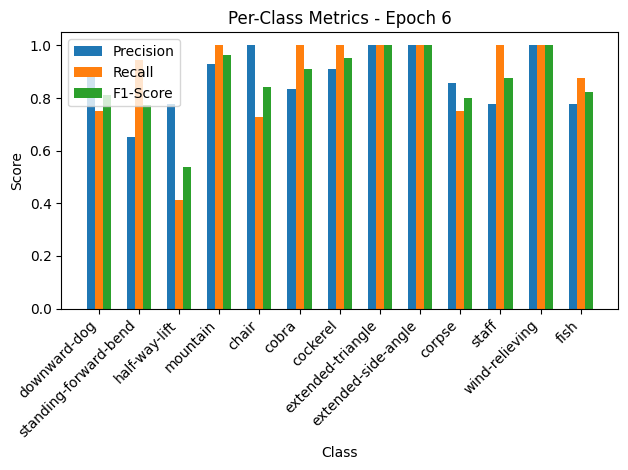


Epoch 7/50 Summary:
Train Loss: 0.5206 | Train Acc: 83.27% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.4270 | Val Acc: 84.93% | Val Precision: 0.88 | Val Recall: 0.88 | Val F1: 0.87
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 7
New best model saved! Validation Loss: 0.4270

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.48it/s, loss=0.503, accuracy=83.4]


Per-Class Metrics for Epoch 7:
downward-dog: Precision=0.97, Recall=0.91, F1-Score=0.94
standing-forward-bend: Precision=0.89, Recall=0.79, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.91, F1-Score=0.87
mountain: Precision=0.82, Recall=0.88, F1-Score=0.85
chair: Precision=0.86, Recall=0.76, F1-Score=0.81
cobra: Precision=0.89, Recall=0.95, F1-Score=0.92
cockerel: Precision=0.84, Recall=0.84, F1-Score=0.84
extended-triangle: Precision=0.85, Recall=0.85, F1-Score=0.85
extended-side-angle: Precision=0.71, Recall=0.75, F1-Score=0.73
corpse: Precision=0.54, Recall=0.56, F1-Score=0.55
staff: Precision=0.88, Recall=0.94, F1-Score=0.91
wind-relieving: Precision=0.91, Recall=0.94, F1-Score=0.93
fish: Precision=0.60, Recall=0.55, F1-Score=0.57


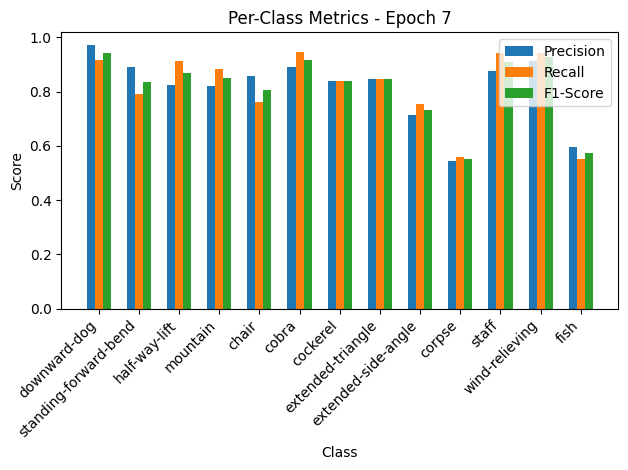

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.61it/s, loss=0.759, accuracy=71.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 7:
downward-dog: Precision=1.00, Recall=0.30, F1-Score=0.46
standing-forward-bend: Precision=1.00, Recall=0.78, F1-Score=0.88
half-way-lift: Precision=0.74, Recall=1.00, F1-Score=0.85
mountain: Precision=0.79, Recall=0.85, F1-Score=0.81
chair: Precision=0.78, Recall=0.64, F1-Score=0.70
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.78, Recall=0.88, F1-Score=0.82
corpse: Precision=0.32, Recall=1.00, F1-Score=0.48
staff: Precision=0.56, Recall=0.71, F1-Score=0.62
wind-relieving: Precision=0.00, Recall=0.00, F1-Score=0.00
fish: Precision=0.40, Recall=0.50, F1-Score=0.44


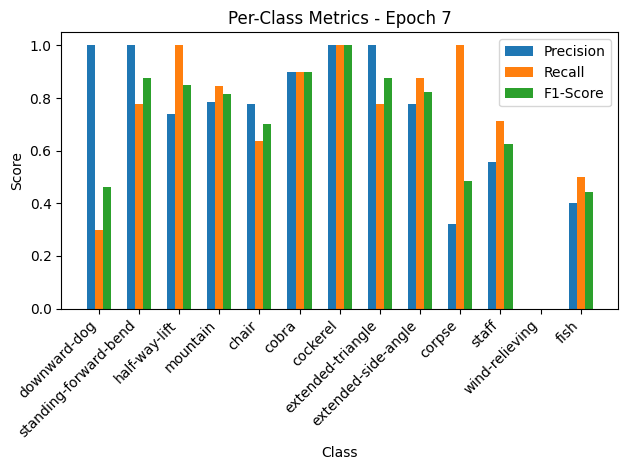


Epoch 8/50 Summary:
Train Loss: 0.5041 | Train Acc: 83.42% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.8317 | Val Acc: 71.92% | Val Precision: 0.71 | Val Recall: 0.72 | Val F1: 0.68

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.66it/s, loss=0.485, accuracy=83.7]


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.93
standing-forward-bend: Precision=0.88, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.82, Recall=0.85, F1-Score=0.83
mountain: Precision=0.86, Recall=0.90, F1-Score=0.88
chair: Precision=0.83, Recall=0.84, F1-Score=0.83
cobra: Precision=0.93, Recall=0.97, F1-Score=0.95
cockerel: Precision=0.87, Recall=0.91, F1-Score=0.89
extended-triangle: Precision=0.75, Recall=0.77, F1-Score=0.76
extended-side-angle: Precision=0.74, Recall=0.73, F1-Score=0.73
corpse: Precision=0.61, Recall=0.63, F1-Score=0.62
staff: Precision=0.86, Recall=0.94, F1-Score=0.90
wind-relieving: Precision=0.91, Recall=0.91, F1-Score=0.91
fish: Precision=0.68, Recall=0.61, F1-Score=0.65


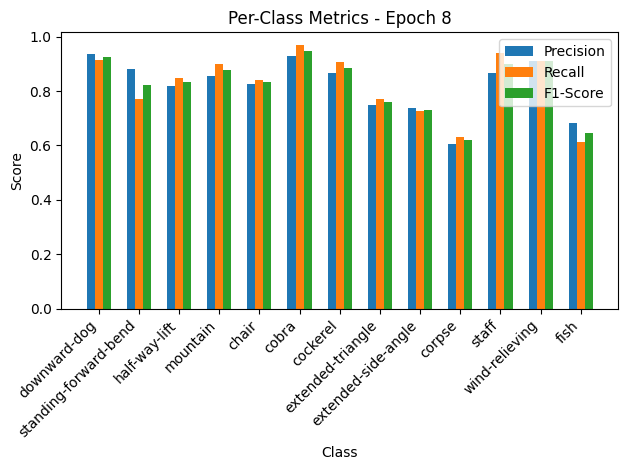

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.85it/s, loss=0.424, accuracy=84.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 8:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=0.93, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=0.87, Recall=1.00, F1-Score=0.93
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.71, Recall=1.00, F1-Score=0.83
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=0.00, Recall=0.00, F1-Score=0.00
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.50, Recall=1.00, F1-Score=0.67


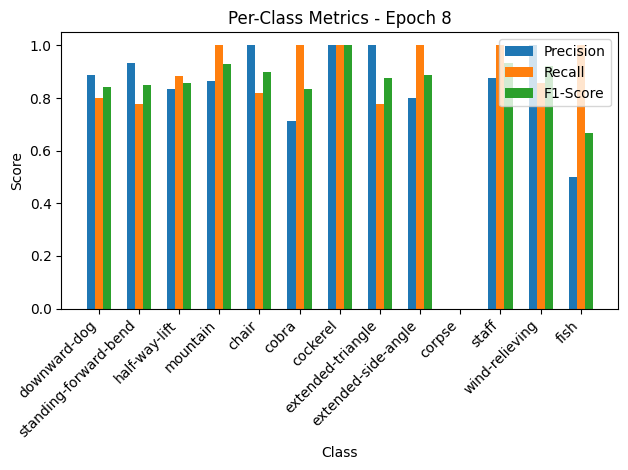


Epoch 9/50 Summary:
Train Loss: 0.4860 | Train Acc: 83.73% | Train Precision: 0.82 | Train Recall: 0.83 | Train F1: 0.82
Val Loss: 0.4649 | Val Acc: 84.25% | Val Precision: 0.80 | Val Recall: 0.84 | Val F1: 0.81

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.02it/s, loss=0.48, accuracy=83.4]


Per-Class Metrics for Epoch 9:
downward-dog: Precision=0.94, Recall=0.93, F1-Score=0.93
standing-forward-bend: Precision=0.89, Recall=0.77, F1-Score=0.83
half-way-lift: Precision=0.83, Recall=0.85, F1-Score=0.84
mountain: Precision=0.83, Recall=0.89, F1-Score=0.86
chair: Precision=0.82, Recall=0.83, F1-Score=0.83
cobra: Precision=0.91, Recall=0.95, F1-Score=0.93
cockerel: Precision=0.89, Recall=0.90, F1-Score=0.89
extended-triangle: Precision=0.81, Recall=0.85, F1-Score=0.83
extended-side-angle: Precision=0.75, Recall=0.74, F1-Score=0.74
corpse: Precision=0.55, Recall=0.43, F1-Score=0.48
staff: Precision=0.88, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.96, Recall=0.96, F1-Score=0.96
fish: Precision=0.54, Recall=0.66, F1-Score=0.59


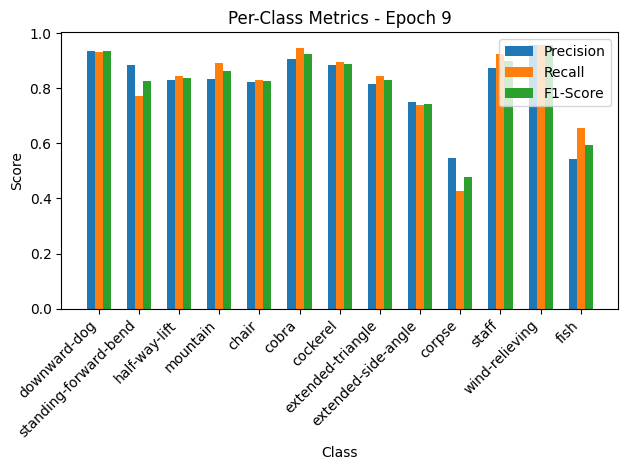

Validation: 100%|██████████| 10/10 [00:00<00:00, 30.43it/s, loss=0.49, accuracy=84.2]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 9:
downward-dog: Precision=1.00, Recall=0.85, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.73, Recall=0.94, F1-Score=0.82
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.90, Recall=0.90, F1-Score=0.90
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.89, F1-Score=0.94
extended-side-angle: Precision=0.67, Recall=1.00, F1-Score=0.80
corpse: Precision=0.47, Recall=1.00, F1-Score=0.64
staff: Precision=0.83, Recall=0.71, F1-Score=0.77
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


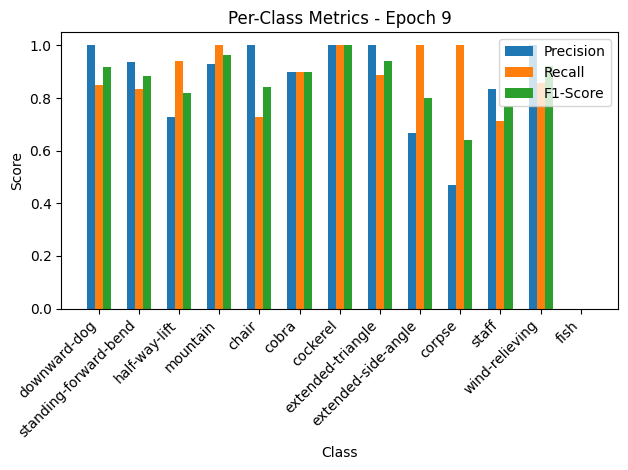


Epoch 10/50 Summary:
Train Loss: 0.4807 | Train Acc: 83.42% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.82
Val Loss: 0.5369 | Val Acc: 84.25% | Val Precision: 0.80 | Val Recall: 0.82 | Val F1: 0.80

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.63it/s, loss=0.562, accuracy=81.7]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.88, Recall=0.77, F1-Score=0.82
half-way-lift: Precision=0.81, Recall=0.87, F1-Score=0.84
mountain: Precision=0.86, Recall=0.92, F1-Score=0.89
chair: Precision=0.85, Recall=0.81, F1-Score=0.83
cobra: Precision=0.85, Recall=0.88, F1-Score=0.86
cockerel: Precision=0.86, Recall=0.87, F1-Score=0.87
extended-triangle: Precision=0.67, Recall=0.76, F1-Score=0.71
extended-side-angle: Precision=0.67, Recall=0.58, F1-Score=0.62
corpse: Precision=0.60, Recall=0.54, F1-Score=0.57
staff: Precision=0.81, Recall=0.94, F1-Score=0.87
wind-relieving: Precision=0.95, Recall=0.91, F1-Score=0.93
fish: Precision=0.59, Recall=0.66, F1-Score=0.62


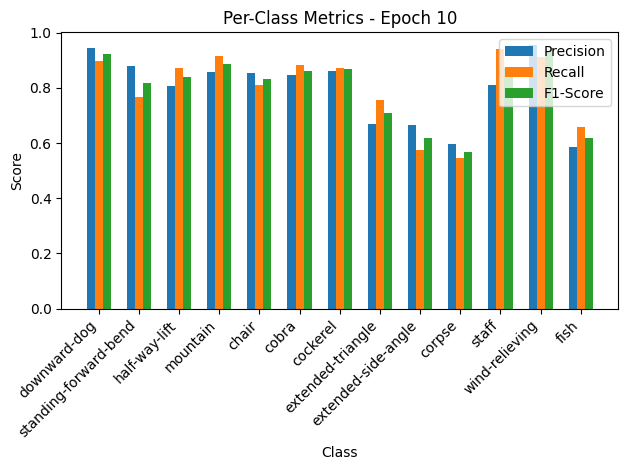

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.38it/s, loss=0.491, accuracy=85.6]


Per-Class Metrics for Epoch 10:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.79, Recall=0.88, F1-Score=0.83
mountain: Precision=0.92, Recall=0.92, F1-Score=0.92
chair: Precision=1.00, Recall=0.36, F1-Score=0.53
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=0.89, Recall=0.89, F1-Score=0.89
extended-side-angle: Precision=0.57, Recall=1.00, F1-Score=0.73
corpse: Precision=0.67, Recall=0.75, F1-Score=0.71
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.71, F1-Score=0.83
fish: Precision=0.78, Recall=0.88, F1-Score=0.82


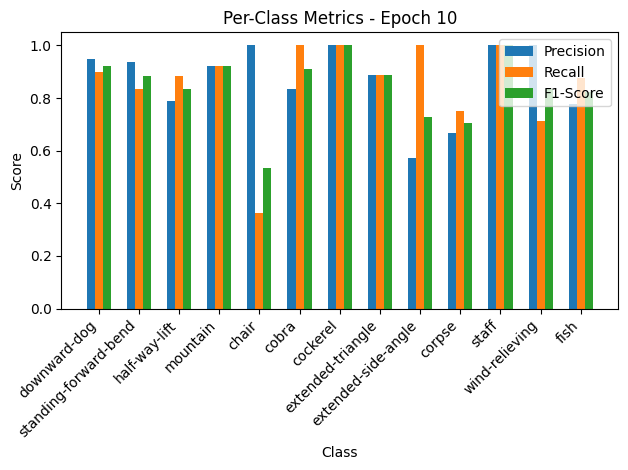


Epoch 11/50 Summary:
Train Loss: 0.5628 | Train Acc: 81.67% | Train Precision: 0.80 | Train Recall: 0.80 | Train F1: 0.80
Val Loss: 0.5380 | Val Acc: 85.62% | Val Precision: 0.87 | Val Recall: 0.86 | Val F1: 0.84

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.23it/s, loss=0.524, accuracy=82.5]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.93, Recall=0.88, F1-Score=0.90
standing-forward-bend: Precision=0.90, Recall=0.78, F1-Score=0.84
half-way-lift: Precision=0.83, Recall=0.87, F1-Score=0.85
mountain: Precision=0.88, Recall=0.92, F1-Score=0.90
chair: Precision=0.85, Recall=0.87, F1-Score=0.86
cobra: Precision=0.88, Recall=0.94, F1-Score=0.91
cockerel: Precision=0.81, Recall=0.87, F1-Score=0.84
extended-triangle: Precision=0.72, Recall=0.73, F1-Score=0.73
extended-side-angle: Precision=0.68, Recall=0.70, F1-Score=0.69
corpse: Precision=0.59, Recall=0.51, F1-Score=0.55
staff: Precision=0.93, Recall=0.99, F1-Score=0.96
wind-relieving: Precision=0.85, Recall=0.82, F1-Score=0.84
fish: Precision=0.59, Recall=0.66, F1-Score=0.62


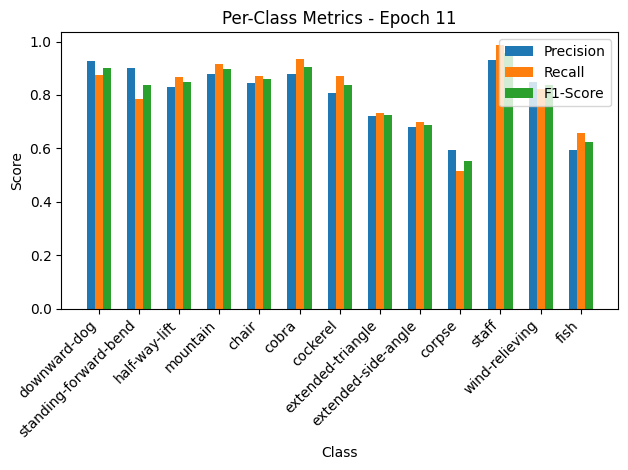

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.09it/s, loss=0.389, accuracy=87.7]


Per-Class Metrics for Epoch 11:
downward-dog: Precision=0.91, Recall=1.00, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.85, Recall=1.00, F1-Score=0.92
mountain: Precision=0.76, Recall=1.00, F1-Score=0.87
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.67, Recall=1.00, F1-Score=0.80
corpse: Precision=1.00, Recall=0.38, F1-Score=0.55
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.62, Recall=1.00, F1-Score=0.76


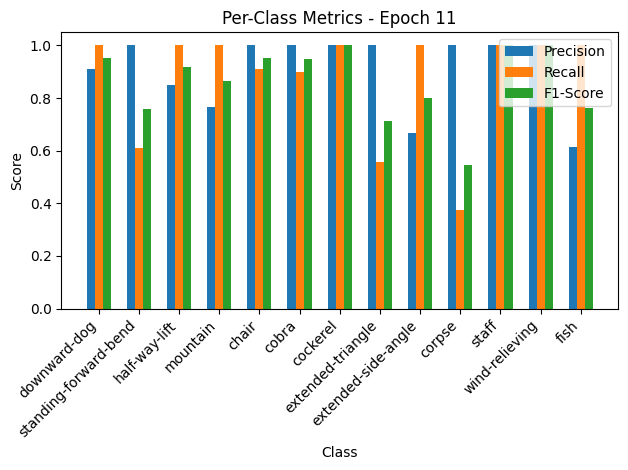


Epoch 12/50 Summary:
Train Loss: 0.5255 | Train Acc: 82.51% | Train Precision: 0.80 | Train Recall: 0.81 | Train F1: 0.81
Val Loss: 0.4261 | Val Acc: 87.67% | Val Precision: 0.91 | Val Recall: 0.87 | Val F1: 0.86
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 12
New best model saved! Validation Loss: 0.4261

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.39it/s, loss=0.531, accuracy=81.6]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.94, Recall=0.91, F1-Score=0.92
standing-forward-bend: Precision=0.92, Recall=0.78, F1-Score=0.85
half-way-lift: Precision=0.81, Recall=0.87, F1-Score=0.84
mountain: Precision=0.81, Recall=0.90, F1-Score=0.85
chair: Precision=0.83, Recall=0.79, F1-Score=0.81
cobra: Precision=0.93, Recall=0.92, F1-Score=0.93
cockerel: Precision=0.86, Recall=0.78, F1-Score=0.82
extended-triangle: Precision=0.74, Recall=0.72, F1-Score=0.73
extended-side-angle: Precision=0.71, Recall=0.71, F1-Score=0.71
corpse: Precision=0.53, Recall=0.51, F1-Score=0.52
staff: Precision=0.75, Recall=0.94, F1-Score=0.84
wind-relieving: Precision=0.89, Recall=0.94, F1-Score=0.91
fish: Precision=0.56, Recall=0.58, F1-Score=0.57


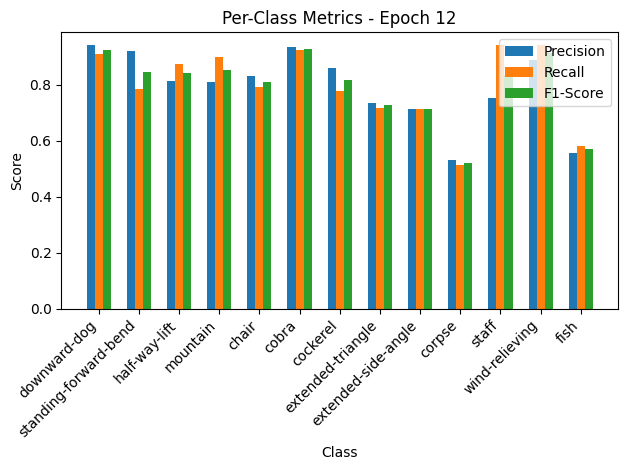

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.01it/s, loss=0.454, accuracy=86.3]


Per-Class Metrics for Epoch 12:
downward-dog: Precision=0.88, Recall=0.75, F1-Score=0.81
standing-forward-bend: Precision=1.00, Recall=0.67, F1-Score=0.80
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.76, Recall=1.00, F1-Score=0.87
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.71, Recall=1.00, F1-Score=0.83
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=0.62, F1-Score=0.77
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.67, Recall=1.00, F1-Score=0.80


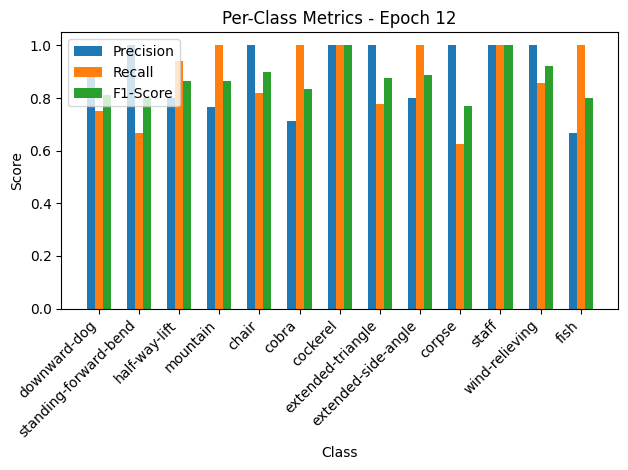


Epoch 13/50 Summary:
Train Loss: 0.5326 | Train Acc: 81.59% | Train Precision: 0.79 | Train Recall: 0.80 | Train F1: 0.79
Val Loss: 0.4973 | Val Acc: 86.30% | Val Precision: 0.89 | Val Recall: 0.88 | Val F1: 0.87

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.63it/s, loss=0.469, accuracy=86]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.91, Recall=0.80, F1-Score=0.85
half-way-lift: Precision=0.84, Recall=0.91, F1-Score=0.87
mountain: Precision=0.88, Recall=0.97, F1-Score=0.92
chair: Precision=0.90, Recall=0.89, F1-Score=0.90
cobra: Precision=0.88, Recall=0.97, F1-Score=0.92
cockerel: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-triangle: Precision=0.79, Recall=0.79, F1-Score=0.79
extended-side-angle: Precision=0.77, Recall=0.74, F1-Score=0.76
corpse: Precision=0.63, Recall=0.46, F1-Score=0.53
staff: Precision=0.94, Recall=0.91, F1-Score=0.93
wind-relieving: Precision=0.94, Recall=0.94, F1-Score=0.94
fish: Precision=0.60, Recall=0.75, F1-Score=0.66


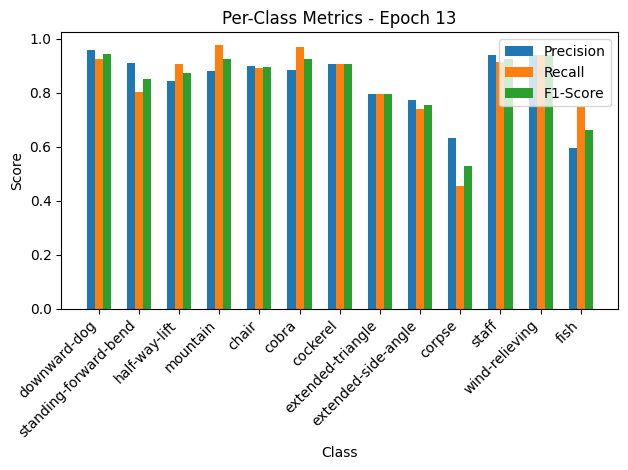

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.42it/s, loss=0.525, accuracy=87]


Per-Class Metrics for Epoch 13:
downward-dog: Precision=0.86, Recall=0.95, F1-Score=0.90
standing-forward-bend: Precision=1.00, Recall=0.83, F1-Score=0.91
half-way-lift: Precision=0.76, Recall=0.94, F1-Score=0.84
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.55, F1-Score=0.71
cobra: Precision=1.00, Recall=0.90, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.56, F1-Score=0.71
extended-side-angle: Precision=0.67, Recall=1.00, F1-Score=0.80
corpse: Precision=0.86, Recall=0.75, F1-Score=0.80
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.70, Recall=0.88, F1-Score=0.78


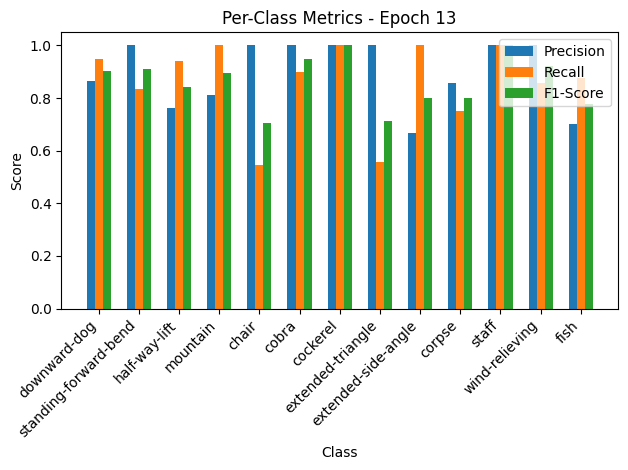


Epoch 14/50 Summary:
Train Loss: 0.4703 | Train Acc: 86.02% | Train Precision: 0.84 | Train Recall: 0.84 | Train F1: 0.84
Val Loss: 0.5756 | Val Acc: 86.99% | Val Precision: 0.90 | Val Recall: 0.86 | Val F1: 0.86

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.22it/s, loss=0.537, accuracy=83.4]


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.92, Recall=0.91, F1-Score=0.91
standing-forward-bend: Precision=0.90, Recall=0.82, F1-Score=0.86
half-way-lift: Precision=0.83, Recall=0.93, F1-Score=0.88
mountain: Precision=0.86, Recall=0.85, F1-Score=0.85
chair: Precision=0.89, Recall=0.82, F1-Score=0.86
cobra: Precision=0.93, Recall=0.95, F1-Score=0.94
cockerel: Precision=0.83, Recall=0.84, F1-Score=0.83
extended-triangle: Precision=0.79, Recall=0.69, F1-Score=0.74
extended-side-angle: Precision=0.67, Recall=0.79, F1-Score=0.73
corpse: Precision=0.62, Recall=0.56, F1-Score=0.59
staff: Precision=0.89, Recall=0.91, F1-Score=0.90
wind-relieving: Precision=0.85, Recall=0.85, F1-Score=0.85
fish: Precision=0.62, Recall=0.67, F1-Score=0.64


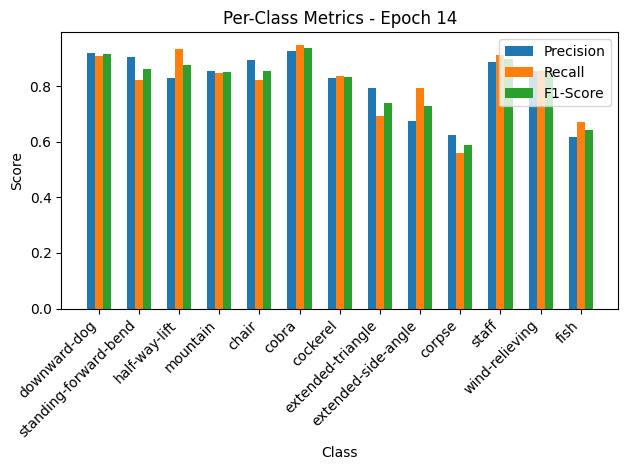

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.65it/s, loss=0.532, accuracy=81.5]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 14:
downward-dog: Precision=0.83, Recall=0.95, F1-Score=0.88
standing-forward-bend: Precision=1.00, Recall=0.61, F1-Score=0.76
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=0.76, Recall=1.00, F1-Score=0.87
chair: Precision=0.91, Recall=0.91, F1-Score=0.91
cobra: Precision=1.00, Recall=0.80, F1-Score=0.89
cockerel: Precision=1.00, Recall=0.90, F1-Score=0.95
extended-triangle: Precision=1.00, Recall=0.33, F1-Score=0.50
extended-side-angle: Precision=0.57, Recall=1.00, F1-Score=0.73
corpse: Precision=0.50, Recall=1.00, F1-Score=0.67
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


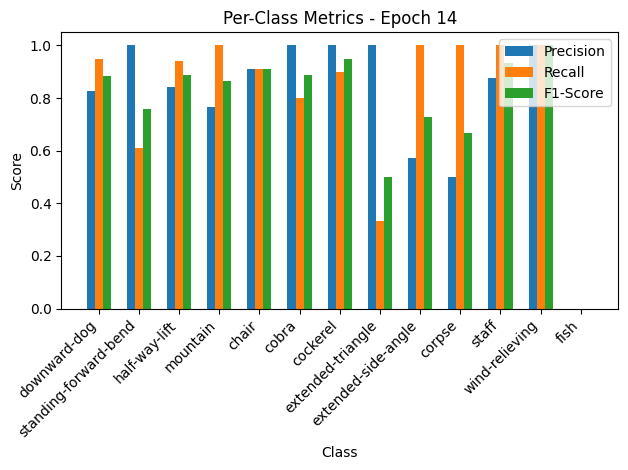


Epoch 15/50 Summary:
Train Loss: 0.5381 | Train Acc: 83.42% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.81
Val Loss: 0.5829 | Val Acc: 81.51% | Val Precision: 0.79 | Val Recall: 0.80 | Val F1: 0.77

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.59it/s, loss=0.515, accuracy=84.6]


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.92, Recall=0.93, F1-Score=0.92
standing-forward-bend: Precision=0.93, Recall=0.77, F1-Score=0.84
half-way-lift: Precision=0.85, Recall=0.87, F1-Score=0.86
mountain: Precision=0.84, Recall=0.90, F1-Score=0.87
chair: Precision=0.87, Recall=0.88, F1-Score=0.88
cobra: Precision=0.88, Recall=0.98, F1-Score=0.92
cockerel: Precision=0.88, Recall=0.88, F1-Score=0.88
extended-triangle: Precision=0.78, Recall=0.82, F1-Score=0.80
extended-side-angle: Precision=0.81, Recall=0.77, F1-Score=0.79
corpse: Precision=0.61, Recall=0.63, F1-Score=0.62
staff: Precision=0.88, Recall=0.93, F1-Score=0.90
wind-relieving: Precision=0.85, Recall=0.91, F1-Score=0.88
fish: Precision=0.65, Recall=0.55, F1-Score=0.60


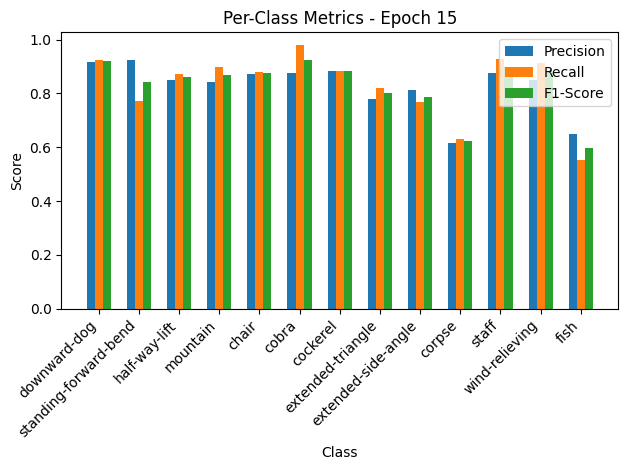

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.21it/s, loss=0.393, accuracy=84.9]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Per-Class Metrics for Epoch 15:
downward-dog: Precision=0.93, Recall=0.70, F1-Score=0.80
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.80, Recall=0.94, F1-Score=0.86
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.67, Recall=1.00, F1-Score=0.80
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=0.89, Recall=1.00, F1-Score=0.94
corpse: Precision=0.47, Recall=0.88, F1-Score=0.61
staff: Precision=0.88, Recall=1.00, F1-Score=0.93
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.00, Recall=0.00, F1-Score=0.00


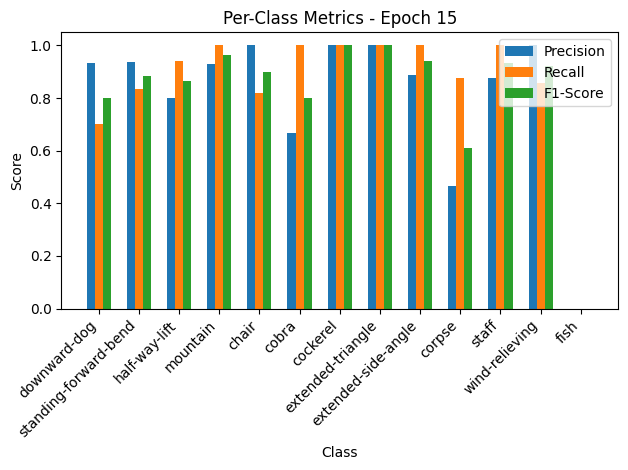


Epoch 16/50 Summary:
Train Loss: 0.5157 | Train Acc: 84.57% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.4307 | Val Acc: 84.93% | Val Precision: 0.81 | Val Recall: 0.85 | Val F1: 0.82

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.33it/s, loss=0.505, accuracy=85.2]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.96, Recall=0.93, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=0.81, F1-Score=0.87
half-way-lift: Precision=0.86, Recall=0.92, F1-Score=0.89
mountain: Precision=0.88, Recall=0.97, F1-Score=0.92
chair: Precision=0.88, Recall=0.86, F1-Score=0.87
cobra: Precision=0.90, Recall=0.97, F1-Score=0.93
cockerel: Precision=0.92, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.78, Recall=0.76, F1-Score=0.77
extended-side-angle: Precision=0.73, Recall=0.71, F1-Score=0.72
corpse: Precision=0.54, Recall=0.72, F1-Score=0.62
staff: Precision=0.89, Recall=0.93, F1-Score=0.91
wind-relieving: Precision=0.89, Recall=0.84, F1-Score=0.86
fish: Precision=0.60, Recall=0.45, F1-Score=0.51


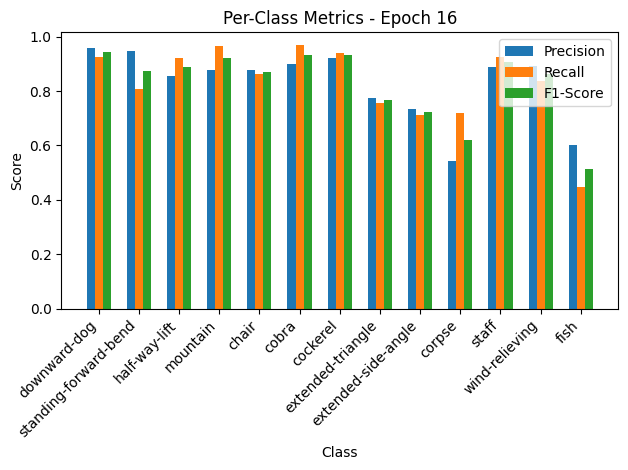

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.96it/s, loss=0.436, accuracy=82.2]


Per-Class Metrics for Epoch 16:
downward-dog: Precision=0.89, Recall=0.80, F1-Score=0.84
standing-forward-bend: Precision=0.92, Recall=0.67, F1-Score=0.77
half-way-lift: Precision=0.83, Recall=0.88, F1-Score=0.86
mountain: Precision=0.72, Recall=1.00, F1-Score=0.84
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.62, Recall=1.00, F1-Score=0.77
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=0.78, F1-Score=0.88
extended-side-angle: Precision=0.80, Recall=1.00, F1-Score=0.89
corpse: Precision=1.00, Recall=0.12, F1-Score=0.22
staff: Precision=1.00, Recall=0.71, F1-Score=0.83
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.50, Recall=0.88, F1-Score=0.64


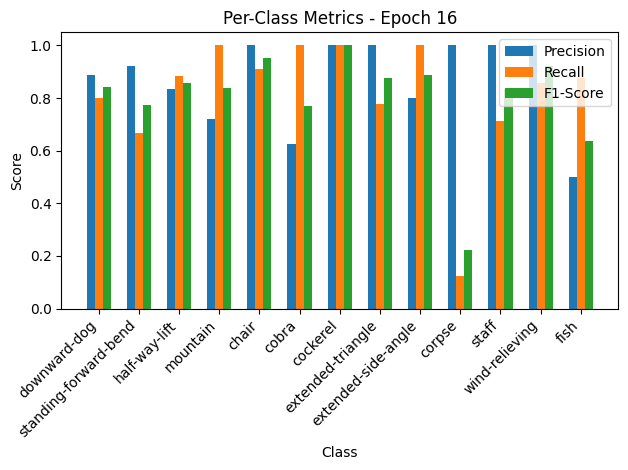


Epoch 17/50 Summary:
Train Loss: 0.5059 | Train Acc: 85.18% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83
Val Loss: 0.4782 | Val Acc: 82.19% | Val Precision: 0.87 | Val Recall: 0.82 | Val F1: 0.80

Epoch 18/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.01it/s, loss=0.343, accuracy=90.2]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.96, Recall=0.92, F1-Score=0.94
standing-forward-bend: Precision=0.95, Recall=0.85, F1-Score=0.90
half-way-lift: Precision=0.88, Recall=0.93, F1-Score=0.90
mountain: Precision=0.88, Recall=0.96, F1-Score=0.92
chair: Precision=0.93, Recall=0.89, F1-Score=0.91
cobra: Precision=0.94, Recall=0.99, F1-Score=0.96
cockerel: Precision=0.93, Recall=0.97, F1-Score=0.95
extended-triangle: Precision=0.90, Recall=0.91, F1-Score=0.90
extended-side-angle: Precision=0.89, Recall=0.89, F1-Score=0.89
corpse: Precision=0.71, Recall=0.68, F1-Score=0.69
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.67, Recall=0.72, F1-Score=0.69


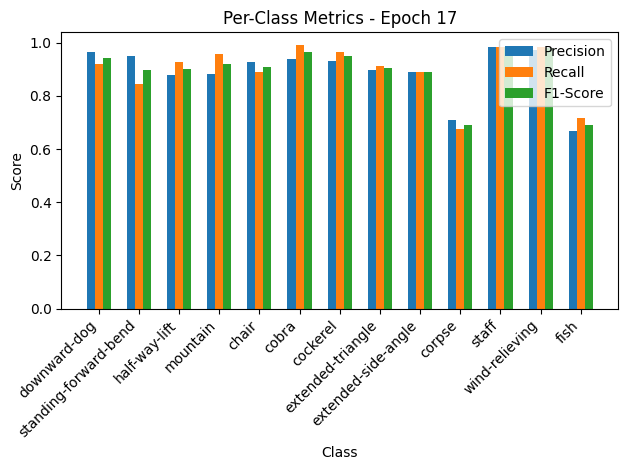

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.30it/s, loss=0.215, accuracy=93.8]


Per-Class Metrics for Epoch 17:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.83, F1-Score=0.88
half-way-lift: Precision=0.84, Recall=0.94, F1-Score=0.89
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.88, Recall=0.88, F1-Score=0.88


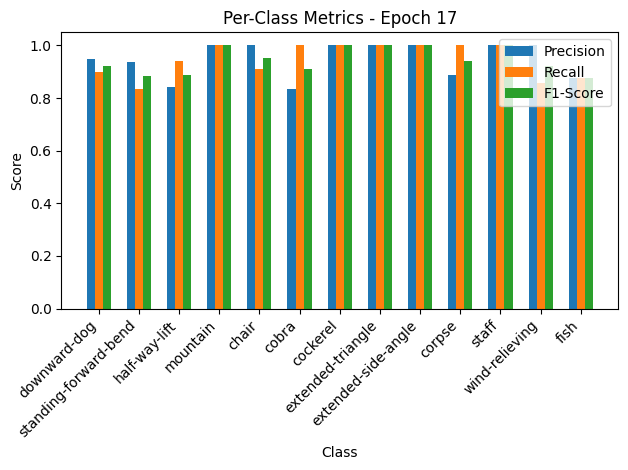


Epoch 18/50 Summary:
Train Loss: 0.3440 | Train Acc: 90.22% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89
Val Loss: 0.2351 | Val Acc: 93.84% | Val Precision: 0.95 | Val Recall: 0.95 | Val F1: 0.95
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 18
New best model saved! Validation Loss: 0.2351

Epoch 19/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.10it/s, loss=0.301, accuracy=91.7]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.97, Recall=0.94, F1-Score=0.95
standing-forward-bend: Precision=0.97, Recall=0.88, F1-Score=0.92
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.91, Recall=0.97, F1-Score=0.93
chair: Precision=0.93, Recall=0.88, F1-Score=0.90
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.91, Recall=0.94, F1-Score=0.93
extended-triangle: Precision=0.91, Recall=0.91, F1-Score=0.91
extended-side-angle: Precision=0.87, Recall=0.93, F1-Score=0.90
corpse: Precision=0.82, Recall=0.68, F1-Score=0.74
staff: Precision=0.98, Recall=0.96, F1-Score=0.97
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.74, Recall=0.85, F1-Score=0.79


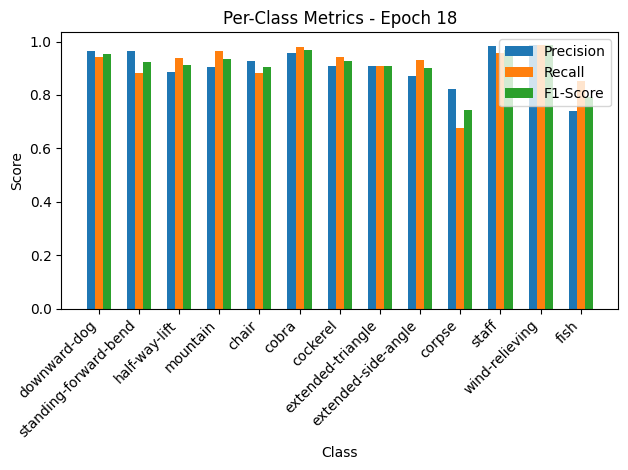

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.84it/s, loss=0.216, accuracy=95.2]


Per-Class Metrics for Epoch 18:
downward-dog: Precision=0.90, Recall=0.90, F1-Score=0.90
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.88, F1-Score=0.91
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


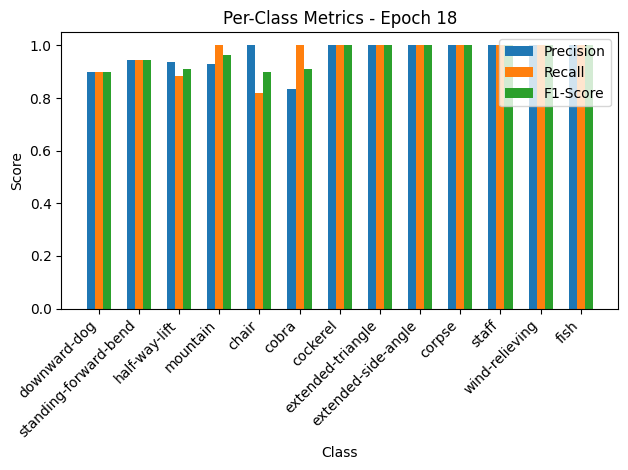


Epoch 19/50 Summary:
Train Loss: 0.3020 | Train Acc: 91.67% | Train Precision: 0.91 | Train Recall: 0.91 | Train F1: 0.91
Val Loss: 0.2372 | Val Acc: 95.21% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 20/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.01it/s, loss=0.261, accuracy=93.1]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.86, F1-Score=0.91
half-way-lift: Precision=0.90, Recall=0.95, F1-Score=0.93
mountain: Precision=0.90, Recall=0.93, F1-Score=0.91
chair: Precision=0.92, Recall=0.95, F1-Score=0.94
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.96, F1-Score=0.94
corpse: Precision=0.79, Recall=0.82, F1-Score=0.81
staff: Precision=0.97, Recall=0.99, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.83, Recall=0.78, F1-Score=0.80


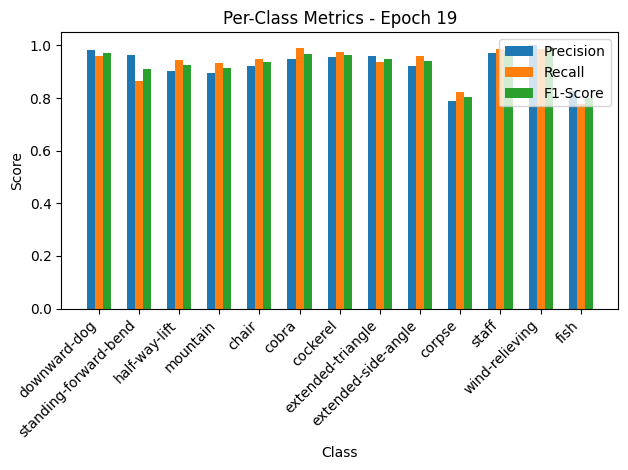

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.53it/s, loss=0.165, accuracy=95.9]


Per-Class Metrics for Epoch 19:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=0.88, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


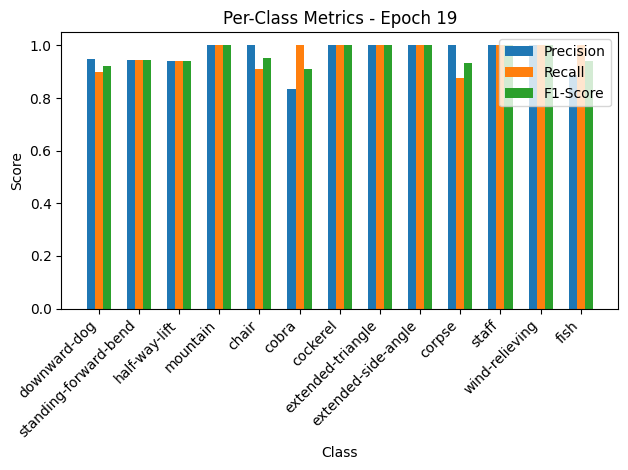


Epoch 20/50 Summary:
Train Loss: 0.2618 | Train Acc: 93.12% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1808 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.96
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 20
New best model saved! Validation Loss: 0.1808

Epoch 21/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.14it/s, loss=0.225, accuracy=94.6]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.97, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.96, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.93, Recall=0.95, F1-Score=0.94
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.93, Recall=0.94, F1-Score=0.94
cobra: Precision=0.96, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.97, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.86, Recall=0.87, F1-Score=0.86
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.88, Recall=0.84, F1-Score=0.85


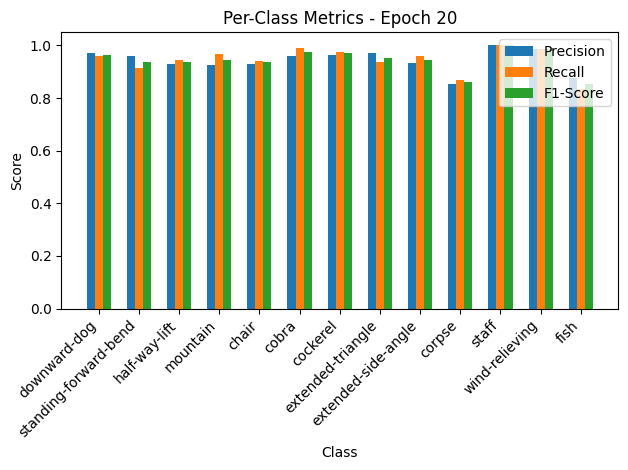

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.82it/s, loss=0.181, accuracy=94.5]


Per-Class Metrics for Epoch 20:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=0.81, Recall=1.00, F1-Score=0.90
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=0.71, F1-Score=0.83
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


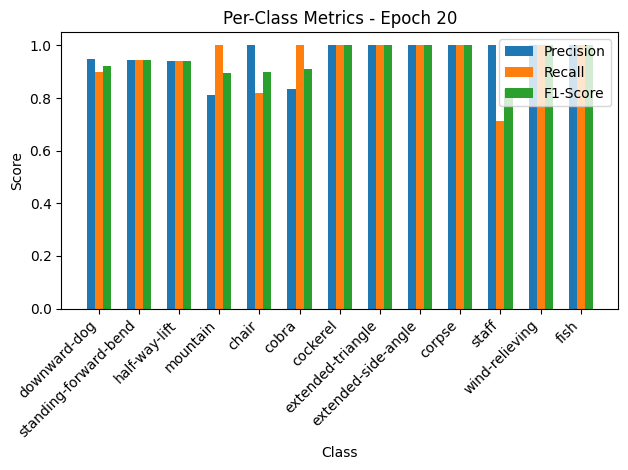


Epoch 21/50 Summary:
Train Loss: 0.2259 | Train Acc: 94.58% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1983 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 22/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.21it/s, loss=0.24, accuracy=93]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.96, Recall=0.95, F1-Score=0.96
standing-forward-bend: Precision=0.94, Recall=0.87, F1-Score=0.90
half-way-lift: Precision=0.90, Recall=0.94, F1-Score=0.92
mountain: Precision=0.94, Recall=0.95, F1-Score=0.95
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.95, Recall=0.95, F1-Score=0.95
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.95, F1-Score=0.95
corpse: Precision=0.83, Recall=0.72, F1-Score=0.77
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=0.96, Recall=0.99, F1-Score=0.97
fish: Precision=0.76, Recall=0.85, F1-Score=0.80


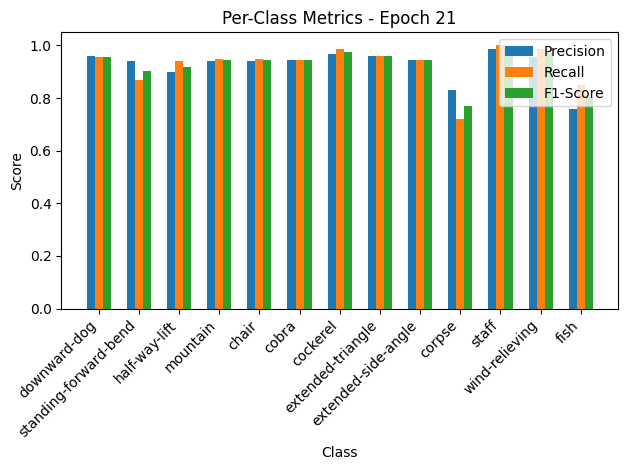

Validation: 100%|██████████| 10/10 [00:00<00:00, 33.39it/s, loss=0.167, accuracy=94.5]


Per-Class Metrics for Epoch 21:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=0.94, F1-Score=0.91
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


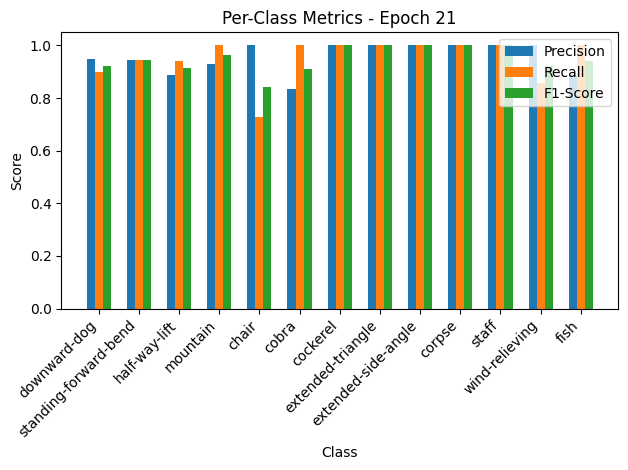


Epoch 22/50 Summary:
Train Loss: 0.2410 | Train Acc: 92.97% | Train Precision: 0.93 | Train Recall: 0.93 | Train F1: 0.93
Val Loss: 0.1827 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 23/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.15it/s, loss=0.207, accuracy=94.7]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.93, Recall=0.93, F1-Score=0.93
half-way-lift: Precision=0.94, Recall=0.93, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.96, Recall=0.93, F1-Score=0.94
cobra: Precision=0.96, Recall=0.97, F1-Score=0.96
cockerel: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.85, Recall=0.84, F1-Score=0.84
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.85, Recall=0.85, F1-Score=0.85


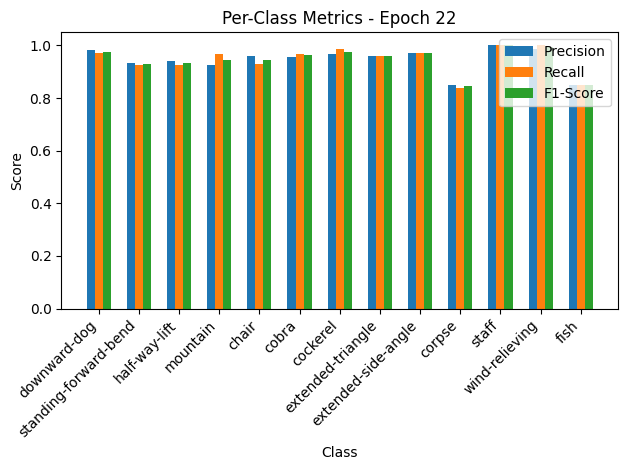

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.34it/s, loss=0.145, accuracy=95.9]


Per-Class Metrics for Epoch 22:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


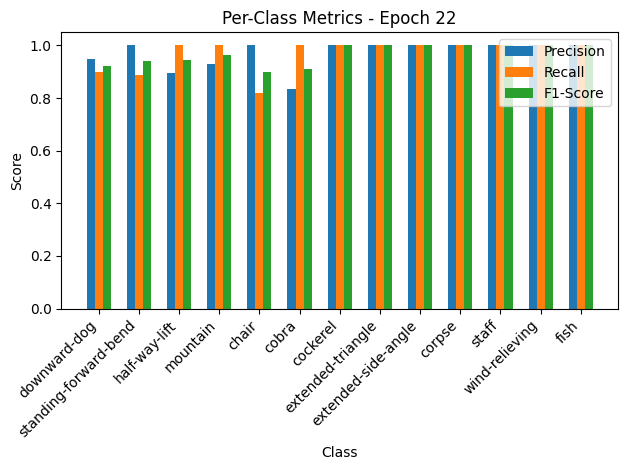


Epoch 23/50 Summary:
Train Loss: 0.2071 | Train Acc: 94.73% | Train Precision: 0.94 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1592 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 23
New best model saved! Validation Loss: 0.1592

Epoch 24/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.96it/s, loss=0.246, accuracy=93.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.97, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.92, F1-Score=0.93
chair: Precision=0.93, Recall=0.93, F1-Score=0.93
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.96, Recall=0.95, F1-Score=0.96
extended-triangle: Precision=0.97, Recall=0.91, F1-Score=0.94
extended-side-angle: Precision=0.91, Recall=0.97, F1-Score=0.94
corpse: Precision=0.82, Recall=0.87, F1-Score=0.84
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.86, Recall=0.81, F1-Score=0.83


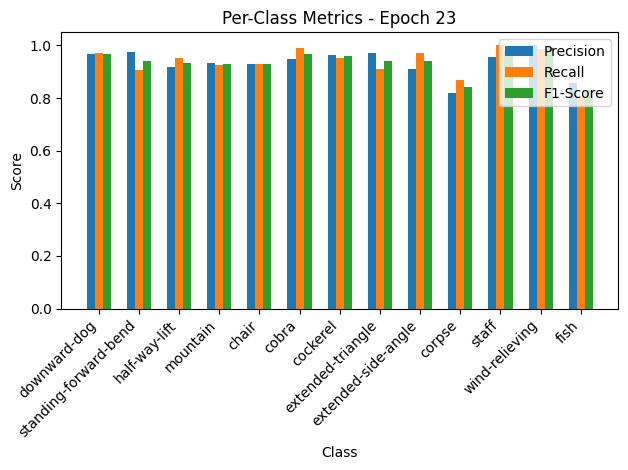

Validation: 100%|██████████| 10/10 [00:00<00:00, 28.91it/s, loss=0.147, accuracy=95.9]


Per-Class Metrics for Epoch 23:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


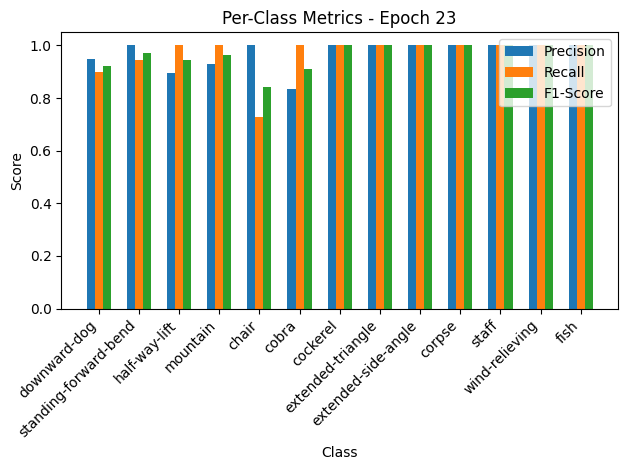


Epoch 24/50 Summary:
Train Loss: 0.2467 | Train Acc: 93.89% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93
Val Loss: 0.1606 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 25/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:07<00:00, 10.42it/s, loss=0.218, accuracy=94.7]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.93, F1-Score=0.92
mountain: Precision=0.91, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.92, F1-Score=0.93
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.99, F1-Score=0.97
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.90, Recall=0.81, F1-Score=0.85
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.97, F1-Score=0.99
fish: Precision=0.82, Recall=0.91, F1-Score=0.87


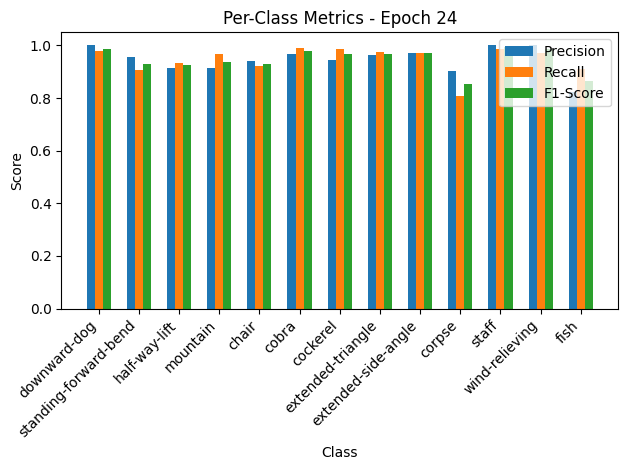

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.54it/s, loss=0.148, accuracy=96.6]


Per-Class Metrics for Epoch 24:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


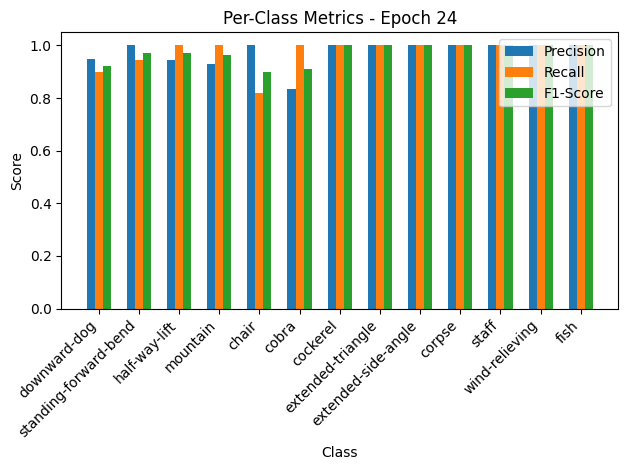


Epoch 25/50 Summary:
Train Loss: 0.2189 | Train Acc: 94.73% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1623 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 26/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.89it/s, loss=0.237, accuracy=93.8]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.97
standing-forward-bend: Precision=0.94, Recall=0.90, F1-Score=0.92
half-way-lift: Precision=0.90, Recall=0.92, F1-Score=0.91
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.90, F1-Score=0.93
cobra: Precision=0.95, Recall=0.98, F1-Score=0.96
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.96, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.87, Recall=0.85, F1-Score=0.86
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.97, Recall=0.97, F1-Score=0.97
fish: Precision=0.87, Recall=0.87, F1-Score=0.87


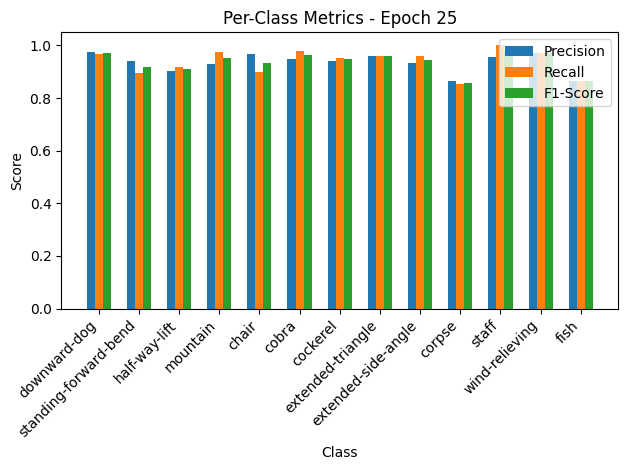

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.71it/s, loss=0.128, accuracy=95.9]


Per-Class Metrics for Epoch 25:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


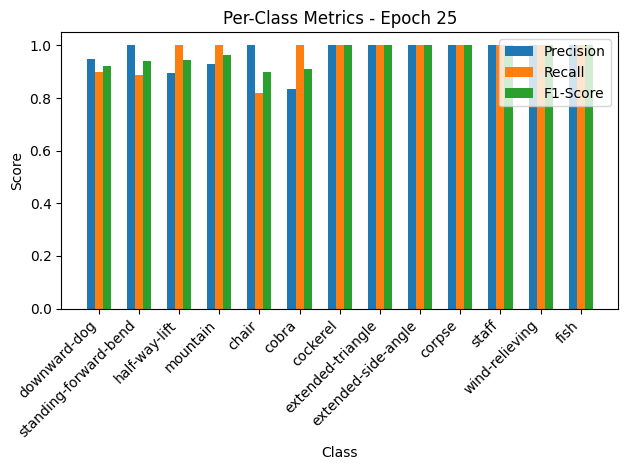


Epoch 26/50 Summary:
Train Loss: 0.2374 | Train Acc: 93.81% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1404 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 26
New best model saved! Validation Loss: 0.1404

Epoch 27/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  8.84it/s, loss=0.206, accuracy=94.8]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.97, Recall=0.98, F1-Score=0.97
standing-forward-bend: Precision=0.99, Recall=0.90, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.97, F1-Score=0.94
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.94, Recall=0.96, F1-Score=0.95
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=0.94, F1-Score=0.96
extended-triangle: Precision=0.95, Recall=0.96, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.95, F1-Score=0.94
corpse: Precision=0.84, Recall=0.90, F1-Score=0.87
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.92, Recall=0.82, F1-Score=0.87


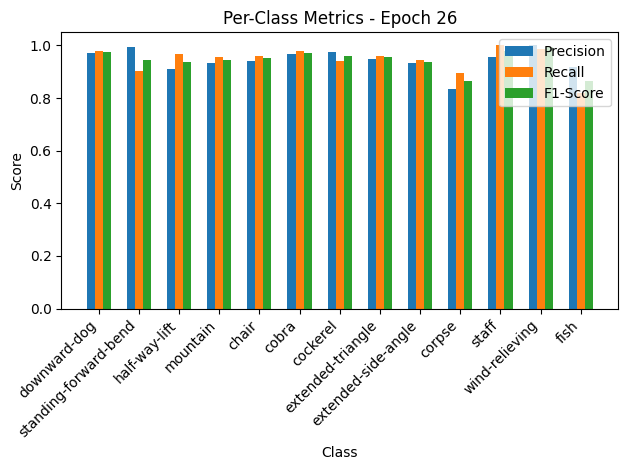

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.41it/s, loss=0.132, accuracy=95.9]


Per-Class Metrics for Epoch 26:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.93


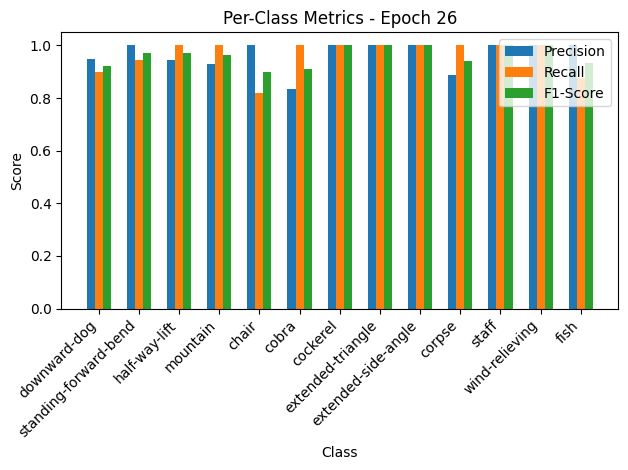


Epoch 27/50 Summary:
Train Loss: 0.2062 | Train Acc: 94.81% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.94
Val Loss: 0.1441 | Val Acc: 95.89% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 28/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.04it/s, loss=0.192, accuracy=95.1]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.90, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.97, F1-Score=0.94
chair: Precision=0.94, Recall=0.95, F1-Score=0.95
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.98, Recall=0.99, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.93, Recall=0.96, F1-Score=0.95
corpse: Precision=0.89, Recall=0.91, F1-Score=0.90
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.99, Recall=0.99, F1-Score=0.99
fish: Precision=0.91, Recall=0.87, F1-Score=0.89


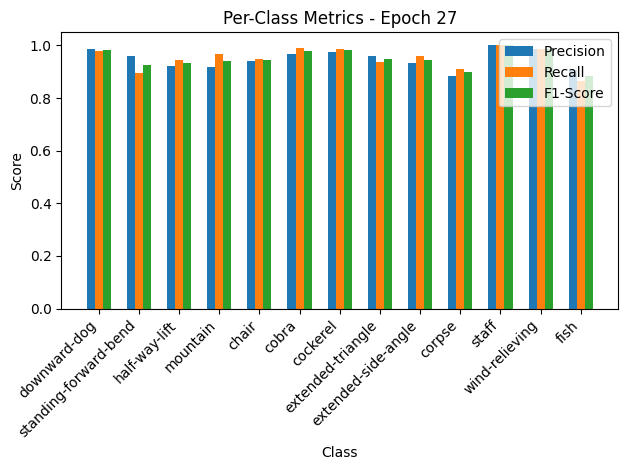

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.62it/s, loss=0.175, accuracy=94.5]


Per-Class Metrics for Epoch 27:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.89, F1-Score=0.94
half-way-lift: Precision=0.85, Recall=1.00, F1-Score=0.92
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=0.89, Recall=1.00, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=0.88, F1-Score=0.93


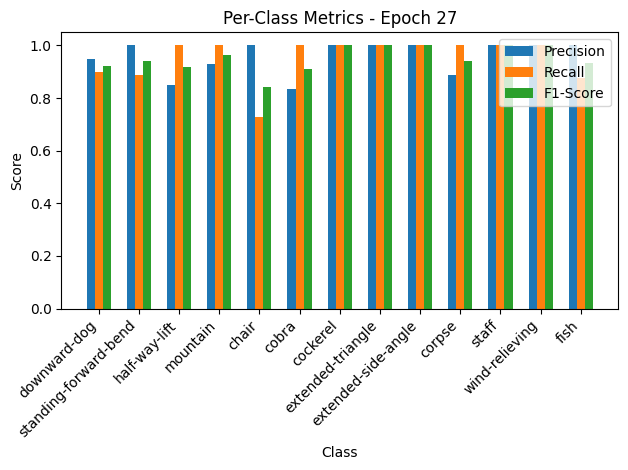


Epoch 28/50 Summary:
Train Loss: 0.1925 | Train Acc: 95.11% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95
Val Loss: 0.1914 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.95 | Val F1: 0.95

Epoch 29/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:09<00:00,  9.05it/s, loss=0.208, accuracy=94.3]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.98, Recall=0.96, F1-Score=0.97
standing-forward-bend: Precision=0.95, Recall=0.91, F1-Score=0.93
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.93, Recall=0.97, F1-Score=0.95
chair: Precision=0.97, Recall=0.95, F1-Score=0.96
cobra: Precision=0.98, Recall=0.96, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.93, Recall=0.95, F1-Score=0.94
extended-side-angle: Precision=0.93, Recall=0.90, F1-Score=0.92
corpse: Precision=0.83, Recall=0.91, F1-Score=0.87
staff: Precision=0.97, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.90, Recall=0.82, F1-Score=0.86


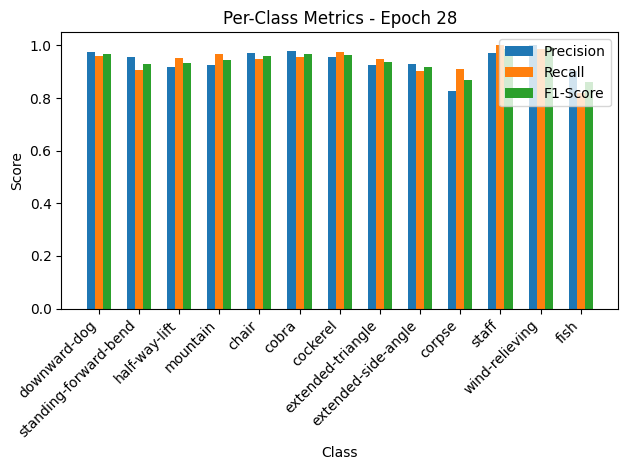

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.90it/s, loss=0.128, accuracy=97.3]


Per-Class Metrics for Epoch 28:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


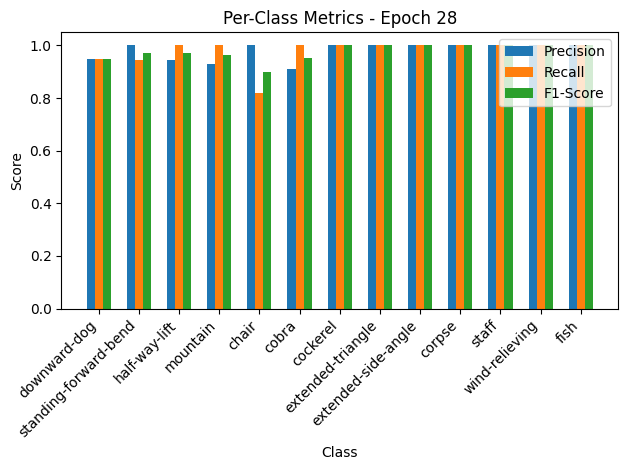


Epoch 29/50 Summary:
Train Loss: 0.2084 | Train Acc: 94.35% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1406 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 30/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00,  9.21it/s, loss=0.226, accuracy=94.3]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.98, Recall=0.94, F1-Score=0.96
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.91, Recall=0.95, F1-Score=0.93
mountain: Precision=0.96, Recall=0.95, F1-Score=0.95
chair: Precision=0.92, Recall=0.96, F1-Score=0.94
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.94, Recall=0.95, F1-Score=0.95
extended-triangle: Precision=0.97, Recall=0.94, F1-Score=0.95
extended-side-angle: Precision=0.92, Recall=0.93, F1-Score=0.93
corpse: Precision=0.80, Recall=0.90, F1-Score=0.85
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=0.97, Recall=0.99, F1-Score=0.98
fish: Precision=0.92, Recall=0.81, F1-Score=0.86


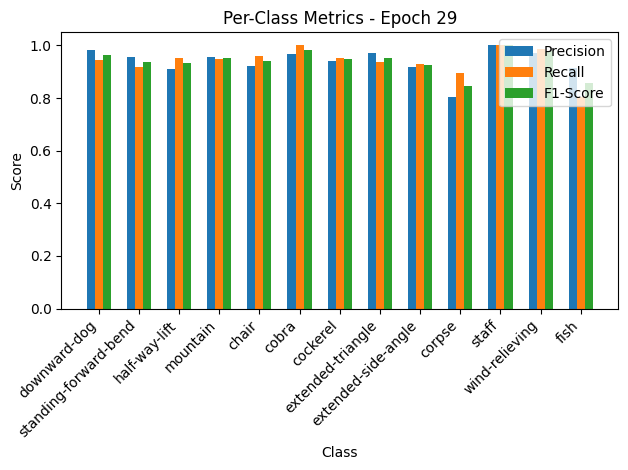

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.95it/s, loss=0.136, accuracy=96.6]


Per-Class Metrics for Epoch 29:
downward-dog: Precision=0.95, Recall=0.95, F1-Score=0.95
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.91, Recall=1.00, F1-Score=0.95
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.86, F1-Score=0.92
fish: Precision=0.89, Recall=1.00, F1-Score=0.94


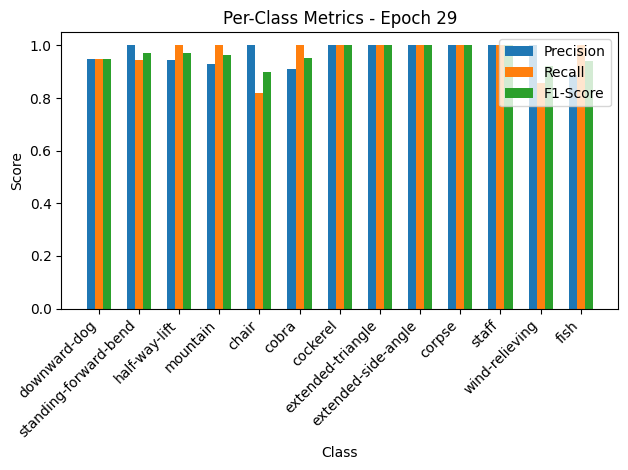


Epoch 30/50 Summary:
Train Loss: 0.2266 | Train Acc: 94.27% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94
Val Loss: 0.1495 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 31/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 82/82 [00:08<00:00, 10.18it/s, loss=0.175, accuracy=96]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.91, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.96, F1-Score=0.95
mountain: Precision=0.93, Recall=0.96, F1-Score=0.95
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.95, Recall=0.99, F1-Score=0.97
cockerel: Precision=0.95, Recall=0.98, F1-Score=0.97
extended-triangle: Precision=0.99, Recall=0.94, F1-Score=0.96
extended-side-angle: Precision=0.93, Recall=0.97, F1-Score=0.95
corpse: Precision=0.92, Recall=0.97, F1-Score=0.94
staff: Precision=0.96, Recall=1.00, F1-Score=0.98
wind-relieving: Precision=0.99, Recall=1.00, F1-Score=0.99
fish: Precision=0.97, Recall=0.90, F1-Score=0.93


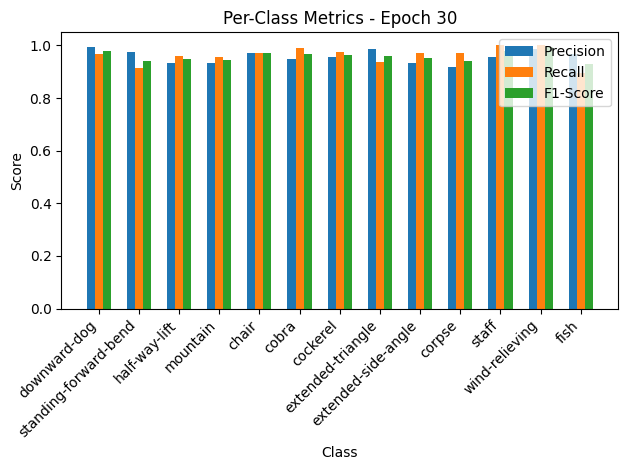

Validation: 100%|██████████| 10/10 [00:00<00:00, 29.51it/s, loss=0.164, accuracy=94.5]


Per-Class Metrics for Epoch 30:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.89, Recall=0.94, F1-Score=0.92
half-way-lift: Precision=0.88, Recall=0.88, F1-Score=0.88
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


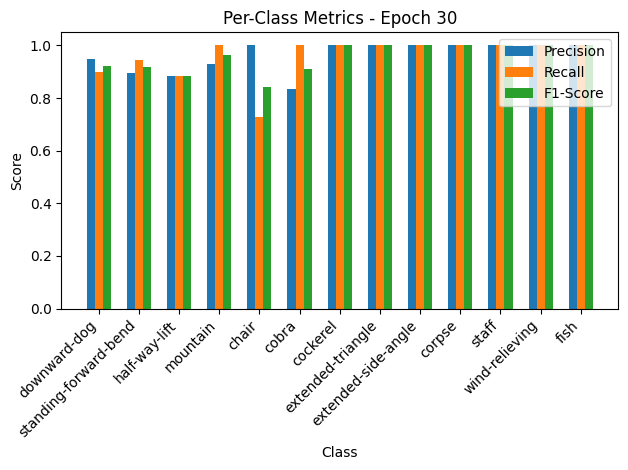


Epoch 31/50 Summary:
Train Loss: 0.1755 | Train Acc: 95.95% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1794 | Val Acc: 94.52% | Val Precision: 0.96 | Val Recall: 0.96 | Val F1: 0.96

Epoch 32/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.88it/s, loss=0.17, accuracy=96.2]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.98, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.92, Recall=0.94, F1-Score=0.93
half-way-lift: Precision=0.96, Recall=0.89, F1-Score=0.92
mountain: Precision=0.94, Recall=0.98, F1-Score=0.96
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.96, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.92, Recall=0.97, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


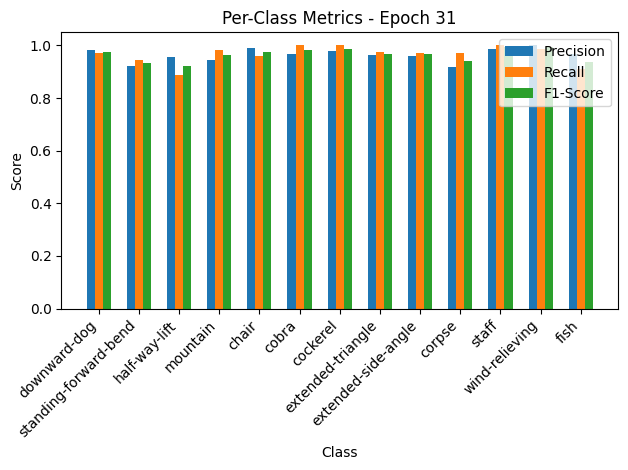

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.92it/s, loss=0.128, accuracy=95.9]


Per-Class Metrics for Epoch 31:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=0.94, Recall=0.94, F1-Score=0.94
half-way-lift: Precision=0.94, Recall=0.94, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


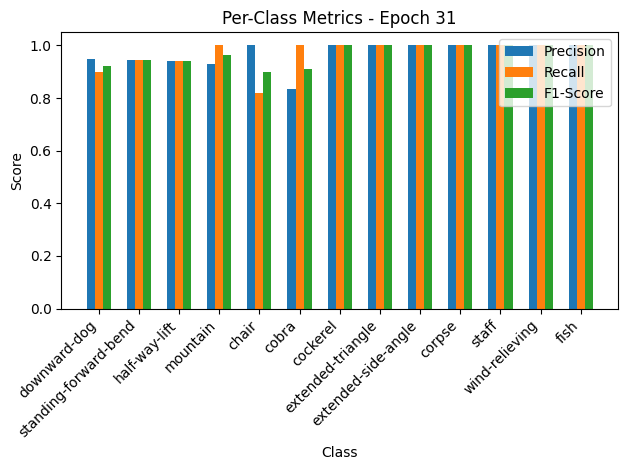


Epoch 32/50 Summary:
Train Loss: 0.1707 | Train Acc: 96.18% | Train Precision: 0.96 | Train Recall: 0.97 | Train F1: 0.96
Val Loss: 0.1404 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 32
New best model saved! Validation Loss: 0.1404

Epoch 33/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.52it/s, loss=0.165, accuracy=96.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.92, F1-Score=0.94
half-way-lift: Precision=0.92, Recall=0.95, F1-Score=0.93
mountain: Precision=0.92, Recall=0.99, F1-Score=0.96
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.96, Recall=0.99, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.96, F1-Score=0.96
corpse: Precision=0.94, Recall=0.91, F1-Score=0.93
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.91, Recall=0.94, F1-Score=0.93


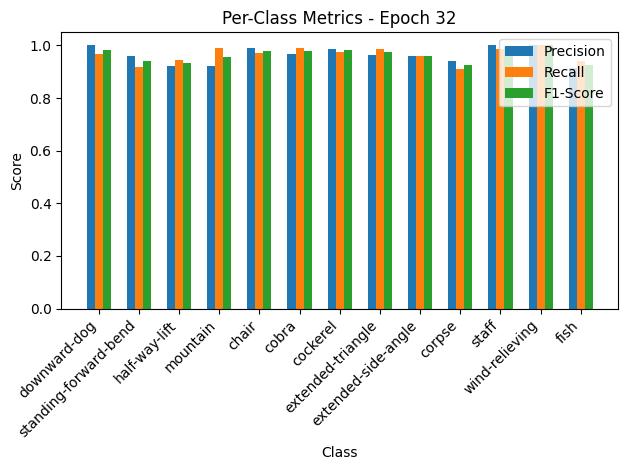

Validation: 100%|██████████| 10/10 [00:00<00:00, 32.85it/s, loss=0.112, accuracy=97.3]


Per-Class Metrics for Epoch 32:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


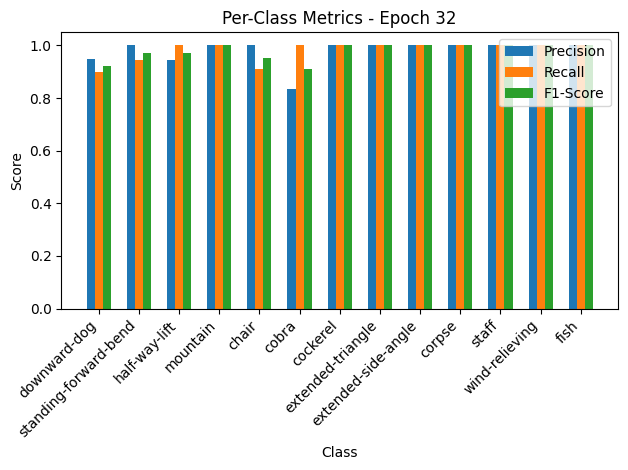


Epoch 33/50 Summary:
Train Loss: 0.1653 | Train Acc: 96.26% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96
Val Loss: 0.1224 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98
/content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Saving checkpoint to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/best_model_fold_4.pth
Checkpoint saved at epoch 33
New best model saved! Validation Loss: 0.1224

Epoch 34/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.60it/s, loss=0.155, accuracy=96.8]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.95, Recall=0.96, F1-Score=0.95
half-way-lift: Precision=0.97, Recall=0.93, F1-Score=0.95
mountain: Precision=0.97, Recall=0.97, F1-Score=0.97
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.91, F1-Score=0.92


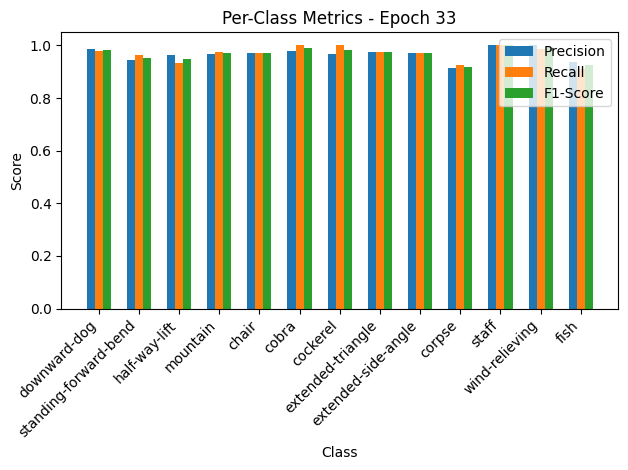

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.37it/s, loss=0.113, accuracy=97.3]


Per-Class Metrics for Epoch 33:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=1.00, Recall=1.00, F1-Score=1.00
chair: Precision=1.00, Recall=0.91, F1-Score=0.95
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


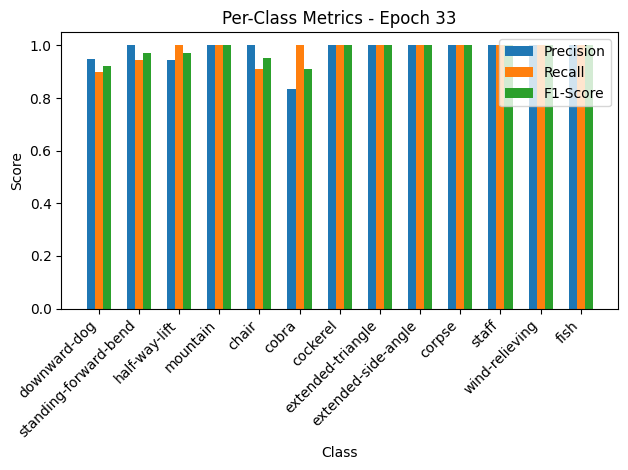


Epoch 34/50 Summary:
Train Loss: 0.1556 | Train Acc: 96.79% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1235 | Val Acc: 97.26% | Val Precision: 0.98 | Val Recall: 0.98 | Val F1: 0.98

Epoch 35/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.71it/s, loss=0.156, accuracy=96.7]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.96, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.95, Recall=0.87, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.88, Recall=0.96, F1-Score=0.91


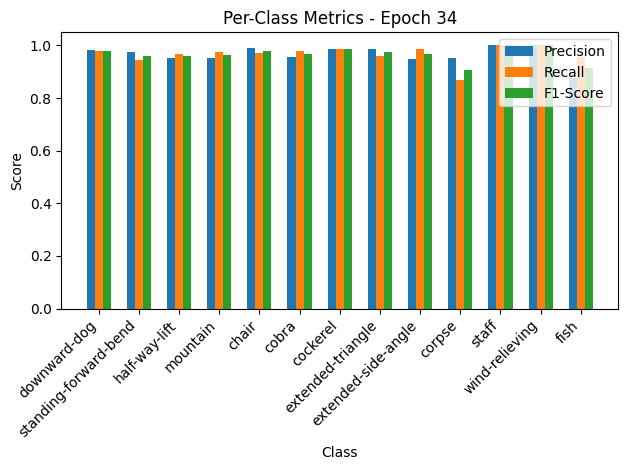

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.60it/s, loss=0.124, accuracy=95.9]


Per-Class Metrics for Epoch 34:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


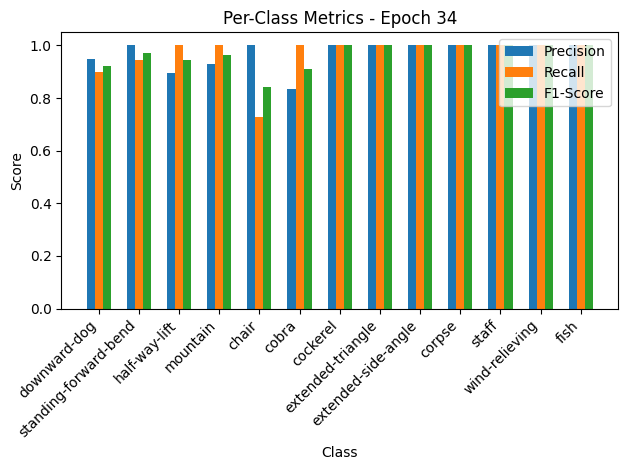


Epoch 35/50 Summary:
Train Loss: 0.1566 | Train Acc: 96.72% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1364 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 36/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:09<00:00,  8.60it/s, loss=0.137, accuracy=97.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.95, F1-Score=0.97
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.98, F1-Score=0.99
cobra: Precision=0.99, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.89, Recall=0.96, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.94, Recall=0.90, F1-Score=0.92


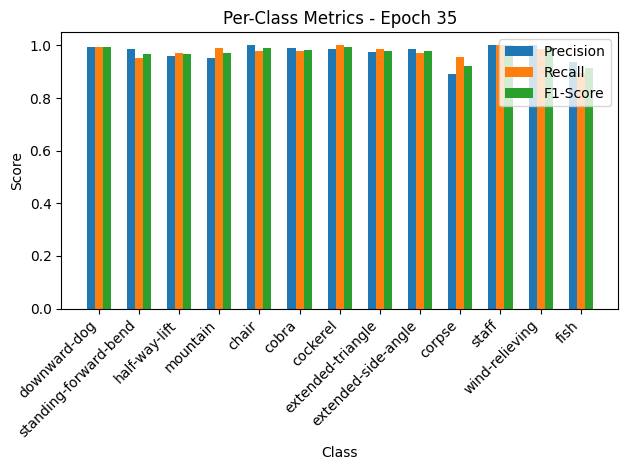

Validation: 100%|██████████| 10/10 [00:00<00:00, 36.81it/s, loss=0.115, accuracy=96.6]


Per-Class Metrics for Epoch 35:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


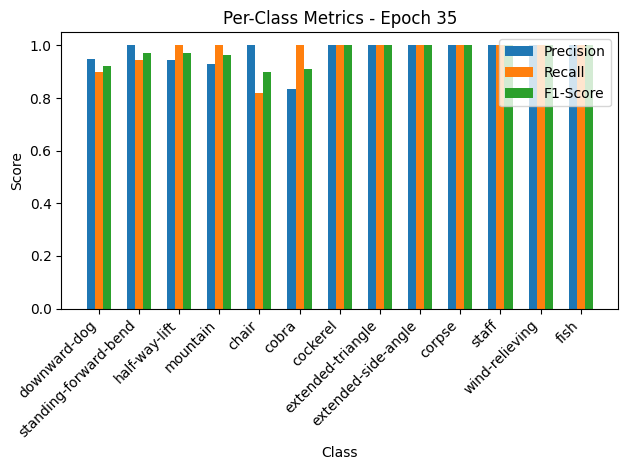


Epoch 36/50 Summary:
Train Loss: 0.1371 | Train Acc: 97.56% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1262 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 37/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.46it/s, loss=0.133, accuracy=97.2]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.95, F1-Score=0.97
extended-side-angle: Precision=0.96, Recall=0.97, F1-Score=0.97
corpse: Precision=0.96, Recall=0.94, F1-Score=0.95
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.96, F1-Score=0.95


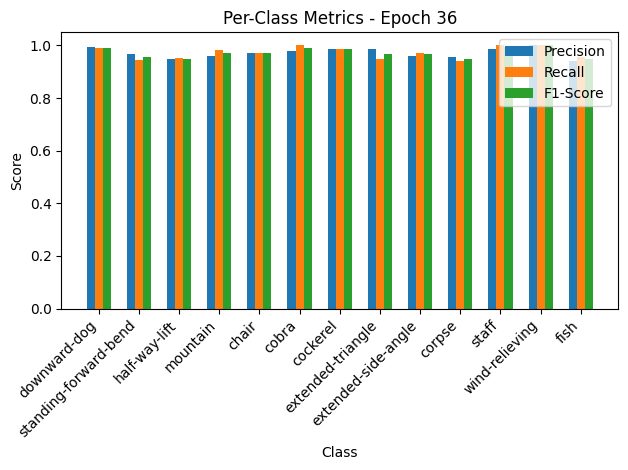

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.47it/s, loss=0.123, accuracy=95.9]


Per-Class Metrics for Epoch 36:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.89, Recall=1.00, F1-Score=0.94
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.73, F1-Score=0.84
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


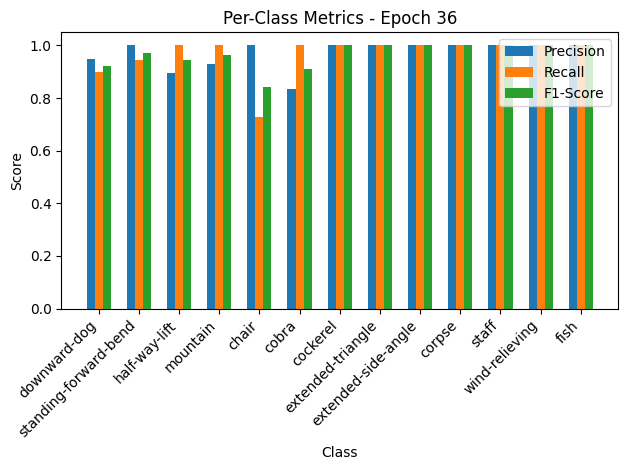


Epoch 37/50 Summary:
Train Loss: 0.1330 | Train Acc: 97.17% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1348 | Val Acc: 95.89% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 38/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 82/82 [00:08<00:00,  9.70it/s, loss=0.15, accuracy=96.9]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.95, Recall=0.97, F1-Score=0.96
chair: Precision=0.99, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.94, Recall=0.88, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.89, Recall=0.94, F1-Score=0.91


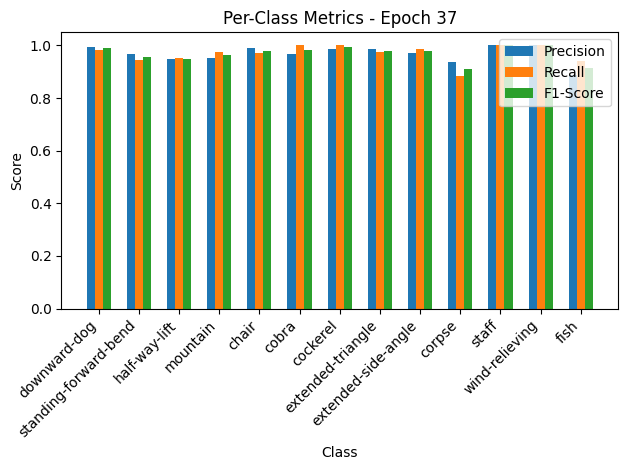

Validation: 100%|██████████| 10/10 [00:00<00:00, 41.44it/s, loss=0.117, accuracy=96.6]


Per-Class Metrics for Epoch 37:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


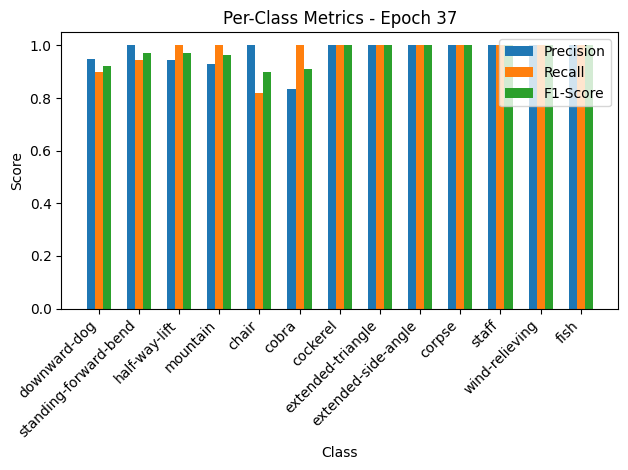


Epoch 38/50 Summary:
Train Loss: 0.1504 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1283 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 39/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.85it/s, loss=0.14, accuracy=97.2]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.98, F1-Score=0.96
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.99, Recall=0.96, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.95, Recall=0.99, F1-Score=0.97
corpse: Precision=0.92, Recall=0.97, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.97, Recall=0.91, F1-Score=0.94


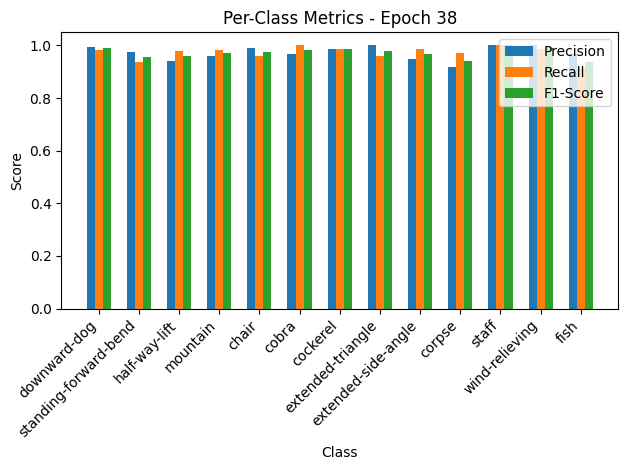

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.56it/s, loss=0.121, accuracy=96.6]


Per-Class Metrics for Epoch 38:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


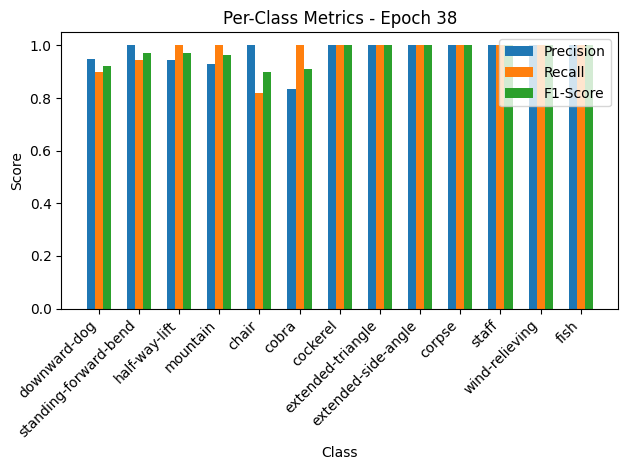


Epoch 39/50 Summary:
Train Loss: 0.1407 | Train Acc: 97.25% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1327 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 40/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.84it/s, loss=0.141, accuracy=96.8]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.98, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.97, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.95, F1-Score=0.96
extended-side-angle: Precision=0.95, Recall=0.96, F1-Score=0.95
corpse: Precision=0.89, Recall=0.96, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.95, Recall=0.88, F1-Score=0.91


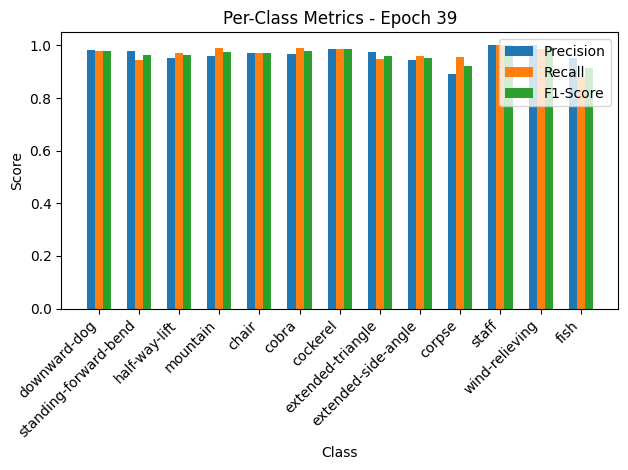

Validation: 100%|██████████| 10/10 [00:00<00:00, 37.11it/s, loss=0.119, accuracy=96.6]


Per-Class Metrics for Epoch 39:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


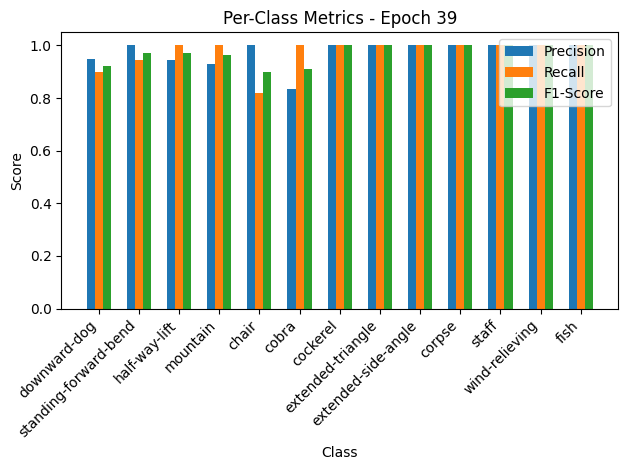


Epoch 40/50 Summary:
Train Loss: 0.1409 | Train Acc: 96.79% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1304 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 41/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.75it/s, loss=0.139, accuracy=97.1]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.96, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.96
mountain: Precision=0.96, Recall=0.97, F1-Score=0.97
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=1.00, Recall=0.98, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.97, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.97, F1-Score=0.97
corpse: Precision=0.94, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.94, F1-Score=0.93


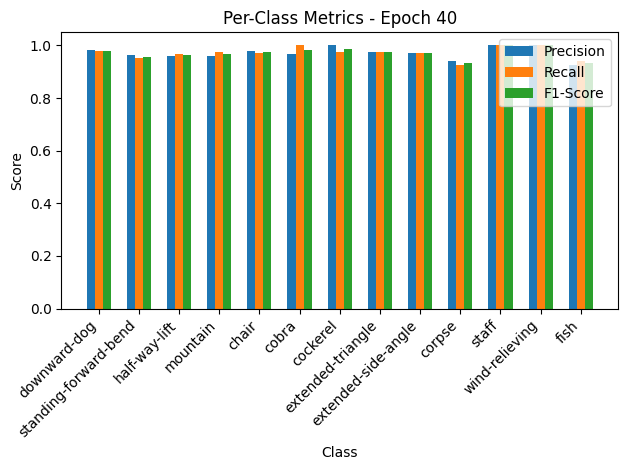

Validation: 100%|██████████| 10/10 [00:00<00:00, 35.22it/s, loss=0.118, accuracy=96.6]


Per-Class Metrics for Epoch 40:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


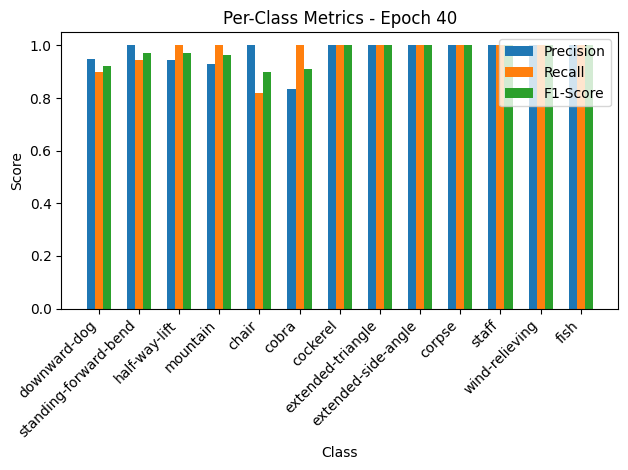


Epoch 41/50 Summary:
Train Loss: 0.1389 | Train Acc: 97.10% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1295 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 42/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:09<00:00,  8.69it/s, loss=0.129, accuracy=97.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.99, Recall=0.99, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.97, F1-Score=0.97
mountain: Precision=0.95, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.95, F1-Score=0.96
cobra: Precision=1.00, Recall=0.99, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.97, Recall=0.99, F1-Score=0.98
extended-side-angle: Precision=0.99, Recall=0.97, F1-Score=0.98
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.93, F1-Score=0.94


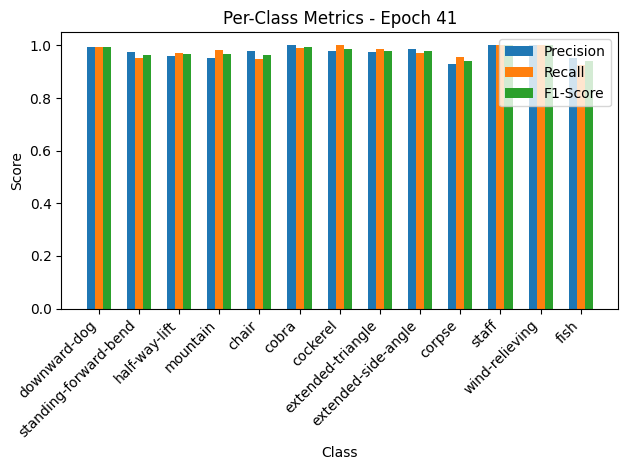

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.42it/s, loss=0.12, accuracy=96.6]


Per-Class Metrics for Epoch 41:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


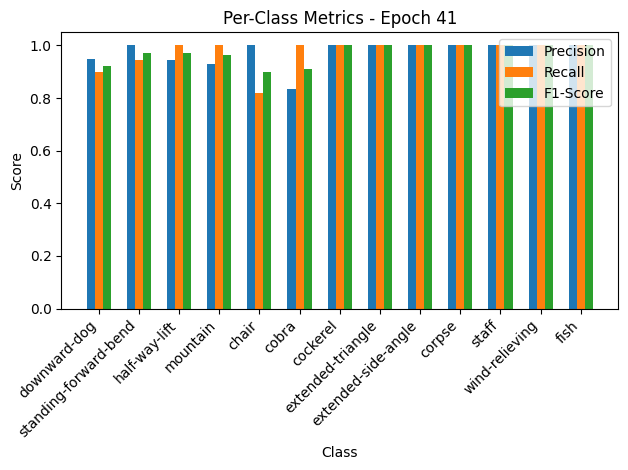


Epoch 42/50 Summary:
Train Loss: 0.1292 | Train Acc: 97.56% | Train Precision: 0.98 | Train Recall: 0.98 | Train F1: 0.98
Val Loss: 0.1320 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 43/50
Current Learning Rate: 1.0000000000000002e-06


Training: 100%|██████████| 82/82 [00:08<00:00,  9.68it/s, loss=0.15, accuracy=97]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=1.00, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.95, F1-Score=0.95
mountain: Precision=0.95, Recall=0.99, F1-Score=0.97
chair: Precision=0.98, Recall=0.96, F1-Score=0.97
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.91, Recall=0.93, F1-Score=0.92
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.90, F1-Score=0.91


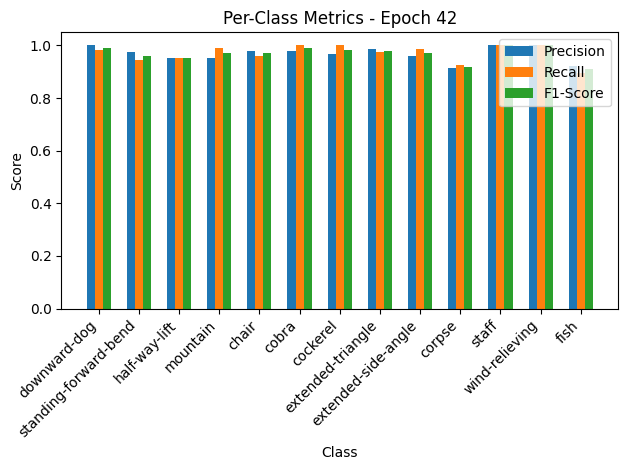

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.69it/s, loss=0.12, accuracy=96.6]


Per-Class Metrics for Epoch 42:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


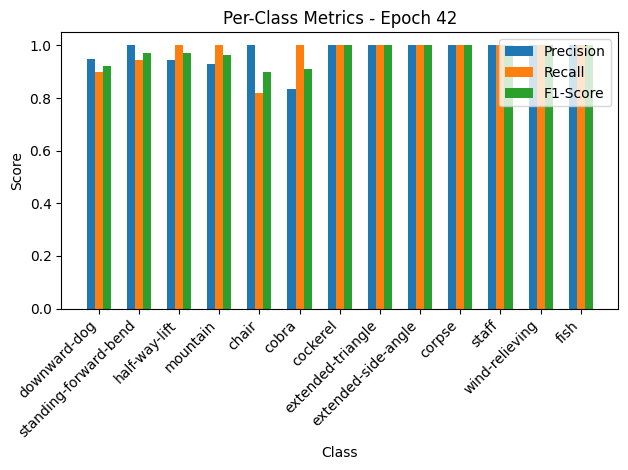


Epoch 43/50 Summary:
Train Loss: 0.1505 | Train Acc: 97.02% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1314 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 44/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00, 10.01it/s, loss=0.145, accuracy=96.9]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.98, Recall=0.99, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.95, Recall=0.96, F1-Score=0.96
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.98, F1-Score=0.98
cockerel: Precision=0.99, Recall=0.99, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.99, F1-Score=0.99
extended-side-angle: Precision=0.99, Recall=0.99, F1-Score=0.99
corpse: Precision=0.92, Recall=0.87, F1-Score=0.89
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.87, Recall=0.93, F1-Score=0.90


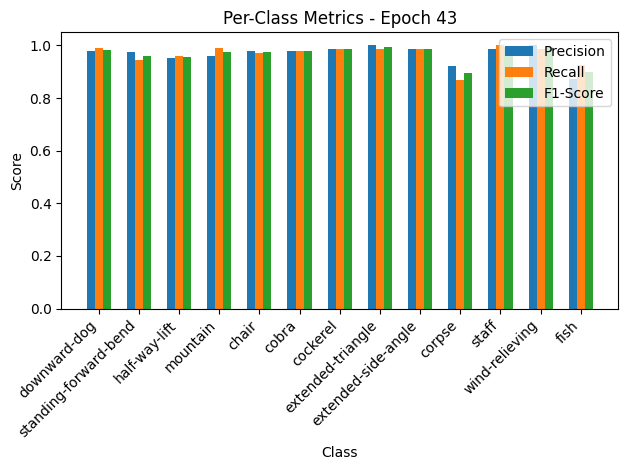

Validation: 100%|██████████| 10/10 [00:00<00:00, 38.63it/s, loss=0.122, accuracy=96.6]


Per-Class Metrics for Epoch 43:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


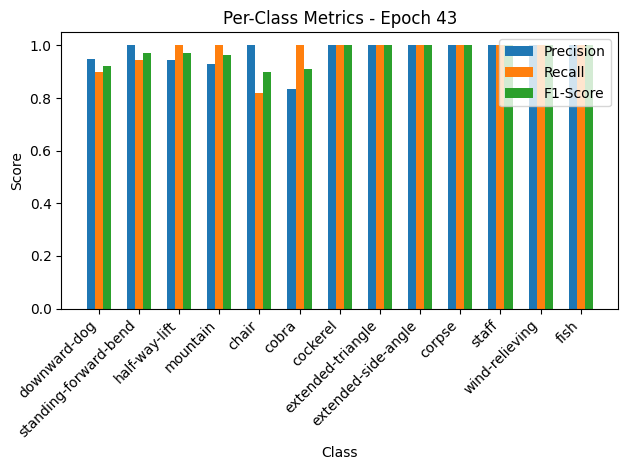


Epoch 44/50 Summary:
Train Loss: 0.1457 | Train Acc: 96.87% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1333 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 45/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  9.07it/s, loss=0.153, accuracy=97]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.97, F1-Score=0.96
mountain: Precision=0.94, Recall=0.97, F1-Score=0.95
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.88, Recall=0.94, F1-Score=0.91
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.88, F1-Score=0.91


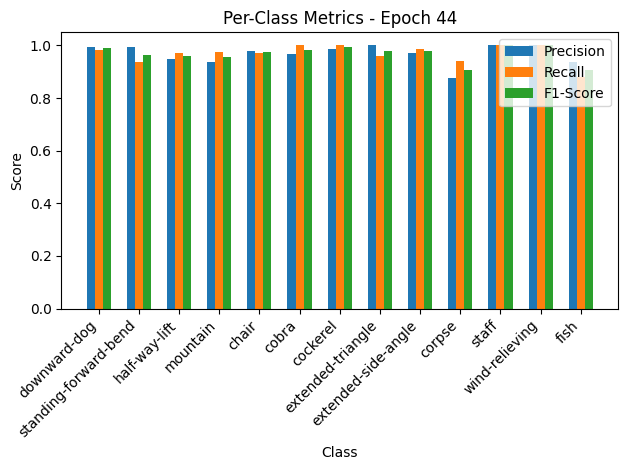

Validation: 100%|██████████| 10/10 [00:00<00:00, 34.17it/s, loss=0.121, accuracy=96.6]


Per-Class Metrics for Epoch 44:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


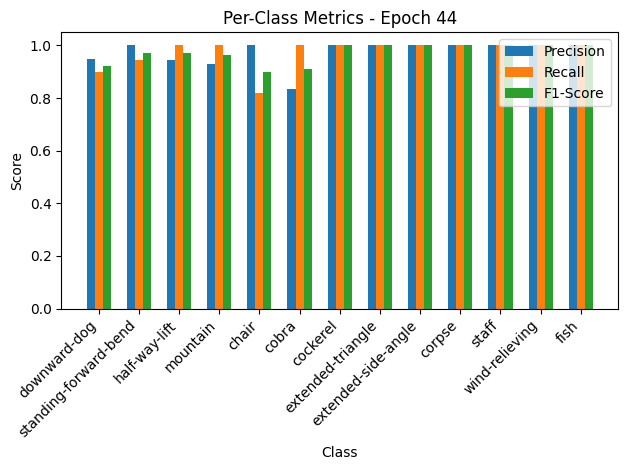


Epoch 45/50 Summary:
Train Loss: 0.1533 | Train Acc: 97.02% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1327 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 46/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.69it/s, loss=0.153, accuracy=96.7]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=1.00, Recall=0.97, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.93, F1-Score=0.95
half-way-lift: Precision=0.93, Recall=0.97, F1-Score=0.95
mountain: Precision=0.95, Recall=0.94, F1-Score=0.95
chair: Precision=0.96, Recall=0.97, F1-Score=0.97
cobra: Precision=0.97, Recall=1.00, F1-Score=0.98
cockerel: Precision=0.99, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=0.99, F1-Score=0.97
corpse: Precision=0.93, Recall=0.96, F1-Score=0.94
staff: Precision=1.00, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.94, Recall=0.93, F1-Score=0.93


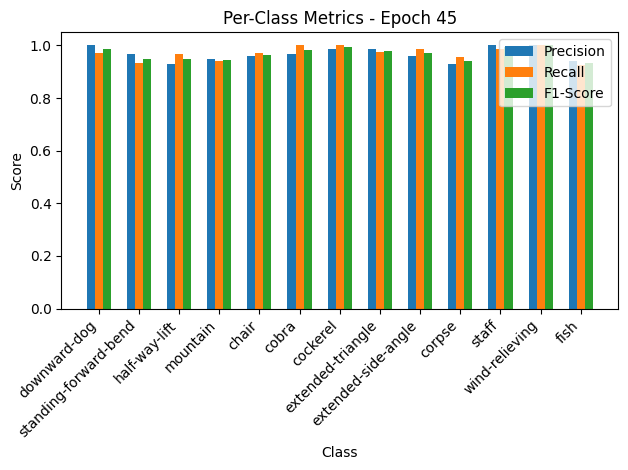

Validation: 100%|██████████| 10/10 [00:00<00:00, 31.23it/s, loss=0.119, accuracy=96.6]


Per-Class Metrics for Epoch 45:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


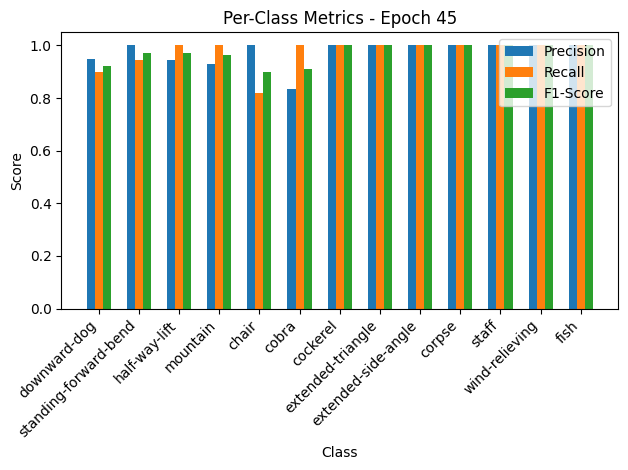


Epoch 46/50 Summary:
Train Loss: 0.1537 | Train Acc: 96.72% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1309 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 47/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:08<00:00,  9.76it/s, loss=0.133, accuracy=97.4]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.99, Recall=0.97, F1-Score=0.98
standing-forward-bend: Precision=0.99, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.95, Recall=0.98, F1-Score=0.96
mountain: Precision=0.94, Recall=0.99, F1-Score=0.97
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.96, F1-Score=0.98
extended-side-angle: Precision=0.96, Recall=1.00, F1-Score=0.98
corpse: Precision=0.92, Recall=0.96, F1-Score=0.94
staff: Precision=0.99, Recall=1.00, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.95, Recall=0.91, F1-Score=0.93


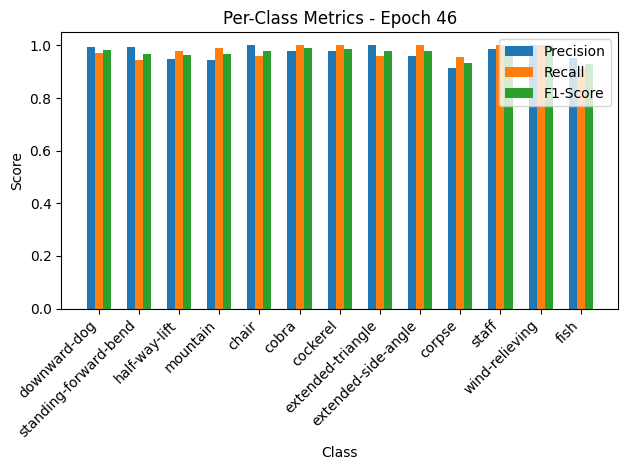

Validation: 100%|██████████| 10/10 [00:00<00:00, 39.25it/s, loss=0.121, accuracy=96.6]


Per-Class Metrics for Epoch 46:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


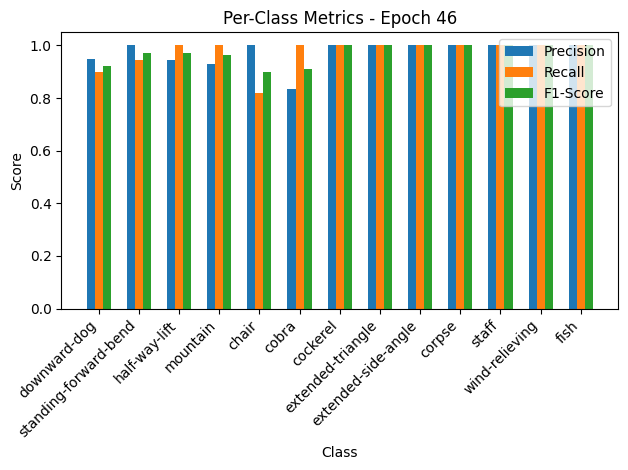


Epoch 47/50 Summary:
Train Loss: 0.1334 | Train Acc: 97.40% | Train Precision: 0.97 | Train Recall: 0.98 | Train F1: 0.97
Val Loss: 0.1325 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 48/50
Current Learning Rate: 1.0000000000000002e-07


Training: 100%|██████████| 82/82 [00:09<00:00,  8.55it/s, loss=0.131, accuracy=97.3]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.95, F1-Score=0.96
half-way-lift: Precision=0.96, Recall=0.96, F1-Score=0.96
mountain: Precision=0.97, Recall=0.99, F1-Score=0.98
chair: Precision=0.98, Recall=0.97, F1-Score=0.98
cobra: Precision=0.98, Recall=0.99, F1-Score=0.98
cockerel: Precision=0.97, Recall=1.00, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.97, F1-Score=0.98
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.93, Recall=0.93, F1-Score=0.93
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.93, Recall=0.93, F1-Score=0.93


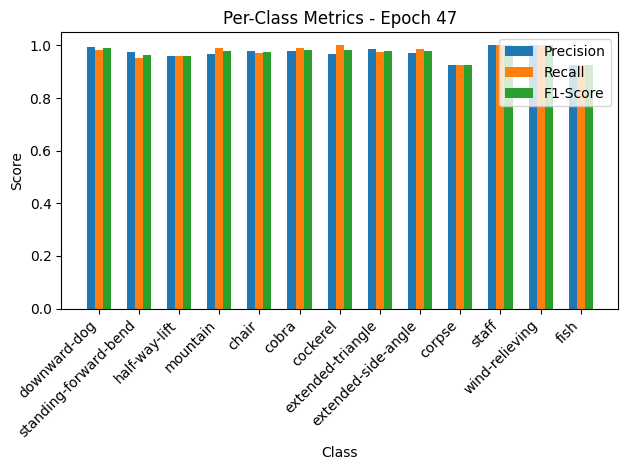

Validation: 100%|██████████| 10/10 [00:00<00:00, 42.03it/s, loss=0.114, accuracy=96.6]


Per-Class Metrics for Epoch 47:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


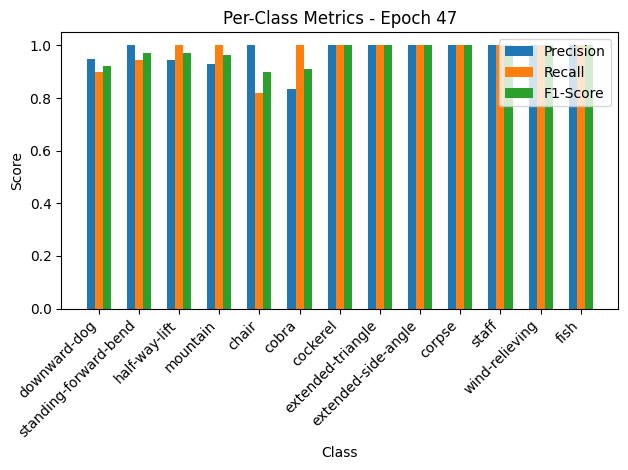


Epoch 48/50 Summary:
Train Loss: 0.1308 | Train Acc: 97.33% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1251 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 49/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.70it/s, loss=0.147, accuracy=96.9]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.98, Recall=0.98, F1-Score=0.98
standing-forward-bend: Precision=0.97, Recall=0.92, F1-Score=0.95
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.98, F1-Score=0.97
chair: Precision=0.98, Recall=0.98, F1-Score=0.98
cobra: Precision=0.97, Recall=0.98, F1-Score=0.97
cockerel: Precision=0.98, Recall=1.00, F1-Score=0.99
extended-triangle: Precision=1.00, Recall=0.97, F1-Score=0.99
extended-side-angle: Precision=0.97, Recall=1.00, F1-Score=0.99
corpse: Precision=0.91, Recall=0.99, F1-Score=0.94
staff: Precision=0.99, Recall=0.99, F1-Score=0.99
wind-relieving: Precision=1.00, Recall=0.99, F1-Score=0.99
fish: Precision=0.98, Recall=0.88, F1-Score=0.93


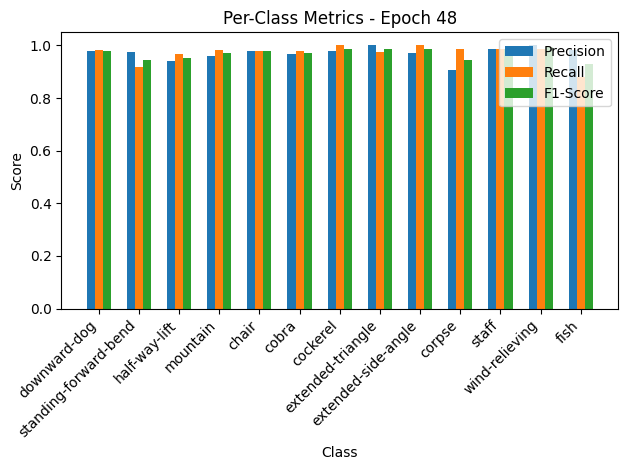

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.15it/s, loss=0.119, accuracy=96.6]


Per-Class Metrics for Epoch 48:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


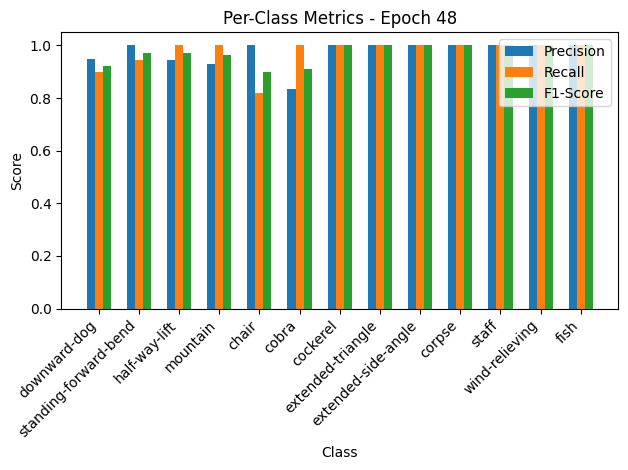


Epoch 49/50 Summary:
Train Loss: 0.1472 | Train Acc: 96.94% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1306 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97

Epoch 50/50
Current Learning Rate: 1.0000000000000004e-08


Training: 100%|██████████| 82/82 [00:08<00:00,  9.67it/s, loss=0.134, accuracy=97.3]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.99, Recall=0.98, F1-Score=0.99
standing-forward-bend: Precision=0.97, Recall=0.94, F1-Score=0.96
half-way-lift: Precision=0.94, Recall=0.97, F1-Score=0.95
mountain: Precision=0.96, Recall=0.99, F1-Score=0.98
chair: Precision=1.00, Recall=0.96, F1-Score=0.98
cobra: Precision=0.98, Recall=1.00, F1-Score=0.99
cockerel: Precision=0.98, Recall=0.98, F1-Score=0.98
extended-triangle: Precision=0.99, Recall=0.96, F1-Score=0.97
extended-side-angle: Precision=0.97, Recall=0.99, F1-Score=0.98
corpse: Precision=0.98, Recall=0.91, F1-Score=0.95
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=0.92, Recall=0.99, F1-Score=0.95


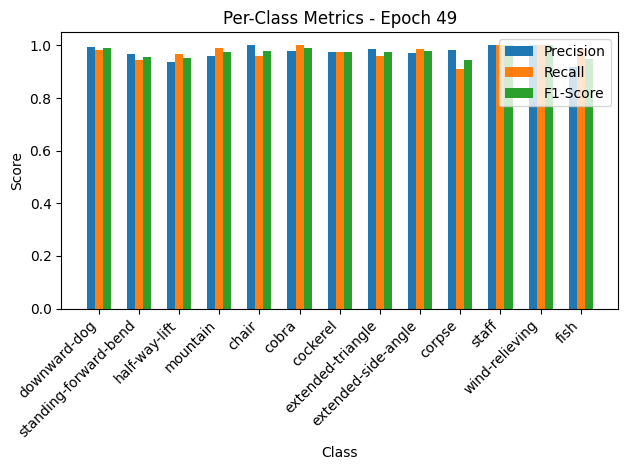

Validation: 100%|██████████| 10/10 [00:00<00:00, 40.14it/s, loss=0.117, accuracy=96.6]


Per-Class Metrics for Epoch 49:
downward-dog: Precision=0.95, Recall=0.90, F1-Score=0.92
standing-forward-bend: Precision=1.00, Recall=0.94, F1-Score=0.97
half-way-lift: Precision=0.94, Recall=1.00, F1-Score=0.97
mountain: Precision=0.93, Recall=1.00, F1-Score=0.96
chair: Precision=1.00, Recall=0.82, F1-Score=0.90
cobra: Precision=0.83, Recall=1.00, F1-Score=0.91
cockerel: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-triangle: Precision=1.00, Recall=1.00, F1-Score=1.00
extended-side-angle: Precision=1.00, Recall=1.00, F1-Score=1.00
corpse: Precision=1.00, Recall=1.00, F1-Score=1.00
staff: Precision=1.00, Recall=1.00, F1-Score=1.00
wind-relieving: Precision=1.00, Recall=1.00, F1-Score=1.00
fish: Precision=1.00, Recall=1.00, F1-Score=1.00


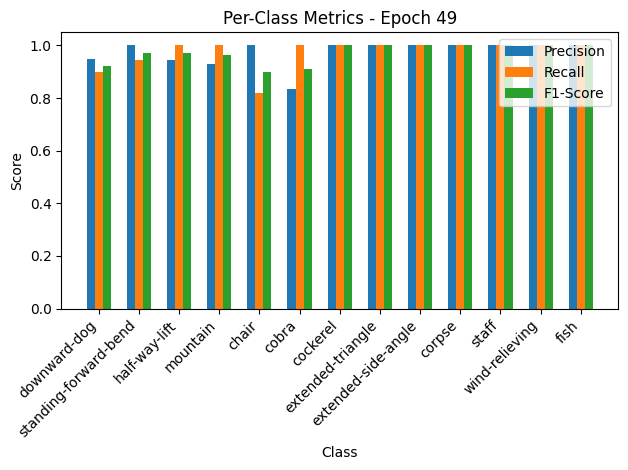


Epoch 50/50 Summary:
Train Loss: 0.1343 | Train Acc: 97.33% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Val Loss: 0.1286 | Val Acc: 96.58% | Val Precision: 0.97 | Val Recall: 0.97 | Val F1: 0.97


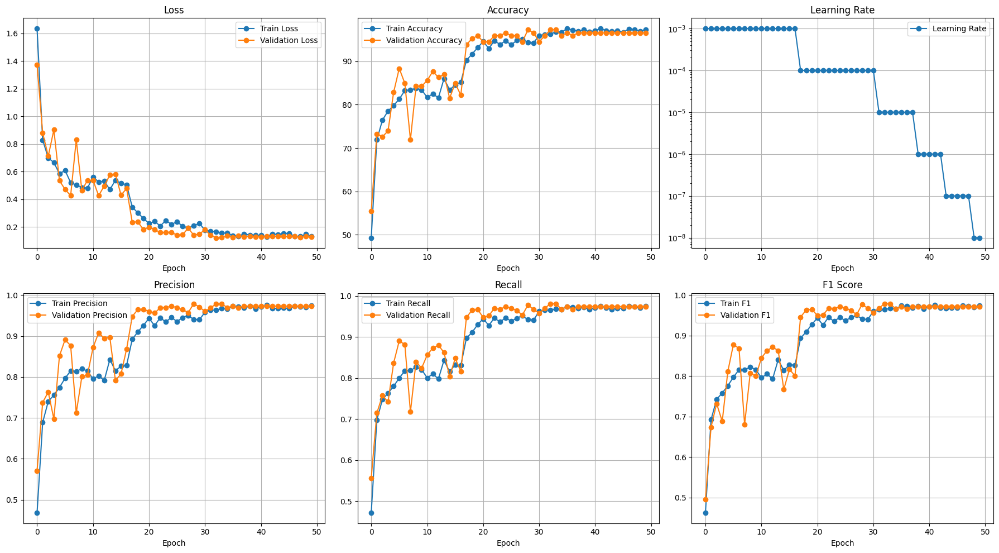

Testing: 100%|██████████| 23/23 [00:00<00:00, 35.81it/s]


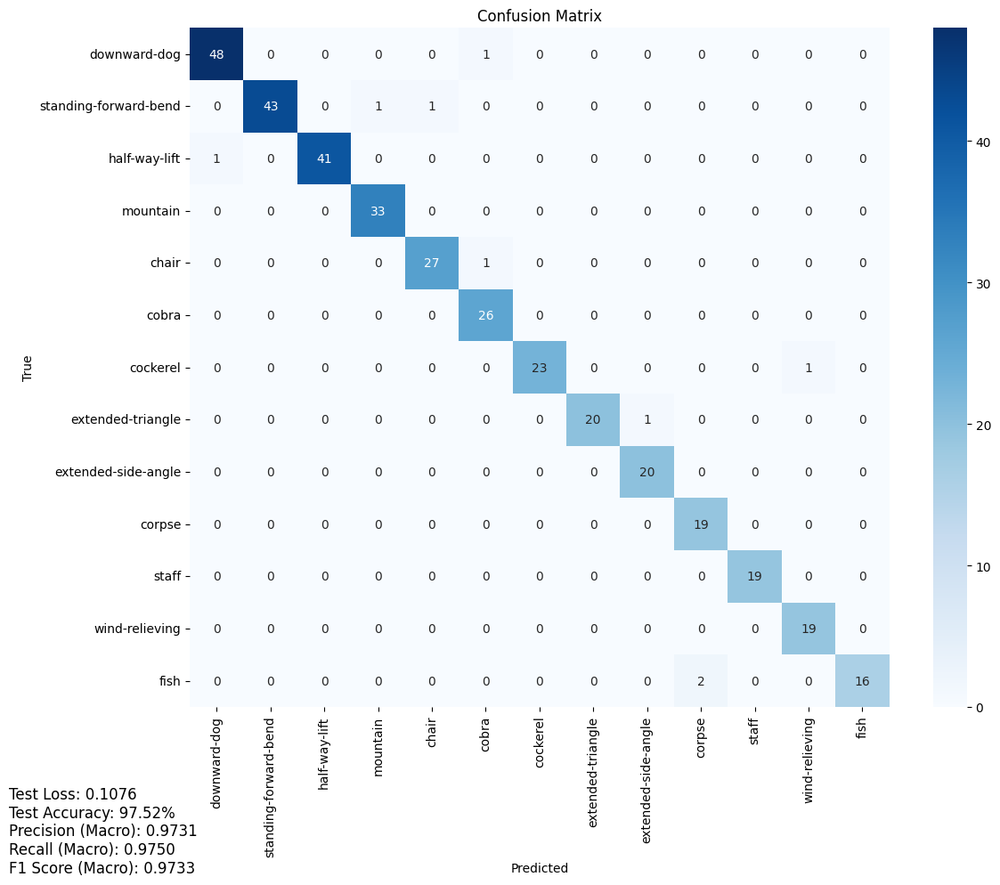

Test Loss: 0.1076
Test Accuracy: 97.52%
Precision (Macro): 0.9731
Recall (Macro): 0.9750
F1 Score (Macro): 0.9733


Testing: 100%|██████████| 23/23 [00:00<00:00, 39.89it/s]


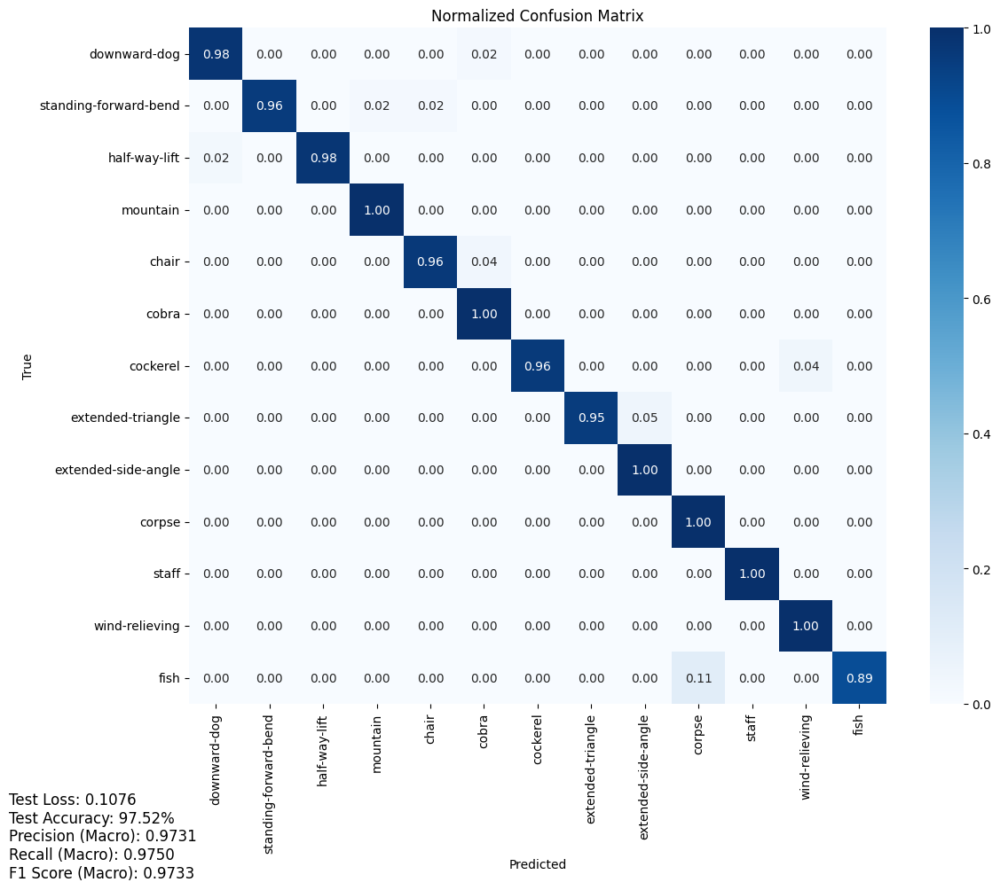

Test Loss: 0.1076
Test Accuracy: 97.52%
Precision (Macro): 0.9731
Recall (Macro): 0.9750
F1 Score (Macro): 0.9733
Saved checkpoint for fold 5


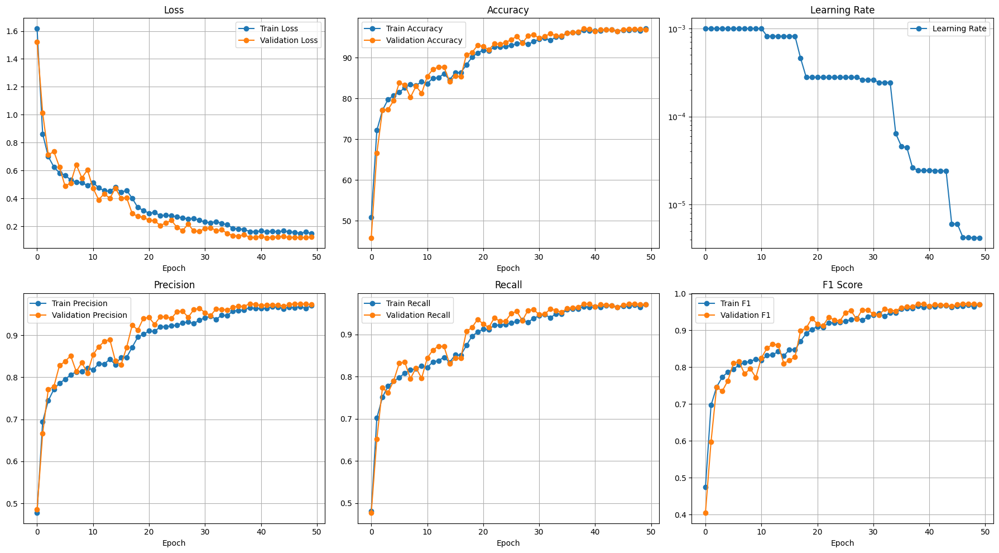

Saved test metrics plot to /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/test_metrics_average.png


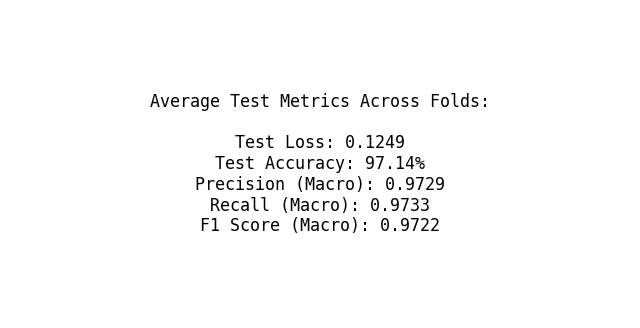


Class Distribution Analysis:
--------------------------------------------------
Class 0: 245 samples (13.48%)
Class 1: 225 samples (12.38%)
Class 2: 209 samples (11.50%)
Class 3: 165 samples (9.08%)
Class 4: 140 samples (7.70%)
Class 5: 129 samples (7.10%)
Class 6: 120 samples (6.60%)
Class 7: 108 samples (5.94%)
Class 8: 101 samples (5.56%)
Class 9: 95 samples (5.23%)
Class 10: 94 samples (5.17%)
Class 11: 94 samples (5.17%)
Class 12: 93 samples (5.12%)

Imbalance Statistics:
Imbalance Ratio (max/min): 2.63
Maximum class size: 245
Minimum class size: 93
Average class size: 139.85
Class weights aligned with indices: tensor([0.5117, 0.5567, 0.5988, 0.7568, 0.8908, 0.9663, 1.0383, 1.1529, 1.2324,
        1.3099, 1.3237, 1.3237, 1.3379])
Cached criterion for fold final
Using device: cuda

Epoch 1/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.96it/s, loss=1.42, accuracy=56]



Epoch 1/50 Summary:
Train Loss: 1.4278 | Train Acc: 56.00% | Train Precision: 0.53 | Train Recall: 0.53 | Train F1: 0.53

Epoch 2/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.11it/s, loss=0.745, accuracy=76]



Epoch 2/50 Summary:
Train Loss: 0.7471 | Train Acc: 76.02% | Train Precision: 0.73 | Train Recall: 0.74 | Train F1: 0.73

Epoch 3/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.53it/s, loss=0.662, accuracy=79.3]



Epoch 3/50 Summary:
Train Loss: 0.6640 | Train Acc: 79.32% | Train Precision: 0.77 | Train Recall: 0.78 | Train F1: 0.77

Epoch 4/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.68it/s, loss=0.602, accuracy=80.8]



Epoch 4/50 Summary:
Train Loss: 0.6036 | Train Acc: 80.80% | Train Precision: 0.78 | Train Recall: 0.79 | Train F1: 0.79

Epoch 5/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  8.96it/s, loss=0.575, accuracy=82.4]



Epoch 5/50 Summary:
Train Loss: 0.5772 | Train Acc: 82.40% | Train Precision: 0.80 | Train Recall: 0.81 | Train F1: 0.80

Epoch 6/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.73it/s, loss=0.502, accuracy=83.6]



Epoch 6/50 Summary:
Train Loss: 0.5039 | Train Acc: 83.55% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.82

Epoch 7/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.02it/s, loss=0.503, accuracy=83.5]



Epoch 7/50 Summary:
Train Loss: 0.5045 | Train Acc: 83.50% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.82

Epoch 8/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.18it/s, loss=0.493, accuracy=84.3]



Epoch 8/50 Summary:
Train Loss: 0.4947 | Train Acc: 84.27% | Train Precision: 0.83 | Train Recall: 0.83 | Train F1: 0.83

Epoch 9/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.22it/s, loss=0.522, accuracy=82.7]



Epoch 9/50 Summary:
Train Loss: 0.5240 | Train Acc: 82.67% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81

Epoch 10/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.99it/s, loss=0.51, accuracy=83.4]



Epoch 10/50 Summary:
Train Loss: 0.5113 | Train Acc: 83.39% | Train Precision: 0.81 | Train Recall: 0.82 | Train F1: 0.81

Epoch 11/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.23it/s, loss=0.51, accuracy=84.9]



Epoch 11/50 Summary:
Train Loss: 0.5121 | Train Acc: 84.93% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.84

Epoch 12/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.14it/s, loss=0.523, accuracy=83.4]



Epoch 12/50 Summary:
Train Loss: 0.5252 | Train Acc: 83.44% | Train Precision: 0.82 | Train Recall: 0.82 | Train F1: 0.82

Epoch 13/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:14<00:00,  7.91it/s, loss=0.479, accuracy=85]



Epoch 13/50 Summary:
Train Loss: 0.4808 | Train Acc: 85.04% | Train Precision: 0.84 | Train Recall: 0.85 | Train F1: 0.84

Epoch 14/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  8.93it/s, loss=0.48, accuracy=85.3]



Epoch 14/50 Summary:
Train Loss: 0.4817 | Train Acc: 85.26% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.84

Epoch 15/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.60it/s, loss=0.528, accuracy=84.9]



Epoch 15/50 Summary:
Train Loss: 0.5302 | Train Acc: 84.87% | Train Precision: 0.83 | Train Recall: 0.84 | Train F1: 0.83

Epoch 16/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.67it/s, loss=0.481, accuracy=85.9]



Epoch 16/50 Summary:
Train Loss: 0.4829 | Train Acc: 85.92% | Train Precision: 0.85 | Train Recall: 0.85 | Train F1: 0.85

Epoch 17/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.19it/s, loss=0.482, accuracy=86.2]



Epoch 17/50 Summary:
Train Loss: 0.4837 | Train Acc: 86.25% | Train Precision: 0.85 | Train Recall: 0.86 | Train F1: 0.85

Epoch 18/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.04it/s, loss=0.473, accuracy=87.5]



Epoch 18/50 Summary:
Train Loss: 0.4744 | Train Acc: 87.46% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.86

Epoch 19/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.15it/s, loss=0.438, accuracy=87.1]



Epoch 19/50 Summary:
Train Loss: 0.4393 | Train Acc: 87.13% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.87

Epoch 20/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.21it/s, loss=0.455, accuracy=87.5]



Epoch 20/50 Summary:
Train Loss: 0.4563 | Train Acc: 87.51% | Train Precision: 0.86 | Train Recall: 0.87 | Train F1: 0.86

Epoch 21/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.71it/s, loss=0.467, accuracy=88.3]



Epoch 21/50 Summary:
Train Loss: 0.4686 | Train Acc: 88.34% | Train Precision: 0.87 | Train Recall: 0.87 | Train F1: 0.87

Epoch 22/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.24it/s, loss=0.436, accuracy=89.2]



Epoch 22/50 Summary:
Train Loss: 0.4377 | Train Acc: 89.16% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.89

Epoch 23/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.24it/s, loss=0.439, accuracy=89.3]



Epoch 23/50 Summary:
Train Loss: 0.4405 | Train Acc: 89.27% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.89

Epoch 24/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.34it/s, loss=0.428, accuracy=89.3]



Epoch 24/50 Summary:
Train Loss: 0.4297 | Train Acc: 89.33% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88

Epoch 25/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.79it/s, loss=0.429, accuracy=89.2]



Epoch 25/50 Summary:
Train Loss: 0.4306 | Train Acc: 89.16% | Train Precision: 0.88 | Train Recall: 0.89 | Train F1: 0.88

Epoch 26/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.93it/s, loss=0.405, accuracy=90.8]



Epoch 26/50 Summary:
Train Loss: 0.4060 | Train Acc: 90.76% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90

Epoch 27/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.24it/s, loss=0.41, accuracy=90.8]



Epoch 27/50 Summary:
Train Loss: 0.4109 | Train Acc: 90.76% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90

Epoch 28/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.15it/s, loss=0.398, accuracy=90.8]



Epoch 28/50 Summary:
Train Loss: 0.3992 | Train Acc: 90.76% | Train Precision: 0.90 | Train Recall: 0.91 | Train F1: 0.90

Epoch 29/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.70it/s, loss=0.405, accuracy=90.8]



Epoch 29/50 Summary:
Train Loss: 0.4061 | Train Acc: 90.81% | Train Precision: 0.90 | Train Recall: 0.90 | Train F1: 0.90

Epoch 30/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.11it/s, loss=0.427, accuracy=89.7]



Epoch 30/50 Summary:
Train Loss: 0.4280 | Train Acc: 89.66% | Train Precision: 0.89 | Train Recall: 0.90 | Train F1: 0.89

Epoch 31/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  8.98it/s, loss=0.482, accuracy=89.1]



Epoch 31/50 Summary:
Train Loss: 0.4834 | Train Acc: 89.11% | Train Precision: 0.88 | Train Recall: 0.88 | Train F1: 0.88

Epoch 32/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.48it/s, loss=0.441, accuracy=89.7]



Epoch 32/50 Summary:
Train Loss: 0.4420 | Train Acc: 89.66% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89

Epoch 33/50
Current Learning Rate: 0.001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.06it/s, loss=0.455, accuracy=89.9]



Epoch 33/50 Summary:
Train Loss: 0.4565 | Train Acc: 89.88% | Train Precision: 0.89 | Train Recall: 0.89 | Train F1: 0.89

Epoch 34/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.53it/s, loss=0.34, accuracy=93.5]



Epoch 34/50 Summary:
Train Loss: 0.3416 | Train Acc: 93.51% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.93

Epoch 35/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.47it/s, loss=0.301, accuracy=93.7]



Epoch 35/50 Summary:
Train Loss: 0.3025 | Train Acc: 93.67% | Train Precision: 0.93 | Train Recall: 0.94 | Train F1: 0.94

Epoch 36/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.64it/s, loss=0.282, accuracy=93.8]



Epoch 36/50 Summary:
Train Loss: 0.2824 | Train Acc: 93.84% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94

Epoch 37/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.25it/s, loss=0.281, accuracy=94]



Epoch 37/50 Summary:
Train Loss: 0.2816 | Train Acc: 94.00% | Train Precision: 0.94 | Train Recall: 0.94 | Train F1: 0.94

Epoch 38/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.08it/s, loss=0.255, accuracy=94.9]



Epoch 38/50 Summary:
Train Loss: 0.2559 | Train Acc: 94.94% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95

Epoch 39/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.26it/s, loss=0.241, accuracy=96]



Epoch 39/50 Summary:
Train Loss: 0.2415 | Train Acc: 95.98% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 40/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.17it/s, loss=0.232, accuracy=94.9]



Epoch 40/50 Summary:
Train Loss: 0.2323 | Train Acc: 94.94% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95

Epoch 41/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.87it/s, loss=0.226, accuracy=95.9]



Epoch 41/50 Summary:
Train Loss: 0.2271 | Train Acc: 95.93% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 42/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:13<00:00,  8.45it/s, loss=0.21, accuracy=96]



Epoch 42/50 Summary:
Train Loss: 0.2111 | Train Acc: 96.04% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 43/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.61it/s, loss=0.211, accuracy=96.1]



Epoch 43/50 Summary:
Train Loss: 0.2115 | Train Acc: 96.15% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 44/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.06it/s, loss=0.219, accuracy=95.3]



Epoch 44/50 Summary:
Train Loss: 0.2194 | Train Acc: 95.32% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95

Epoch 45/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:12<00:00,  9.32it/s, loss=0.238, accuracy=94.8]



Epoch 45/50 Summary:
Train Loss: 0.2388 | Train Acc: 94.83% | Train Precision: 0.95 | Train Recall: 0.95 | Train F1: 0.95

Epoch 46/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00, 10.12it/s, loss=0.211, accuracy=96]



Epoch 46/50 Summary:
Train Loss: 0.2119 | Train Acc: 96.04% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 47/50
Current Learning Rate: 0.0001


Training: 100%|██████████| 114/114 [00:11<00:00,  9.52it/s, loss=0.229, accuracy=95.7]



Epoch 47/50 Summary:
Train Loss: 0.2296 | Train Acc: 95.65% | Train Precision: 0.95 | Train Recall: 0.96 | Train F1: 0.96

Epoch 48/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 114/114 [00:12<00:00,  9.27it/s, loss=0.218, accuracy=95.9]



Epoch 48/50 Summary:
Train Loss: 0.2185 | Train Acc: 95.93% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 49/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 114/114 [00:12<00:00,  9.22it/s, loss=0.209, accuracy=95.9]



Epoch 49/50 Summary:
Train Loss: 0.2100 | Train Acc: 95.93% | Train Precision: 0.96 | Train Recall: 0.96 | Train F1: 0.96

Epoch 50/50
Current Learning Rate: 1e-05


Training: 100%|██████████| 114/114 [00:11<00:00,  9.70it/s, loss=0.189, accuracy=96.6]



Epoch 50/50 Summary:
Train Loss: 0.1895 | Train Acc: 96.64% | Train Precision: 0.97 | Train Recall: 0.97 | Train F1: 0.97
Final model saved at /content/gdrive/MyDrive/yoga_proj/CROSS_FOLD_STSAE_GCN_2025-02-24_B7_HC120_LR0.001_NO_ATTENTION_3rd_DA_True/final_model_fold_final.pth


In [ ]:
if __name__ == "__main__":
    main()

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import torch
import numpy as np
import os
from tqdm import tqdm
import csv

def find_sus(model, test_loader, criterion, class_names, spath=SAVE_PATH, fsave='confusion_matrix_all.png'):
    """
    Evaluate model on test set

    Args:
        model: PyTorch model
        test_loader: DataLoader for test data
        criterion: Loss function
        class_names: List of class names
        save_path: Directory to save the plot
        fsave: Filename for confusion matrix plot
    """
    csave = os.path.join(spath, fsave)
    sussave = os.path.join(spath, 'sus.csv')
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    test_loss = 0.0
    test_correct = 0
    test_total = 0
    all_predictions = []
    all_labels = []
    misclassified_data = []

    # Create progress bar
    test_loader_tqdm = tqdm(test_loader, desc="Testing")

    with torch.no_grad():
        for batch_idx, (inputs, labels) in enumerate(test_loader_tqdm):
            inputs = inputs.to(device)
            labels = labels.to(device)
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item() * inputs.size(0)

            # Get predictions
            _, predicted = torch.max(outputs, 1)
            # Calculate accuracy
            test_correct += (predicted == labels).sum().item()
            test_total += labels.size(0)

            # Store predictions and labels for confusion matrix
            all_predictions.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            # Check if the sample is misclassified
            misclassified_indices = (predicted != labels).nonzero(as_tuple=True)[0]
            for misclassified_idx in misclassified_indices:
                global_idx = batch_idx * inputs.size(0) + misclassified_idx.item()
                sequence_id = test_loader.dataset.idx_to_seq[global_idx]
                correct_label = class_names[labels[misclassified_idx].item()]
                prediction = class_names[predicted[misclassified_idx].item()]
                misclassified_data.append([sequence_id, correct_label, prediction])

    # Calculate metrics
    test_loss = test_loss / len(test_loader.dataset)
    accuracy = 100 * test_correct / test_total

    # Create confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=pose_list, yticklabels=pose_list)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')

    # Save the plot
    plt.savefig(csave)
    plt.show()
    plt.close()

    # Save misclassified data to CSV
    with open(sussave, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['sequence_id', 'correct_label', 'prediction'])
        writer.writerows(misclassified_data)

    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.2f}%')

    return test_loss, accuracy

Class weights aligned with indices: tensor([0.5087, 0.5539, 0.5963, 0.7553, 0.8902, 0.9661, 1.0385, 1.1539, 1.2339,
        1.3118, 1.3258, 1.3258, 1.3400])


Testing: 100%|██████████| 114/114 [00:01<00:00, 68.69it/s]


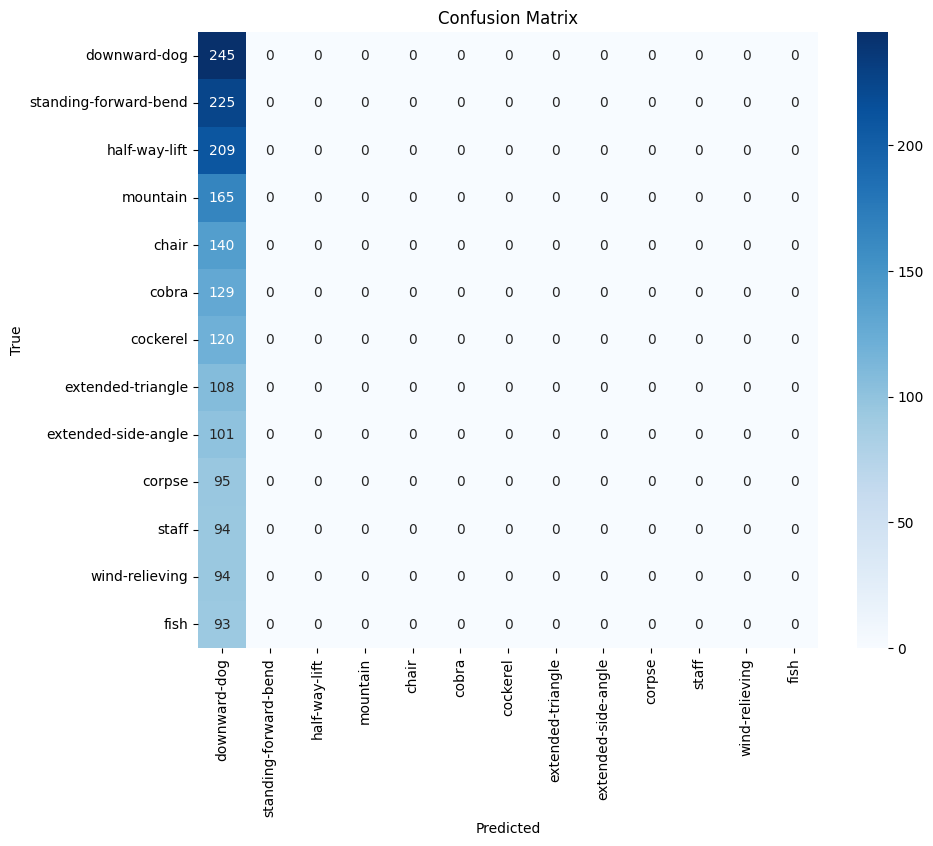

Test Loss: 143.4410
Test Accuracy: 13.48%


(143.44095780537944, 13.476347634763476)

In [ ]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='inverse'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
# plot_training_curves(history)
find_sus(model, loader, criterion, label_to_pose)

In [ ]:
dataset = Yoga3DDataset(read_meta_data())
label_to_pose = {v:k for k,v in dataset.pose_to_label.items()}

model = STSAE_GCN(3, HIDDEN_CHANNELS, NUM_CLASSES, 20, NUM_BLOCKS)
# criterion = nn.CrossEntropyLoss()
all_labels = [dataset[i][1] for i in range(len(dataset))]
dataset, train_dataset, test_dataset = prepare_dataset()
criterion = create_weighted_criterion(
        all_labels,
        num_classes= NUM_CLASSES,
        strategy='effective_samples'  # Try different strategies
    )
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

checkpoint_path = os.path.join(SAVE_PATH, 'best_model.pth')
# Plot the training curves
if checkpoint_path and os.path.exists(checkpoint_path):
        model, optimizer, start_epoch, history = load_checkpoint(
            model, optimizer, checkpoint_path
        )
        print(f"Resuming training from epoch {start_epoch}")
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
evaluate_model(model, test_loader, criterion, pose_list, fsave= 'outward_confusion_matrix.png')
evaluate_model_normalized(model, test_loader, criterion, pose_list, fsave= 'outward_normalized_confusion_matrix.png')